In [ ]:
from openpyxl import load_workbook

archivo = '/content/BASE DE DATOS ! .xlsx'
wb = load_workbook(archivo)

hojas = wb.sheetnames

print(hojas)

['IBEX 35', 'Acciona ', 'Acerinox ', 'ACS ', 'ArcelorMittal SA', 'Banco Sabadell', 'Banco Santander', 'Bankinter', 'BBVA ', 'Caixabank ', ' Colonial', 'Enagas', 'Endesa ', 'Ferrovial ', 'Fluidra', 'Grifols ', 'Iberdrola ', 'Inditex', 'Indra ', 'Mapfre', 'Naturgy ', 'Redeia', 'Sacyr', 'Solaria ', 'Telefonica']


In [ ]:
df = pd.read_excel(xls, sheet_name=hoja)


print(f"Columnas en {hoja}: {df.columns}")

NameError: name 'pd' is not defined

In [ ]:
import pandas as pd


archivo_excel = '/content/BASE DE DATOS ! .xlsx'


xls = pd.ExcelFile(archivo_excel)


hojas = ['IBEX 35', 'Acciona ', 'Acerinox ', 'ACS ', 'ArcelorMittal SA', 'Banco Sabadell',
         'Banco Santander', 'Bankinter', 'BBVA ', 'Caixabank ', ' Colonial', 'Enagas',
         'Endesa ', 'Ferrovial ', 'Fluidra', 'Grifols ', 'Iberdrola ', 'Inditex', 'Indra ',
         'Mapfre', 'Naturgy ', 'Redeia', 'Sacyr', 'Solaria ', 'Telefonica']


nulos_por_hoja = {}


for hoja in hojas:
    if hoja in xls.sheet_names:
        df = pd.read_excel(xls, sheet_name=hoja)
        nulos_por_hoja[hoja] = df.isnull().sum().sum()  # Total de nulos en la hoja
    else:
        nulos_por_hoja[hoja] = 'No encontrada'


for hoja, nulos in nulos_por_hoja.items():
    print(f"Hoja: {hoja} - Nulos: {nulos}")


Hoja: IBEX 35 - Nulos: 3
Hoja: Acciona  - Nulos: 2
Hoja: Acerinox  - Nulos: 2
Hoja: ACS  - Nulos: 2
Hoja: ArcelorMittal SA - Nulos: 3
Hoja: Banco Sabadell - Nulos: 2
Hoja: Banco Santander - Nulos: 2
Hoja: Bankinter - Nulos: 2
Hoja: BBVA  - Nulos: 2
Hoja: Caixabank  - Nulos: 2
Hoja:  Colonial - Nulos: 2
Hoja: Enagas - Nulos: 2
Hoja: Endesa  - Nulos: 2
Hoja: Ferrovial  - Nulos: 2
Hoja: Fluidra - Nulos: 2
Hoja: Grifols  - Nulos: 2
Hoja: Iberdrola  - Nulos: 2
Hoja: Inditex - Nulos: 2
Hoja: Indra  - Nulos: 2
Hoja: Mapfre - Nulos: 2
Hoja: Naturgy  - Nulos: 2
Hoja: Redeia - Nulos: 2
Hoja: Sacyr - Nulos: 2
Hoja: Solaria  - Nulos: 2
Hoja: Telefonica - Nulos: 2


In [ ]:
import pandas as pd
import numpy as np
from IPython.display import display

# --- CARGAR DATOS ---
# Cambia esta línea según tu archivo
# df = pd.read_excel('/content/tu_archivo.xlsx')
df = pd.read_excel('/content/BASE DE DATOS ! .xlsx')

# --- FUNCIONES ---
def detectar_outliers(col):
    if df[col].dtype.kind in 'biufc':  # solo columnas numéricas
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        filtro = (df[col] < (Q1 - 1.5 * IQR)) | (df[col] > (Q3 + 1.5 * IQR))
        return filtro.sum()
    return np.nan

# --- CALCULAR NULOS Y OUTLIERS ---
resumen = pd.DataFrame(index=df.columns)
resumen['Total Valores'] = len(df)
resumen['Nulos'] = df.isnull().sum()
resumen['% Nulos'] = (resumen['Nulos'] / resumen['Total Valores']) * 100
resumen['Outliers'] = [detectar_outliers(col) for col in df.columns]
resumen['% Outliers'] = (resumen['Outliers'] / resumen['Total Valores']) * 100

# --- REDONDEAR Y MOSTRAR ---
resumen = resumen.round(2)
display(resumen)


,Total Valores,Nulos,% Nulos,Outliers,% Outliers
Exchange Date,3839,0,0.00,NaN,NaN
Close,3839,0,0.00,0.0,0.00
Net,3839,1,0.03,162.0,4.22
%Chg,3839,1,0.03,194.0,5.05
Open,3839,0,0.00,0.0,0.00
Low,3839,0,0.00,1.0,0.03
High,3839,0,0.00,0.0,0.00
Volume,3839,0,0.00,109.0,2.84
Turnover - EUR,3839,0,0.00,109.0,2.84
Flow,3839,0,0.00,0.0,0.00


In [ ]:
for hoja in hojas:
    if hoja in xls.sheet_names:
        df = pd.read_excel(xls, sheet_name=hoja)
        nulos_por_columna = df.isnull().sum()
        print(f"\nHoja: {hoja}\n{nulos_por_columna[nulos_por_columna > 0]}")



Hoja: IBEX 35
Net                           1
%Chg                          1
Rendimientos logarítmicos     1
dtype: int64

Hoja: Acciona 
Net     1
%Chg    1
dtype: int64

Hoja: Acerinox 
Net     1
%Chg    1
dtype: int64

Hoja: ACS 
Net     1
%Chg    1
dtype: int64

Hoja: ArcelorMittal SA
Net                           1
%Chg                          1
Rendimientos logarítmicos     4
Volatilidad                   4
Ratio apertura-cierre         4
Net Gap                       4
%Chg Gap                      4
dtype: int64

Hoja: Banco Sabadell
Net     1
%Chg    1
dtype: int64

Hoja: Banco Santander
Net     1
%Chg    1
dtype: int64

Hoja: Bankinter
Net     1
%Chg    1
dtype: int64

Hoja: BBVA 
Net     1
%Chg    1
Open    1
dtype: int64

Hoja: Caixabank 
Close                         1
Net                           2
%Chg                          2
Open                          1
Low                           1
High                          1
Volume                        1
Turnover - E

In [ ]:
import pandas as pd


archivo_excel = '/content/BASE DE DATOS ! .xlsx'
xls = pd.ExcelFile(archivo_excel)


hojas = ['IBEX 35', 'Acciona ', 'Acerinox ', 'ACS ', 'ArcelorMittal SA', 'Banco Sabadell',
         'Banco Santander', 'Bankinter', 'BBVA ', 'Caixabank ', ' Colonial', 'Enagas',
         'Endesa ', 'Ferrovial ', 'Fluidra', 'Grifols ', 'Iberdrola ', 'Inditex', 'Indra ',
         'Mapfre', 'Naturgy ', 'Redeia', 'Rovi', 'Sacyr', 'Solaria ', 'Telefonica']

for hoja in hojas:
    if hoja in xls.sheet_names:
        df = pd.read_excel(xls, sheet_name=hoja)


        for col in df.columns:
            nulos_en_columna = df[df[col].isnull()]
            if not nulos_en_columna.empty:
                print(f"\nHoja: {hoja}, Columna: {col}")
                print(nulos_en_columna.index.tolist())



Hoja: IBEX 35, Columna: Net
[3838]

Hoja: IBEX 35, Columna: %Chg
[3838]

Hoja: IBEX 35, Columna: Rendimientos logarítmicos 
[3838]

Hoja: Acciona , Columna: Net
[3838]

Hoja: Acciona , Columna: %Chg
[3838]

Hoja: Acerinox , Columna: Net
[3838]

Hoja: Acerinox , Columna: %Chg
[3838]

Hoja: ACS , Columna: Net
[3838]

Hoja: ACS , Columna: %Chg
[3838]

Hoja: ArcelorMittal SA, Columna: Net
[3842]

Hoja: ArcelorMittal SA, Columna: %Chg
[3842]

Hoja: ArcelorMittal SA, Columna: Rendimientos logarítmicos 
[3839, 3840, 3841, 3842]

Hoja: ArcelorMittal SA, Columna: Volatilidad
[3839, 3840, 3841, 3842]

Hoja: ArcelorMittal SA, Columna: Ratio apertura-cierre
[3839, 3840, 3841, 3842]

Hoja: ArcelorMittal SA, Columna: Net Gap 
[3839, 3840, 3841, 3842]

Hoja: ArcelorMittal SA, Columna: %Chg Gap
[3839, 3840, 3841, 3842]

Hoja: Banco Sabadell, Columna: Net
[3838]

Hoja: Banco Sabadell, Columna: %Chg
[3838]

Hoja: Banco Santander, Columna: Net
[3838]

Hoja: Banco Santander, Columna: %Chg
[3838]

Hoja: B

In [ ]:
import pandas as pd


archivo_excel = '/content/BASE DE DATOS ! .xlsx'
xls = pd.ExcelFile(archivo_excel)

hojas = ['IBEX 35', 'Acciona ', 'Acerinox ', 'ACS ', 'ArcelorMittal SA', 'Banco Sabadell',
         'Banco Santander', 'Bankinter', 'BBVA ', 'Caixabank ', ' Colonial', 'Enagas',
         'Endesa ', 'Ferrovial ', 'Fluidra', 'Grifols ', 'Iberdrola ', 'Inditex', 'Indra ',
         'Mapfre', 'Naturgy ', 'Redeia', 'Rovi', 'Sacyr', 'Solaria ', 'Telefonica']


for hoja in hojas:
    if hoja in xls.sheet_names:
        df = pd.read_excel(xls, sheet_name=hoja)


        for col in df.columns:
            nulos_en_columna = df[df[col].isnull()]
            if not nulos_en_columna.empty:
                print(f"\nHoja: {hoja}, Columna: {col}")
                print(nulos_en_columna.index.tolist())


Hoja: IBEX 35, Columna: Net
[3838]

Hoja: IBEX 35, Columna: %Chg
[3838]

Hoja: IBEX 35, Columna: Rendimientos logarítmicos 
[3838]

Hoja: Acciona , Columna: Net
[3838]

Hoja: Acciona , Columna: %Chg
[3838]

Hoja: Acerinox , Columna: Net
[3838]

Hoja: Acerinox , Columna: %Chg
[3838]

Hoja: ACS , Columna: Net
[3838]

Hoja: ACS , Columna: %Chg
[3838]

Hoja: ArcelorMittal SA, Columna: Net
[3838]

Hoja: ArcelorMittal SA, Columna: %Chg
[3838]

Hoja: ArcelorMittal SA, Columna: Rendimientos logarítmicos 
[3838]

Hoja: Banco Sabadell, Columna: Net
[3838]

Hoja: Banco Sabadell, Columna: %Chg
[3838]

Hoja: Banco Santander, Columna: Net
[3838]

Hoja: Banco Santander, Columna: %Chg
[3838]

Hoja: Bankinter, Columna: Net
[3838]

Hoja: Bankinter, Columna: %Chg
[3838]

Hoja: BBVA , Columna: Net
[3838]

Hoja: BBVA , Columna: %Chg
[3838]

Hoja: Caixabank , Columna: Net
[3838]

Hoja: Caixabank , Columna: %Chg
[3838]

Hoja:  Colonial, Columna: Net
[3838]

Hoja:  Colonial, Columna: %Chg
[3838]

Hoja: Enaga

In [ ]:
import pandas as pd


archivo_excel = '/content/BASE DE DATOS ! .xlsx'
df = pd.read_excel(archivo_excel)

valores_nulos = df.isnull().sum()
print(valores_nulos)

valores_nulos_rendimiento = df['Rendimientos logarítmicos '].isnull().sum()
print(f"Valores nulos en 'Rendimientos logarítmicos': {valores_nulos_rendimiento}")

filas_con_nulos = df[df.isnull().any(axis=1)]
print(filas_con_nulos)

porcentaje_nulos = df.isnull().mean() * 100
print(porcentaje_nulos)


Exchange Date                 0
Close                         0
Net                           1
%Chg                          1
Open                          0
Low                           0
High                          0
Volume                        0
Turnover - EUR                0
Flow                          0
Rendimientos logarítmicos     1
Volatilidad                   0
Ratio apertura-cierre         0
Turnover por transacción      0
dtype: int64
Valores nulos en 'Rendimientos logarítmicos': 1
     Exchange Date    Close  Net  %Chg     Open      Low     High     Volume  \
3838    2010-02-01  10995.2  NaN   NaN  10852.4  10839.4  11033.7  202750000   

      Turnover - EUR  Flow  Rendimientos logarítmicos   Volatilidad  \
3838   2297417000000     0                         NaN          0.0   

      Ratio apertura-cierre  Turnover por transacción  
3838                0.98583              11331.279901  
Exchange Date                 0.000000
Close                         0.0000

In [ ]:
df_nulos = df[df.isnull().any(axis=1)]
print(df_nulos)


     Exchange Date    Close  Net  %Chg     Open      Low     High     Volume  \
3838    2010-02-01  10995.2  NaN   NaN  10852.4  10839.4  11033.7  202750000   

      Turnover - EUR  Flow  Rendimientos logarítmicos   Volatilidad  \
3838   2297417000000     0                         NaN          0.0   

      Ratio apertura-cierre  Turnover por transacción  
3838                0.98583              11331.279901  


In [ ]:
df_nulos_rendimiento = df[df['Rendimientos logarítmicos '].isnull()]
print(df_nulos_rendimiento)

     Exchange Date    Close  Net  %Chg     Open      Low     High     Volume  \
3838    2010-02-01  10995.2  NaN   NaN  10852.4  10839.4  11033.7  202750000   

      Turnover - EUR  Flow  Rendimientos logarítmicos   Volatilidad  \
3838   2297417000000     0                         NaN          0.0   

      Ratio apertura-cierre  Turnover por transacción  
3838                0.98583              11331.279901  


In [ ]:
indices_nulos = df[df.isnull().any(axis=1)].index
print("Índices con valores nulos:", indices_nulos.tolist())

Índices con valores nulos: [3838]


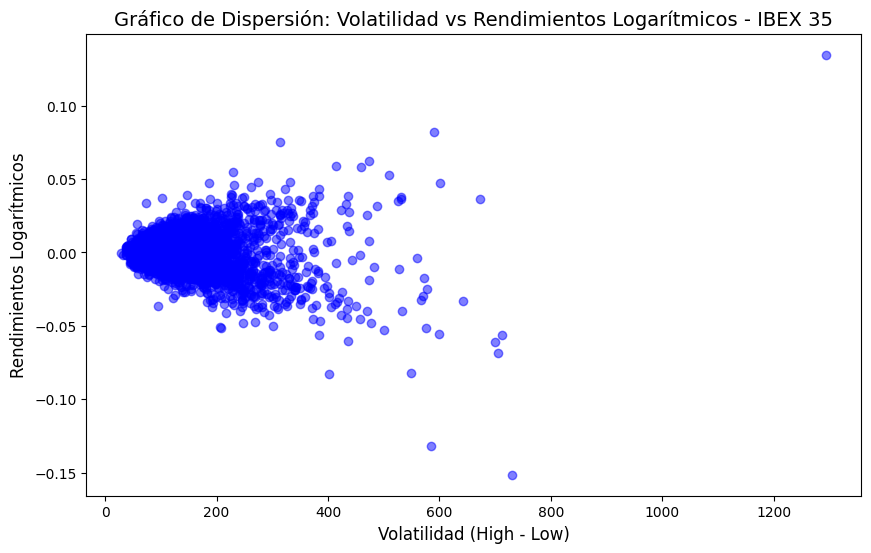

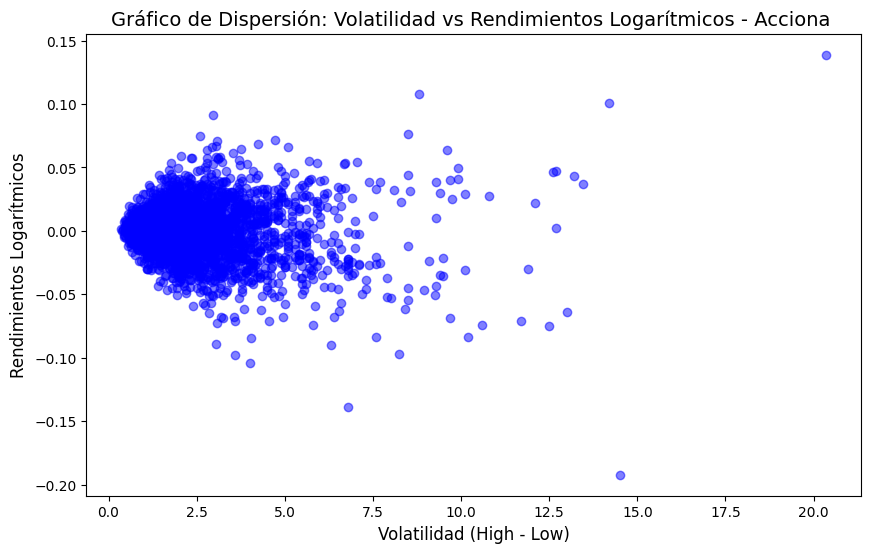

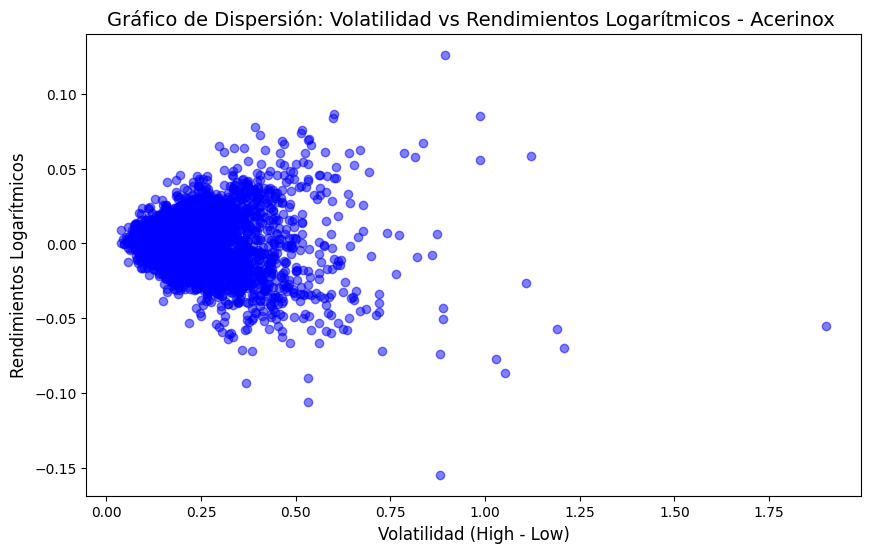

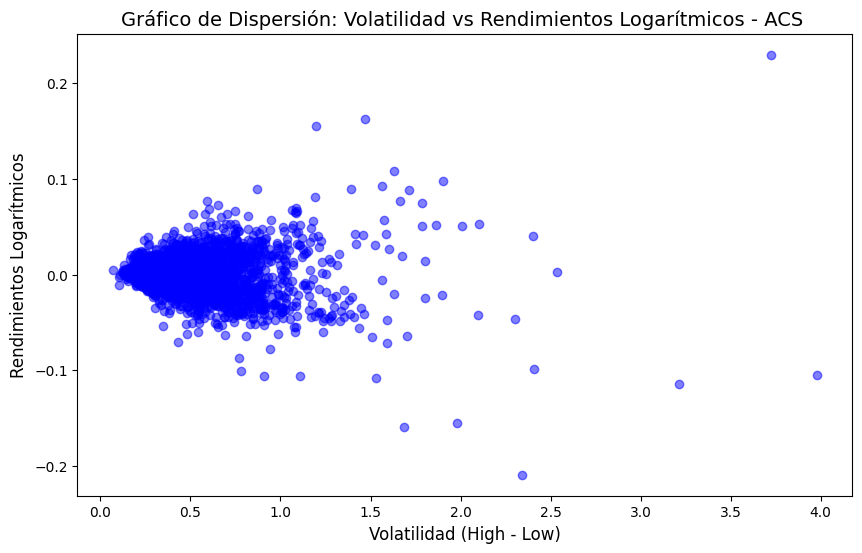

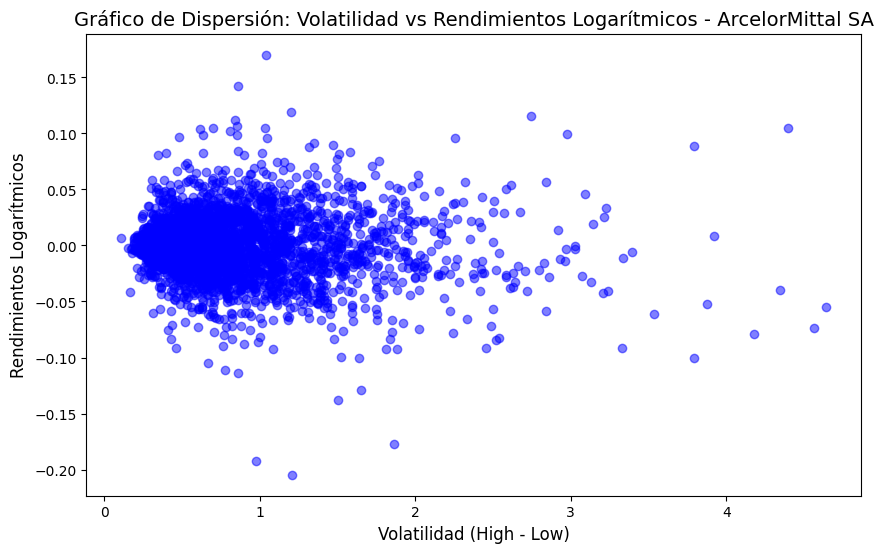

...

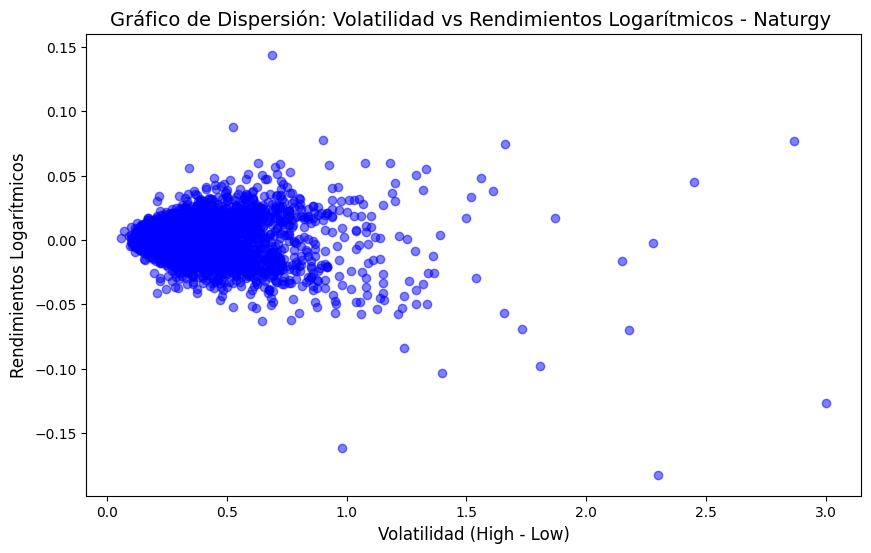

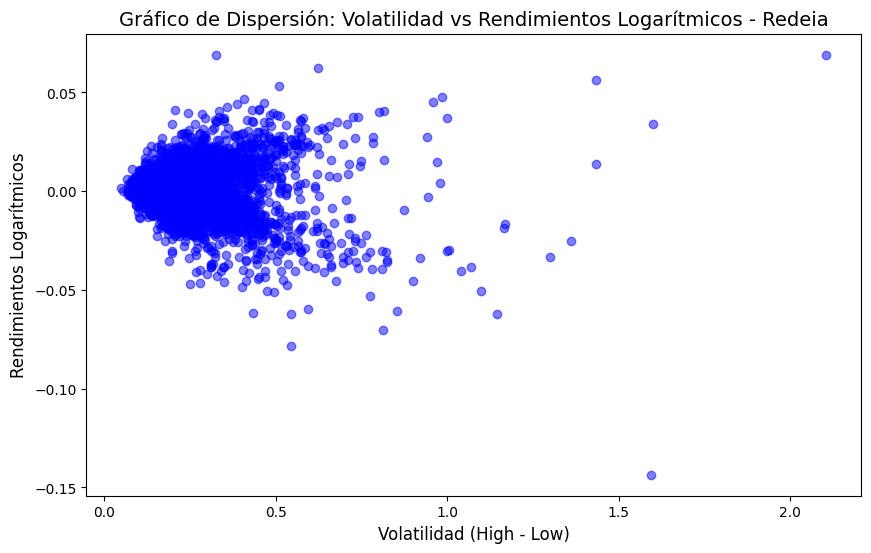

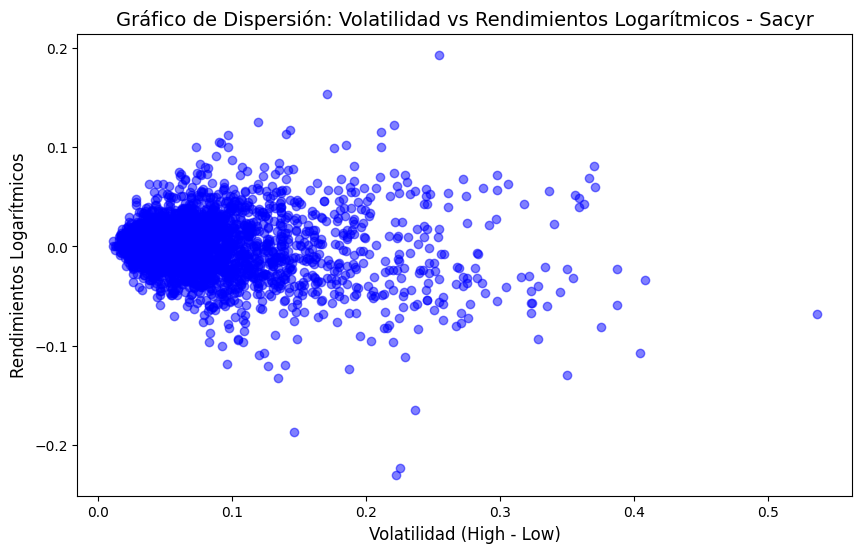

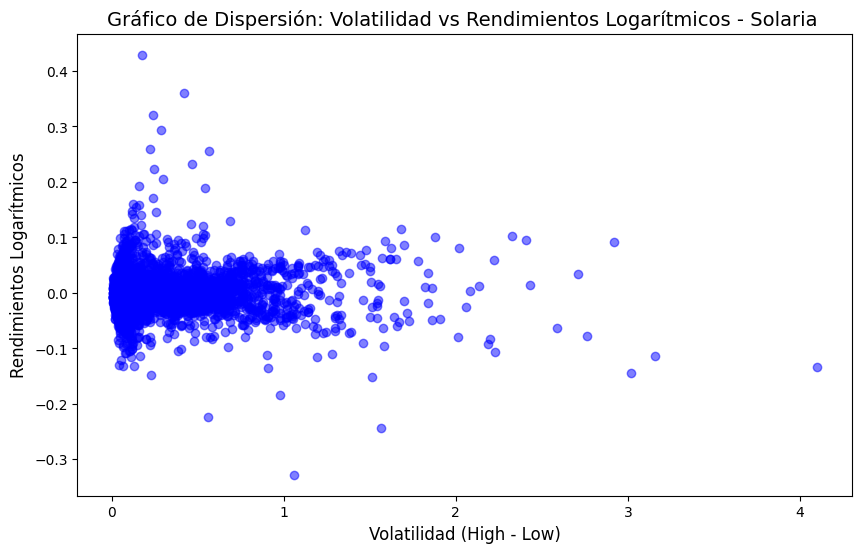

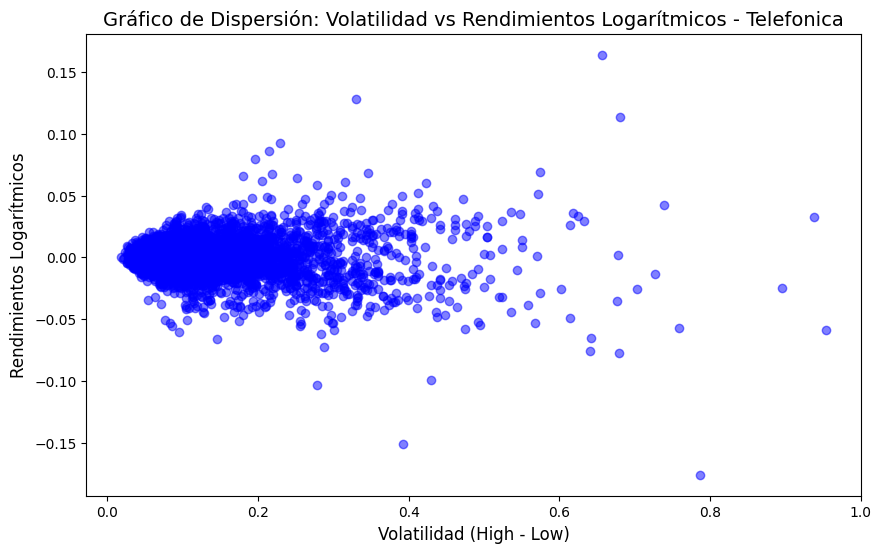

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

archivo_excel = '/content/BASE DE DATOS ! .xlsx'

hojas = ['IBEX 35', 'Acciona ', 'Acerinox ', 'ACS ', 'ArcelorMittal SA', 'Banco Sabadell',
         'Banco Santander', 'Bankinter', 'BBVA ', 'Caixabank ', ' Colonial', 'Enagas',
         'Endesa ', 'Ferrovial ', 'Fluidra', 'Grifols ', 'Iberdrola ', 'Inditex', 'Indra ',
         'Mapfre', 'Naturgy ', 'Redeia', 'Sacyr', 'Solaria ', 'Telefonica']


for hoja in hojas:

    try:
        df = pd.read_excel(archivo_excel, sheet_name=hoja)


        if 'Rendimientos logarítmicos ' in df.columns and 'High' in df.columns and 'Low' in df.columns:

            df['Volatilidad'] = df['High'] - df['Low']

            plt.figure(figsize=(10, 6))
            plt.scatter(df['Volatilidad'], df['Rendimientos logarítmicos '], color='blue', alpha=0.5)

            # Etiquetas y título
            plt.title(f'Gráfico de Dispersión: Volatilidad vs Rendimientos Logarítmicos - {hoja}', fontsize=14)
            plt.xlabel('Volatilidad (High - Low)', fontsize=12)
            plt.ylabel('Rendimientos Logarítmicos', fontsize=12)

            plt.show()

        else:
            print(f"Las columnas necesarias no están en la hoja {hoja}.")

    except Exception as e:
        print(f"No se pudo procesar la hoja {hoja}: {e}")


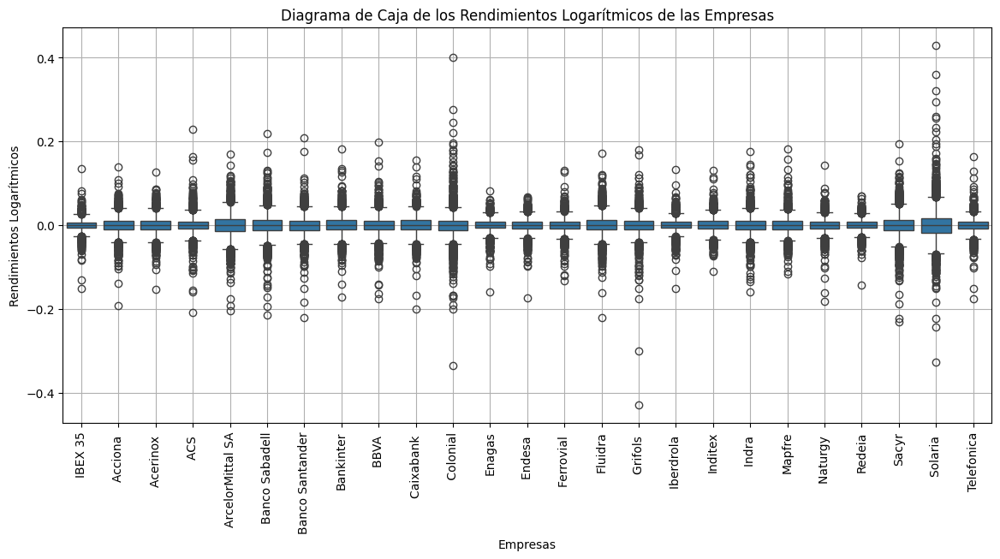

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

file_path = '/content/BASE DE DATOS ! .xlsx'
xls = pd.ExcelFile(file_path)

data_list = []


for sheet_name in xls.sheet_names:
    df = pd.read_excel(xls, sheet_name=sheet_name)

    if 'Rendimientos logarítmicos ' in df.columns:

        temp_df = pd.DataFrame({
            'Empresa': sheet_name,
            'Rendimientos Logarítmicos': df['Rendimientos logarítmicos ']
        })


        data_list.append(temp_df)

final_df = pd.concat(data_list, ignore_index=True)

plt.figure(figsize=(14, 6))
sns.boxplot(x='Empresa', y='Rendimientos Logarítmicos', data=final_df)
plt.xticks(rotation=90)  # Rotar etiquetas para mejor visualización
plt.title('Diagrama de Caja de los Rendimientos Logarítmicos de las Empresas')
plt.xlabel('Empresas')
plt.ylabel('Rendimientos Logarítmicos')
plt.grid(True)


plt.show()


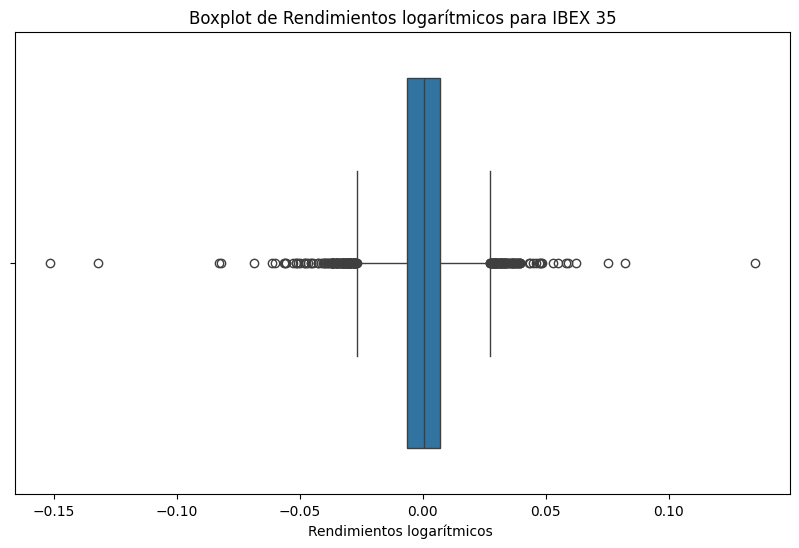

Outliers en IBEX 35:
     Exchange Date    Close    Net      %Chg     Open      Low     High  \
58      2024-11-06  11495.3 -343.9 -0.029048  11779.4  11461.2  11794.7   
479     2023-03-15   8759.1 -399.9 -0.043662   9161.8   8736.5   9169.7   
481     2023-03-13   8958.9 -326.1 -0.035121   9272.3   8894.5   9273.6   
594     2022-10-04   7696.6  234.6  0.031439   7548.5   7529.2   7699.9   
676     2022-06-10   8390.6 -320.6 -0.036803   8662.0   8362.8   8671.3   
...            ...      ...    ...       ...      ...      ...      ...   
3774    2010-05-04   9859.1 -563.7 -0.054083  10363.6   9812.8  10411.8   
3778    2010-04-28  10167.0 -313.9 -0.029950  10350.8  10077.9  10480.3   
3779    2010-04-27  10480.9 -458.4 -0.041904  10884.6  10480.9  10904.5   
3791    2010-04-09  11394.2  317.9  0.028701  11161.1  11139.5  11408.5   
3835    2010-02-04  10241.7 -646.7 -0.059393  10882.3  10220.7  10920.1   

         Volume  Turnover - EUR             Flow  Rendimientos logarítmicos   

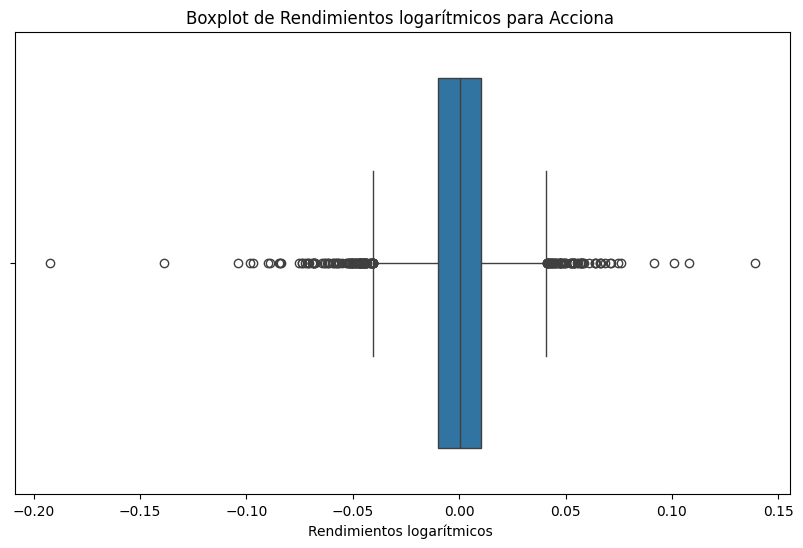

Outliers en Acciona :
     Exchange Date   Close   Net      %Chg    Open     Low    High  Volume  \
11      2025-01-15  112.20  5.20  0.048598  108.00  108.00  112.90  109878   
58      2024-11-06  110.80 -9.70 -0.080498  120.40  110.20  120.40  283547   
69      2024-10-22  118.60 -5.10 -0.041229  122.70  117.40  123.00  105613   
77      2024-10-10  118.50 -5.60 -0.045125  124.00  118.40  124.90  100626   
125     2024-08-05  114.60 -6.10 -0.050539  117.90  113.50  118.20   98050   
...            ...     ...   ...       ...     ...     ...     ...     ...   
3766    2010-05-14   63.59 -4.67 -0.068415   67.61   63.05   67.61  453109   
3770    2010-05-10   69.46  4.44  0.068287   71.50   68.40   73.49  548755   
3771    2010-05-07   65.02 -2.70 -0.039870   66.64   64.41   67.89  528649   
3774    2010-05-04   69.23 -5.31 -0.071237   74.22   68.56   74.35  505662   
3835    2010-02-04   83.42 -5.41 -0.060903   89.09   82.85   89.38  607297   

      Turnover - EUR          Flow  Rendi

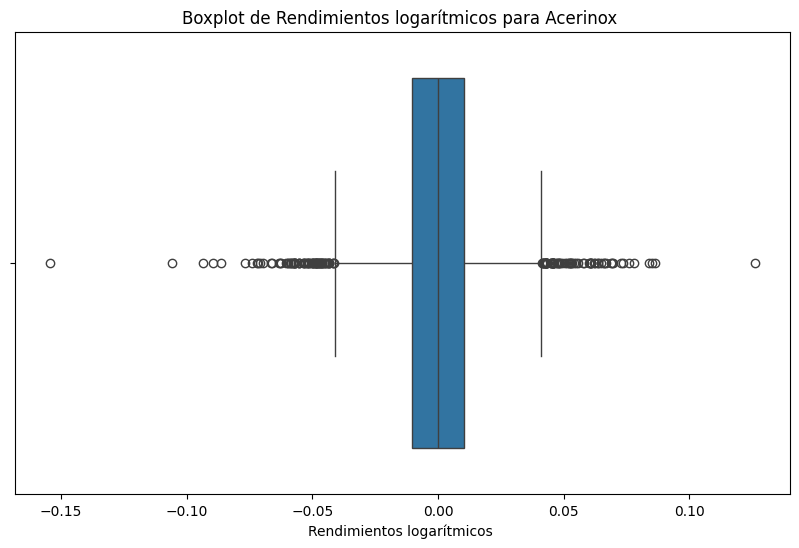

Outliers en Acerinox :
     Exchange Date      Close       Net      %Chg       Open        Low  \
6       2025-01-22   9.375000 -0.570000 -0.057315   9.600000   9.320000   
31      2024-12-13   9.530000 -0.500000 -0.049850   9.900000   9.530000   
57      2024-11-07   9.470000  0.425000  0.046987   9.100000   9.100000   
58      2024-11-06   9.045000  0.435000  0.050523   8.805000   8.770000   
64      2024-10-29   8.625000 -0.455000 -0.050110   9.010000   8.625000   
...            ...        ...       ...       ...        ...        ...   
3563    2011-02-25  10.826161  0.555807  0.054118  10.399237  10.399237   
3766    2010-05-14  10.902685 -0.499421 -0.043801  11.394051  10.745609   
3770    2010-05-10  11.494741  0.676635  0.062547  11.277251  11.116147   
3799    2010-03-26  11.555155  0.648442  0.059453  10.955044  10.906713   
3831    2010-02-10  10.060919 -0.551780 -0.051992  10.616726  10.044809   

           High        Volume  Turnover - EUR          Flow  \
6      9.6250

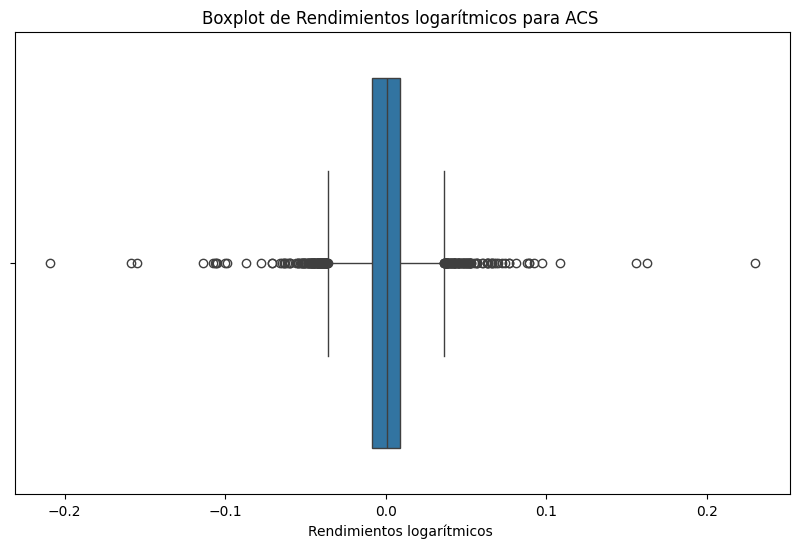

Outliers en ACS :
     Exchange Date      Close       Net      %Chg       Open        Low  \
3       2025-01-27  48.500000 -2.300000 -0.045276  50.000000  47.900000   
6       2025-01-22  51.000000  2.040000  0.041667  49.440000  49.100000   
39      2024-12-03  46.156182  2.377143  0.054299  44.076182  44.056372   
129     2024-07-30  40.173707  1.683810  0.043747  38.727612  38.648374   
257     2024-01-29  33.961882 -3.771426 -0.099950  37.723784  33.780930   
...            ...        ...       ...       ...        ...        ...   
3746    2010-06-11  20.367030  0.893911  0.045905  19.637110  19.479550   
3766    2010-05-14  19.768946 -0.868187 -0.042069  20.627487  19.376654   
3770    2010-05-10  21.222356  1.356945  0.068307  21.543906  20.450634   
3774    2010-05-04  21.000486 -1.035393 -0.046987  21.904043  20.823633   
3835    2010-02-04  20.637133 -1.180092 -0.054090  21.884750  20.476358   

           High        Volume  Turnover - EUR          Flow  \
3     50.200000  6

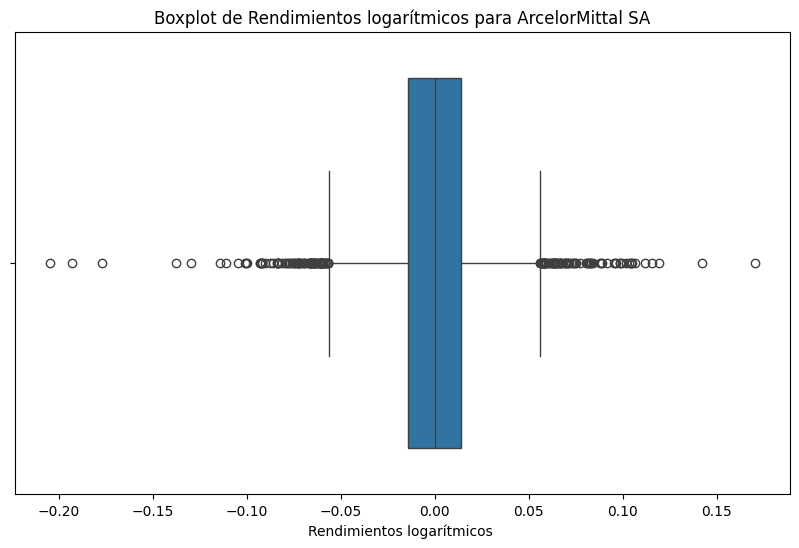

Outliers en ArcelorMittal SA:
     Exchange Date      Close       Net      %Chg       Open        Low  \
57      2024-11-07  24.630000  1.500000  0.064851  23.500000  23.500000   
203     2024-04-16  23.760000 -1.760000 -0.068966  24.220000  23.550000   
479     2023-03-15  25.055000 -2.410000 -0.087748  27.350000  24.935000   
571     2022-11-04  23.510000  1.430000  0.064764  22.305000  22.285000   
617     2022-09-01  22.270000 -1.485000 -0.062513  23.435000  22.160000   
...            ...        ...       ...       ...        ...        ...   
3734    2010-06-29  50.354941 -3.392356 -0.063117  52.310795  50.211291   
3763    2010-05-19  54.774949 -3.292906 -0.056708  56.752903  54.310848   
3766    2010-05-14  58.001555 -4.431058 -0.070973  61.813812  57.515354   
3770    2010-05-10  64.023816  5.414510  0.092383  62.432613  61.659112   
3831    2010-02-10  58.797156 -4.386858 -0.069430  60.112109  58.410406   

           High        Volume  Turnover - EUR          Flow  \
57    

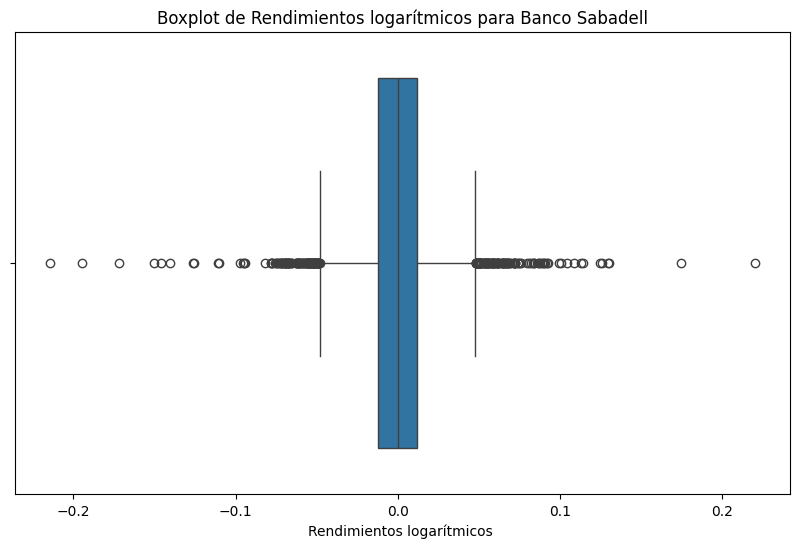

Outliers en Banco Sabadell:
     Exchange Date     Close       Net      %Chg      Open       Low  \
58      2024-11-06  1.752500 -0.121500 -0.064835  1.883500  1.728000   
84      2024-10-01  1.784500 -0.124500 -0.065217  1.899500  1.784000   
86      2024-09-27  1.913500 -0.096500 -0.048010  1.924000  1.895500   
127     2024-08-01  1.842500 -0.109500 -0.056096  1.940000  1.836000   
196     2024-04-25  1.637500  0.131500  0.087317  1.582000  1.579000   
...            ...       ...       ...       ...       ...       ...   
3728    2010-07-07  2.728830  0.176602  0.069195  2.543071  2.537838   
3741    2010-06-18  2.472430  0.117735  0.050000  2.354695  2.354695   
3746    2010-06-11  2.334418  0.179218  0.083156  2.178093  2.176131   
3770    2010-05-10  2.484857  0.208652  0.091667  2.482241  2.452807   
3835    2010-02-04  2.257163 -0.146369 -0.060897  2.404174  2.246891   

          High        Volume  Turnover - EUR          Flow  \
58    1.887000  3.639987e+07    6.455233e+07 

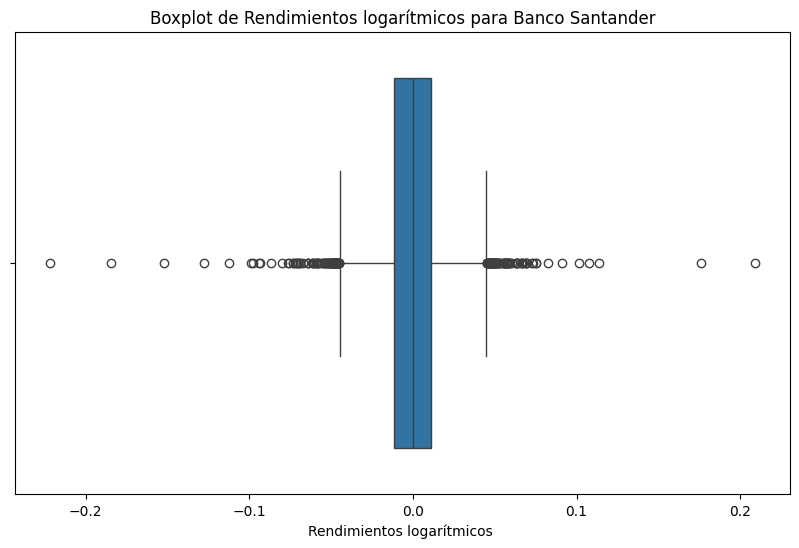

Outliers en Banco Santander:
     Exchange Date     Close       Net      %Chg      Open       Low  \
29      2024-12-17  4.460000 -0.211500 -0.045275  4.663000  4.460000   
58      2024-11-06  4.410000 -0.221500 -0.047825  4.640000  4.374000   
84      2024-10-01  4.376000 -0.224500 -0.048799  4.610000  4.334500   
126     2024-08-02  4.049000 -0.208500 -0.048972  4.189500  4.019500   
127     2024-08-01  4.257500 -0.197500 -0.044332  4.425000  4.246000   
...            ...       ...       ...       ...       ...       ...   
3770    2010-05-10  6.104062  1.150134  0.232166  5.911302  5.718542   
3772    2010-05-06  5.146688 -0.247375 -0.045861  5.300896  5.038743   
3774    2010-05-04  5.532208 -0.421501 -0.070796  5.871465  5.490443   
3779    2010-04-27  6.102134 -0.348896 -0.054084  6.384206  6.078361   
3835    2010-02-04  5.943429 -0.616831 -0.094025  6.573111  5.924795   

          High        Volume  Turnover - EUR          Flow  \
29    4.668500  3.831663e+07    1.727090e+08

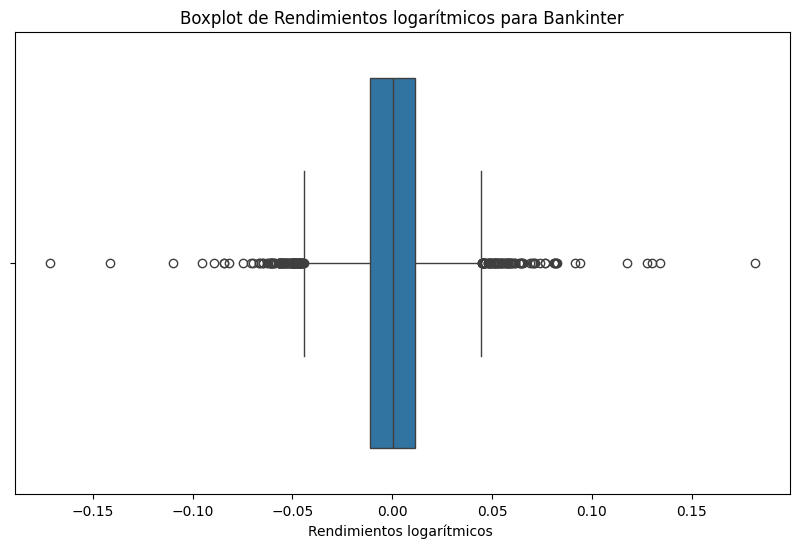

Outliers en Bankinter:
     Exchange Date     Close       Net      %Chg      Open       Low  \
84      2024-10-01  7.550000 -0.378000 -0.047679  7.902000  7.474000   
126     2024-08-02  7.214000 -0.412000 -0.054026  7.534000  7.214000   
137     2024-07-18  8.190000  0.368000  0.047047  7.906000  7.906000   
201     2024-04-18  7.278000  0.366000  0.052951  6.950000  6.784000   
259     2024-01-25  5.752000 -0.370000 -0.060438  5.800000  5.710000   
...            ...       ...       ...       ...       ...       ...   
3772    2010-05-06  2.232628 -0.101504 -0.043487  2.320752  2.185105   
3774    2010-05-04  2.415335 -0.121805 -0.048009  2.528373  2.413028   
3779    2010-04-27  2.537601 -0.154563 -0.057412  2.682936  2.537601   
3831    2010-02-10  2.871642  0.149488  0.054915  2.744762  2.744762   
3835    2010-02-04  2.754451 -0.131032 -0.045411  2.906707  2.745684   

          High        Volume  Turnover - EUR          Flow  \
84    7.920000  3.999243e+06    3.038641e+07  2.74

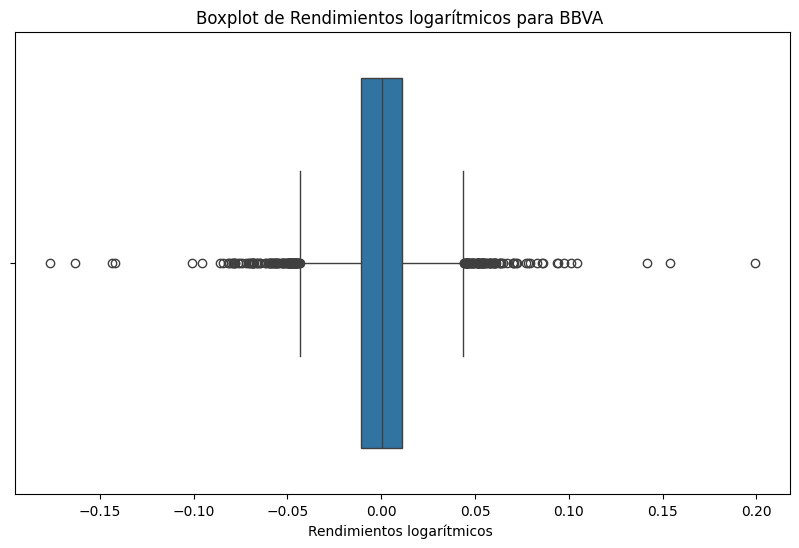

Outliers en BBVA :
     Exchange Date     Close       Net      %Chg      Open       Low  \
18      2025-01-06  9.744000  0.426000  0.045718  9.378000  9.342000   
58      2024-11-06  8.970000 -0.636000 -0.066209  9.364000  8.894000   
127     2024-08-01  9.210000 -0.494000 -0.050907  9.512000  9.168000   
128     2024-07-31  9.704000 -0.471000 -0.046290  9.958000  9.668000   
187     2024-05-09  9.600000 -0.690000 -0.067055  9.848000  9.600000   
...            ...       ...       ...       ...       ...       ...   
3772    2010-05-06  6.570094 -0.328347 -0.047597  6.748834  6.398440   
3774    2010-05-04  7.159859 -0.588190 -0.075915  7.661435  7.086630   
3778    2010-04-28  7.566946 -0.377954 -0.047572  7.716553  7.480332   
3779    2010-04-27  7.944900 -0.484253 -0.057450  8.346476  7.937026   
3835    2010-02-04  7.840963 -0.639371 -0.075395  8.393720  7.799230   

           High        Volume  Turnover - EUR          Flow  \
18     9.750000  1.051684e+07    1.010291e+08 -6.7571

KeyboardInterrupt: 

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


file_path = '/content/BASE DE DATOS ! .xlsx'
xls = pd.ExcelFile(file_path)


for sheet_name in xls.sheet_names:
    df = pd.read_excel(xls, sheet_name=sheet_name)


    if 'Rendimientos logarítmicos ' in df.columns:

        plt.figure(figsize=(10, 6))
        sns.boxplot(x=df['Rendimientos logarítmicos '])
        plt.title(f'Boxplot de Rendimientos logarítmicos para {sheet_name}')
        plt.show()


        Q1 = df['Rendimientos logarítmicos '].quantile(0.25)
        Q3 = df['Rendimientos logarítmicos '].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        outliers = df[(df['Rendimientos logarítmicos '] < lower_bound) |
                      (df['Rendimientos logarítmicos '] > upper_bound)]


        print(f"Outliers en {sheet_name}:")
        print(outliers)


        df['Rendimientos logarítmicos '] = df['Rendimientos logarítmicos '].apply(
            lambda x: df['Rendimientos logarítmicos '].mean() if x < lower_bound or x > upper_bound else x
        )




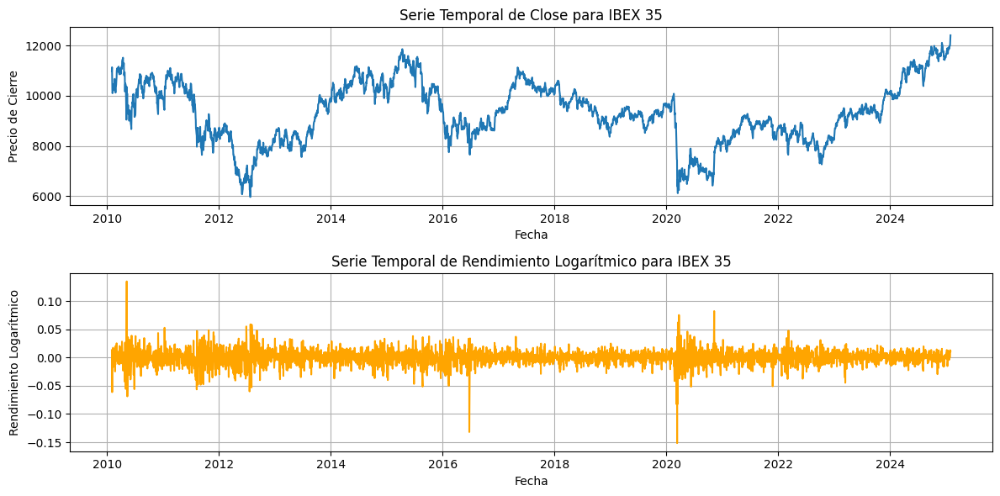

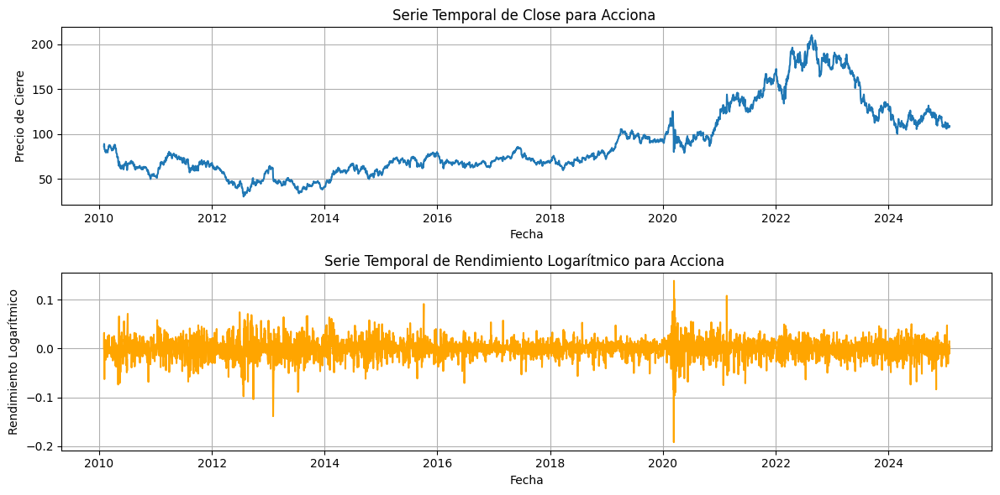

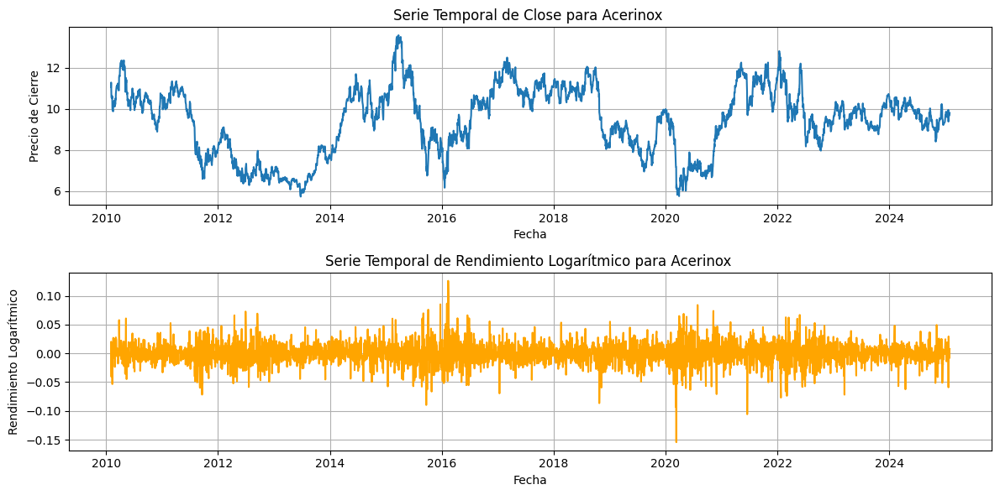

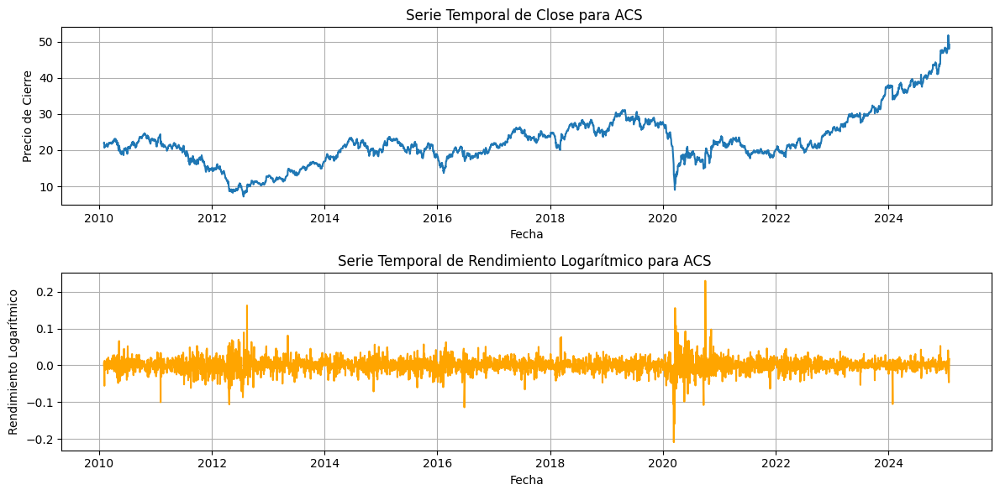

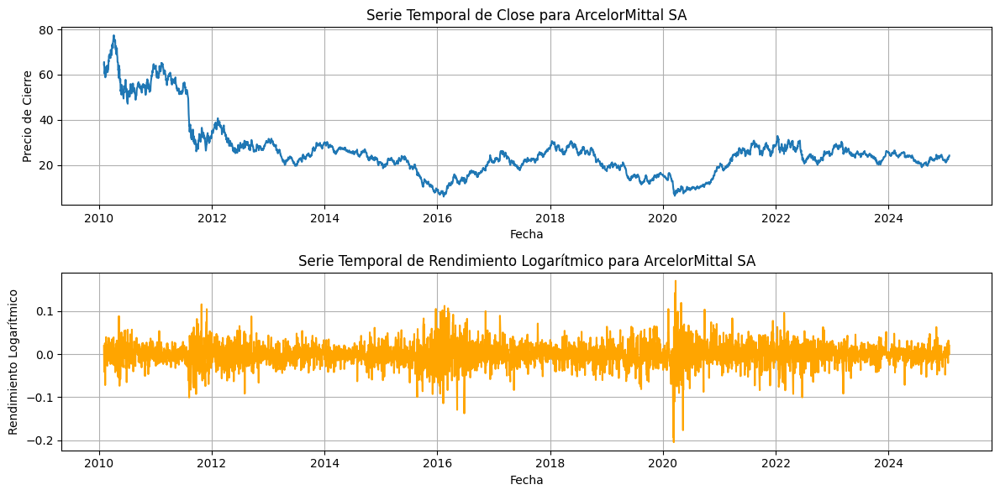

...

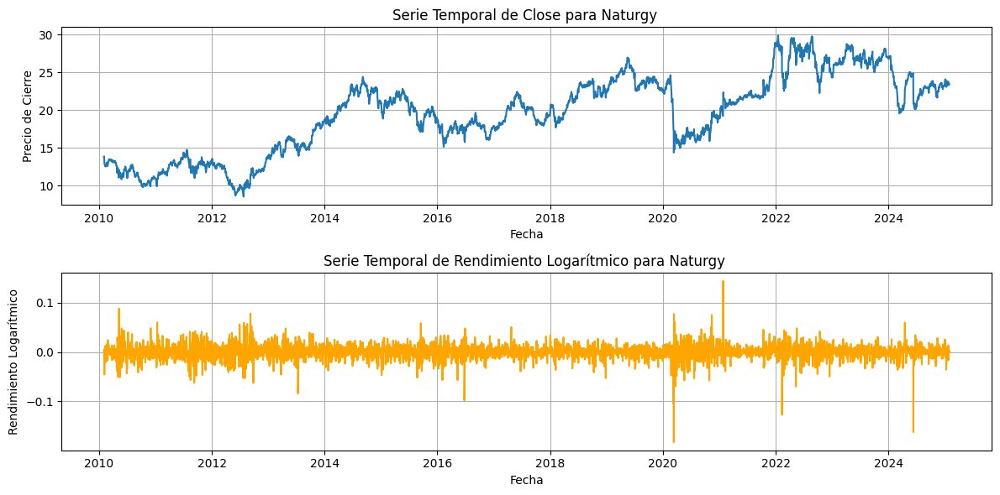

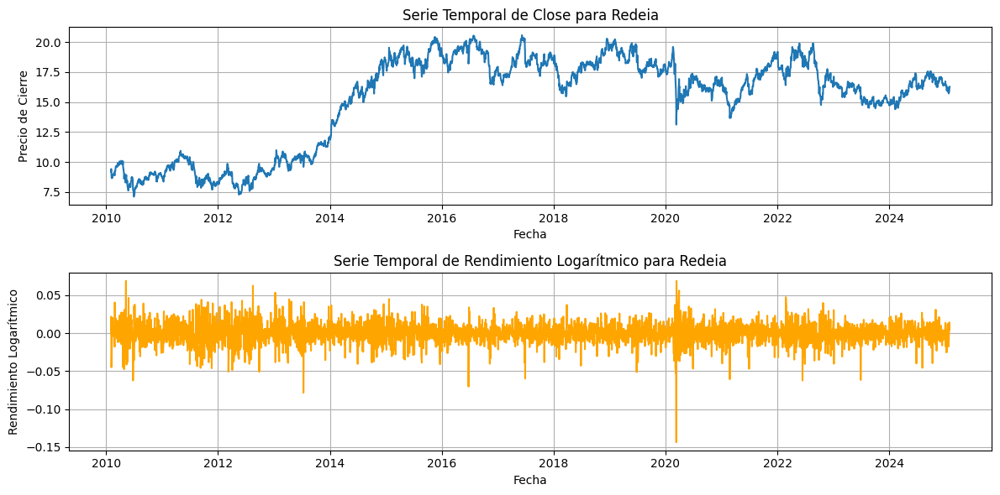

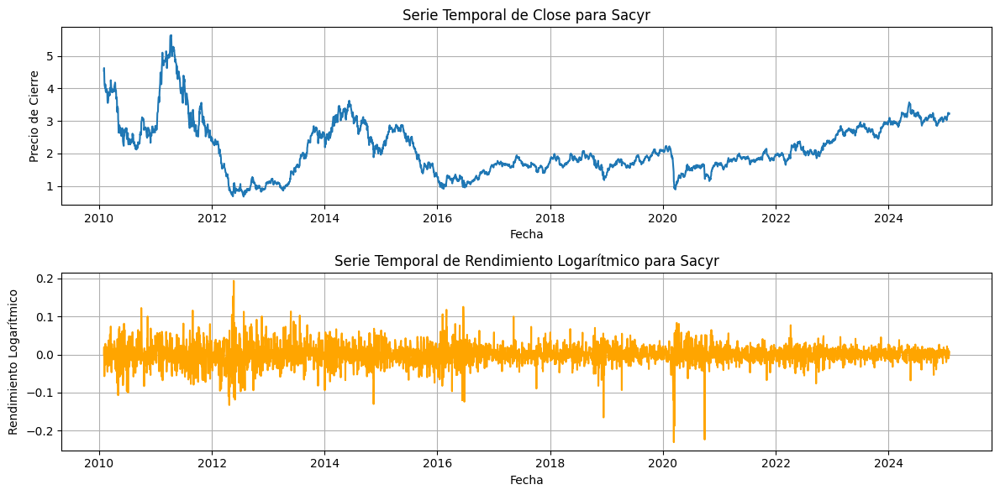

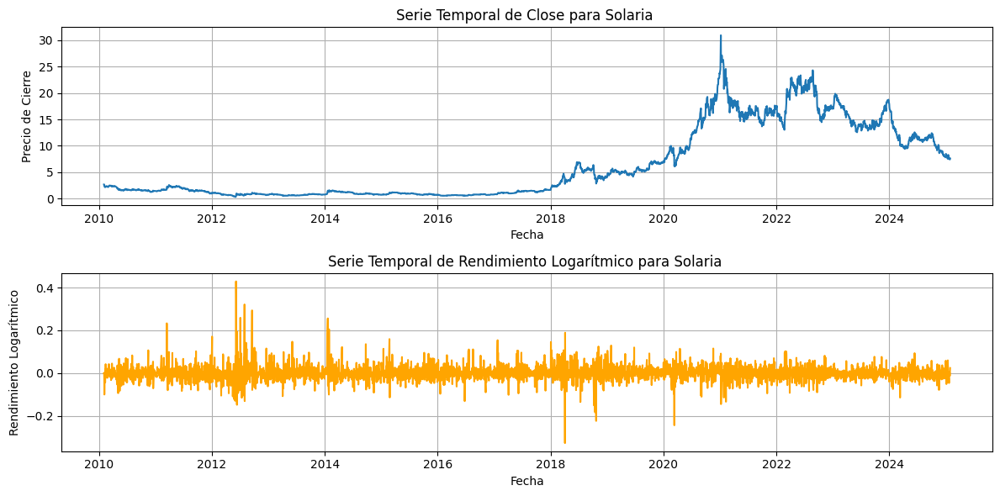

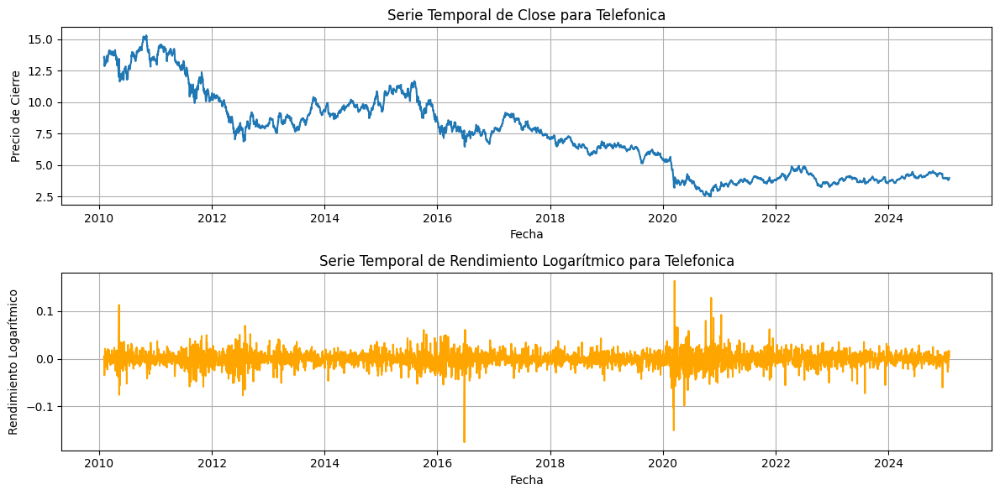

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt


file_path = '/content/BASE DE DATOS ! .xlsx'
xls = pd.ExcelFile(file_path)

for sheet_name in xls.sheet_names:
    df = pd.read_excel(xls, sheet_name=sheet_name)

    if 'Close' in df.columns and 'Rendimientos logarítmicos ' in df.columns:
        plt.figure(figsize=(12, 6))

        plt.subplot(2, 1, 1)
        plt.plot(df['Exchange Date'], df['Close'], label=f'Close - {sheet_name}')
        plt.title(f'Serie Temporal de Close para {sheet_name}')
        plt.xlabel('Fecha')
        plt.ylabel('Precio de Cierre')
        plt.grid(True)

        plt.subplot(2, 1, 2)
        plt.plot(df['Exchange Date'], df['Rendimientos logarítmicos '], label=f'Rendimiento Logarítmico - {sheet_name}', color='orange')
        plt.title(f'Serie Temporal de Rendimiento Logarítmico para {sheet_name}')
        plt.xlabel('Fecha')
        plt.ylabel('Rendimiento Logarítmico')
        plt.grid(True)


        plt.tight_layout()
        plt.show()


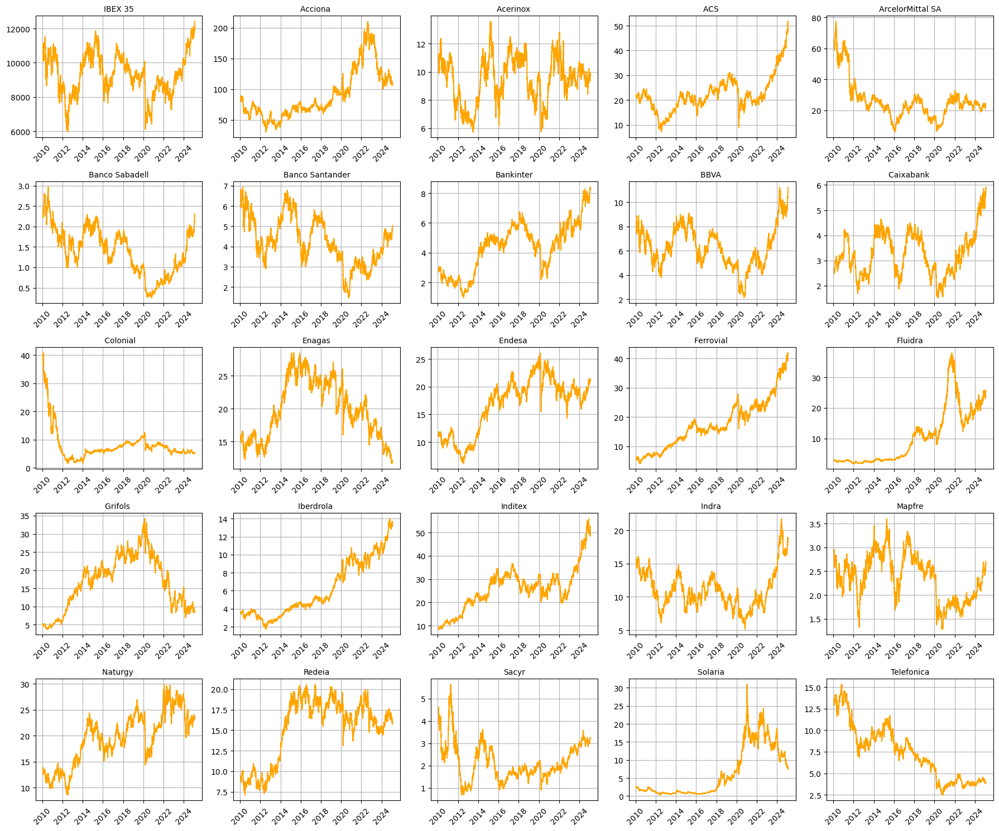

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import math

# Cargar el archivo Excel
file_path = '/content/BASE DE DATOS ! .xlsx'  # Asegúrate de usar la ruta correcta
xls = pd.ExcelFile(file_path)

# Obtener el número de empresas (hojas en el Excel)
num_empresas = len(xls.sheet_names)

# Configurar el número de columnas y calcular filas necesarias
num_cols = 5  # Aumentado a 5 columnas
num_rows = math.ceil(num_empresas / num_cols)  # Se ajusta dinámicamente según la cantidad de empresas

# Crear la figura y los subgráficos
fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(18, num_rows * 3))
axes = axes.flatten()  # Convertir en un array 1D para iterar más fácil

# Iterar sobre cada hoja del Excel y graficar
for i, sheet_name in enumerate(xls.sheet_names):
    df = pd.read_excel(xls, sheet_name=sheet_name)

    if 'Exchange Date' in df.columns and 'Close' in df.columns:
        ax = axes[i]
        ax.plot(df['Exchange Date'], df['Close'], color='orange')
        ax.set_title(sheet_name, fontsize=10)
        ax.tick_params(axis='x', rotation=45)
        ax.grid(True)

# Eliminar gráficos vacíos si hay menos empresas que espacios en la cuadrícula
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Ajustar el diseño de los gráficos
plt.tight_layout()
plt.show()


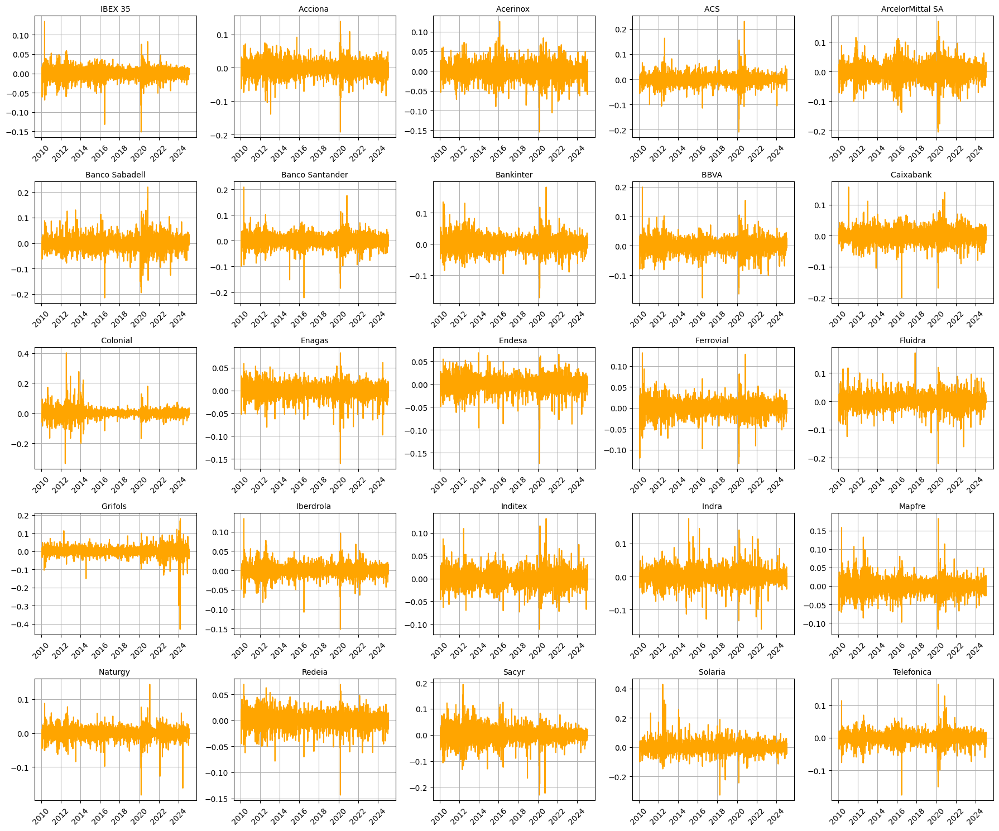

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import math

# Cargar el archivo Excel
file_path = '/content/BASE DE DATOS ! .xlsx'  # Asegúrate de usar la ruta correcta
xls = pd.ExcelFile(file_path)

# Obtener el número de empresas (hojas en el Excel)
num_empresas = len(xls.sheet_names)

# Configurar el número de columnas y calcular filas necesarias
num_cols = 5  # Aumentado a 5 columnas
num_rows = math.ceil(num_empresas / num_cols)  # Se ajusta dinámicamente según la cantidad de empresas

# Crear la figura y los subgráficos
fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(18, num_rows * 3))
axes = axes.flatten()  # Convertir en un array 1D para iterar más fácil

# Iterar sobre cada hoja del Excel y graficar
for i, sheet_name in enumerate(xls.sheet_names):
    df = pd.read_excel(xls, sheet_name=sheet_name)

    if 'Exchange Date' in df.columns and 'Rendimientos logarítmicos ' in df.columns:
        ax = axes[i]
        ax.plot(df['Exchange Date'], df['Rendimientos logarítmicos '], color='orange')
        ax.set_title(sheet_name, fontsize=10)
        ax.tick_params(axis='x', rotation=45)
        ax.grid(True)

# Eliminar gráficos vacíos si hay menos empresas que espacios en la cuadrícula
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Ajustar el diseño de los gráficos
plt.tight_layout()
plt.show()

In [ ]:
import pandas as pd


archivo_excel = '/content/BASE DE DATOS ! .xlsx'
df = pd.read_excel(archivo_excel)


Q1 = df['Rendimientos logarítmicos '].quantile(0.25)
Q3 = df['Rendimientos logarítmicos '].quantile(0.75)
IQR = Q3 - Q1


limite_inferior = Q1 - 1.5 * IQR
limite_superior = Q3 + 1.5 * IQR


outliers = df[(df['Rendimientos logarítmicos '] < limite_inferior) |
              (df['Rendimientos logarítmicos '] > limite_superior)]


print(outliers)


     Exchange Date    Close    Net      %Chg     Open      Low     High  \
58      2024-11-06  11495.3 -343.9 -0.029048  11779.4  11461.2  11794.7   
479     2023-03-15   8759.1 -399.9 -0.043662   9161.8   8736.5   9169.7   
481     2023-03-13   8958.9 -326.1 -0.035121   9272.3   8894.5   9273.6   
594     2022-10-04   7696.6  234.6  0.031439   7548.5   7529.2   7699.9   
676     2022-06-10   8390.6 -320.6 -0.036803   8662.0   8362.8   8671.3   
...            ...      ...    ...       ...      ...      ...      ...   
3774    2010-05-04   9859.1 -563.7 -0.054083  10363.6   9812.8  10411.8   
3778    2010-04-28  10167.0 -313.9 -0.029950  10350.8  10077.9  10480.3   
3779    2010-04-27  10480.9 -458.4 -0.041904  10884.6  10480.9  10904.5   
3791    2010-04-09  11394.2  317.9  0.028701  11161.1  11139.5  11408.5   
3835    2010-02-04  10241.7 -646.7 -0.059393  10882.3  10220.7  10920.1   

         Volume  Turnover - EUR             Flow  Rendimientos logarítmicos   \
58    215400623   1

In [ ]:
print(df.shape)  # Devuelve (número de filas, número de columnas)
pd.set_option('display.max_rows', None)
print(df)


Se han truncado las últimas 5000 líneas del flujo de salida.
2680   173366524   1252571851000    7879817848000                    0.008740   
2681   274092021   1826260733000    6627245997000                    0.002596   
2682   321042461   2335979163000    4800985264000                   -0.016493   
2683   306362922   2136085275000    7136964427000                   -0.010447   
2684   258778763   1892509995000    9273049702000                   -0.013660   
2685   206949808   1585068678000   11165559697000                   -0.001694   
2686   297750904   2288502396000   12750628375000                   -0.018209   
2687   302656390   2355746674000   15039130771000                   -0.021272   
2688   241840306   1836329731000   17394877445000                    0.003315   
2689   199820711   1501642559000   15558547714000                    0.001965   
2690   200633413   1382800371000   14056905155000                   -0.000763   
2691   273050867   1999014604000   1543970552600

In [ ]:
import pandas as pd


file_path = "/content/BASE DE DATOS ! .xlsx"


xls = pd.ExcelFile(file_path)

hojas = xls.sheet_names

correlaciones = {}

for hoja in hojas:
    df = pd.read_excel(xls, sheet_name=hoja)

    df_numeric = df.select_dtypes(include=['float64', 'int64'])


    correlacion = df_numeric.corr()

    correlaciones[hoja] = correlacion

    print(f"\n Correlación para {hoja}:\n")
    print(correlacion)



📌 Correlación para IBEX 35:

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.055538  0.050048  0.996362  0.998442   
Net                         0.055538  1.000000  0.988507 -0.018135  0.023168   
%Chg                        0.050048  0.988507  1.000000 -0.022454  0.017590   
Open                        0.996362 -0.018135 -0.022454  1.000000  0.998028   
Low                         0.998442  0.023168  0.017590  0.998028  1.000000   
High                        0.998210  0.013763  0.009267  0.998544  0.997669   
Volume                     -0.117728 -0.078399 -0.072376 -0.112025 -0.134786   
Turnover - EUR              0.222842 -0.061377 -0.054182  0.227590  0.201716   
Flow                        0.191268  0.017451  0.013507  0.189662  0.203554   
Rendimientos logarítmicos   0.996325  0.055129  0.050908  0.992635  0.995213   
Rango intraperiodo         -0.063248 -0.138580 -0.122468 -0.052312 -0.093967   
Ratio aper


📌 Correlación para IBEX 35:

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.055538  0.050048  0.996362  0.998442   
Net                         0.055538  1.000000  0.988507 -0.018135  0.023168   
%Chg                        0.050048  0.988507  1.000000 -0.022454  0.017590   
Open                        0.996362 -0.018135 -0.022454  1.000000  0.998028   
Low                         0.998442  0.023168  0.017590  0.998028  1.000000   
High                        0.998210  0.013763  0.009267  0.998544  0.997669   
Volume                     -0.117728 -0.078399 -0.072376 -0.112025 -0.134786   
Turnover - EUR              0.222842 -0.061377 -0.054182  0.227590  0.201716   
Flow                        0.191268  0.017451  0.013507  0.189662  0.203554   
Rendimientos logarítmicos   0.053400  0.988252  0.999702 -0.018975  0.021449   
Volatilidad                -0.142408 -0.119386 -0.120119 -0.138029 -0.158490   
Ratio aper

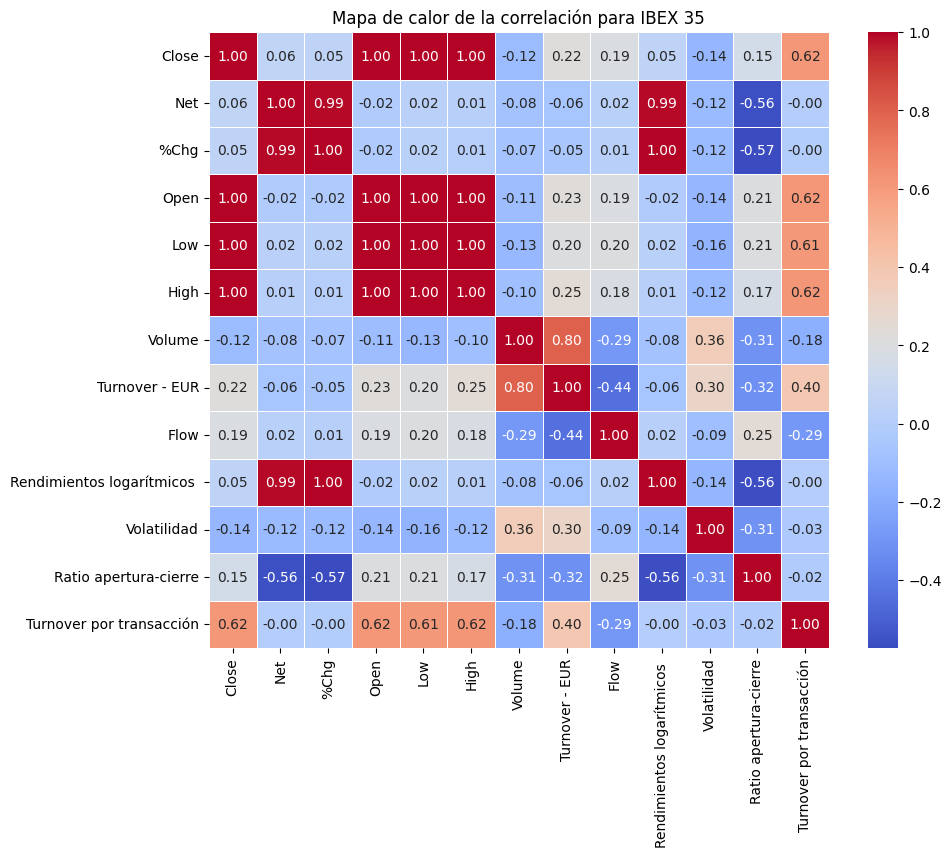


📌 Correlación para Acciona :

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.023537  0.019885  0.999108  0.999625   
Net                         0.023537  1.000000  0.910568 -0.014276  0.007197   
%Chg                        0.019885  0.910568  1.000000 -0.014273  0.004673   
Open                        0.999108 -0.014276 -0.014273  1.000000  0.999497   
Low                         0.999625  0.007197  0.004673  0.999497  1.000000   
High                        0.999597  0.003540  0.002066  0.999607  0.999453   
Volume                     -0.403574 -0.045038 -0.049042 -0.402003 -0.408236   
Turnover - EUR              0.100060 -0.039876 -0.036329  0.101682  0.095281   
Flow                        0.875541  0.017048  0.013363  0.875025  0.873945   
Rendimientos logarítmicos   0.021397  0.910841  0.999647 -0.012772  0.006430   
Volatilidad                -0.058514 -0.143872 -0.134455 -0.053156 -0.065303   
Ratio ape

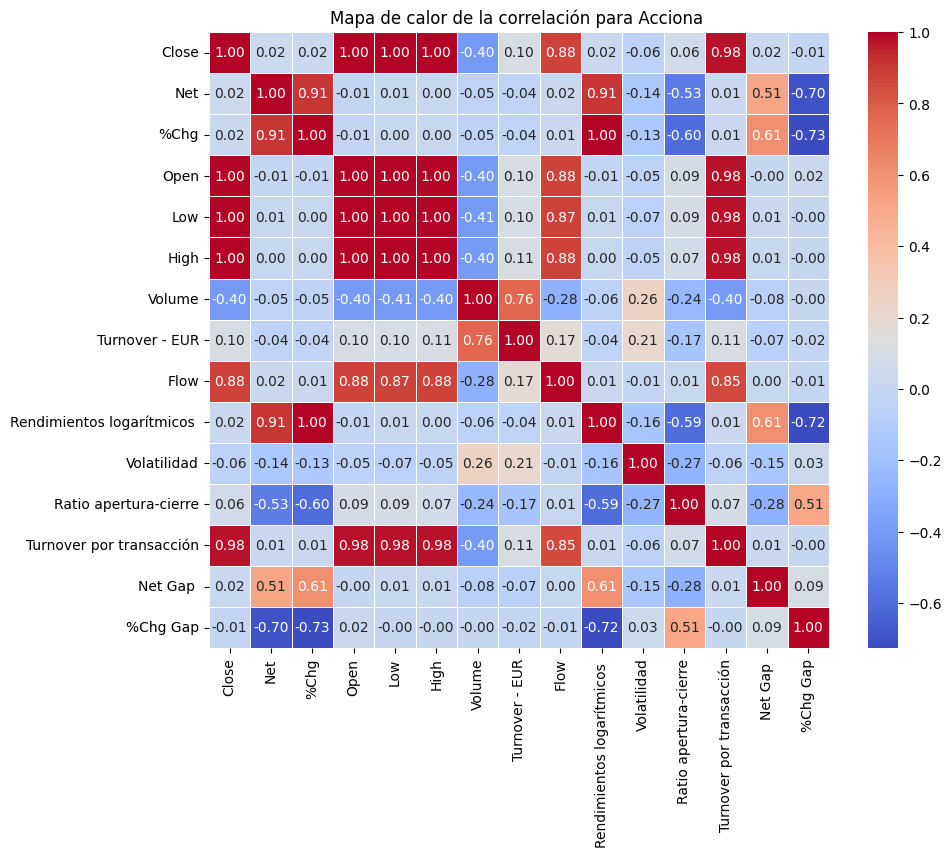


📌 Correlación para Acerinox :

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.052285  0.049035  0.995427  0.997897   
Net                         0.052285  1.000000  0.983181 -0.030744  0.017267   
%Chg                        0.049035  0.983181  1.000000 -0.032511  0.013607   
Open                        0.995427 -0.030744 -0.032511  1.000000  0.997414   
Low                         0.997897  0.017267  0.013607  0.997414  1.000000   
High                        0.997922  0.009761  0.007780  0.997832  0.997066   
Volume                      0.082005 -0.027624 -0.016282  0.082911  0.060041   
Turnover - EUR              0.313425 -0.010322 -0.000467  0.313041  0.293043   
Flow                        0.590787  0.028990  0.027900  0.588870  0.590159   
Rendimientos logarítmicos   0.051528  0.983460  0.999754 -0.029982  0.016568   
Volatilidad                -0.114068 -0.053966 -0.032305 -0.111857 -0.133348   
Ratio ap

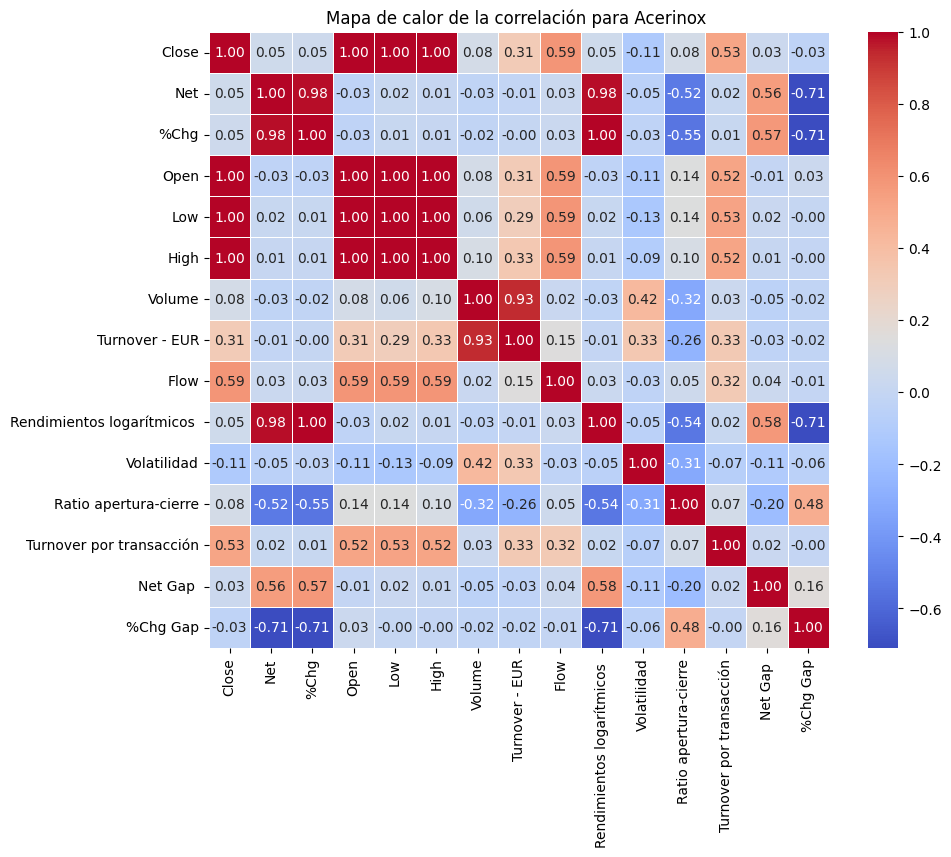


📌 Correlación para ACS :

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.061787  0.037092  0.998830  0.999494   
Net                         0.061787  1.000000  0.939046  0.020014  0.043114   
%Chg                        0.037092  0.939046  1.000000 -0.002133  0.018984   
Open                        0.998830  0.020014 -0.002133  1.000000  0.999398   
Low                         0.999494  0.043114  0.018984  0.999398  1.000000   
High                        0.999477  0.039818  0.016919  0.999468  0.999306   
Volume                     -0.377782 -0.117614 -0.100629 -0.374515 -0.384514   
Turnover - EUR              0.034332 -0.033891 -0.036486  0.034201  0.027645   
Flow                        0.638473  0.008298 -0.003892  0.639927  0.636931   
Rendimientos logarítmicos   0.042686  0.940638  0.999147  0.003489  0.024990   
Volatilidad                -0.135004 -0.012395  0.043350 -0.136814 -0.145506   
Ratio apertur

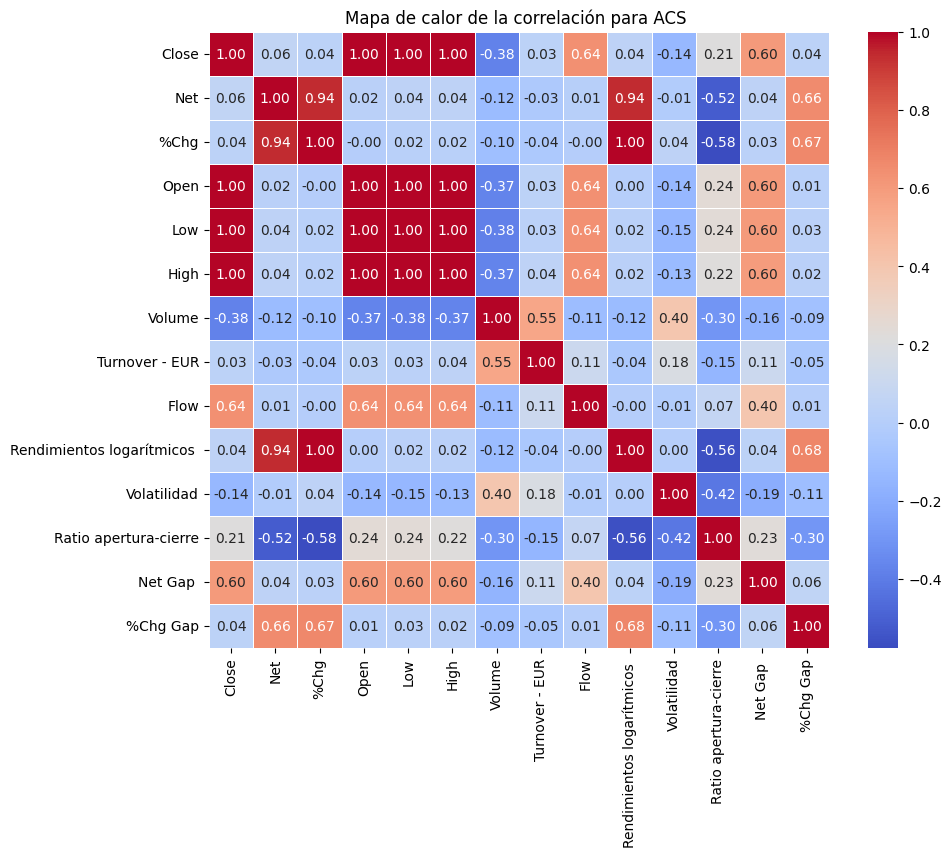


📌 Correlación para ArcelorMittal SA:

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.003957  0.007015  0.999000  0.999585   
Net                         0.003957  1.000000  0.867299 -0.034213 -0.013572   
%Chg                        0.007015  0.867299  1.000000 -0.026321 -0.008783   
Open                        0.999000 -0.034213 -0.026321  1.000000  0.999508   
Low                         0.999585 -0.013572 -0.008783  0.999508  1.000000   
High                        0.999531 -0.017533 -0.011060  0.999609  0.999480   
Volume                     -0.372119 -0.023789 -0.000424 -0.371018 -0.379505   
Turnover - EUR              0.516987 -0.052468 -0.014524  0.518501  0.509458   
Flow                        0.785552  0.019350  0.015925  0.783876  0.786046   
Rendimientos logarítmicos   0.013644  0.867412  0.999303 -0.019700 -0.001969   
Volatilidad                -0.145751 -0.052766 -0.048090 -0.144188 -0.151846   
R

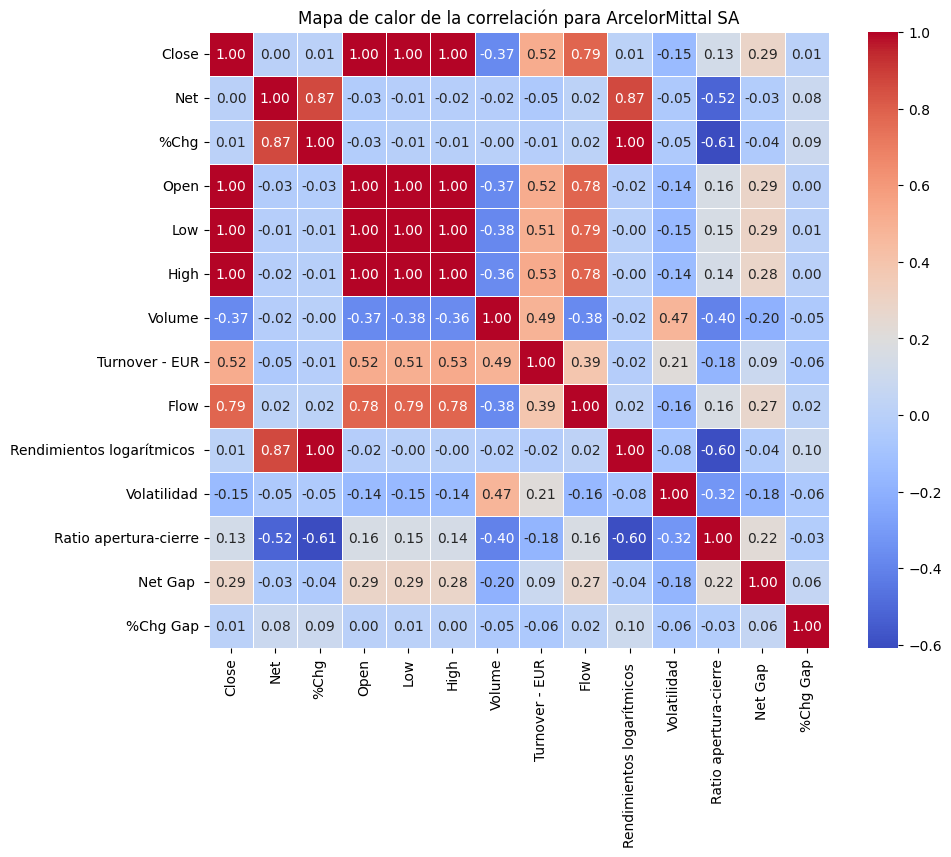


📌 Correlación para Banco Sabadell:

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.026107  0.017445  0.998646  0.999399   
Net                         0.026107  1.000000  0.878343 -0.019775  0.004323   
%Chg                        0.017445  0.878343  1.000000 -0.022468 -0.001966   
Open                        0.998646 -0.019775 -0.022468  1.000000  0.999324   
Low                         0.999399  0.004323 -0.001966  0.999324  1.000000   
High                        0.999441  0.004045 -0.001857  0.999374  0.999215   
Volume                     -0.382170  0.003056  0.016238 -0.381929 -0.389416   
Turnover - EUR              0.213029  0.024666  0.024248  0.212518  0.204432   
Flow                        0.271759  0.048107  0.037437  0.270322  0.273600   
Rendimientos logarítmicos   0.023665  0.879153  0.999240 -0.016122  0.004643   
Volatilidad                -0.159553 -0.019200  0.013521 -0.162634 -0.169422   
Rat

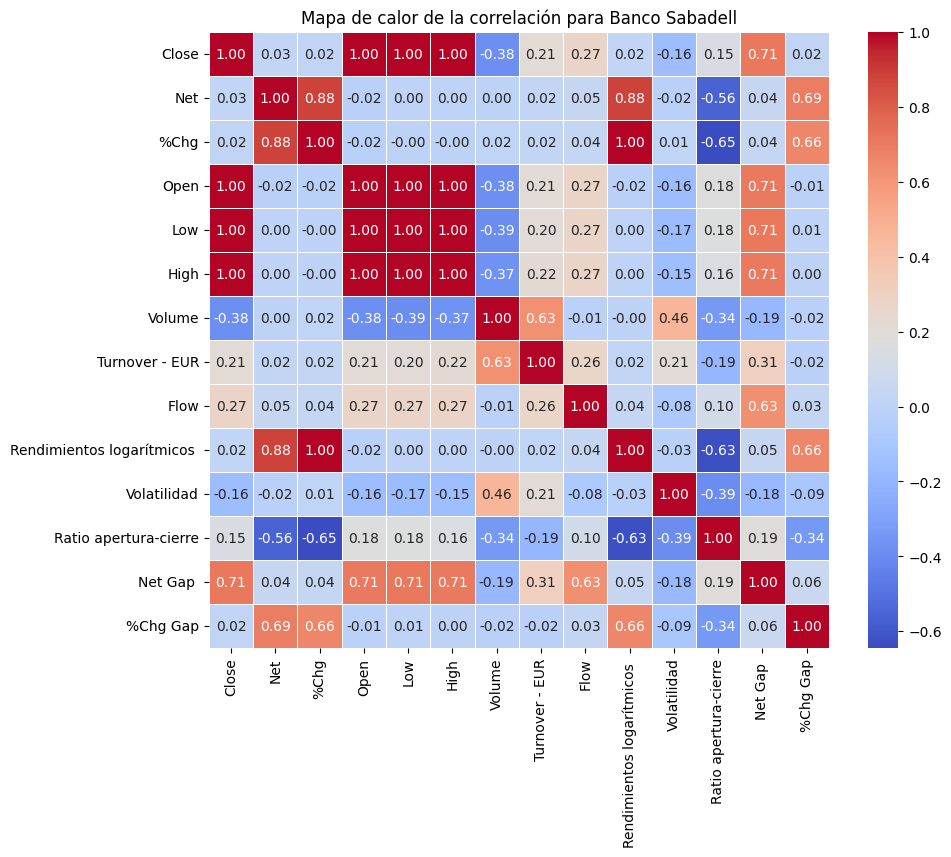


📌 Correlación para Banco Santander:

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.030728  0.027242  0.997853  0.999079   
Net                         0.030728  1.000000  0.949257 -0.024131  0.005112   
%Chg                        0.027242  0.949257  1.000000 -0.024948  0.002155   
Open                        0.997853 -0.024131 -0.024948  1.000000  0.998857   
Low                         0.999079  0.005112  0.002155  0.998857  1.000000   
High                        0.998973 -0.000128 -0.001562  0.999109  0.998669   
Volume                      0.119833 -0.068238 -0.054799  0.123022  0.102236   
Turnover - EUR              0.487716 -0.041714 -0.029823  0.489669  0.472018   
Flow                        0.014162  0.018314  0.013210  0.012596  0.022570   
Rendimientos logarítmicos   0.030930  0.949382  0.999320 -0.021181  0.006318   
Volatilidad                -0.101918 -0.048610 -0.030216 -0.101491 -0.113450   
Ra

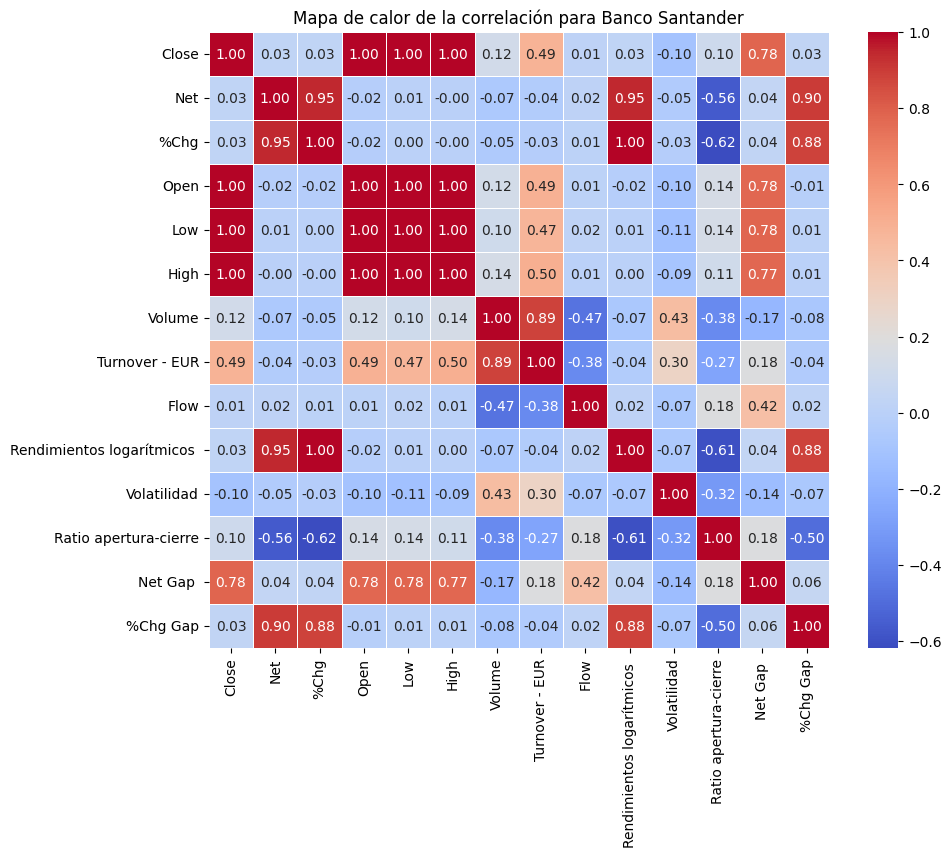


📌 Correlación para Bankinter:

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.037314  0.022765  0.998981  0.999579   
Net                         0.037314  1.000000  0.901210 -0.002820  0.019654   
%Chg                        0.022765  0.901210  1.000000 -0.013490  0.005688   
Open                        0.998981 -0.002820 -0.013490  1.000000  0.999454   
Low                         0.999579  0.019654  0.005688  0.999454  1.000000   
High                        0.999526  0.015755  0.004089  0.999571  0.999403   
Volume                     -0.167809  0.005586  0.028969 -0.168160 -0.175005   
Turnover - EUR              0.234664  0.009622  0.023691  0.234495  0.228399   
Flow                        0.902039  0.010588 -0.000067  0.902144  0.901880   
Rendimientos logarítmicos   0.028378  0.903691  0.999579 -0.007935  0.011514   
Volatilidad                -0.190460 -0.008228  0.096192 -0.191471 -0.199203   
Ratio ap

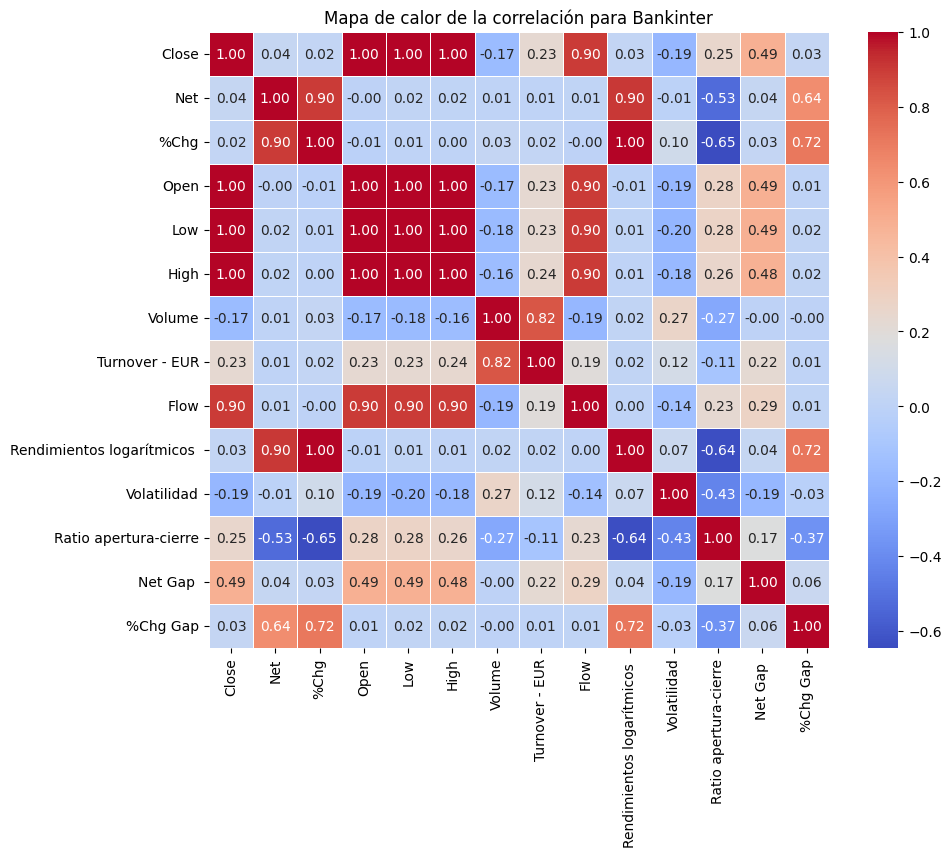


📌 Correlación para BBVA :

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.048552  0.036997  0.997881  0.999119   
Net                         0.048552  1.000000  0.949493 -0.006319  0.022946   
%Chg                        0.036997  0.949493  1.000000 -0.014790  0.011939   
Open                        0.997881 -0.006319 -0.014790  1.000000  0.998916   
Low                         0.999119  0.022946  0.011939  0.998916  1.000000   
High                        0.999046  0.018545  0.009112  0.999124  0.998819   
Volume                     -0.105336 -0.044895 -0.032079 -0.103282 -0.119727   
Turnover - EUR              0.229437 -0.029794 -0.014192  0.231344  0.215988   
Flow                        0.651809  0.013491  0.009783  0.652335  0.648848   
Rendimientos logarítmicos   0.042048  0.949780  0.999450 -0.009691  0.017385   
Volatilidad                -0.153905 -0.014292  0.007871 -0.155002 -0.165697   
Ratio apertu

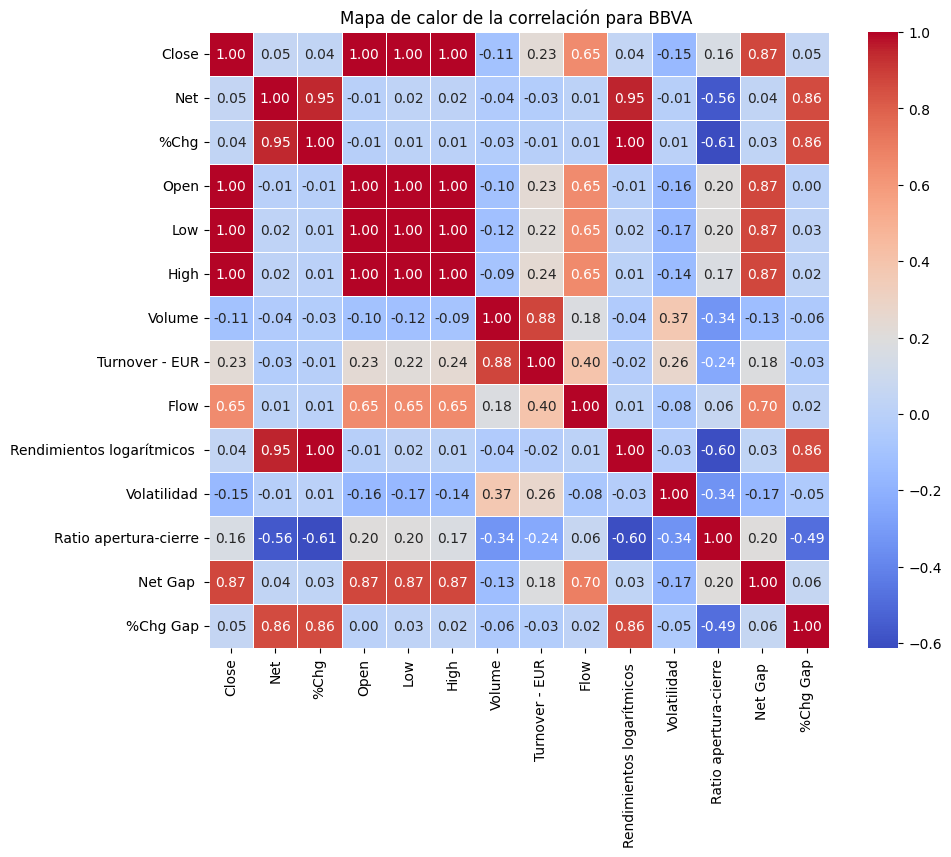


📌 Correlación para Caixabank :

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.051251  0.040035  0.997718  0.999078   
Net                         0.051251  1.000000  0.957135 -0.006026  0.025373   
%Chg                        0.040035  0.957135  1.000000 -0.014664  0.014354   
Open                        0.997718 -0.006026 -0.014664  1.000000  0.998786   
Low                         0.999078  0.025373  0.014354  0.998786  1.000000   
High                        0.998931  0.020083  0.010777  0.999089  0.998723   
Volume                      0.004687 -0.066138 -0.060303  0.007811 -0.005688   
Turnover - EUR              0.378412 -0.022886 -0.022878  0.380186  0.368676   
Flow                        0.805511  0.018306  0.009071  0.805893  0.805866   
Rendimientos logarítmicos   0.043503  0.957098  0.999569 -0.011088  0.018172   
Volatilidad                -0.134798 -0.059162 -0.050536 -0.132414 -0.145067   
Ratio a

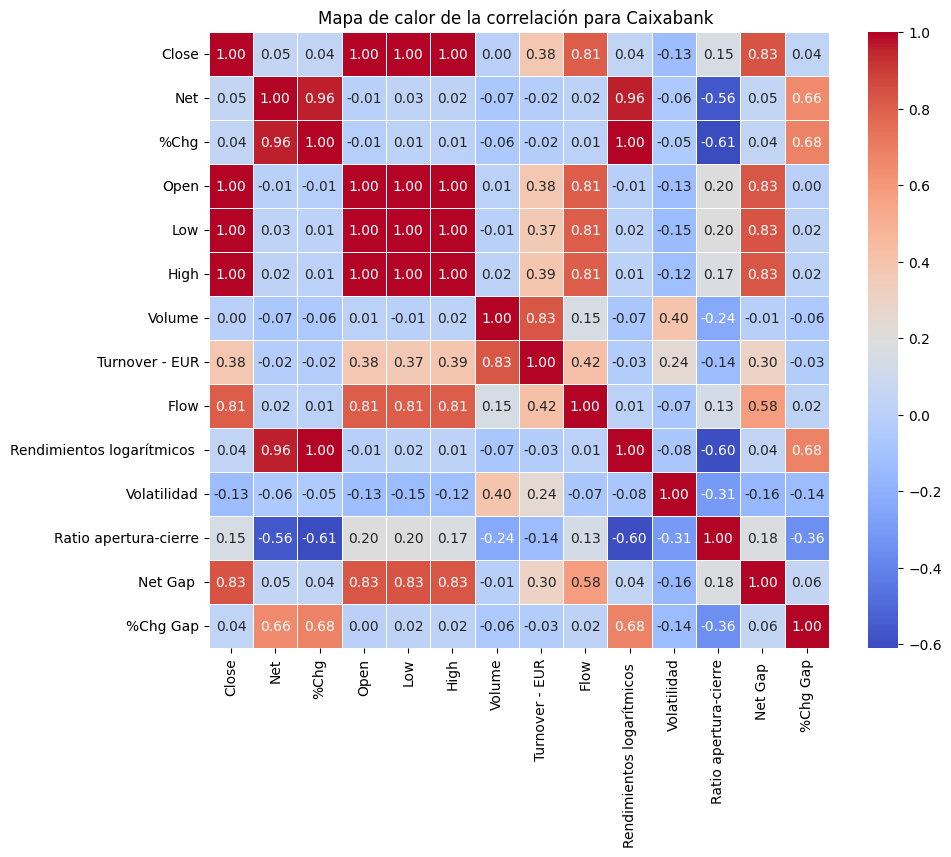


📌 Correlación para  Colonial:

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000 -0.061944 -0.014708  0.998842  0.999360   
Net                        -0.061944  1.000000  0.718437 -0.104682 -0.080922   
%Chg                       -0.014708  0.718437  1.000000 -0.045016 -0.029801   
Open                        0.998842 -0.104682 -0.045016  1.000000  0.999187   
Low                         0.999360 -0.080922 -0.029801  0.999187  1.000000   
High                        0.999341 -0.080692 -0.027137  0.999214  0.998679   
Volume                     -0.234282  0.036069  0.045864 -0.235386 -0.235383   
Turnover - EUR             -0.095040  0.031476  0.026605 -0.097013 -0.095871   
Flow                       -0.079804  0.030471  0.006196 -0.081672 -0.074898   
Rendimientos logarítmicos  -0.012030  0.725942  0.997098 -0.042531 -0.026535   
Volatilidad                -0.037536  0.073256  0.252337 -0.040511 -0.047868   
Ratio ap

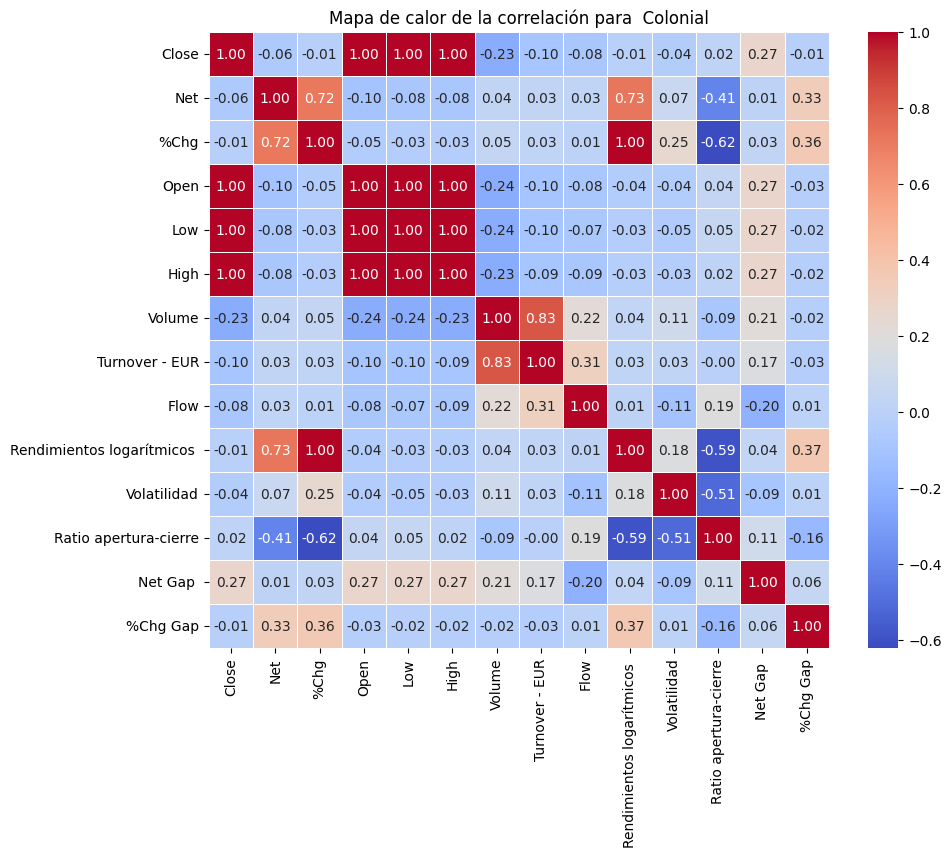


📌 Correlación para Enagas:

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.035042  0.034493  0.998509  0.999338   
Net                         0.035042  1.000000  0.975589 -0.012077  0.014987   
%Chg                        0.034493  0.975589  1.000000 -0.011826  0.014421   
Open                        0.998509 -0.012077 -0.011826  1.000000  0.999192   
Low                         0.999338  0.014987  0.014421  0.999192  1.000000   
High                        0.999247  0.007335  0.007809  0.999356  0.999057   
Volume                     -0.071583 -0.088735 -0.085010 -0.068146 -0.078396   
Turnover - EUR              0.304258 -0.079537 -0.073010  0.307271  0.297113   
Flow                        0.759316  0.008543  0.006798  0.758621  0.759946   
Rendimientos logarítmicos   0.035995  0.975705  0.999782 -0.010233  0.016191   
Volatilidad                -0.077543 -0.274899 -0.266932 -0.068661 -0.084107   
Ratio apert

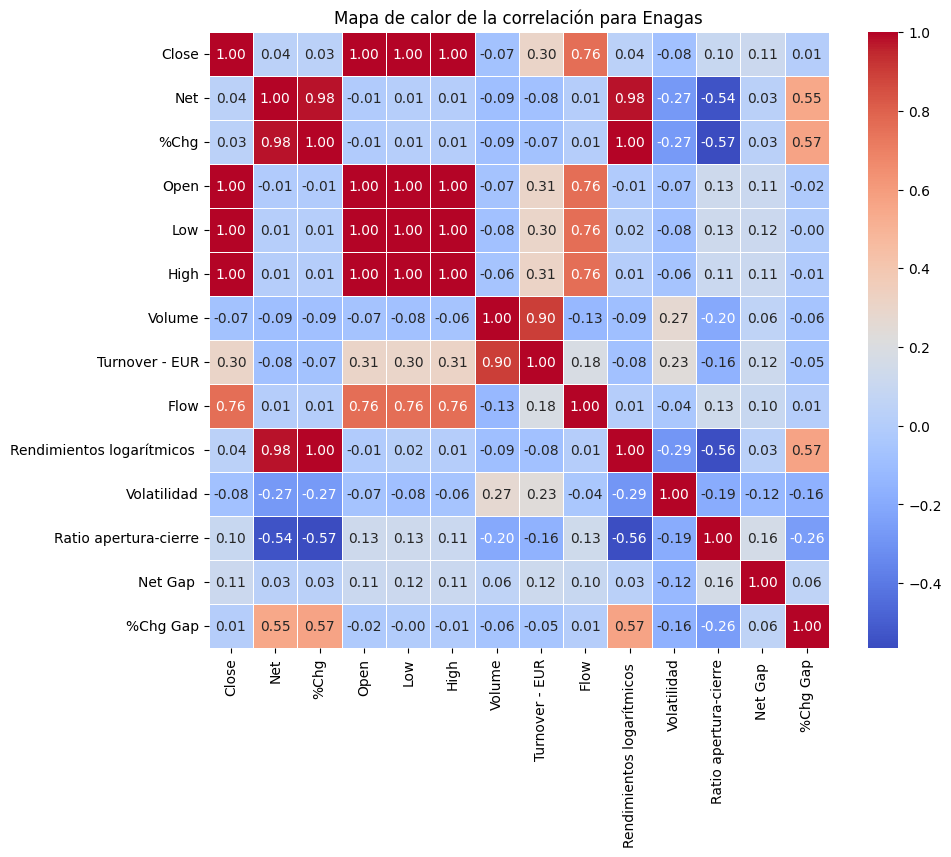


📌 Correlación para Endesa :

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.023931  0.019693  0.999075  0.999595   
Net                         0.023931  1.000000  0.948120 -0.012392  0.008053   
%Chg                        0.019693  0.948120  1.000000 -0.015220  0.004063   
Open                        0.999075 -0.012392 -0.015220  1.000000  0.999495   
Low                         0.999595  0.008053  0.004063  0.999495  1.000000   
High                        0.999548  0.003142  0.000056  0.999618  0.999446   
Volume                      0.294748 -0.024198 -0.012449  0.295589  0.290406   
Turnover - EUR              0.386844 -0.029623 -0.018625  0.387888  0.382845   
Flow                        0.914984  0.000991 -0.002014  0.915021  0.914493   
Rendimientos logarítmicos   0.021516  0.949267  0.999754 -0.013350  0.006099   
Volatilidad                -0.081959 -0.303010 -0.256096 -0.074469 -0.086848   
Ratio aper

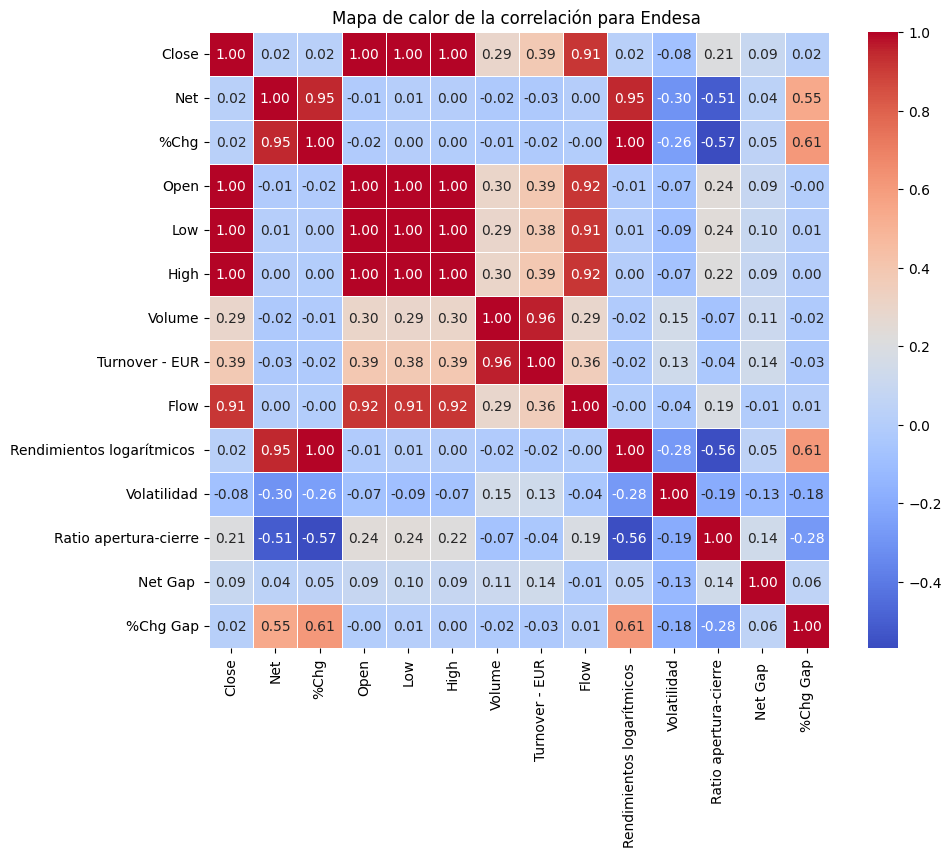


📌 Correlación para Ferrovial :

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.042699  0.017507  0.999600  0.999811   
Net                         0.042699  1.000000  0.882627  0.019381  0.032551   
%Chg                        0.017507  0.882627  1.000000 -0.003330  0.008290   
Open                        0.999600  0.019381 -0.003330  1.000000  0.999796   
Low                         0.999811  0.032551  0.008290  0.999796  1.000000   
High                        0.999809  0.030468  0.006697  0.999775  0.999722   
Volume                     -0.569721 -0.050569 -0.040589 -0.569918 -0.572134   
Turnover - EUR              0.162540 -0.018215 -0.026093  0.161932  0.159783   
Flow                        0.886286  0.034012  0.014710  0.885964  0.885859   
Rendimientos logarítmicos   0.019648  0.883618  0.999700 -0.001134  0.010598   
Volatilidad                -0.087573 -0.099202 -0.056004 -0.088271 -0.093689   
Ratio a

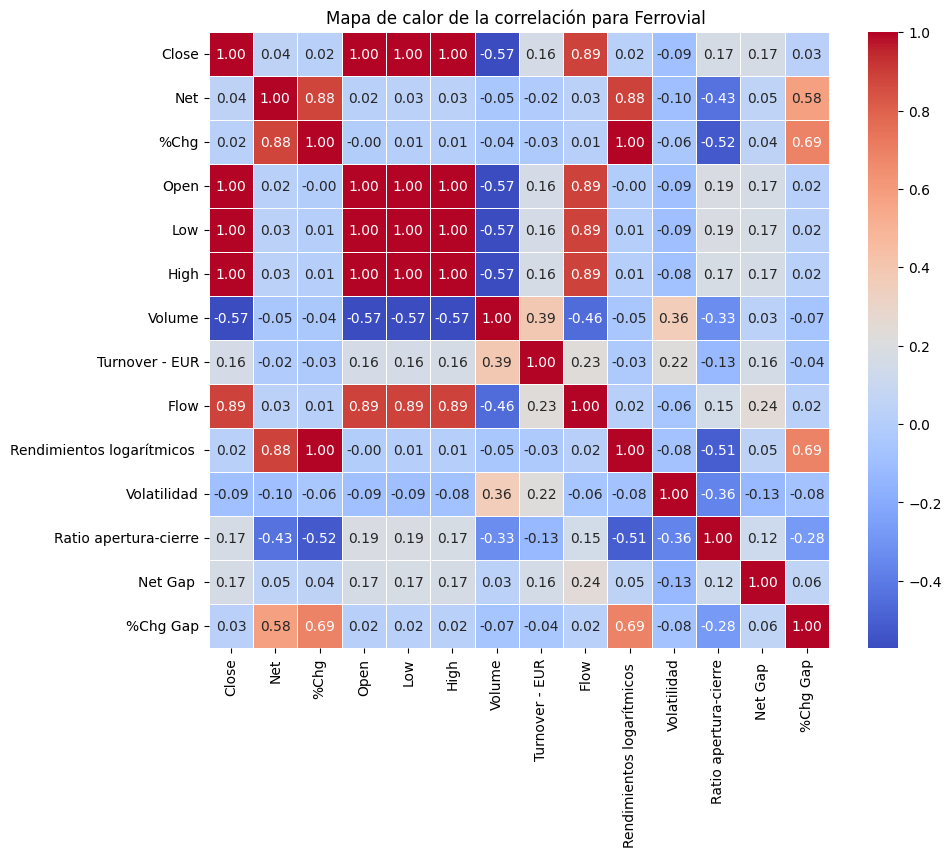


📌 Correlación para Fluidra:

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.025874  0.015565  0.999468  0.999788   
Net                         0.025874  1.000000  0.770679 -0.002566  0.013233   
%Chg                        0.015565  0.770679  1.000000 -0.006470  0.005105   
Open                        0.999468 -0.002566 -0.006470  1.000000  0.999729   
Low                         0.999788  0.013233  0.005105  0.999729  1.000000   
High                        0.999770  0.010859  0.004410  0.999758  0.999706   
Volume                      0.435826 -0.036993 -0.019837  0.436537  0.432850   
Turnover - EUR              0.702101 -0.025787 -0.009991  0.702575  0.699243   
Flow                        0.722957  0.048873  0.026307  0.721746  0.722539   
Rendimientos logarítmicos   0.014835  0.772430  0.999485 -0.007263  0.004542   
Volatilidad                 0.022757 -0.071599 -0.008336  0.025226  0.017832   
Ratio aper

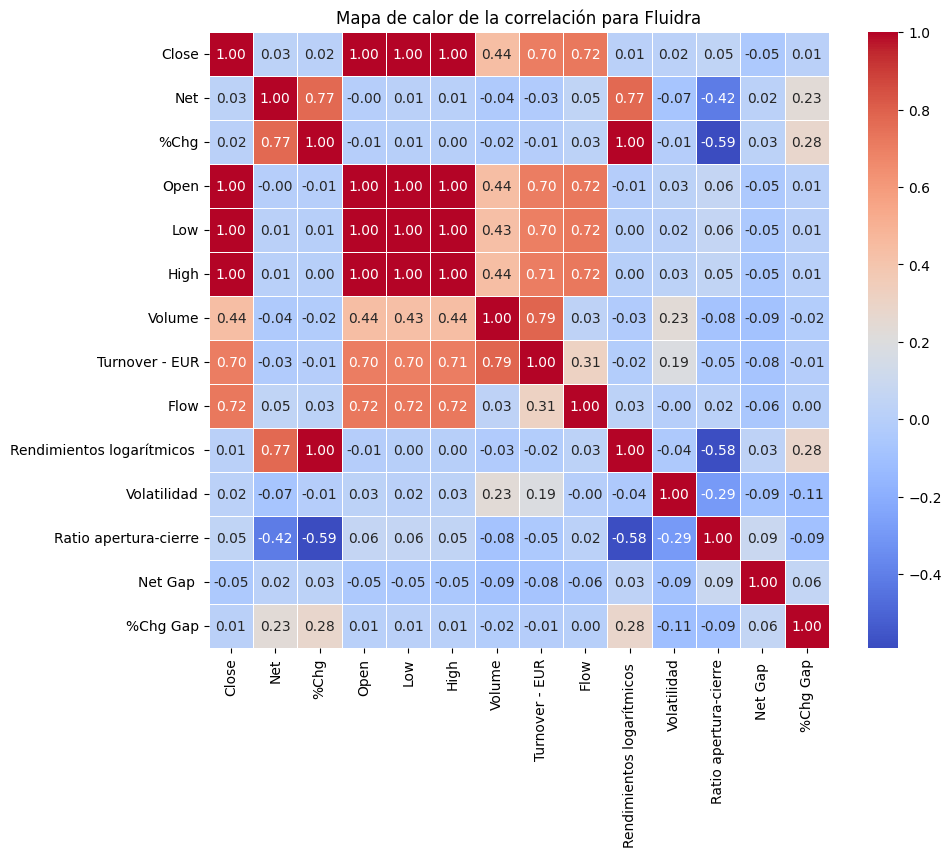


📌 Correlación para Grifols :

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.020199  0.008429  0.999051  0.999536   
Net                         0.020199  1.000000  0.907286 -0.016310  0.004910   
%Chg                        0.008429  0.907286  1.000000 -0.024921 -0.005343   
Open                        0.999051 -0.016310 -0.024921  1.000000  0.999379   
Low                         0.999536  0.004910 -0.005343  0.999379  1.000000   
High                        0.999508  0.000780 -0.009384  0.999527  0.999165   
Volume                     -0.521246 -0.094511 -0.105738 -0.519743 -0.528368   
Turnover - EUR              0.025737 -0.092737 -0.100445  0.027194  0.014241   
Flow                        0.808385  0.000517 -0.004334  0.808416  0.806551   
Rendimientos logarítmicos   0.012564  0.903956  0.997596 -0.020448 -0.000440   
Volatilidad                -0.056492 -0.245055 -0.292766 -0.050286 -0.062241   
Ratio ape

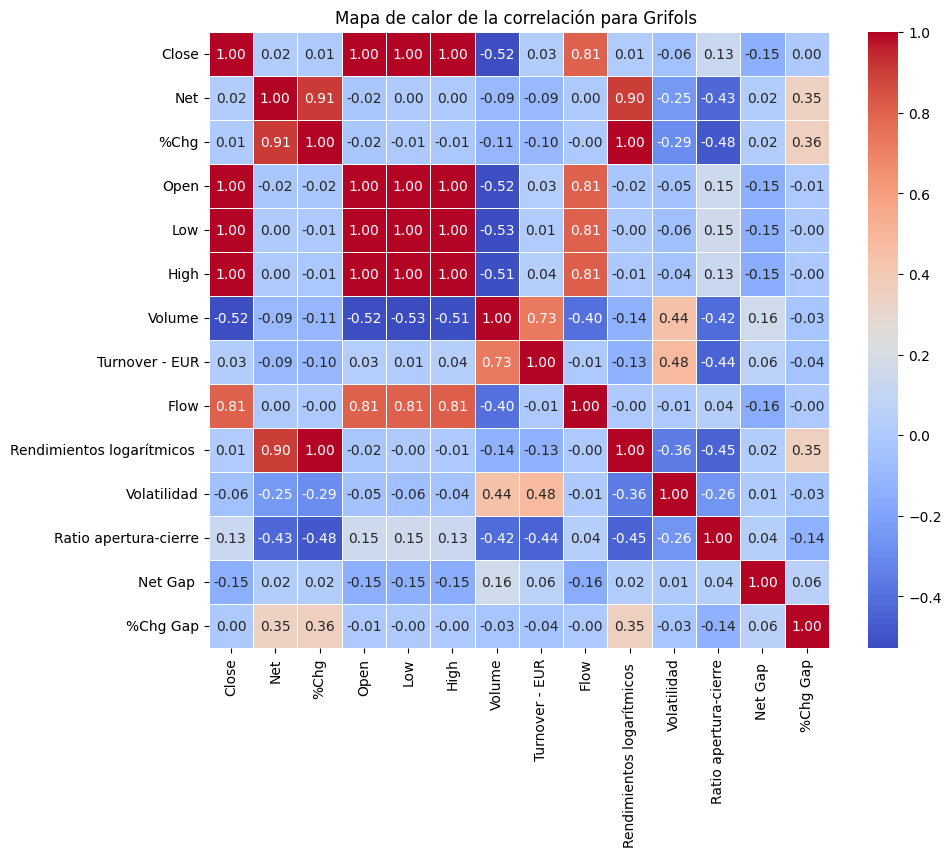


📌 Correlación para Iberdrola :

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.038359  0.021478  0.999682  0.999845   
Net                         0.038359  1.000000  0.872990  0.016778  0.027838   
%Chg                        0.021478  0.872990  1.000000  0.002759  0.012253   
Open                        0.999682  0.016778  0.002759  1.000000  0.999842   
Low                         0.999845  0.027838  0.012253  0.999842  1.000000   
High                        0.999846  0.026526  0.011269  0.999844  0.999790   
Volume                     -0.618701 -0.052724 -0.050172 -0.618199 -0.621011   
Turnover - EUR              0.018851 -0.052305 -0.045086  0.019536  0.015655   
Flow                        0.863179  0.038875  0.025091  0.862604  0.863093   
Rendimientos logarítmicos   0.023470  0.874054  0.999719  0.004757  0.014372   
Volatilidad                -0.084083 -0.100011 -0.052360 -0.083133 -0.088863   
Ratio a

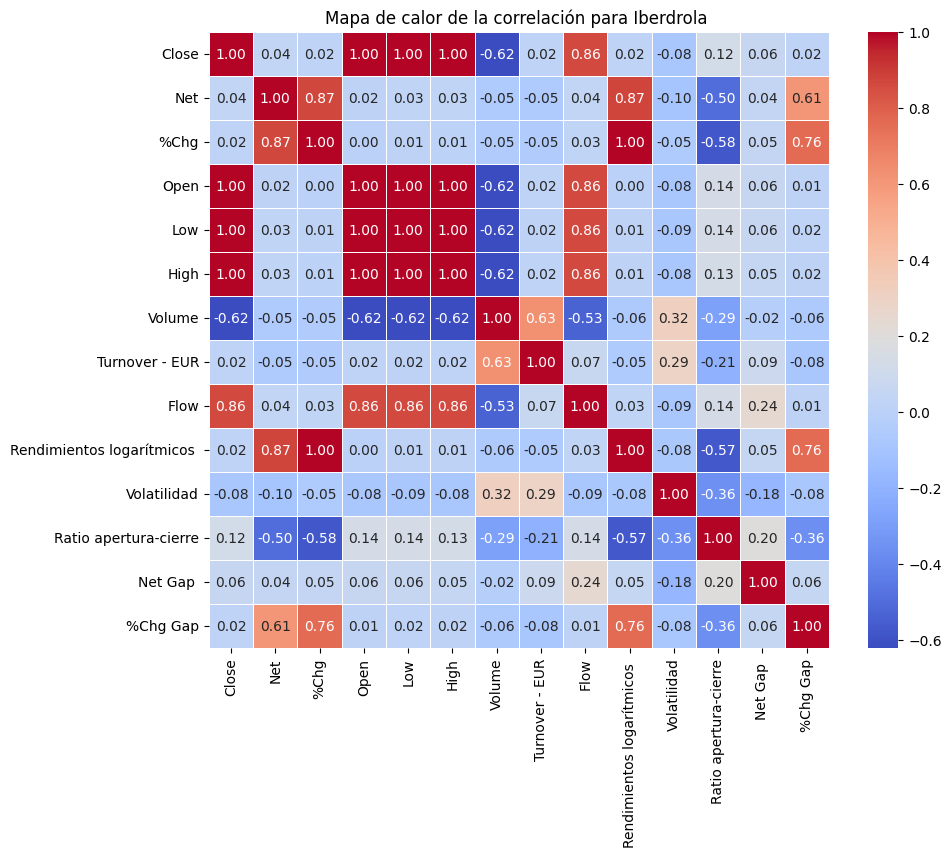


📌 Correlación para Inditex:

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.038266  0.017575  0.999221  0.999647   
Net                         0.038266  1.000000  0.942986  0.005186  0.022522   
%Chg                        0.017575  0.942986  1.000000 -0.013976  0.002292   
Open                        0.999221  0.005186 -0.013976  1.000000  0.999609   
Low                         0.999647  0.022522  0.002292  0.999609  1.000000   
High                        0.999655  0.021256  0.001658  0.999654  0.999538   
Volume                     -0.578134 -0.021250  0.008956 -0.578315 -0.581513   
Turnover - EUR              0.031603  0.007987  0.016552  0.030634  0.026619   
Flow                        0.094270  0.034425  0.031977  0.093298  0.095180   
Rendimientos logarítmicos   0.018945  0.943772  0.999785 -0.012585  0.003849   
Volatilidad                -0.063115  0.077318  0.131519 -0.067314 -0.073621   
Ratio aper

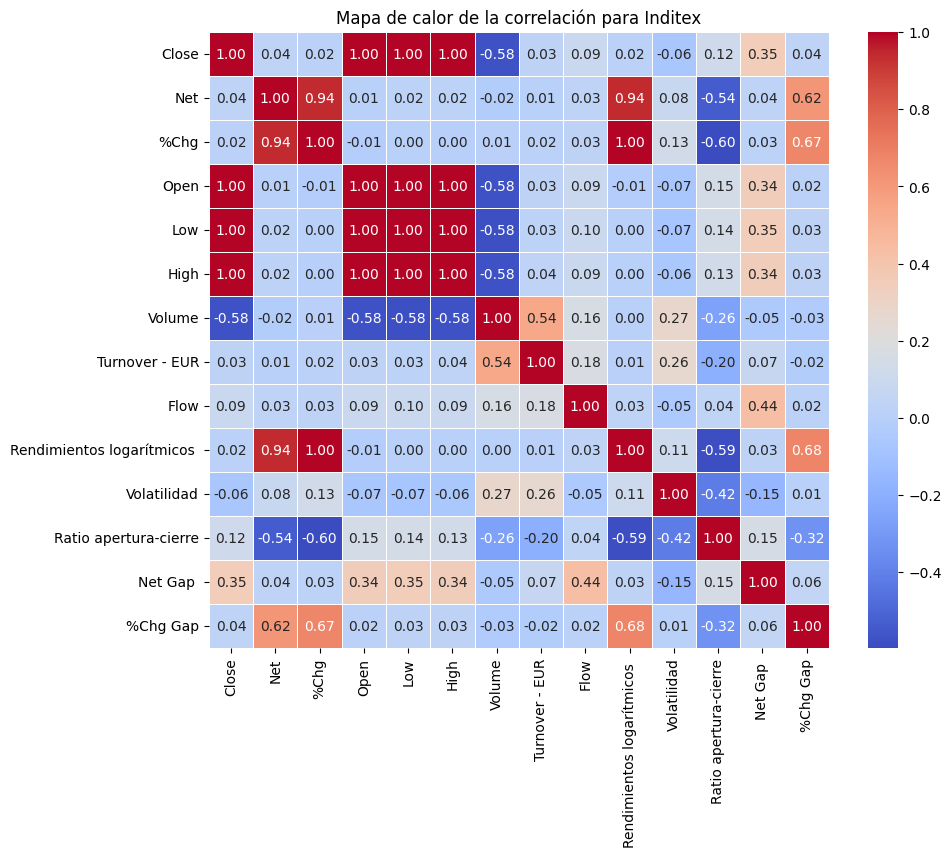


📌 Correlación para Indra :

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.043697  0.035708  0.997837  0.999116   
Net                         0.043697  1.000000  0.969838 -0.014995  0.017936   
%Chg                        0.035708  0.969838  1.000000 -0.021093  0.010062   
Open                        0.997837 -0.014995 -0.021093  1.000000  0.998813   
Low                         0.999116  0.017936  0.010062  0.998813  1.000000   
High                        0.999030  0.015516  0.008689  0.998949  0.998672   
Volume                     -0.149088 -0.047047 -0.028185 -0.146439 -0.162568   
Turnover - EUR              0.182490 -0.029919 -0.013216  0.184168  0.168645   
Flow                        0.601318  0.007030  0.005579  0.600907  0.599676   
Rendimientos logarítmicos   0.039772  0.970692  0.999495 -0.017111  0.014595   
Volatilidad                -0.126163  0.037800  0.080610 -0.126854 -0.142441   
Ratio apert

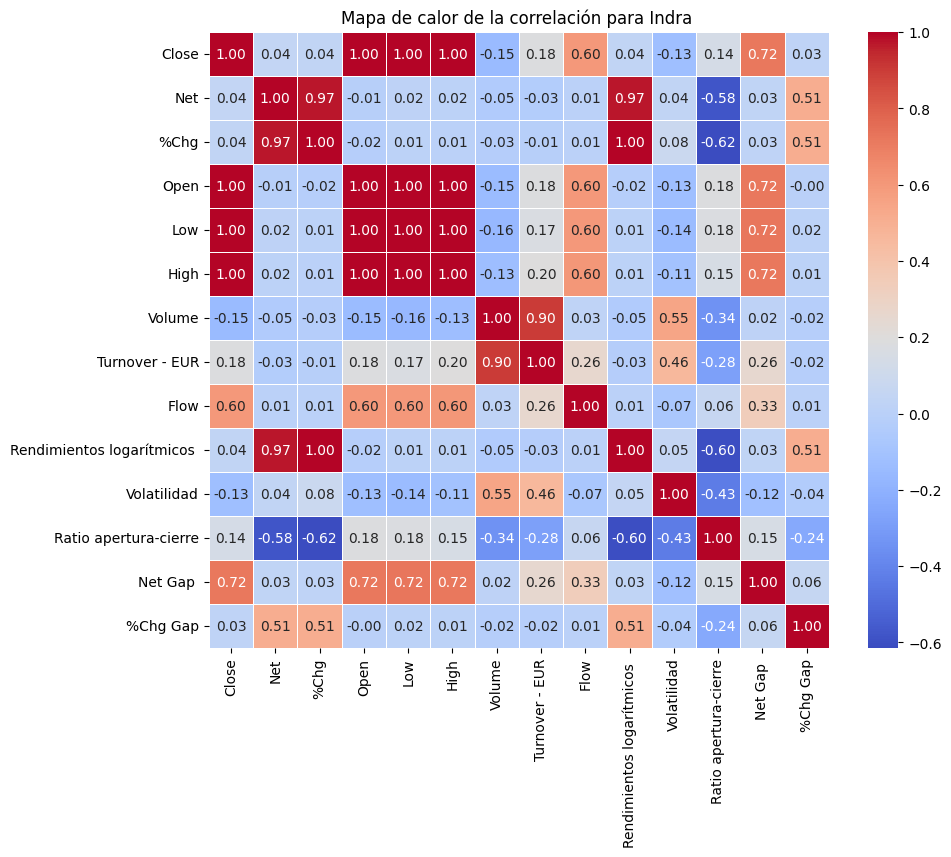


📌 Correlación para Mapfre:

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.042825  0.038771  0.996759  0.998529   
Net                         0.042825  1.000000  0.974994 -0.028140  0.009100   
%Chg                        0.038771  0.974994  1.000000 -0.030320  0.004571   
Open                        0.996759 -0.028140 -0.030320  1.000000  0.998340   
Low                         0.998529  0.009100  0.004571  0.998340  1.000000   
High                        0.998405  0.004928  0.002820  0.998506  0.997821   
Volume                      0.087975 -0.046484 -0.033132  0.091092  0.073727   
Turnover - EUR              0.384970 -0.039816 -0.026490  0.387602  0.372207   
Flow                        0.108355  0.008638  0.005283  0.105980  0.119031   
Rendimientos logarítmicos   0.042041  0.976556  0.999572 -0.027142  0.008375   
Volatilidad                -0.105107  0.109441  0.178665 -0.113327 -0.128808   
Ratio apert

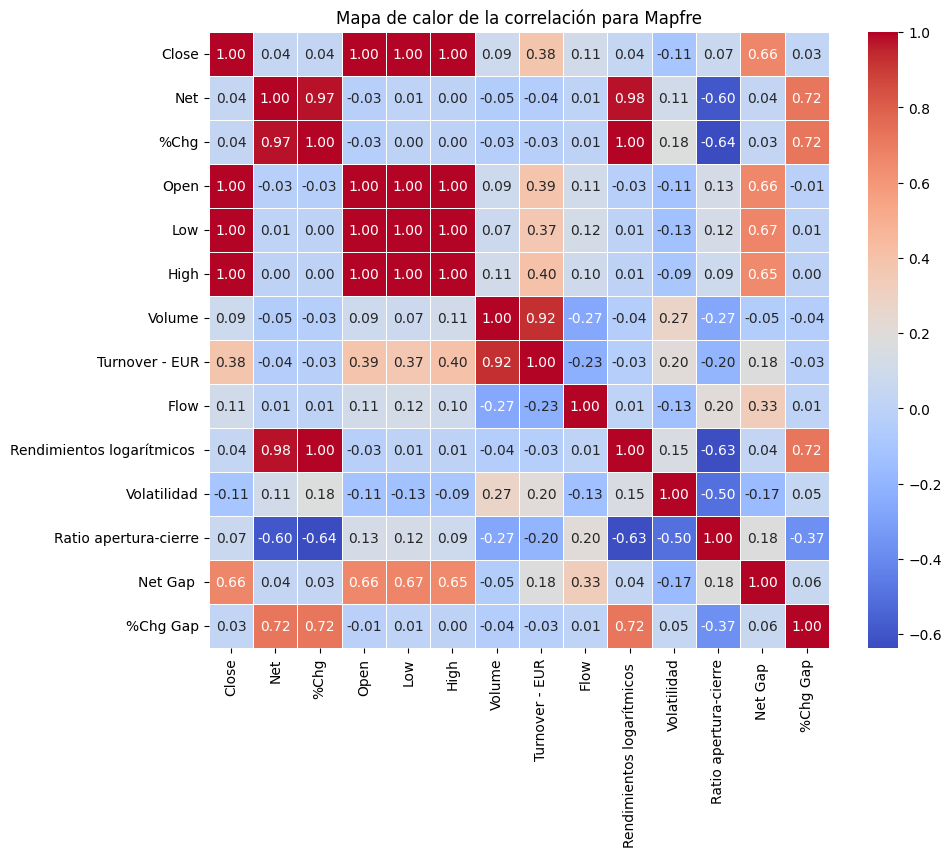


📌 Correlación para Naturgy :

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.027849  0.023367  0.998631  0.999403   
Net                         0.027849  1.000000  0.958913 -0.016772  0.008494   
%Chg                        0.023367  0.958913  1.000000 -0.019245  0.004420   
Open                        0.998631 -0.016772 -0.019245  1.000000  0.999261   
Low                         0.999403  0.008494  0.004420  0.999261  1.000000   
High                        0.999302  0.002816 -0.000068  0.999345  0.999075   
Volume                     -0.567938 -0.057604 -0.048243 -0.565865 -0.571706   
Turnover - EUR             -0.262571 -0.065498 -0.051908 -0.259816 -0.266771   
Flow                        0.856845  0.006683  0.004626  0.857105  0.857487   
Rendimientos logarítmicos   0.025834  0.960202  0.999574 -0.016799  0.007147   
Volatilidad                -0.085461 -0.224289 -0.174178 -0.076798 -0.090646   
Ratio ape

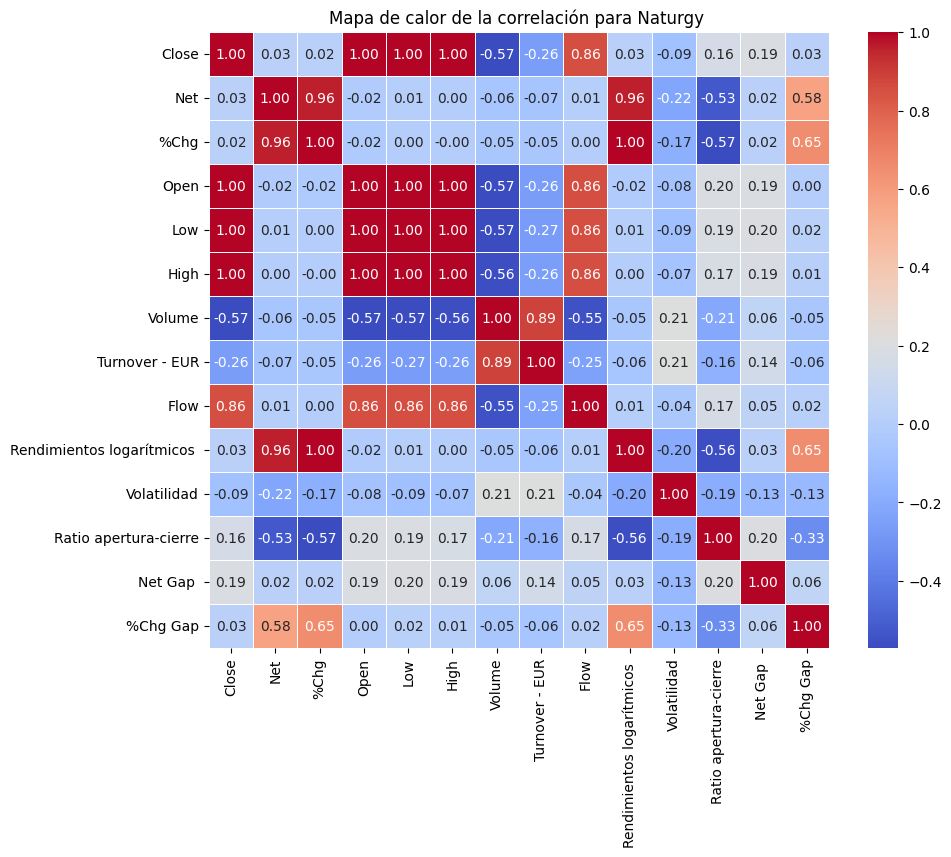


📌 Correlación para Redeia:

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.019894  0.014493  0.998860  0.999504   
Net                         0.019894  1.000000  0.958382 -0.021988  0.000241   
%Chg                        0.014493  0.958382  1.000000 -0.025966 -0.004704   
Open                        0.998860 -0.021988 -0.025966  1.000000  0.999411   
Low                         0.999504  0.000241 -0.004704  0.999411  1.000000   
High                        0.999445 -0.003513 -0.007831  0.999525  0.999335   
Volume                     -0.462463 -0.063013 -0.073172 -0.459348 -0.466885   
Turnover - EUR              0.031575 -0.066696 -0.071542  0.034815  0.026270   
Flow                        0.878018 -0.006531 -0.009822  0.877734  0.878323   
Rendimientos logarítmicos   0.016747  0.958849  0.999840 -0.023664 -0.002254   
Volatilidad                -0.124162 -0.200774 -0.174695 -0.118642 -0.131009   
Ratio apert

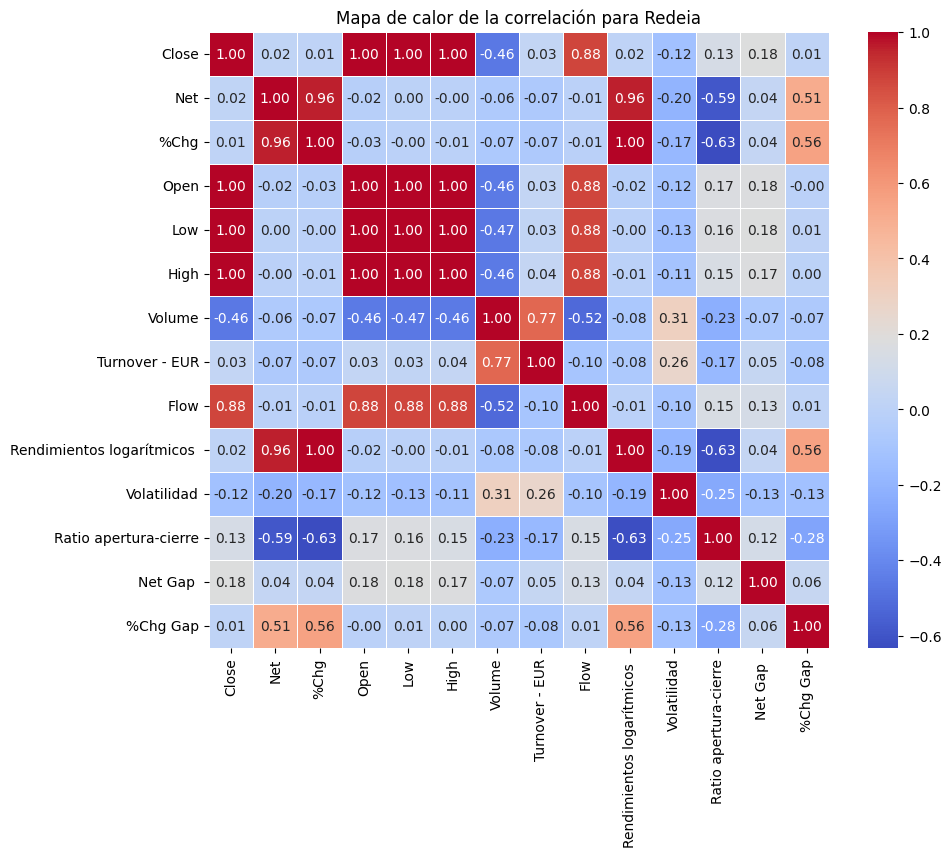


📌 Correlación para Rovi:

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.026954  0.016640  0.999552  0.999820   
Net                         0.026954  1.000000  0.787961  0.001392  0.018610   
%Chg                        0.016640  0.787961  1.000000 -0.003359  0.009256   
Open                        0.999552  0.001392 -0.003359  1.000000  0.999694   
Low                         0.999820  0.018610  0.009256  0.999694  1.000000   
High                        0.999766  0.012115  0.005331  0.999795  0.999678   
Volume                      0.388586 -0.113152 -0.092437  0.391263  0.384824   
Turnover - EUR              0.675062 -0.118738 -0.070563  0.677628  0.671623   
Flow                        0.922704  0.014252  0.004351  0.922258  0.923572   
Rendimientos logarítmicos   0.014210  0.791448  0.999618 -0.005871  0.006993   
Volatilidad                 0.069895 -0.302483 -0.216588  0.076597  0.065689   
Ratio apertur

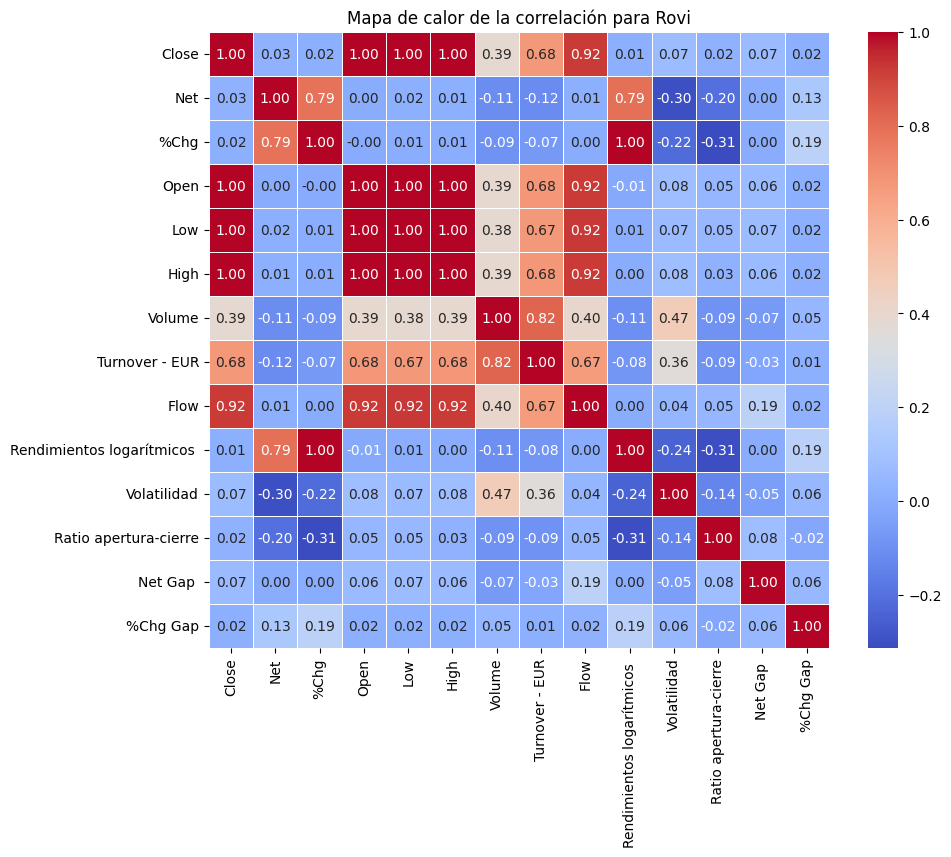


📌 Correlación para Sacyr:

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.021860  0.020274  0.997933  0.999082   
Net                         0.021860  1.000000  0.900755 -0.034914 -0.001126   
%Chg                        0.020274  0.900755  1.000000 -0.030072 -0.000538   
Open                        0.997933 -0.034914 -0.030072  1.000000  0.998696   
Low                         0.999082 -0.001126 -0.000538  0.998696  1.000000   
High                        0.998939 -0.009445 -0.006697  0.999083  0.998378   
Volume                     -0.127820 -0.006829  0.010859 -0.127072 -0.141419   
Turnover - EUR              0.291401  0.005414  0.012999  0.291129  0.279030   
Flow                        0.278673  0.038131  0.024281  0.273978  0.290968   
Rendimientos logarítmicos   0.024083  0.900798  0.999255 -0.026149  0.003841   
Volatilidad                -0.100267 -0.105948 -0.103222 -0.096166 -0.111863   
Ratio apertu

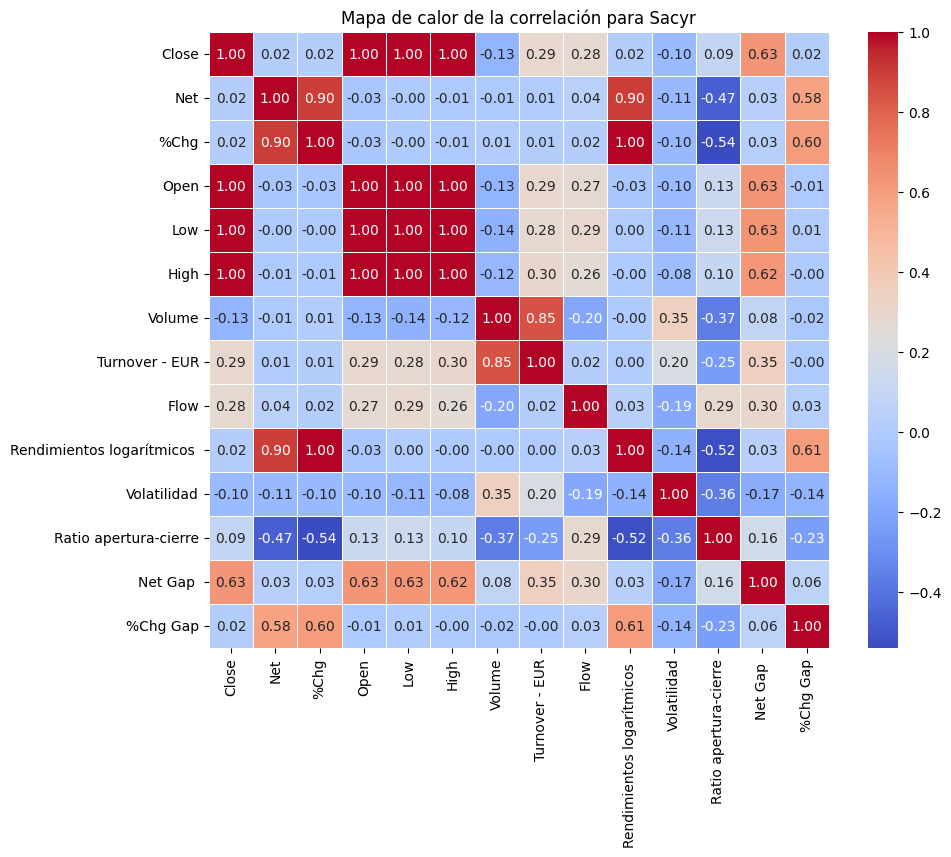


📌 Correlación para Solaria :

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.020642  0.006603  0.999196  0.999654   
Net                         0.020642  1.000000  0.585026 -0.016815  0.004422   
%Chg                        0.006603  0.585026  1.000000 -0.015258 -0.003687   
Open                        0.999196 -0.016815 -0.015258  1.000000  0.999564   
Low                         0.999654  0.004422 -0.003687  0.999564  1.000000   
High                        0.999655  0.001263 -0.003790  0.999658  0.999524   
Volume                      0.272457 -0.016898  0.129118  0.273222  0.265022   
Turnover - EUR              0.716629 -0.038728  0.001975  0.717616  0.709011   
Flow                        0.983188  0.005745 -0.001296  0.983024  0.983853   
Rendimientos logarítmicos   0.011154  0.603004  0.997005 -0.011336  0.000892   
Volatilidad                -0.052372 -0.019211  0.361175 -0.052204 -0.056449   
Ratio ape

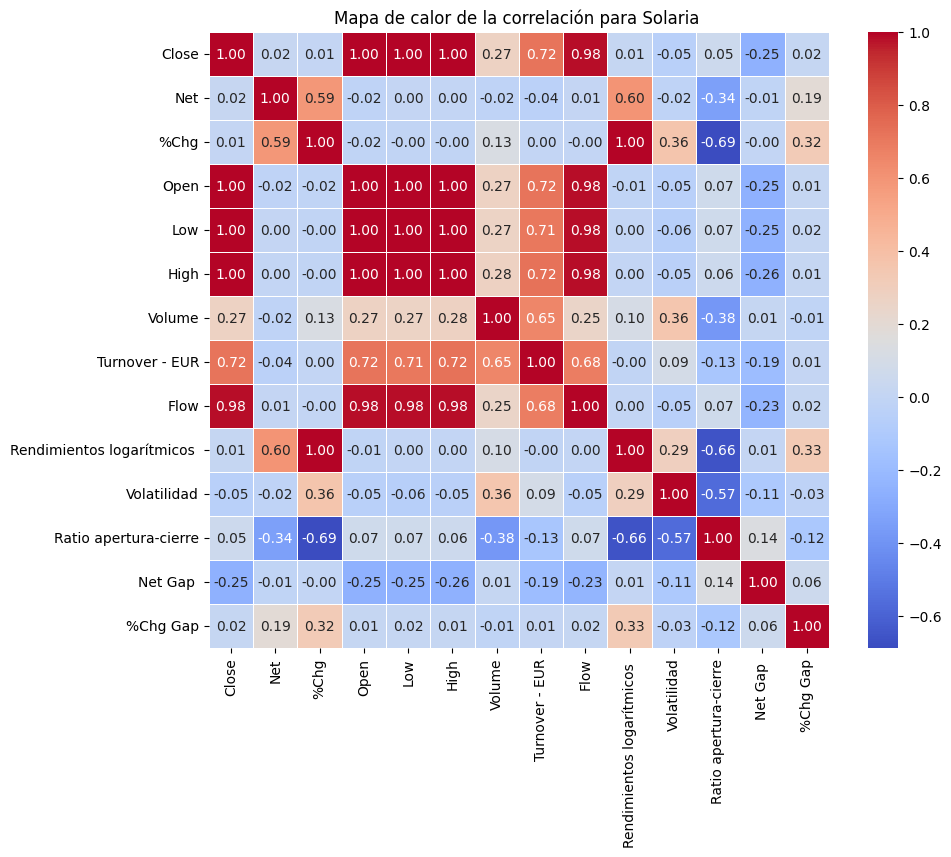


📌 Correlación para Telefonica:

                               Close       Net      %Chg      Open       Low  \
Close                       1.000000  0.010372  0.013326  0.999449  0.999753   
Net                         0.010372  1.000000  0.905455 -0.017318 -0.003042   
%Chg                        0.013326  0.905455  1.000000 -0.012055  0.000808   
Open                        0.999449 -0.017318 -0.012055  1.000000  0.999720   
Low                         0.999753 -0.003042  0.000808  0.999720  1.000000   
High                        0.999729 -0.005129 -0.000567  0.999753  0.999653   
Volume                      0.502056 -0.083879 -0.081396  0.503991  0.495998   
Turnover - EUR              0.763013 -0.048548 -0.037773  0.764117  0.758814   
Flow                        0.956354  0.007402  0.007902  0.955918  0.956453   
Rendimientos logarítmicos   0.014808  0.906580  0.999544 -0.010520  0.002490   
Volatilidad                -0.049349 -0.084441 -0.041190 -0.049584 -0.055167   
Ratio a

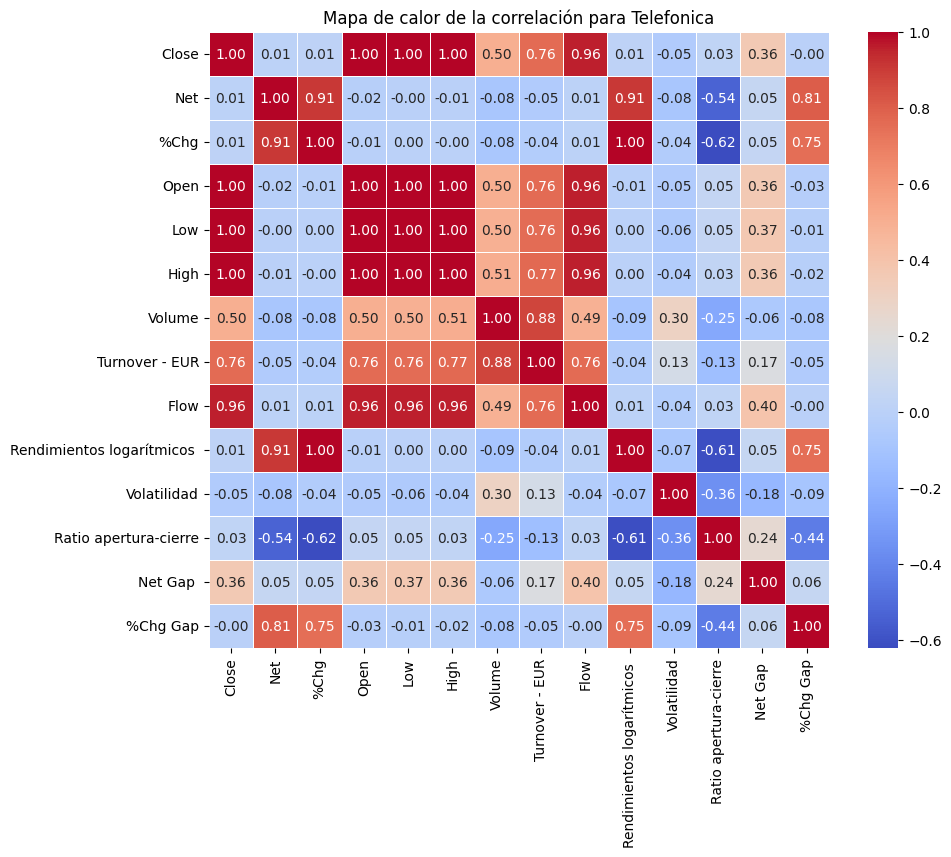

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

file_path = "/BASE DE DATOS ! .xlsx"


xls = pd.ExcelFile(file_path)

hojas = xls.sheet_names

correlaciones = {}


for hoja in hojas:
    df = pd.read_excel(xls, sheet_name=hoja)


    df_numeric = df.select_dtypes(include=['float64', 'int64'])


    correlacion = df_numeric.corr()


    correlaciones[hoja] = correlacion


    print(f"\n Correlación para {hoja}:\n")
    print(correlacion)


    plt.figure(figsize=(10, 8))
    sns.heatmap(correlacion, annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)


    plt.title(f"Mapa de calor de la correlación para {hoja}")


    plt.show()


Saving BASE DE DATOS ! .xlsx to BASE DE DATOS !  (1).xlsx
Hojas disponibles en el archivo: ['IBEX 35', 'Acciona ', 'Acerinox ', 'ACS ', 'ArcelorMittal SA', 'Banco Sabadell', 'Banco Santander', 'Bankinter', 'BBVA ', 'Caixabank ', ' Colonial', 'Enagas', 'Endesa ', 'Ferrovial ', 'Fluidra', 'Grifols ', 'Iberdrola ', 'Inditex', 'Indra ', 'Mapfre', 'Naturgy ', 'Redeia', 'Sacyr', 'Solaria ', 'Telefonica']

 Analizando: IBEX 35
Columnas en IBEX 35: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Turnover por transacción'],
      dtype='object')


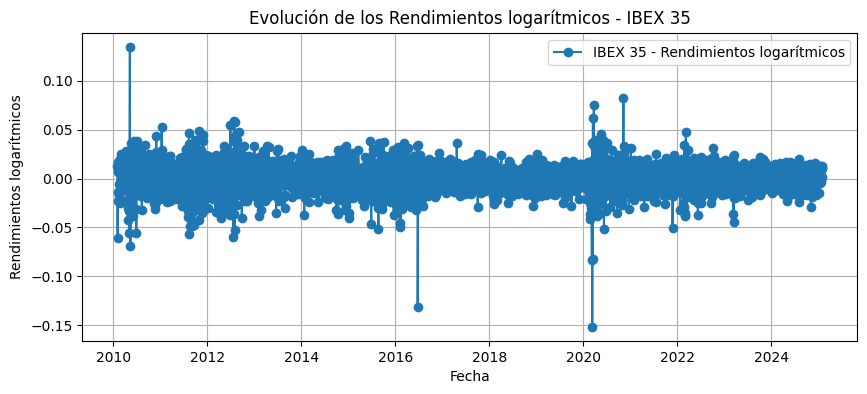

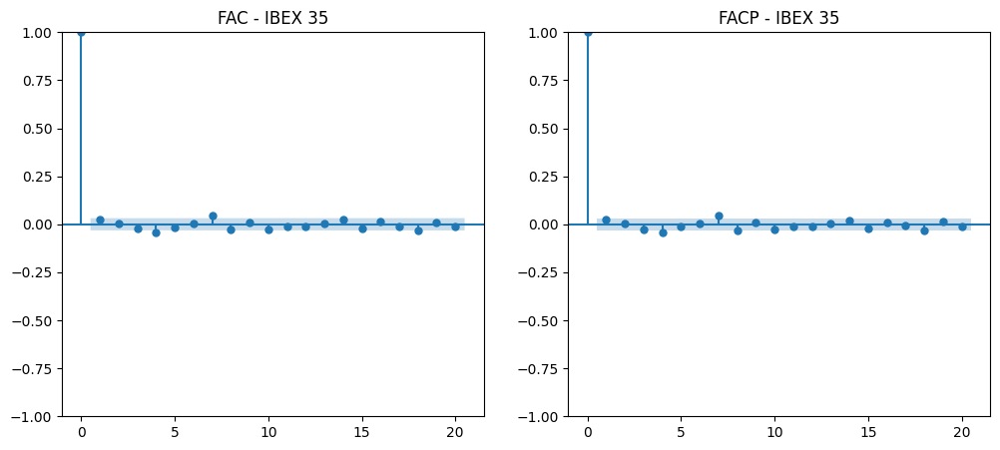

 Resultado ADF para IBEX 35:
   - Valor de ADF: -22.354548285718618
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432058534773547, '5%': -2.8622949368701343, '10%': -2.5671718625118447}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Acciona 
Columnas en Acciona : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Turnover por transacción',
       'Net Gap ', '%Chg Gap'],
      dtype='object')


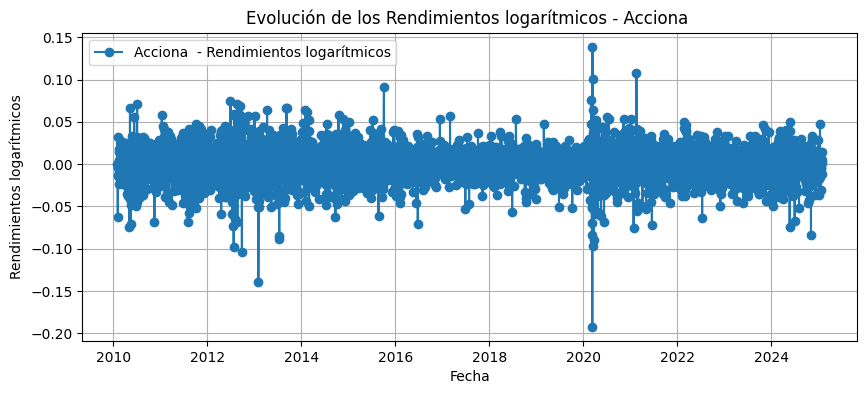

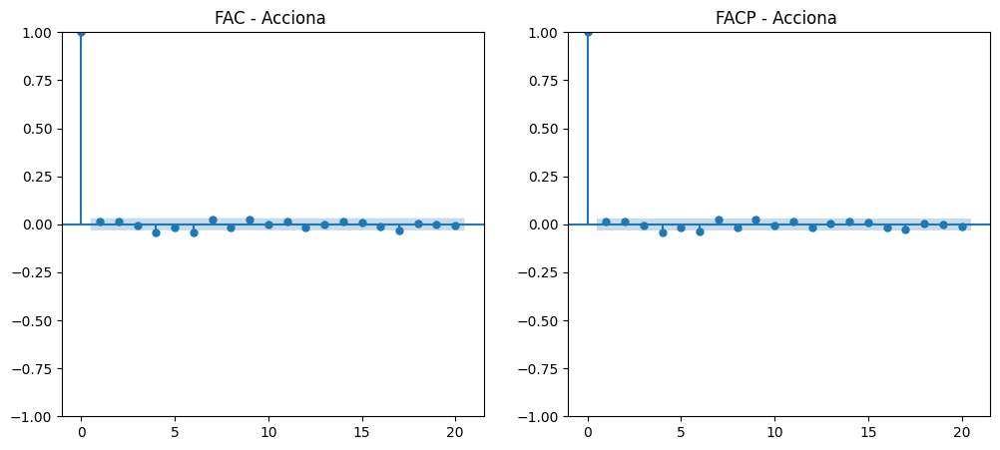

 Resultado ADF para Acciona :
   - Valor de ADF: -24.267247465632323
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320576424555265, '5%': -2.862294542701668, '10%': -2.5671716526716017}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Acerinox 
Columnas en Acerinox : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Turnover por transacción',
       'Net Gap ', '%Chg Gap'],
      dtype='object')


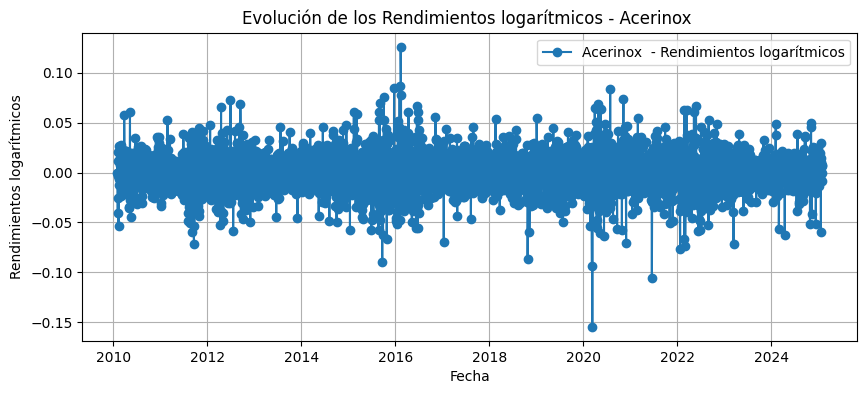

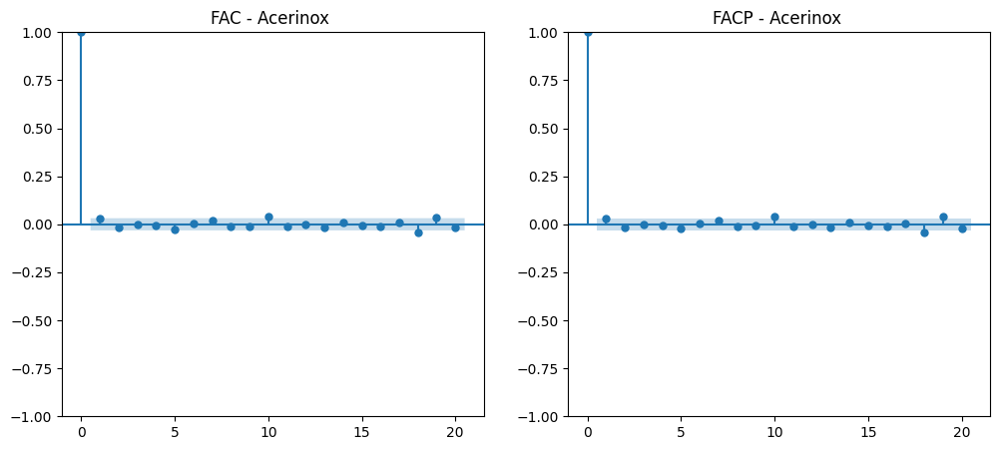

 Resultado ADF para Acerinox :
   - Valor de ADF: -60.031927262567336
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432054971085099, '5%': -2.862293362662052, '10%': -2.567171024463682}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: ACS 
Columnas en ACS : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


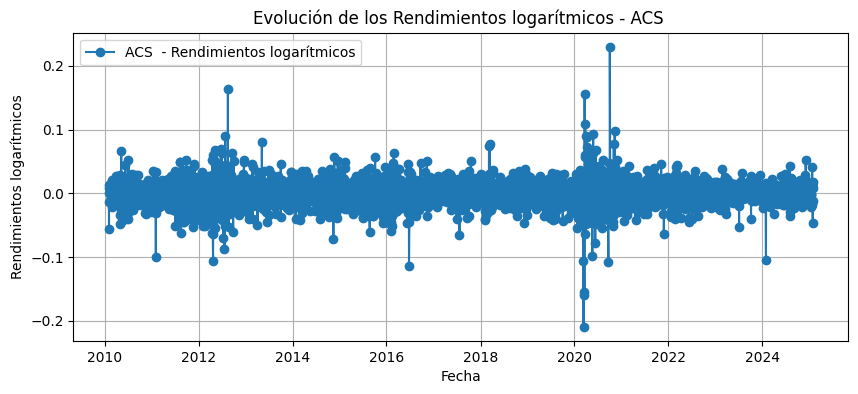

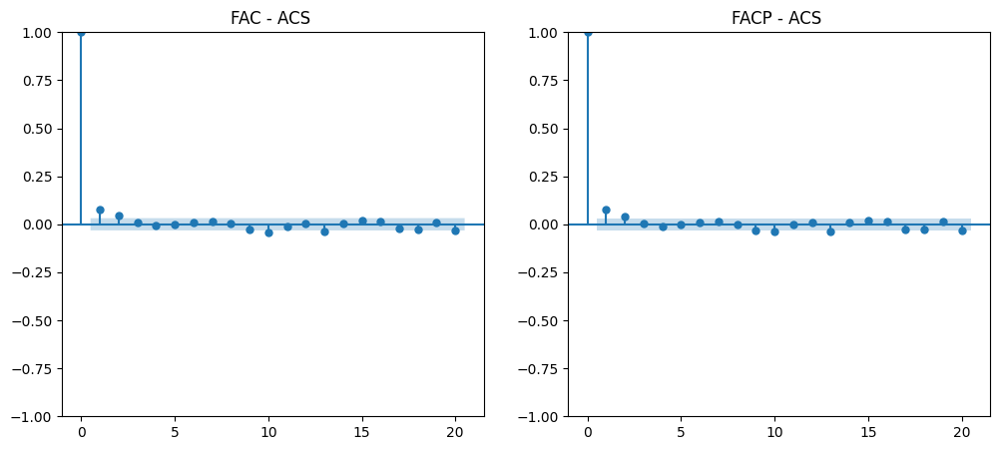

 Resultado ADF para ACS :
   - Valor de ADF: -40.381070480704885
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320554157329366, '5%': -2.862293559078938, '10%': -2.5671711290285004}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: ArcelorMittal SA
Columnas en ArcelorMittal SA: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


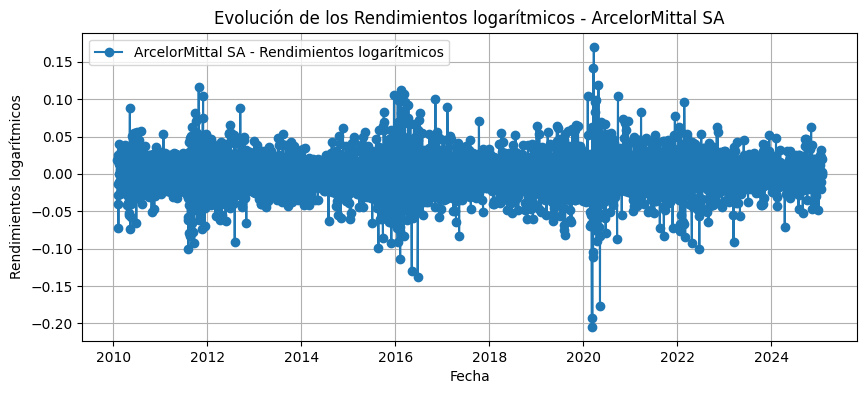

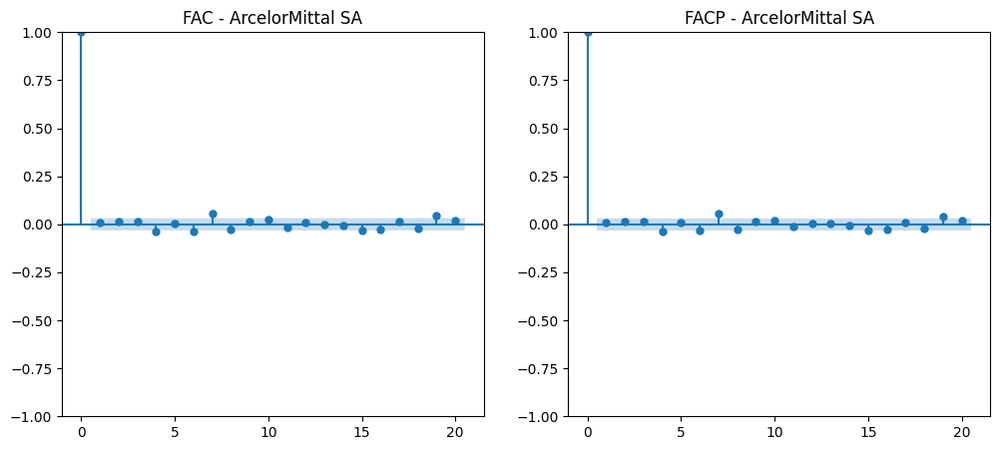

 Resultado ADF para ArcelorMittal SA:
   - Valor de ADF: -22.02335792947586
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432058534773547, '5%': -2.8622949368701343, '10%': -2.5671718625118447}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Banco Sabadell
Columnas en Banco Sabadell: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


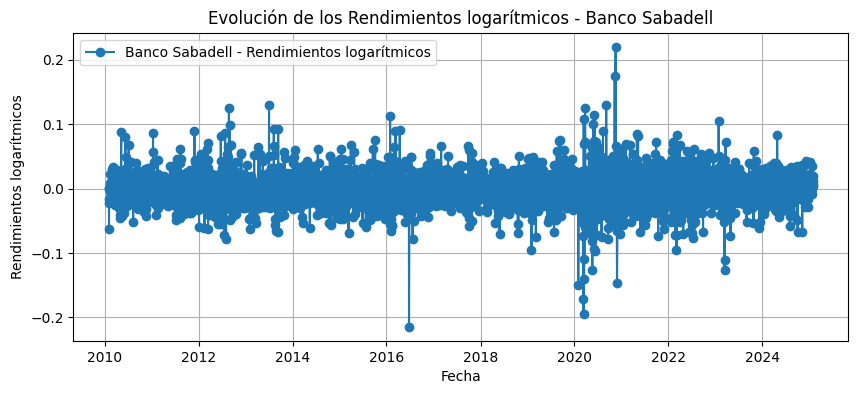

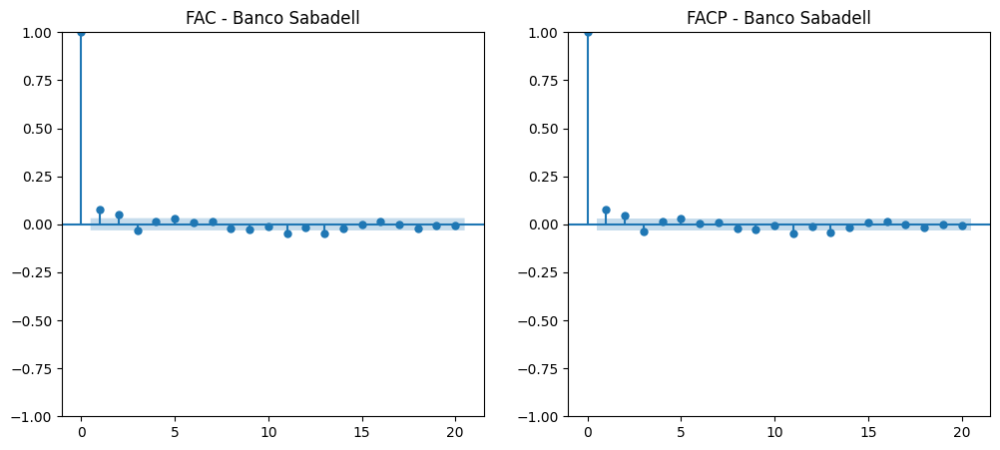

 Resultado ADF para Banco Sabadell:
   - Valor de ADF: -18.853112091057902
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320603222101678, '5%': -2.8622957264438273, '10%': -2.5671722828507946}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Banco Santander
Columnas en Banco Santander: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


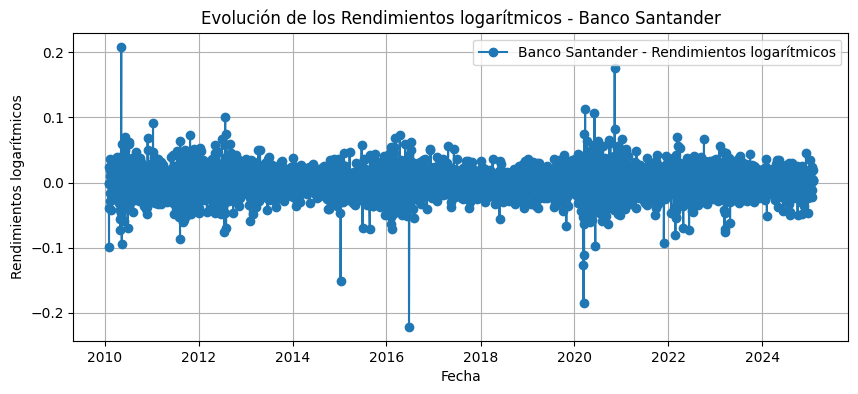

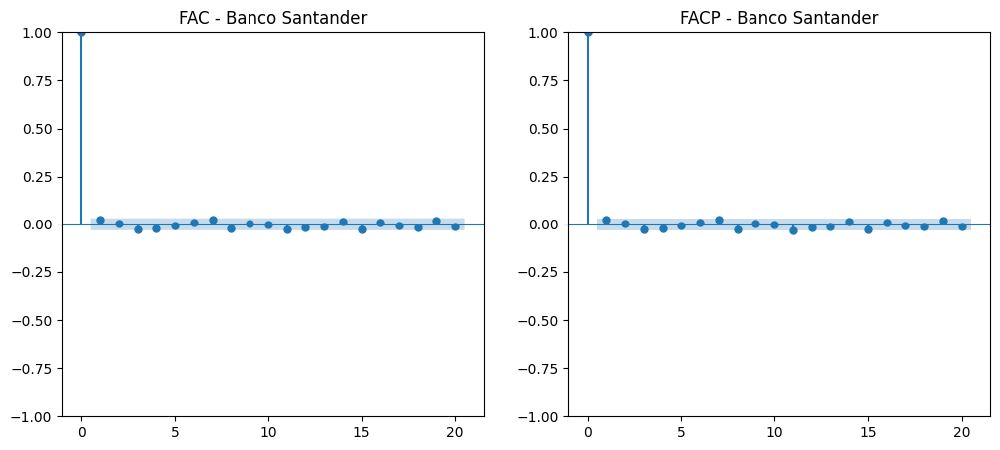

 Resultado ADF para Banco Santander:
   - Valor de ADF: -60.45407195051886
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432054971085099, '5%': -2.862293362662052, '10%': -2.567171024463682}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Bankinter
Columnas en Bankinter: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


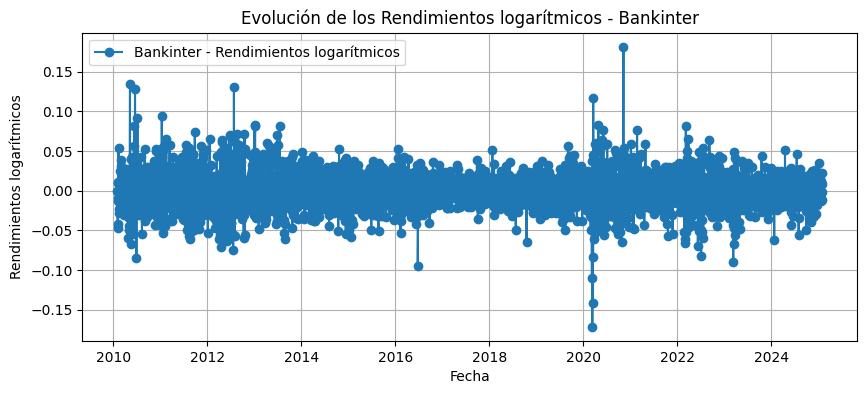

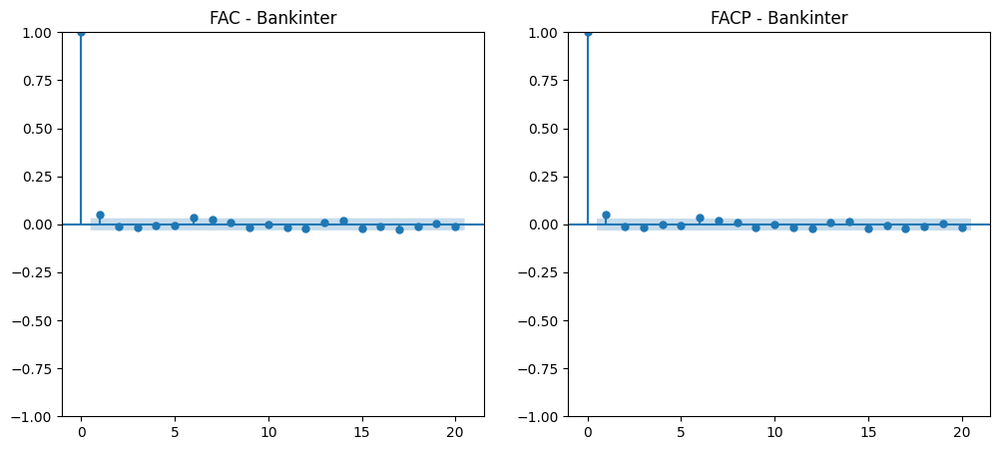

 Resultado ADF para Bankinter:
   - Valor de ADF: -58.86991371200145
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432054971085099, '5%': -2.862293362662052, '10%': -2.567171024463682}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: BBVA 
Columnas en BBVA : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


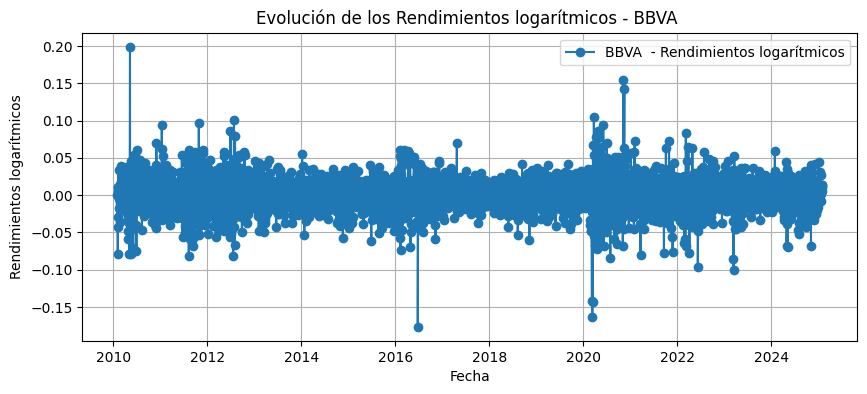

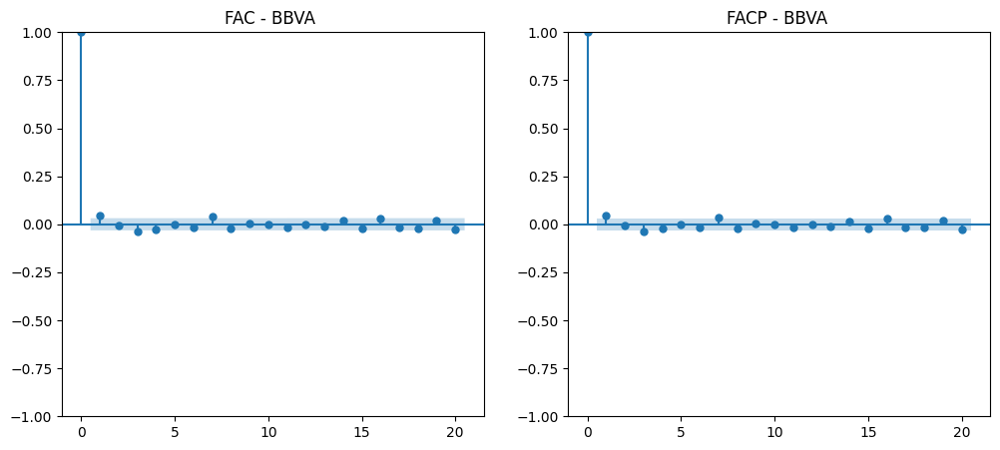

 Resultado ADF para BBVA :
   - Valor de ADF: -22.373851451208246
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320580884979983, '5%': -2.8622947397344367, '10%': -2.567171757564323}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Caixabank 
Columnas en Caixabank : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


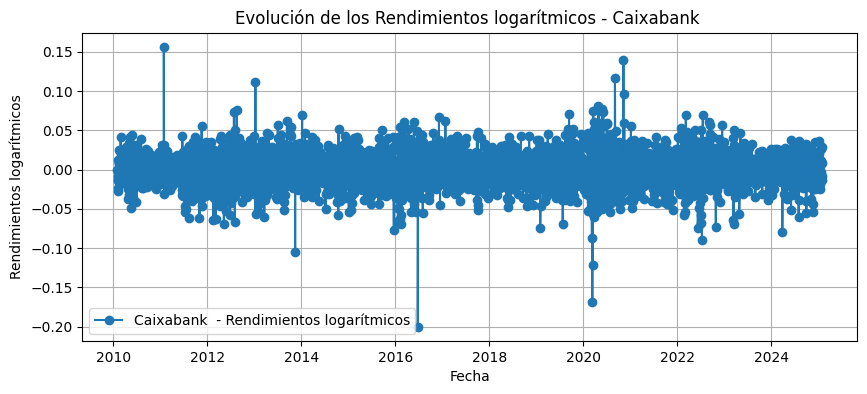

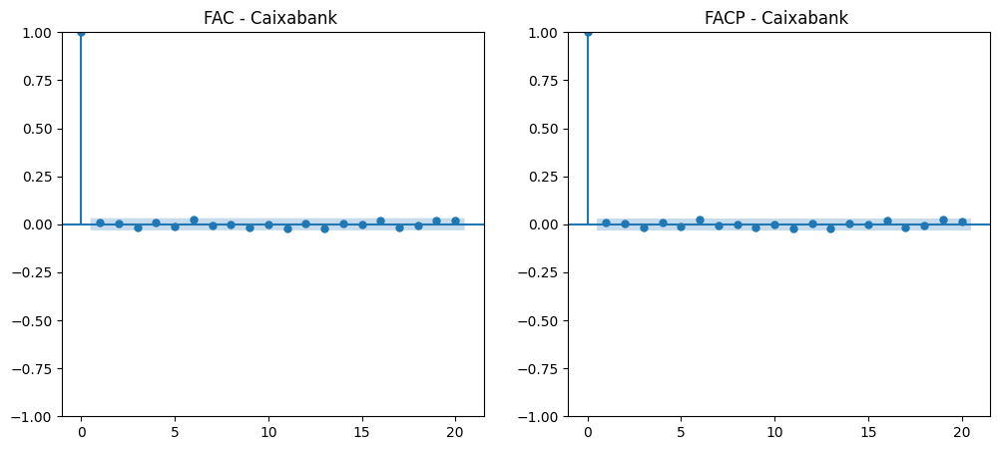

 Resultado ADF para Caixabank :
   - Valor de ADF: -61.29945441565185
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432054971085099, '5%': -2.862293362662052, '10%': -2.567171024463682}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando:  Colonial
Columnas en  Colonial: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


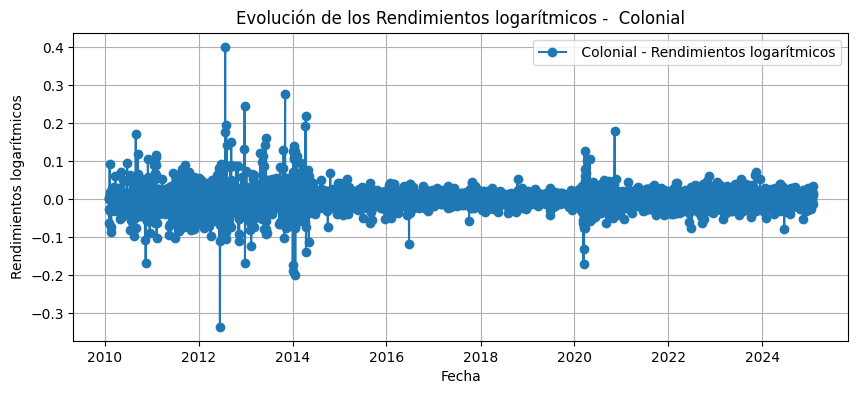

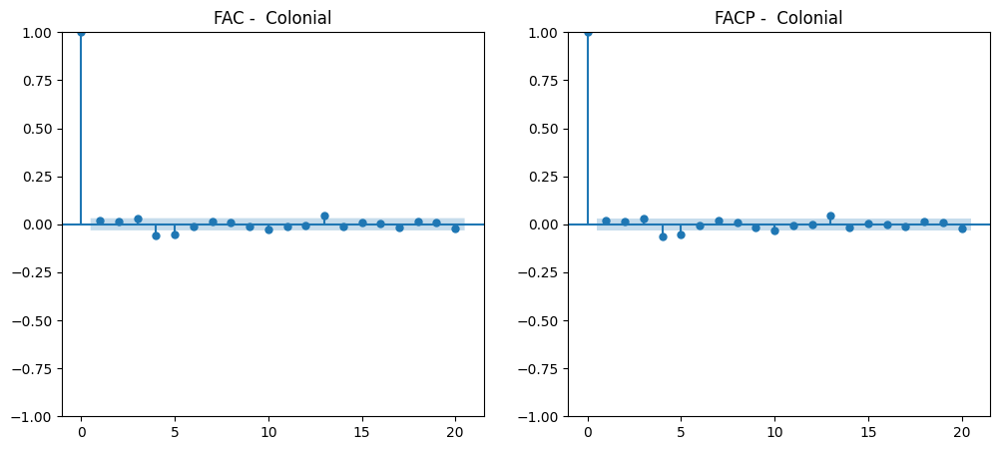

 Resultado ADF para  Colonial:
   - Valor de ADF: -29.815529196772403
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432056751069083, '5%': -2.8622941489445943, '10%': -2.567171443050389}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Enagas
Columnas en Enagas: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


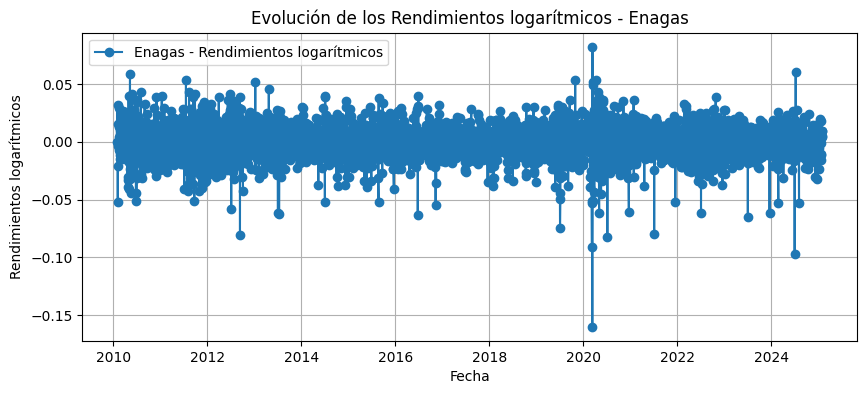

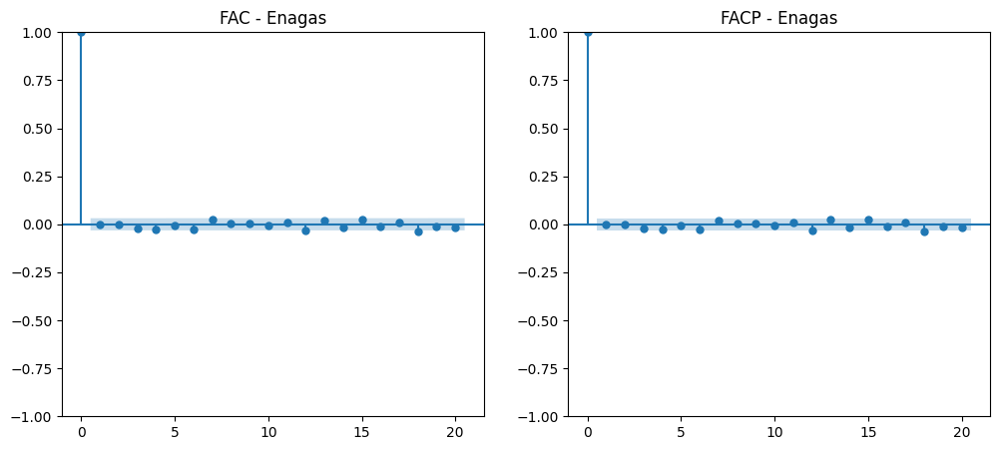

 Resultado ADF para Enagas:
   - Valor de ADF: -62.15378638957044
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432054971085099, '5%': -2.862293362662052, '10%': -2.567171024463682}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Endesa 
Columnas en Endesa : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


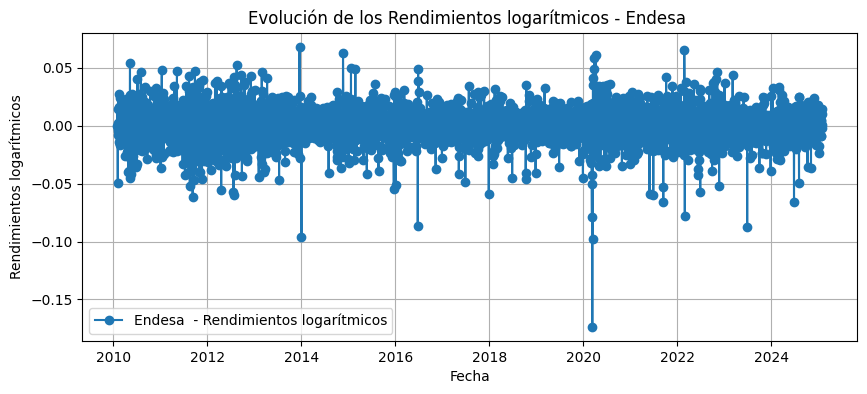

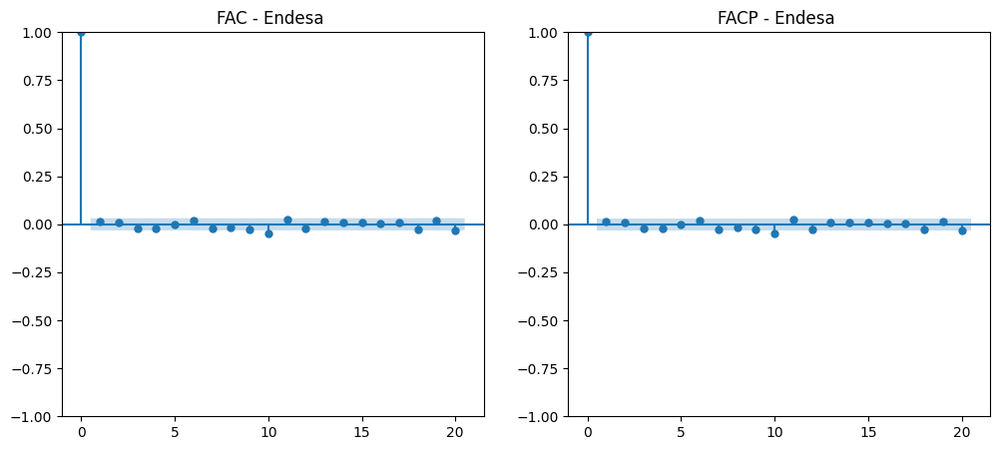

 Resultado ADF para Endesa :
   - Valor de ADF: -19.459335729922884
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320598750004825, '5%': -2.862295528895607, '10%': -2.567172177683642}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Ferrovial 
Columnas en Ferrovial : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


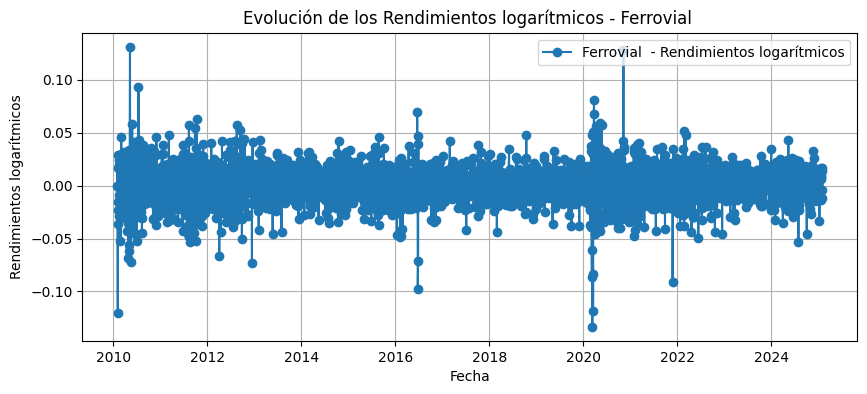

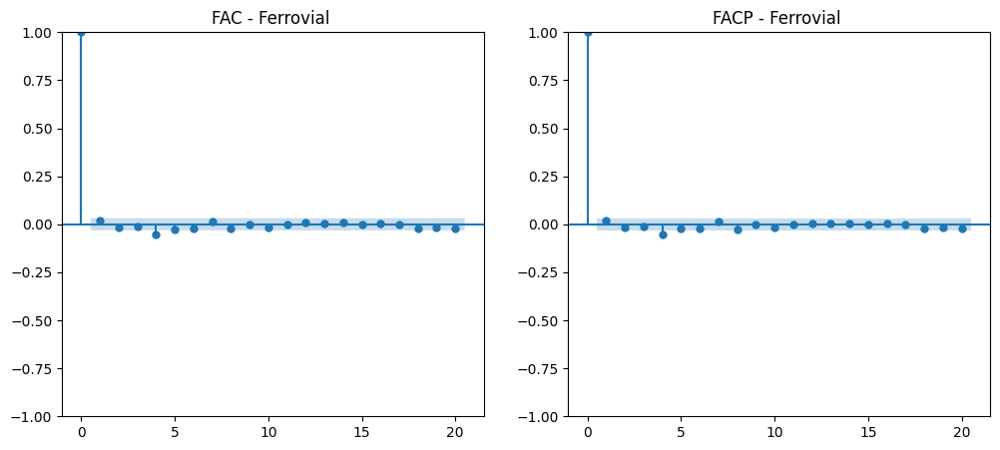

 Resultado ADF para Ferrovial :
   - Valor de ADF: -27.347449838469025
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320571966459488, '5%': -2.862294345771747, '10%': -2.567171547833638}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Fluidra
Columnas en Fluidra: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


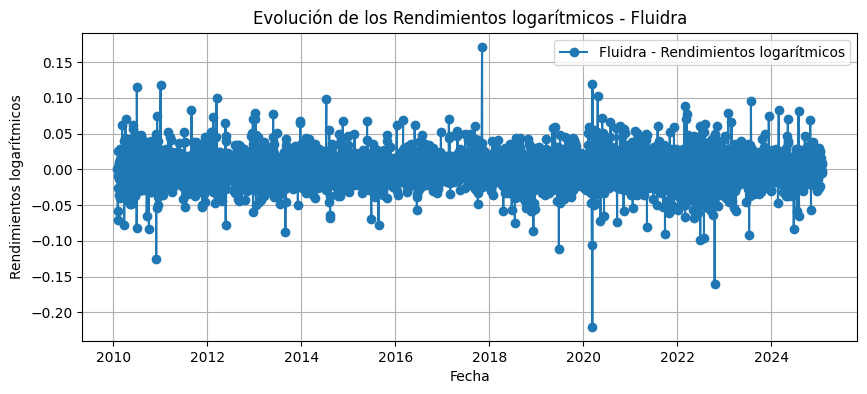

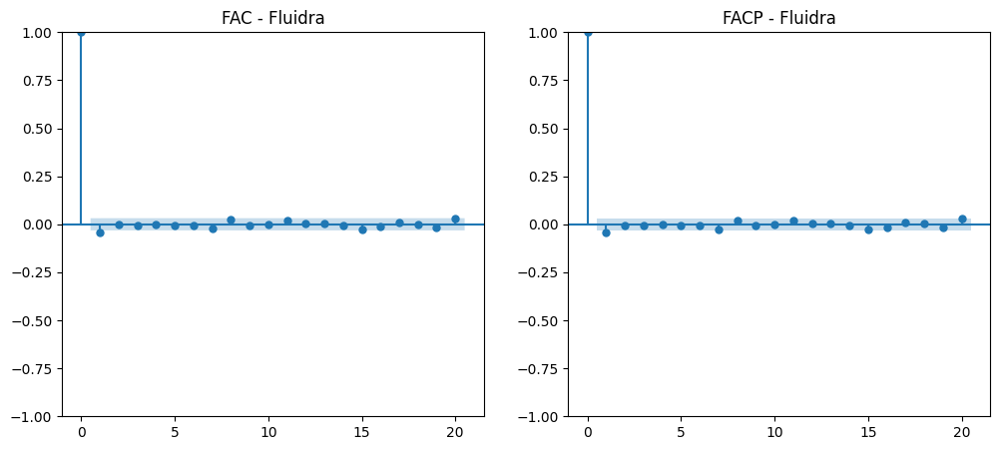

 Resultado ADF para Fluidra:
   - Valor de ADF: -64.6661391963366
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432054971085099, '5%': -2.862293362662052, '10%': -2.567171024463682}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Grifols 
Columnas en Grifols : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


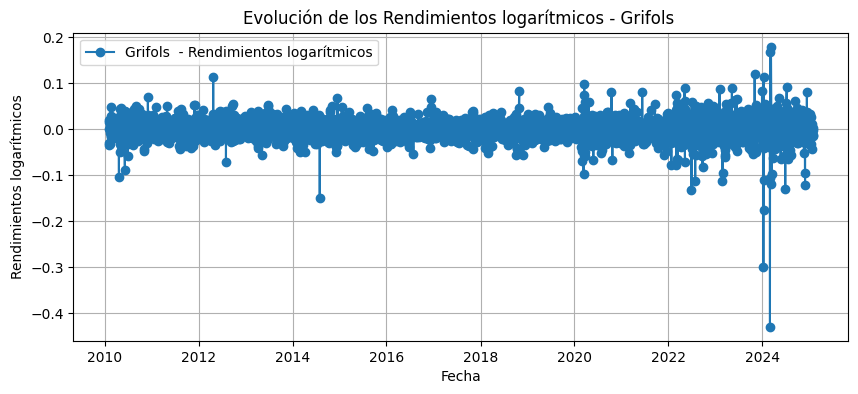

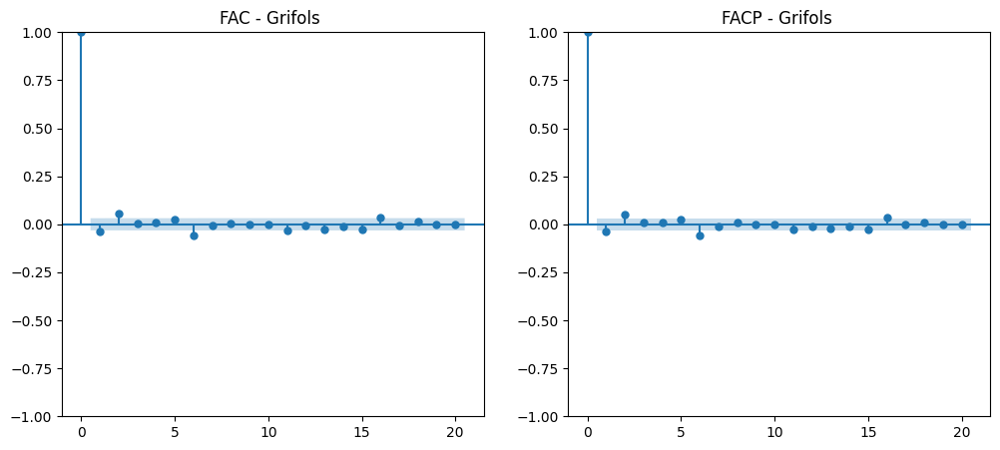

 Resultado ADF para Grifols :
   - Valor de ADF: -25.669255204935002
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320571966459488, '5%': -2.862294345771747, '10%': -2.567171547833638}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Iberdrola 
Columnas en Iberdrola : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


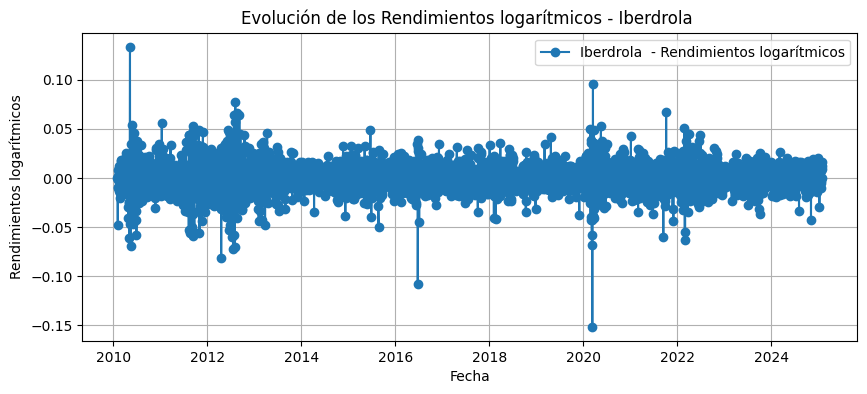

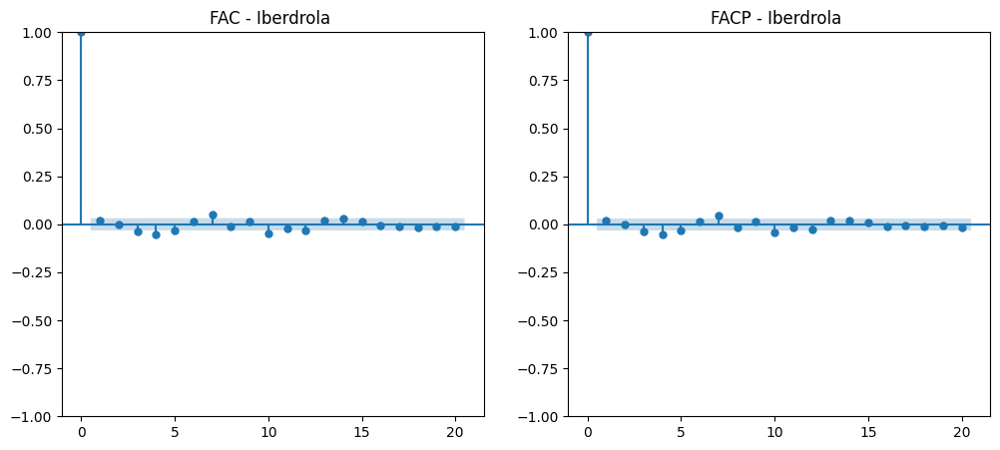

 Resultado ADF para Iberdrola :
   - Valor de ADF: -19.420321843189324
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320598750004825, '5%': -2.862295528895607, '10%': -2.567172177683642}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Inditex
Columnas en Inditex: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


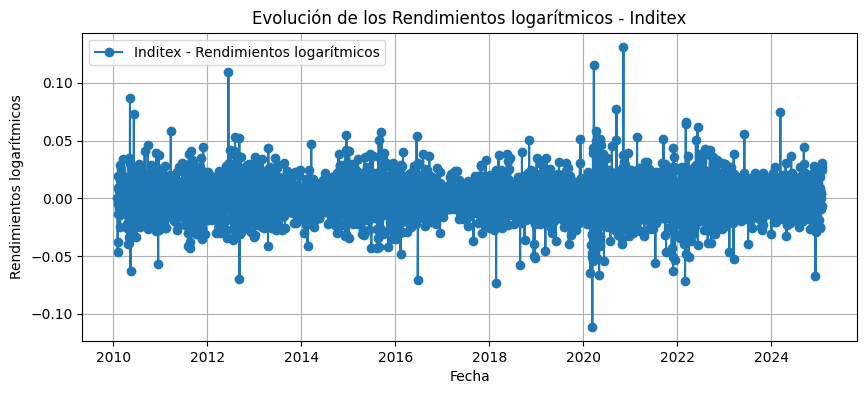

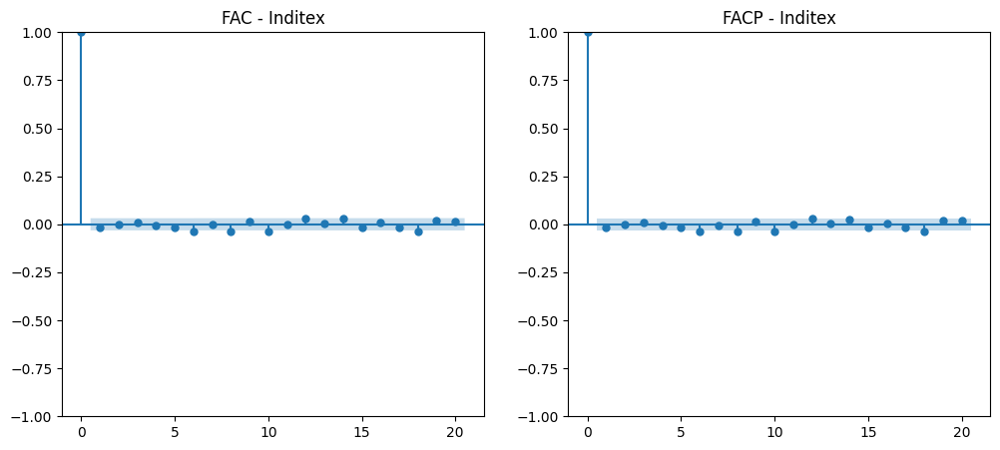

 Resultado ADF para Inditex:
   - Valor de ADF: -63.15120177955356
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432054971085099, '5%': -2.862293362662052, '10%': -2.567171024463682}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Indra 
Columnas en Indra : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


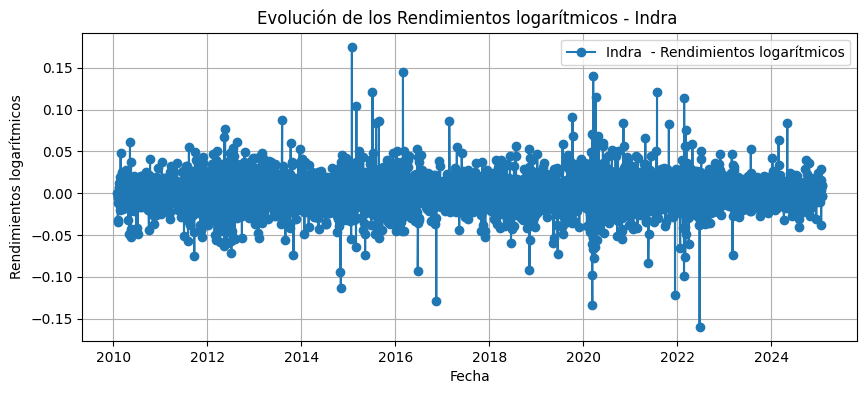

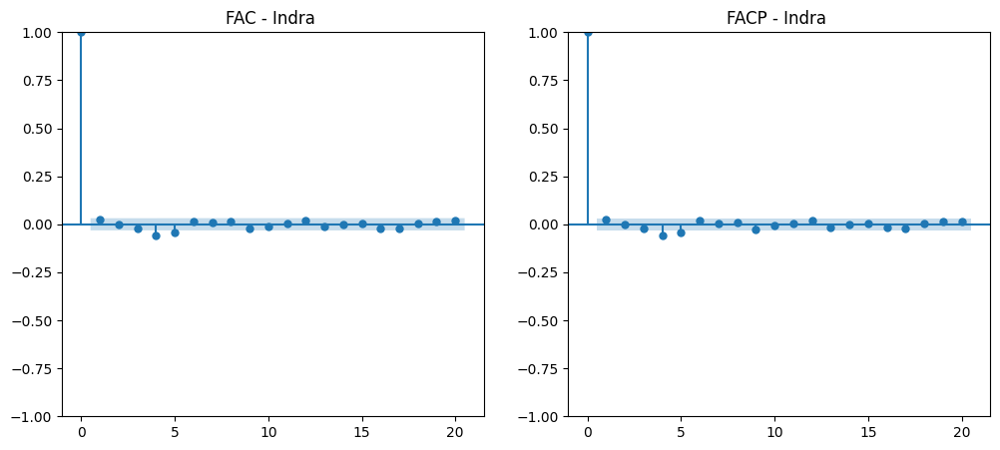

 Resultado ADF para Indra :
   - Valor de ADF: -30.401610712875748
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432056751069083, '5%': -2.8622941489445943, '10%': -2.567171443050389}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Mapfre
Columnas en Mapfre: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


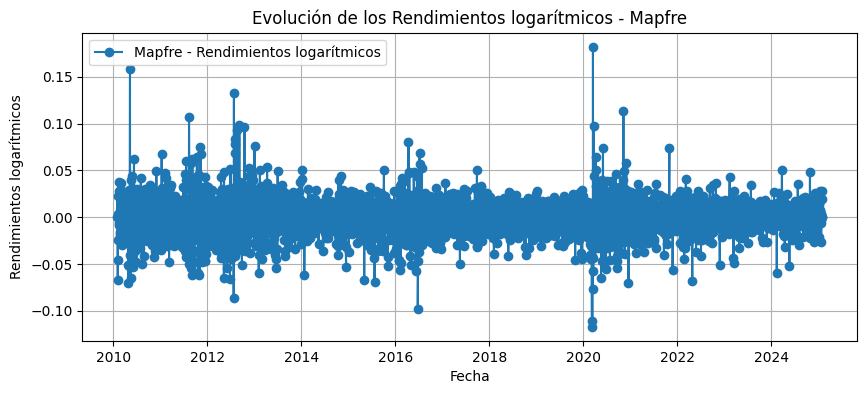

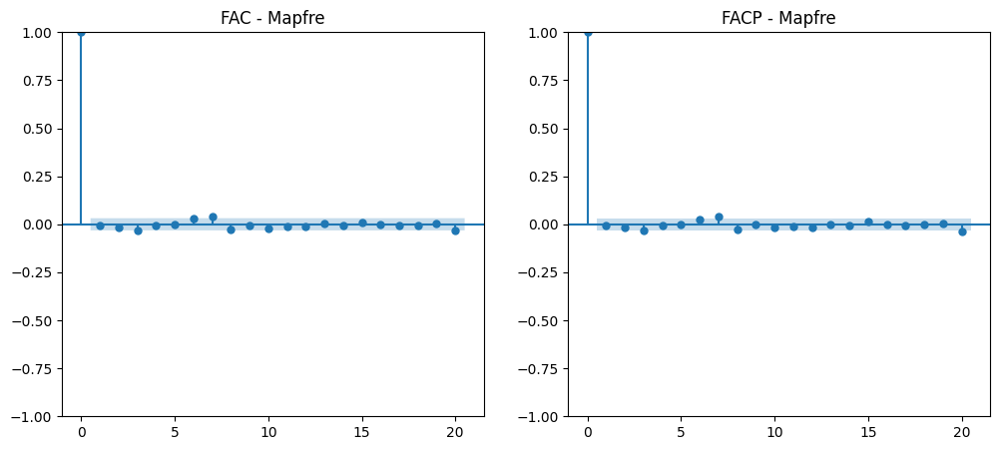

 Resultado ADF para Mapfre:
   - Valor de ADF: -21.711170818782513
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320580884979983, '5%': -2.8622947397344367, '10%': -2.567171757564323}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Naturgy 
Columnas en Naturgy : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


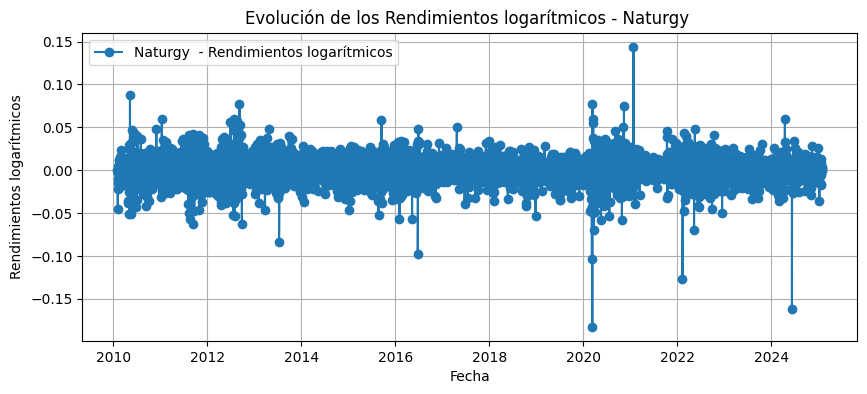

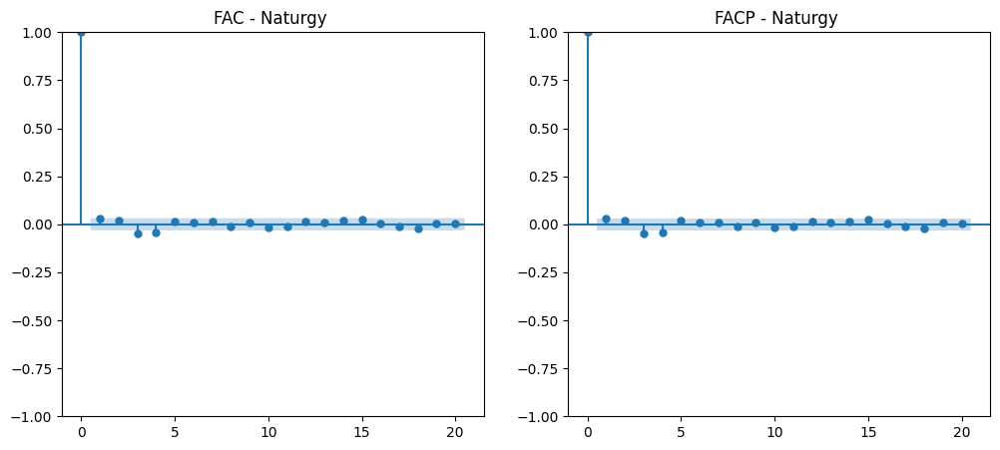

 Resultado ADF para Naturgy :
   - Valor de ADF: -32.870224585477686
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432056305724747, '5%': -2.8622939522201287, '10%': -2.567171338321811}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Redeia
Columnas en Redeia: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


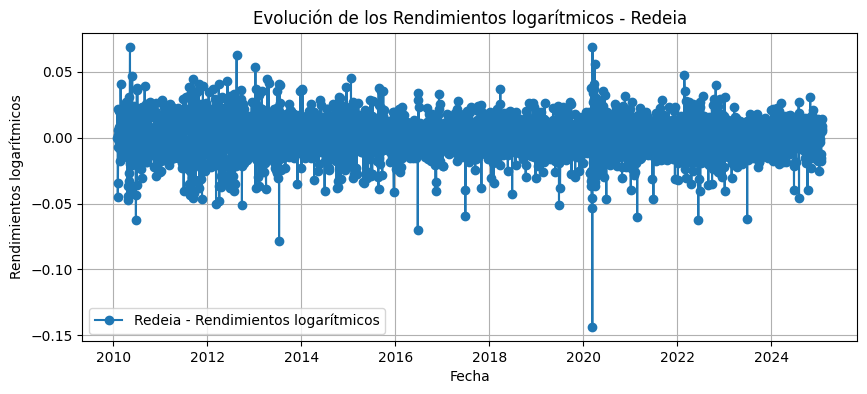

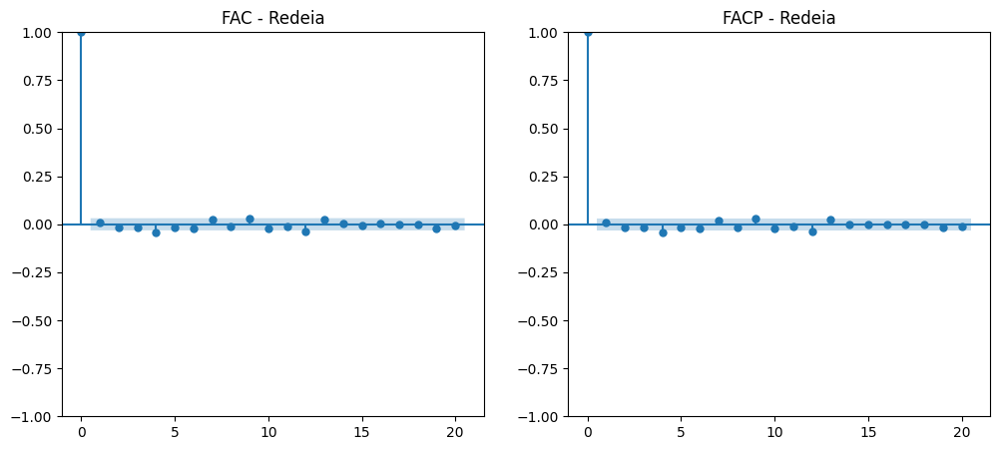

 Resultado ADF para Redeia:
   - Valor de ADF: -17.85863244379538
   - p-valor: 3.0594948e-30
   - Valores críticos: {'1%': -3.4320603222101678, '5%': -2.8622957264438273, '10%': -2.5671722828507946}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Sacyr
Columnas en Sacyr: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


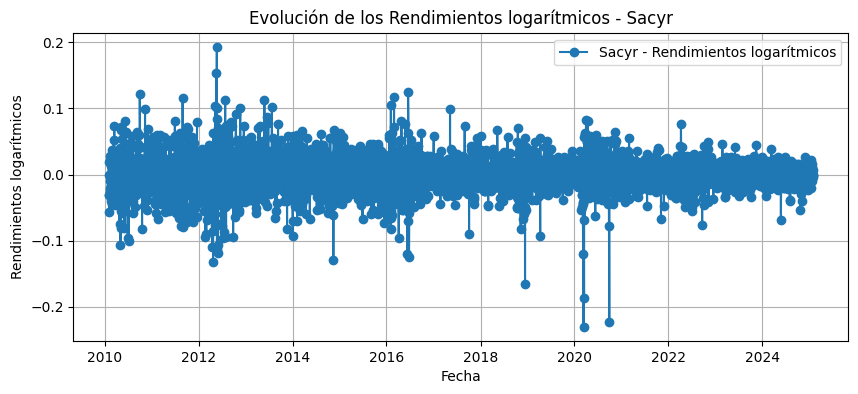

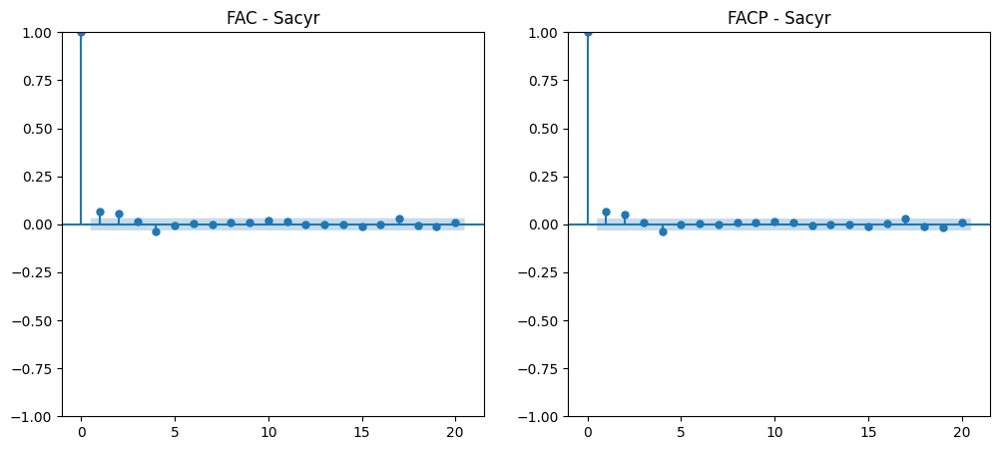

 Resultado ADF para Sacyr:
   - Valor de ADF: -30.569359265697532
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432056305724747, '5%': -2.8622939522201287, '10%': -2.567171338321811}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Solaria 
Columnas en Solaria : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


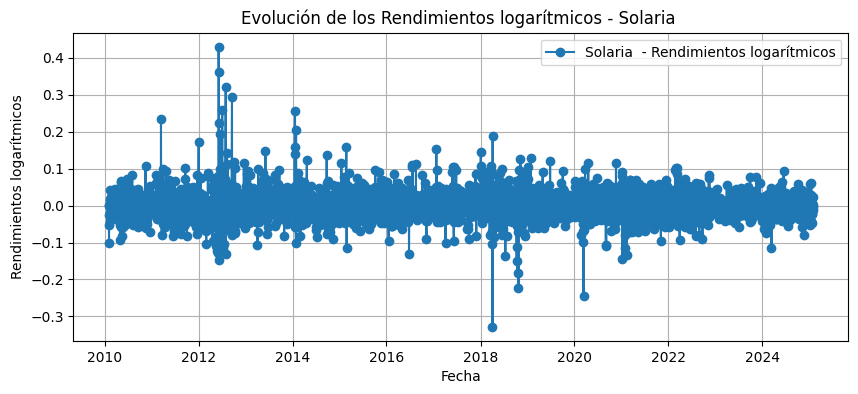

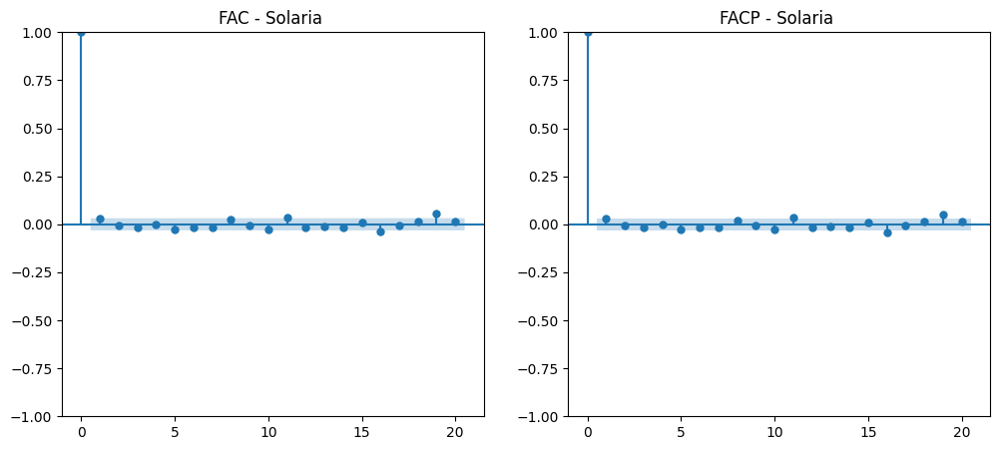

 Resultado ADF para Solaria :
   - Valor de ADF: -14.137508602012005
   - p-valor: 2.276389178e-26
   - Valores críticos: {'1%': -3.432063010388557, '5%': -2.862296913905984, '10%': -2.5671729150105533}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Analizando: Telefonica
Columnas en Telefonica: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Volatilidad', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


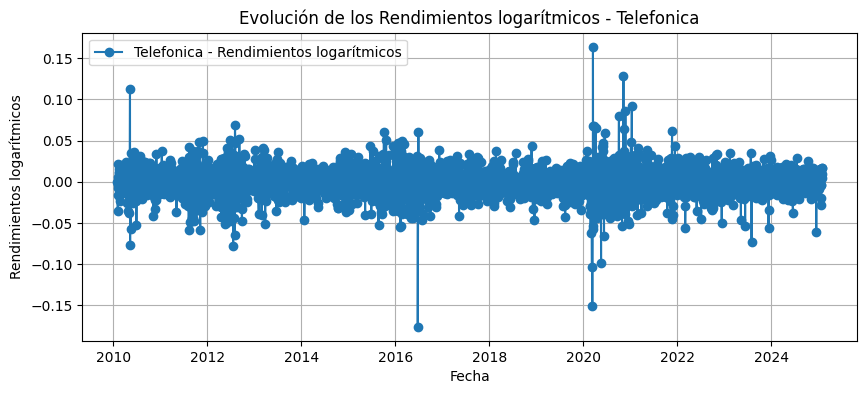

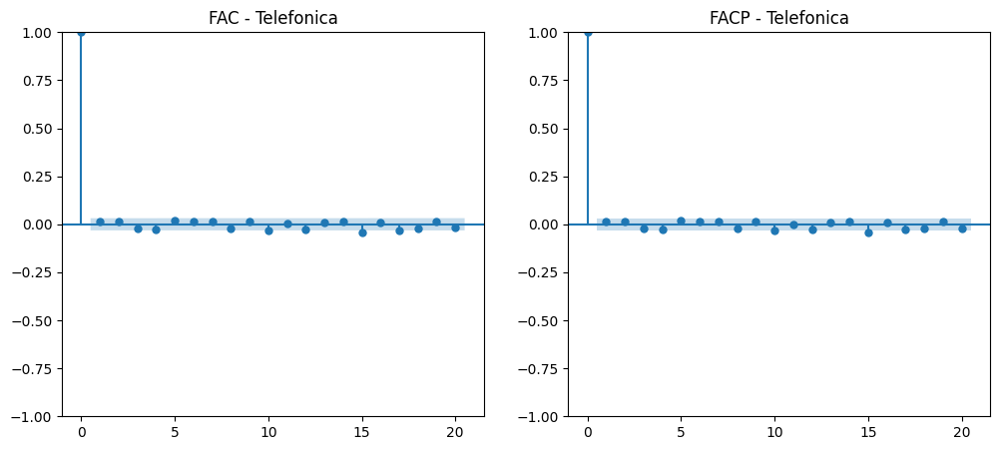

 Resultado ADF para Telefonica:
   - Valor de ADF: -61.12399582484932
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432054971085099, '5%': -2.862293362662052, '10%': -2.567171024463682}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

 Resumen de la prueba de Dickey-Fuller para todas las hojas:
                 ADF Statistic p-valor  \
IBEX 35             -22.354548     0.0   
Acciona             -24.267247     0.0   
Acerinox            -60.031927     0.0   
ACS                  -40.38107     0.0   
ArcelorMittal SA    -22.023358     0.0   
Banco Sabadell      -18.853112     0.0   
Banco Santander     -60.454072     0.0   
Bankinter           -58.869914     0.0   
BBVA                -22.373851     0.0   
Caixabank           -61.299454     0.0   
 Colonial           -29.815529     0.0   
Enagas              -62.153786     0.0   
Endesa              -19.459336     0.0   
Ferrovial            -27.34745     0.0   
Fluidra             -64.666139     0.0   
Grifols         

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from google.colab import files

#CON LOS RENDIMIENTOS LOGARITMICOS
uploaded = files.upload()


file_name = list(uploaded.keys())[0]
xls = pd.ExcelFile(file_name)


hojas = xls.sheet_names
print("Hojas disponibles en el archivo:", hojas)


resultados_adf = {}

for hoja in hojas:
    print(f"\n Analizando: {hoja}")


    df = pd.read_excel(xls, sheet_name=hoja)


    print(f"Columnas en {hoja}: {df.columns}")


    df.columns = df.columns.str.strip()

    if "Exchange Date" not in df.columns or "Rendimientos logarítmicos" not in df.columns:
        print(f" {hoja}: No tiene las columnas necesarias ('Exchange Date' y 'Rendimientos logarítmicos'). Se omite.")
        continue


    df["Exchange Date"] = pd.to_datetime(df["Exchange Date"])
    df.set_index("Exchange Date", inplace=True)


    serie_ts = df["Rendimientos logarítmicos"].dropna()

    plt.figure(figsize=(10, 4))
    plt.plot(serie_ts, marker="o", linestyle="-", label=f"{hoja} - Rendimientos logarítmicos")
    plt.xlabel("Fecha")
    plt.ylabel("Rendimientos logarítmicos")
    plt.title(f"Evolución de los Rendimientos logarítmicos - {hoja}")
    plt.legend()
    plt.grid()
    plt.show()


    fig, ax = plt.subplots(1, 2, figsize=(12, 5))
    plot_acf(serie_ts, ax=ax[0], lags=20)
    plot_pacf(serie_ts, ax=ax[1], lags=20)
    ax[0].set_title(f"FAC - {hoja}")
    ax[1].set_title(f"FACP - {hoja}")
    plt.show()

    adf_result = adfuller(serie_ts)
    p_valor = adf_result[1]

    resultados_adf[hoja] = {
        "ADF Statistic": adf_result[0],
        "p-valor": p_valor,
        "Valores críticos": adf_result[4]
    }


    print(f" Resultado ADF para {hoja}:")
    print(f"   - Valor de ADF: {adf_result[0]}")
    print(f"   - p-valor: {p_valor:.10}")
    print(f"   - Valores críticos: {adf_result[4]}")

    if p_valor < 0.05:
        print(" La serie es ESTACIONARIA (se rechaza la hipótesis nula).")
    else:
        print(" La serie NO es estacionaria (no se puede rechazar la hipótesis nula).")


df_resultados = pd.DataFrame(resultados_adf).T
print("\n Resumen de la prueba de Dickey-Fuller para todas las hojas:")
print(df_resultados)


df_resultados.to_csv("resultados_adf.csv")
print("Archivo 'resultados_adf.csv' generado con los resultados.")




<ipython-input-16-b40979148693>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_temp.rename(columns={'Rendimientos logarítmicos ': empresa}, inplace=True)
<ipython-input-16-b40979148693>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_temp.rename(columns={'Rendimientos logarítmicos ': empresa}, inplace=True)


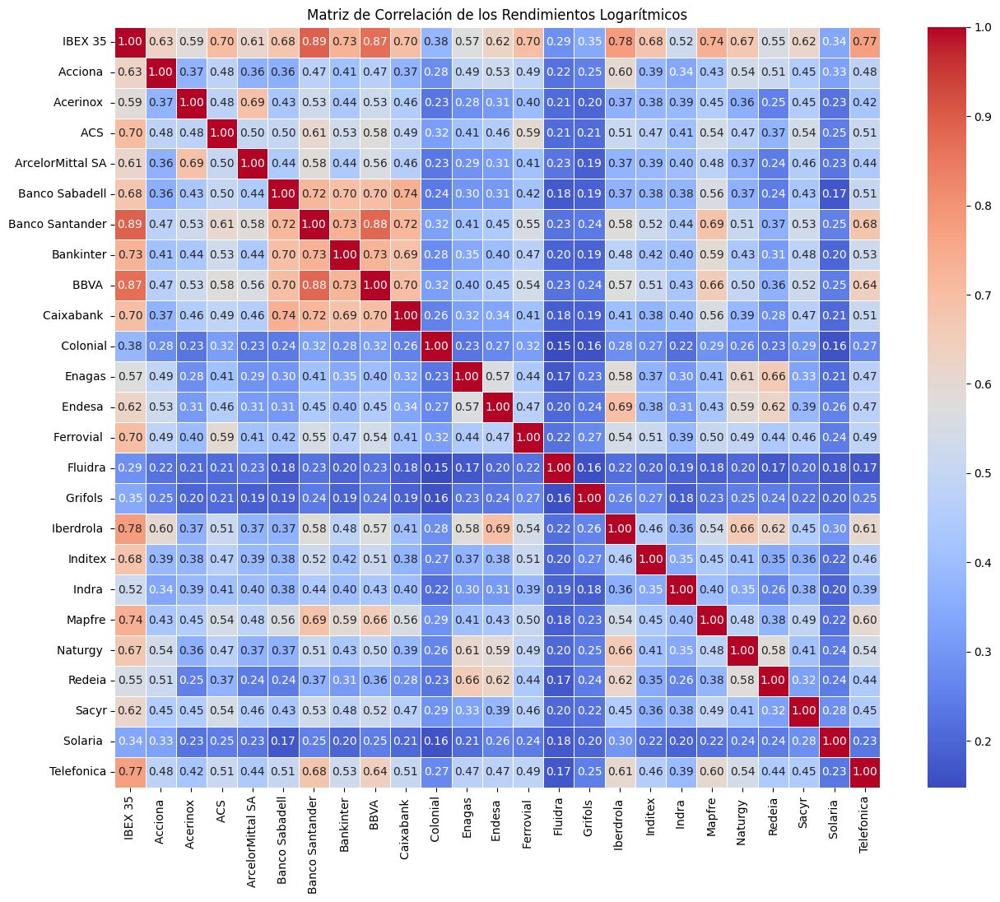

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


file_path = '/content/BASE DE DATOS !  (1).xlsx'


empresas = [
    'IBEX 35', 'Acciona ', 'Acerinox ', 'ACS ', 'ArcelorMittal SA', 'Banco Sabadell', 'Banco Santander',
    'Bankinter', 'BBVA ', 'Caixabank ', ' Colonial', 'Enagas', 'Endesa ', 'Ferrovial ', 'Fluidra',
    'Grifols ', 'Iberdrola ', 'Inditex', 'Indra ', 'Mapfre', 'Naturgy ', 'Redeia', 'Sacyr',
    'Solaria ', 'Telefonica'
]


xls = pd.ExcelFile(file_path)


df_dict = {}

for empresa in empresas:
    df_temp = pd.read_excel(xls, sheet_name=empresa)[['Exchange Date', 'Rendimientos logarítmicos ']]
    df_temp.rename(columns={'Rendimientos logarítmicos ': empresa}, inplace=True)
    df_dict[empresa] = df_temp

merged_df = df_dict['IBEX 35']
for empresa, df in df_dict.items():
    if empresa != 'IBEX 35':
        merged_df = merged_df.merge(df, on='Exchange Date', how='left')

merged_df = merged_df.dropna()

correlation_matrix = merged_df.iloc[:, 1:].corr()

plt.figure(figsize=(15, 12))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)
plt.title("Matriz de Correlación de los Rendimientos Logarítmicos")
plt.show()


Saving BASE DE DATOS ! .xlsx to BASE DE DATOS !  (4).xlsx
Hojas disponibles en el archivo: ['IBEX 35', 'Acciona ', 'Acerinox ', 'ACS ', 'ArcelorMittal SA', 'Banco Sabadell', 'Banco Santander', 'Bankinter', 'BBVA ', 'Caixabank ', ' Colonial', 'Enagas', 'Endesa ', 'Ferrovial ', 'Fluidra', 'Grifols ', 'Iberdrola ', 'Inditex', 'Indra ', 'Mapfre', 'Naturgy ', 'Redeia', 'Rovi', 'Sacyr', 'Solaria ', 'Telefonica']

📊 Analizando: IBEX 35


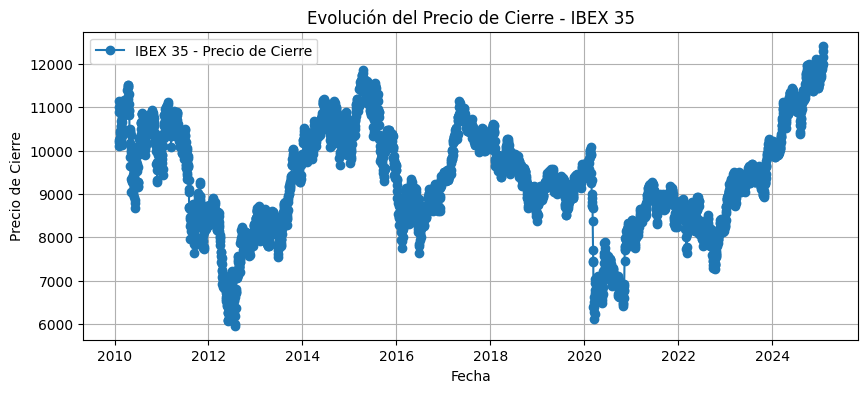

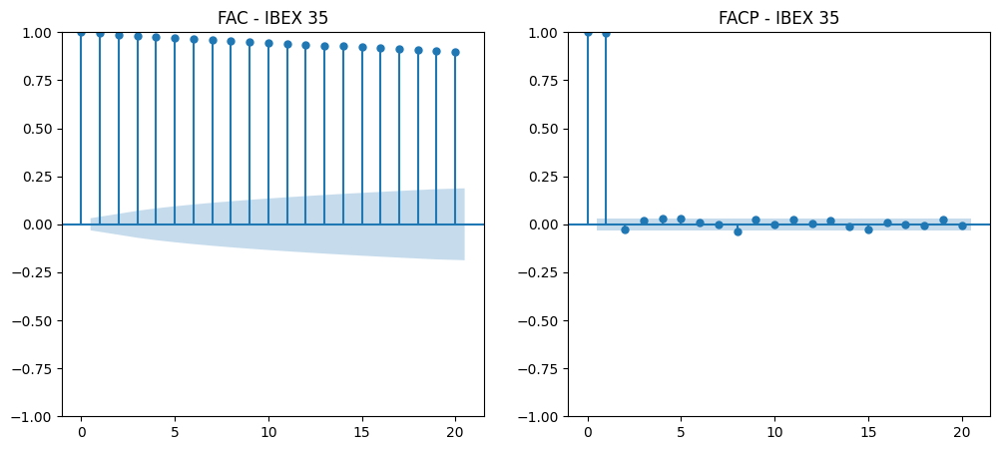

📌 Resultado ADF para IBEX 35:
   - Valor de ADF: -3.2400207506488625
   - p-valor: 0.017781889838035518
   - Valores críticos: {'1%': -3.432058534773547, '5%': -2.8622949368701343, '10%': -2.5671718625118447}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

📊 Analizando: Acciona 


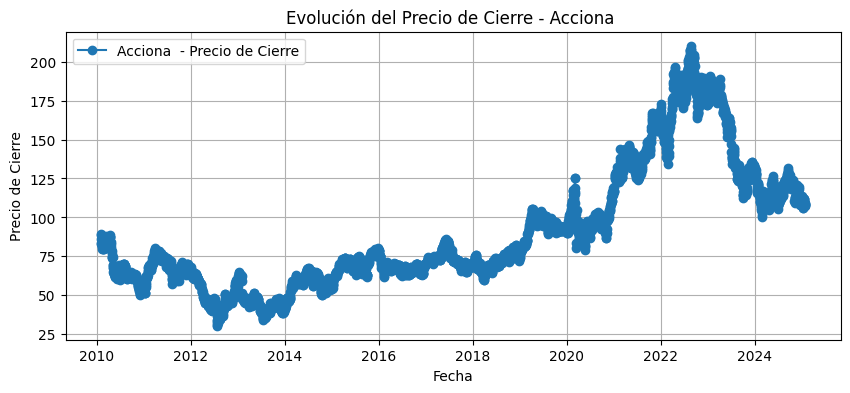

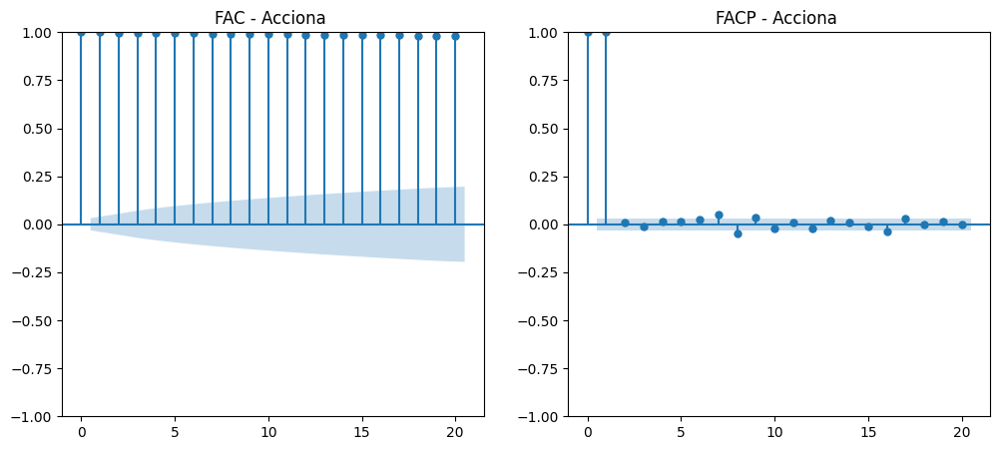

📌 Resultado ADF para Acciona :
   - Valor de ADF: -1.3624147629909316
   - p-valor: 0.6001565111939194
   - Valores críticos: {'1%': -3.4320589812823554, '5%': -2.8622951341088414, '10%': -2.5671719675142097}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Acerinox 


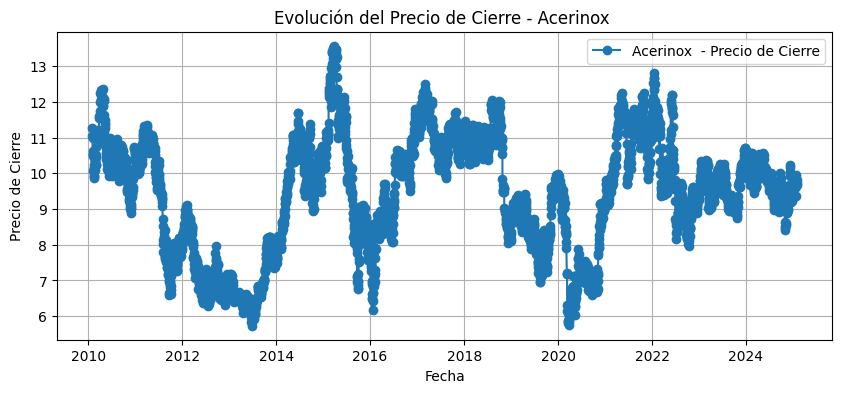

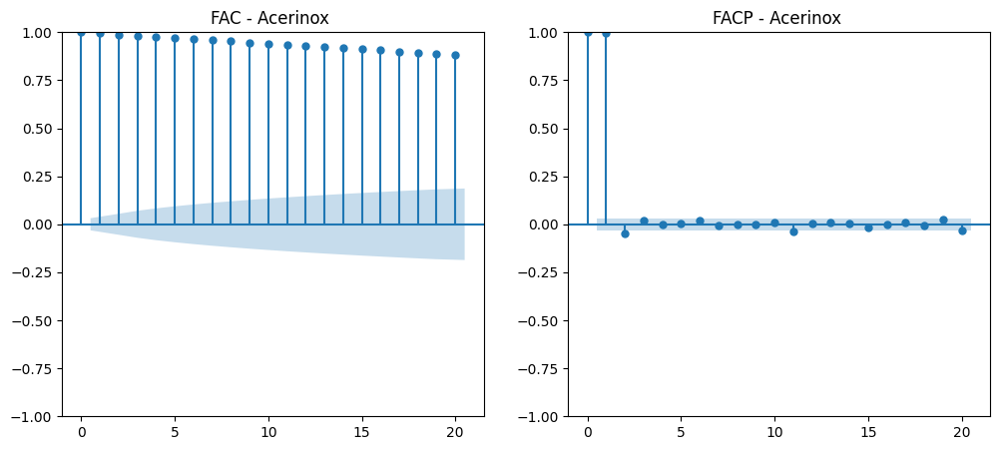

📌 Resultado ADF para Acerinox :
   - Valor de ADF: -3.4023064861288037
   - p-valor: 0.010880494506054479
   - Valores críticos: {'1%': -3.4320554157329366, '5%': -2.862293559078938, '10%': -2.5671711290285004}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

📊 Analizando: ACS 


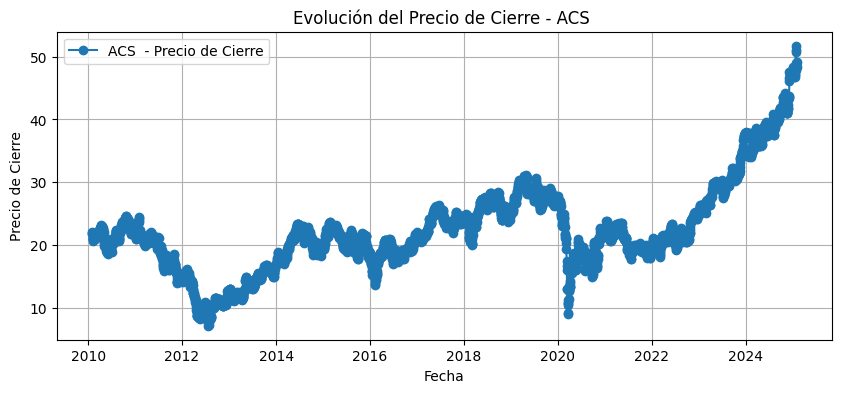

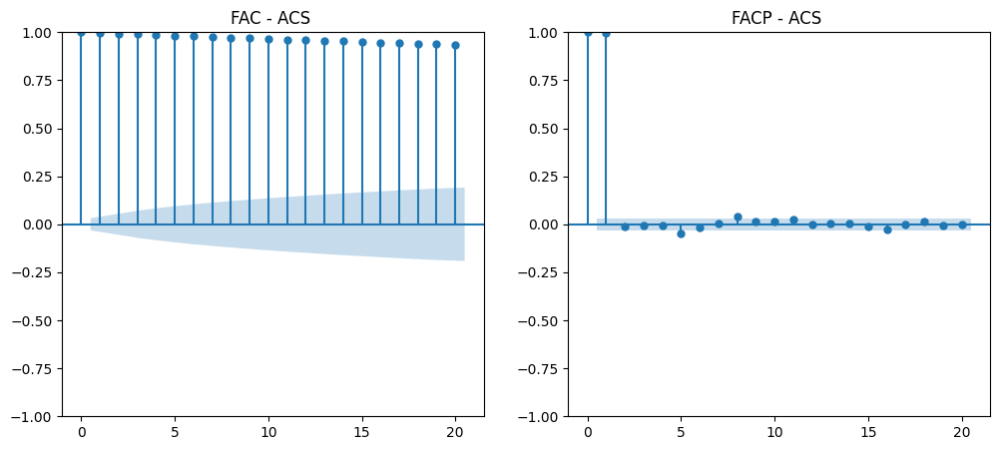

📌 Resultado ADF para ACS :
   - Valor de ADF: -3.623375700165742
   - p-valor: 0.005329542455074437
   - Valores críticos: {'1%': -3.432055860612759, '5%': -2.86229375559827, '10%': -2.5671712336478625}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

📊 Analizando: ArcelorMittal SA


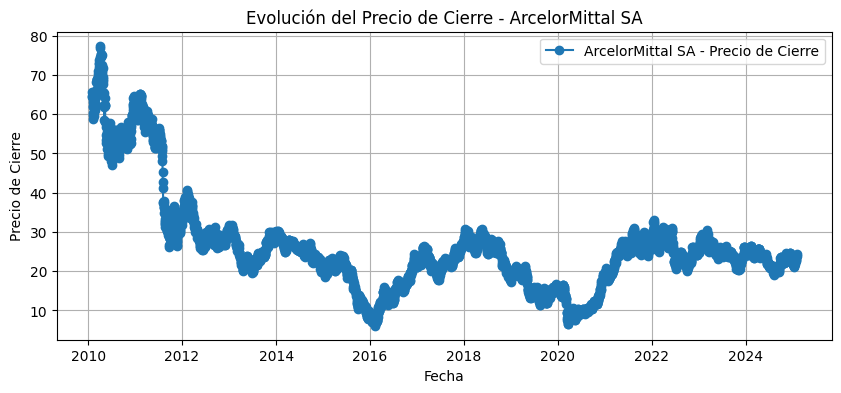

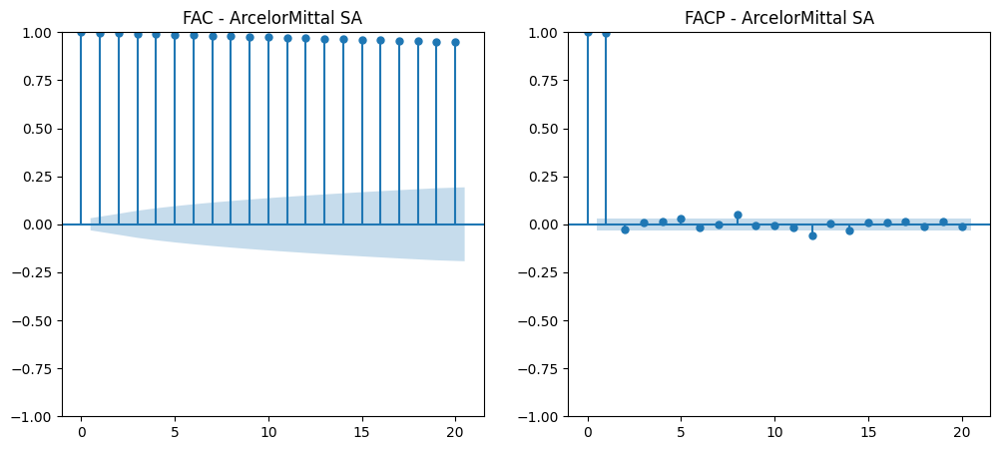

📌 Resultado ADF para ArcelorMittal SA:
   - Valor de ADF: -0.43465214264024615
   - p-valor: 0.9041503671577393
   - Valores críticos: {'1%': -3.4320580884979983, '5%': -2.8622947397344367, '10%': -2.567171757564323}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Banco Sabadell


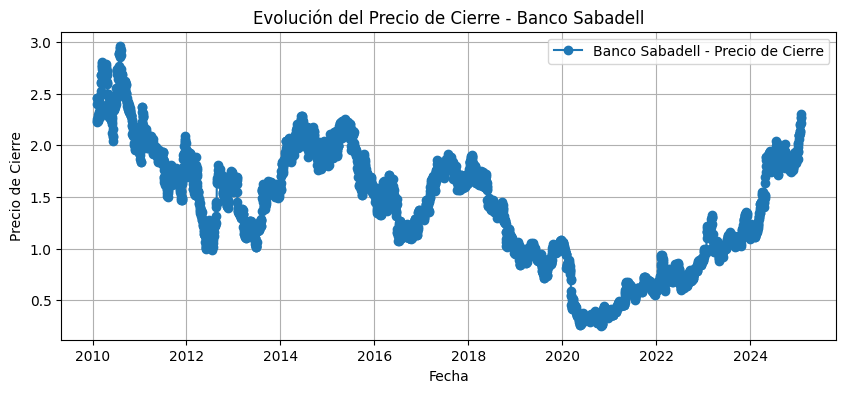

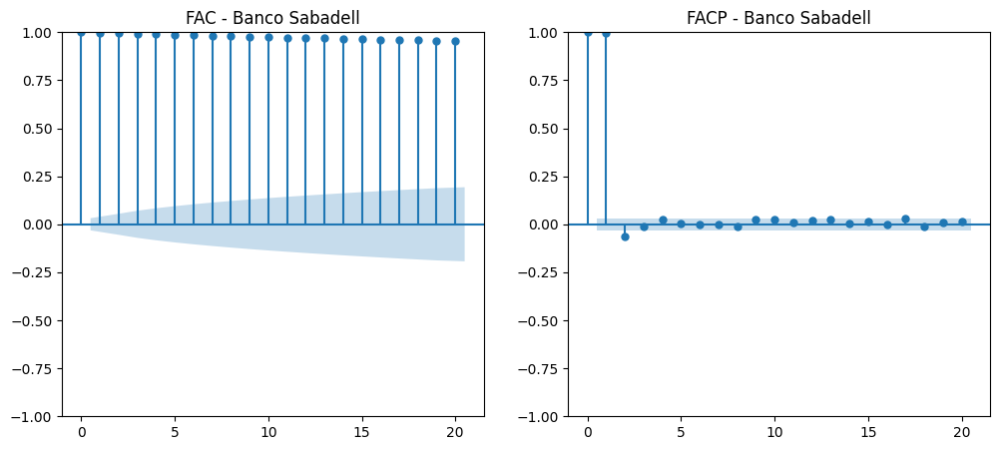

📌 Resultado ADF para Banco Sabadell:
   - Valor de ADF: -1.3136704178897438
   - p-valor: 0.6228951057490905
   - Valores críticos: {'1%': -3.4320666077988116, '5%': -2.862298503005894, '10%': -2.567173760987284}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Banco Santander


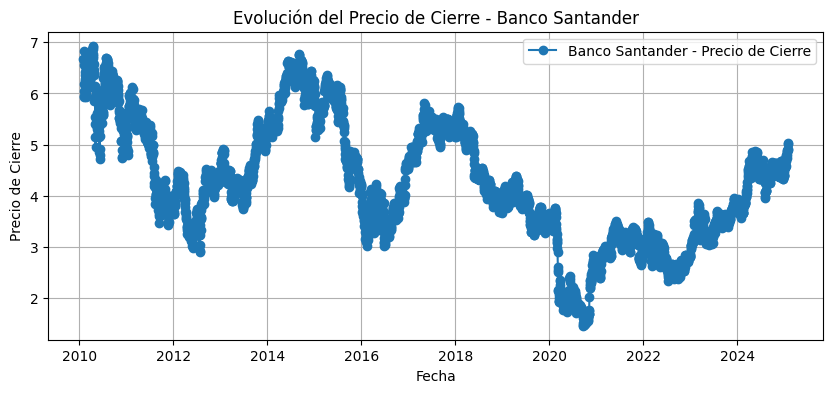

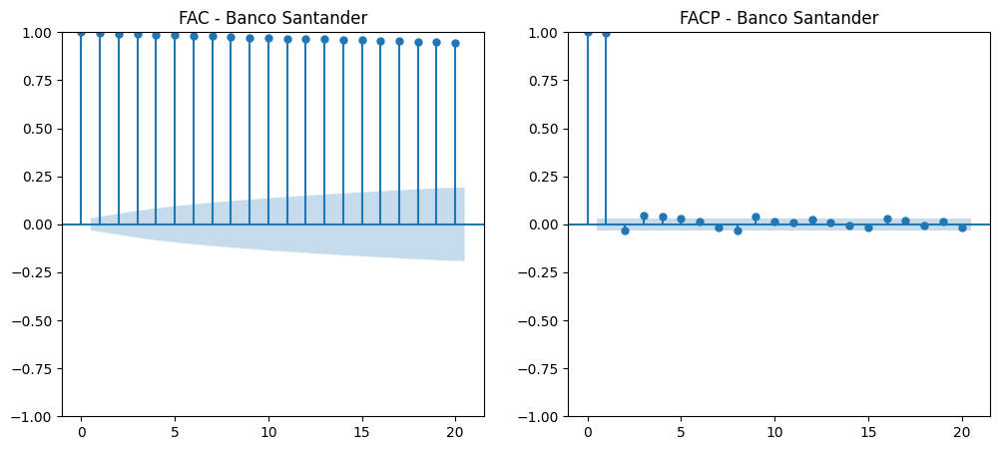

📌 Resultado ADF para Banco Santander:
   - Valor de ADF: -1.5395545264764763
   - p-valor: 0.5138615054198591
   - Valores críticos: {'1%': -3.4320598750004825, '5%': -2.862295528895607, '10%': -2.567172177683642}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Bankinter


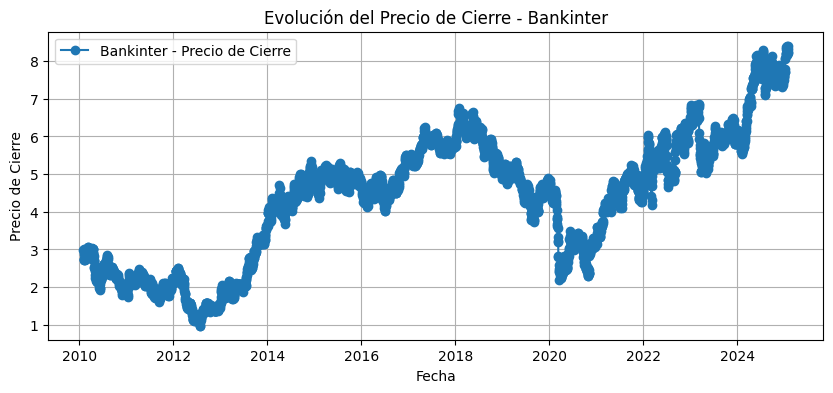

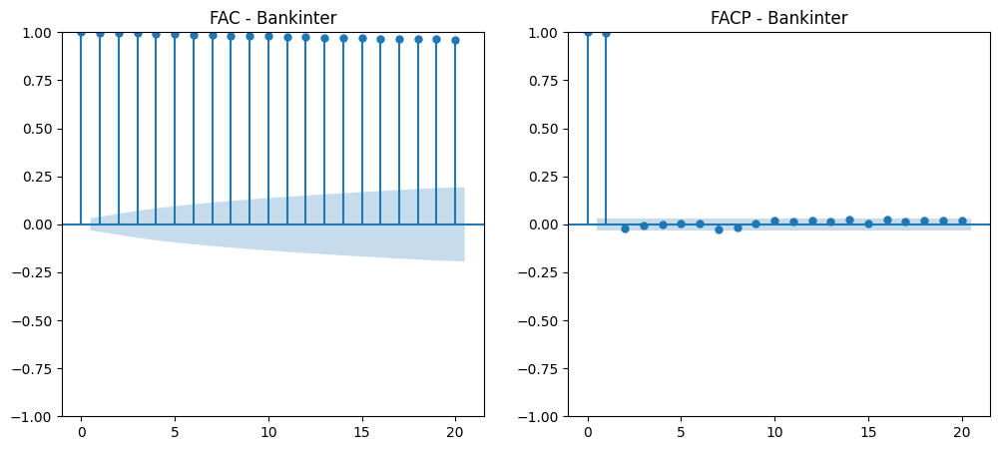

📌 Resultado ADF para Bankinter:
   - Valor de ADF: -2.168669936864745
   - p-valor: 0.21781227769163652
   - Valores críticos: {'1%': -3.4320616652439133, '5%': -2.8622963197088107, '10%': -2.5671725986825202}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: BBVA 


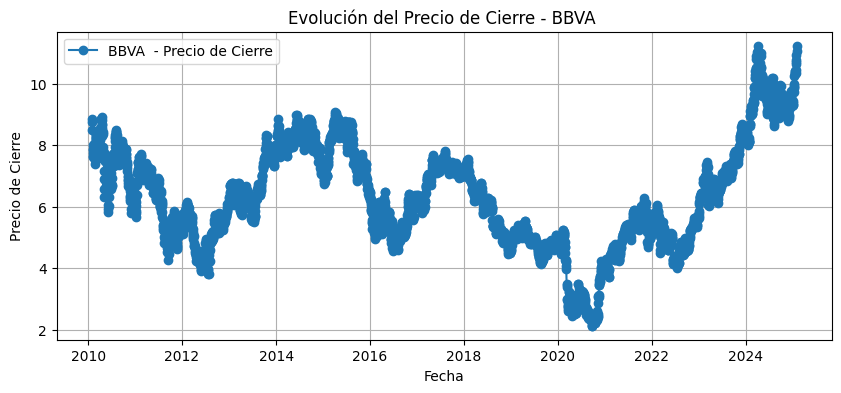

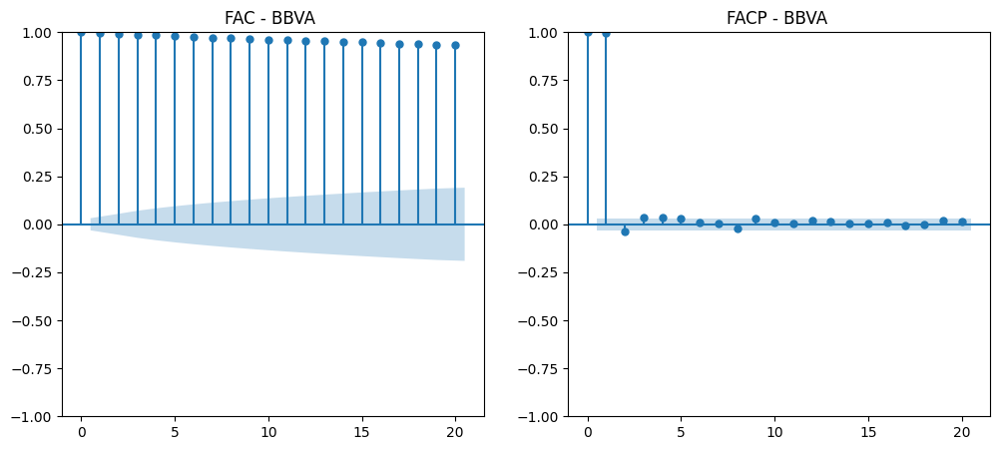

📌 Resultado ADF para BBVA :
   - Valor de ADF: -2.822534195826619
   - p-valor: 0.05512631513021039
   - Valores críticos: {'1%': -3.432056751069083, '5%': -2.8622941489445943, '10%': -2.567171443050389}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Caixabank 


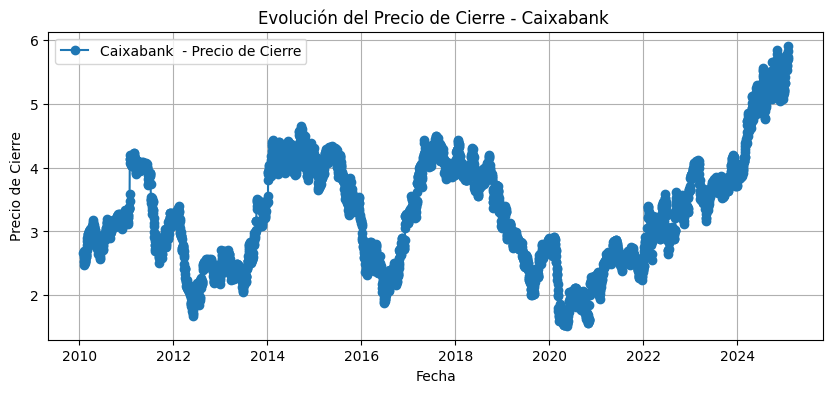

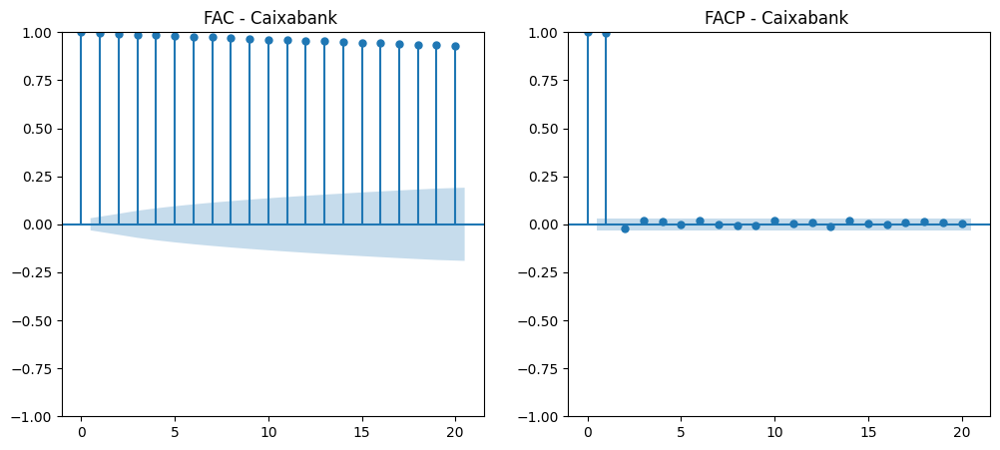

📌 Resultado ADF para Caixabank :
   - Valor de ADF: -3.1780066941480163
   - p-valor: 0.021293558201774105
   - Valores críticos: {'1%': -3.4320554157329366, '5%': -2.862293559078938, '10%': -2.5671711290285004}
✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).

📊 Analizando:  Colonial


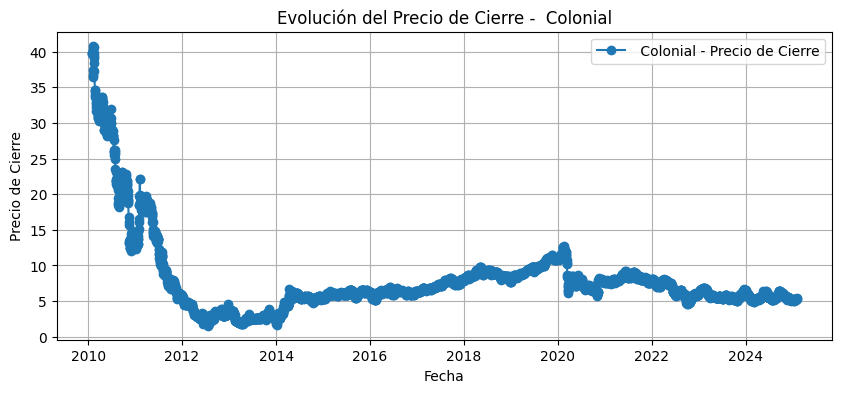

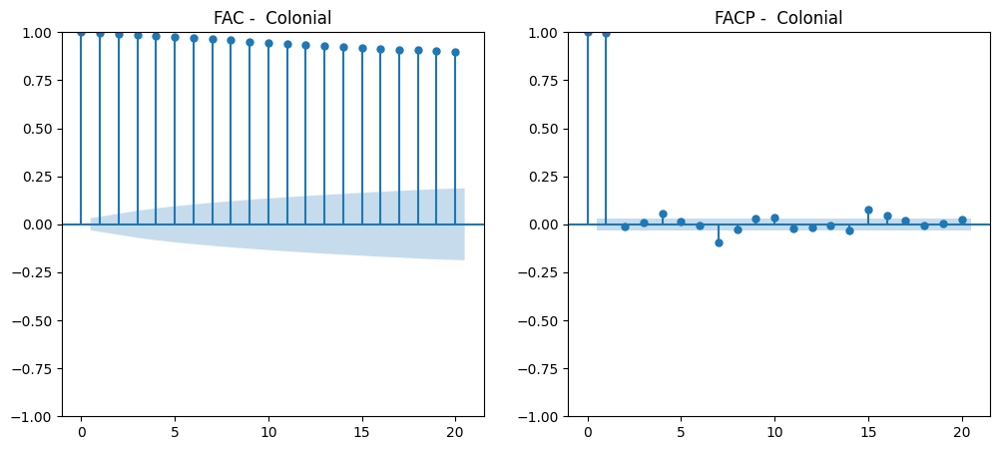

📌 Resultado ADF para  Colonial:
   - Valor de ADF: 4.067140502973888
   - p-valor: 1.0
   - Valores críticos: {'1%': -3.4320684121759575, '5%': -2.862299300060652, '10%': -2.567174185309234}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Enagas


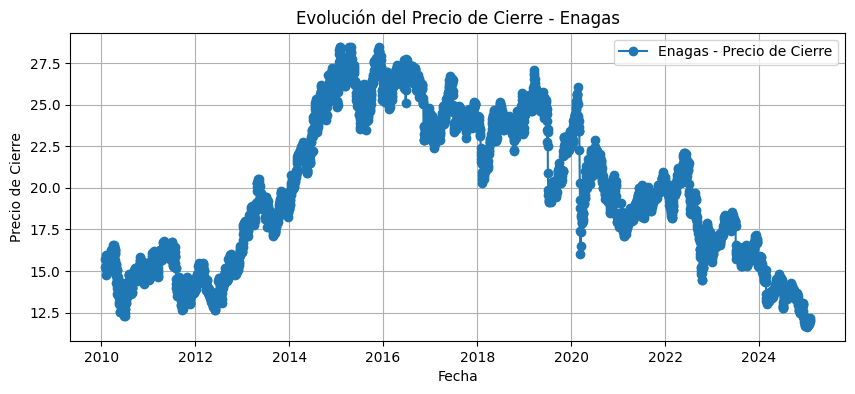

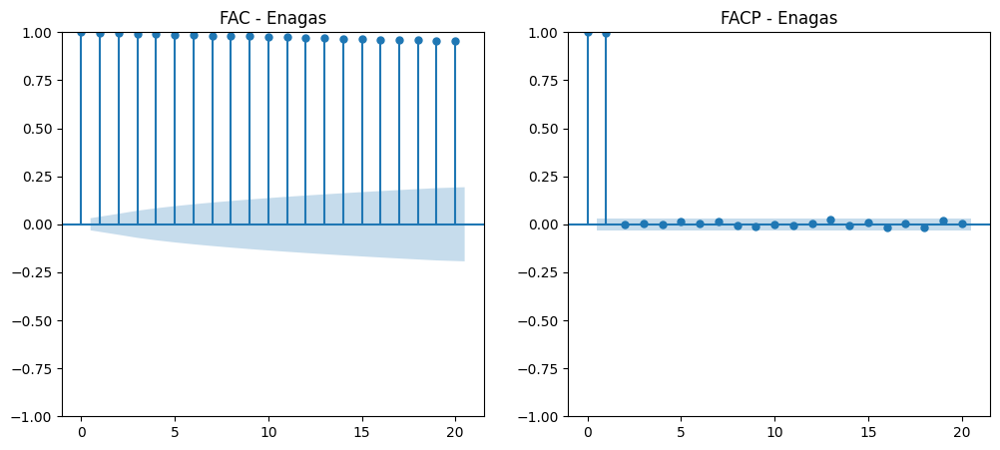

📌 Resultado ADF para Enagas:
   - Valor de ADF: -2.1716520101753987
   - p-valor: 0.2166945136007637
   - Valores críticos: {'1%': -3.432054971085099, '5%': -2.862293362662052, '10%': -2.567171024463682}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Endesa 


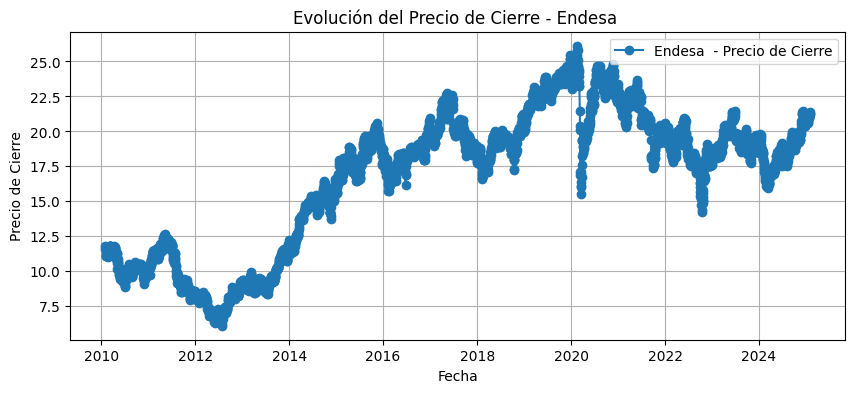

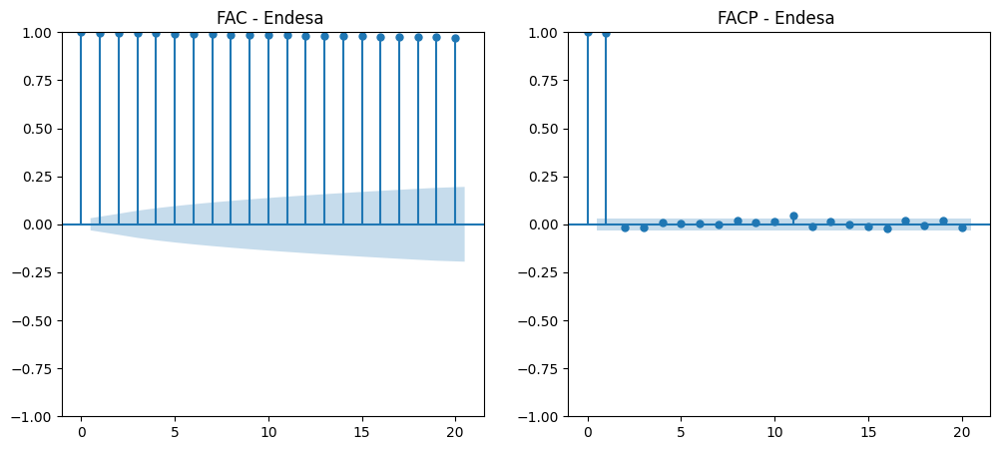

📌 Resultado ADF para Endesa :
   - Valor de ADF: -1.3457424132481048
   - p-valor: 0.6079941529307672
   - Valores críticos: {'1%': -3.4320598750004825, '5%': -2.862295528895607, '10%': -2.567172177683642}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Ferrovial 


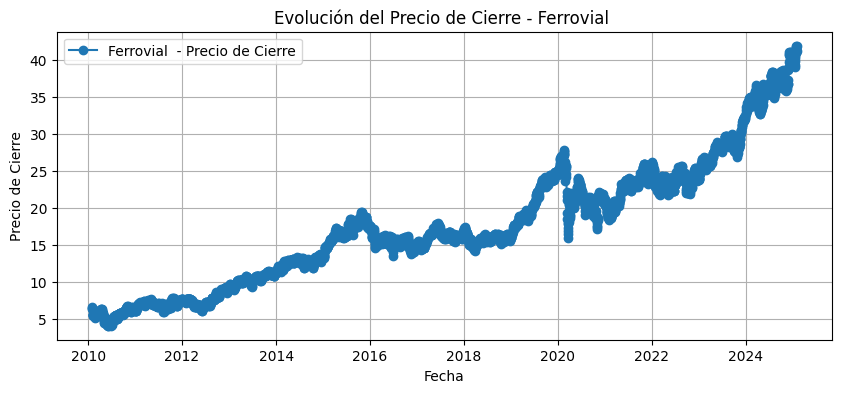

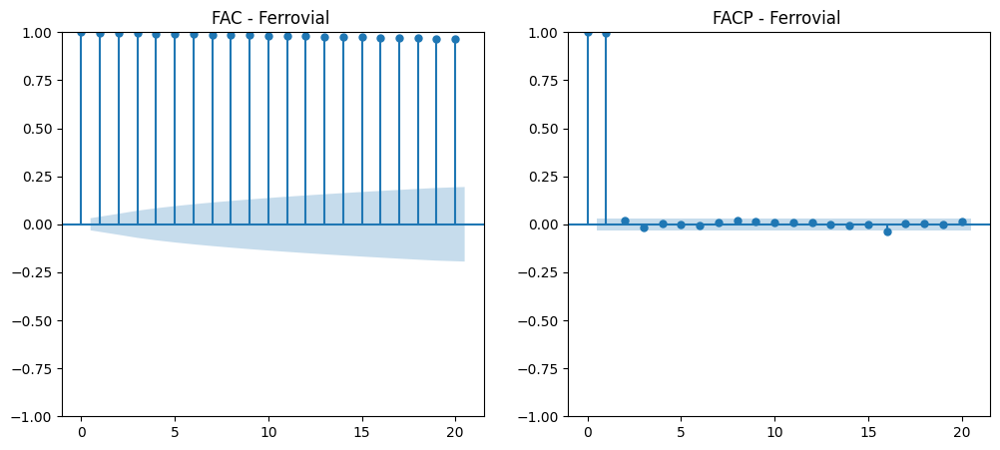

📌 Resultado ADF para Ferrovial :
   - Valor de ADF: -2.646979132914149
   - p-valor: 0.08367105691845822
   - Valores críticos: {'1%': -3.432054971085099, '5%': -2.862293362662052, '10%': -2.567171024463682}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Fluidra


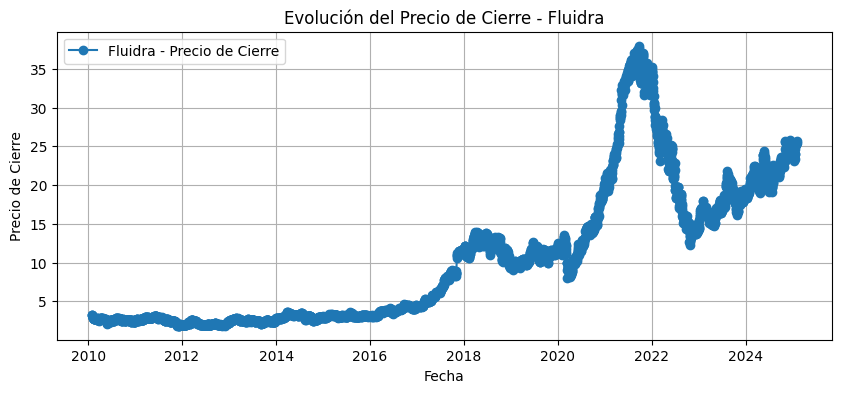

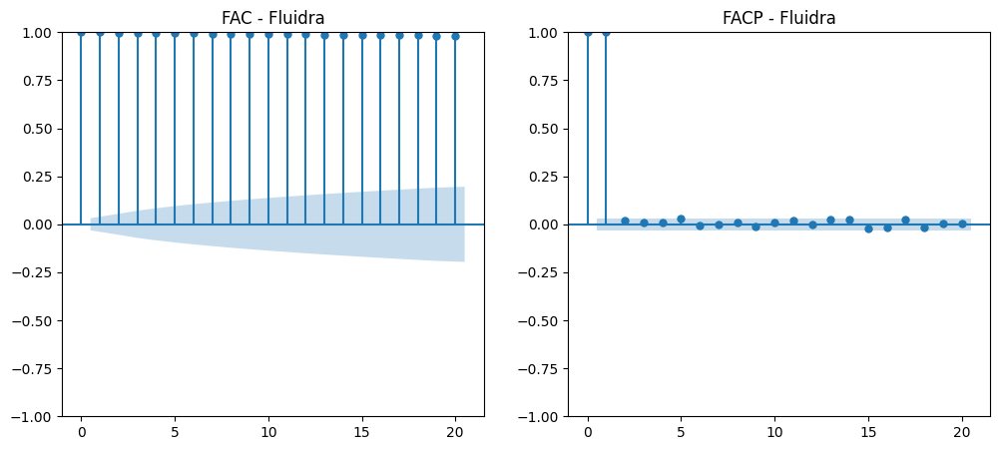

📌 Resultado ADF para Fluidra:
   - Valor de ADF: -1.5257756022638191
   - p-valor: 0.5207241796274746
   - Valores críticos: {'1%': -3.432056751069083, '5%': -2.8622941489445943, '10%': -2.567171443050389}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Grifols 


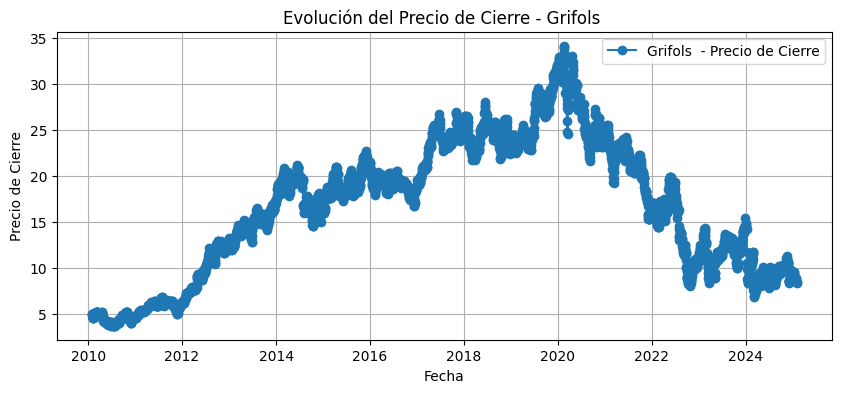

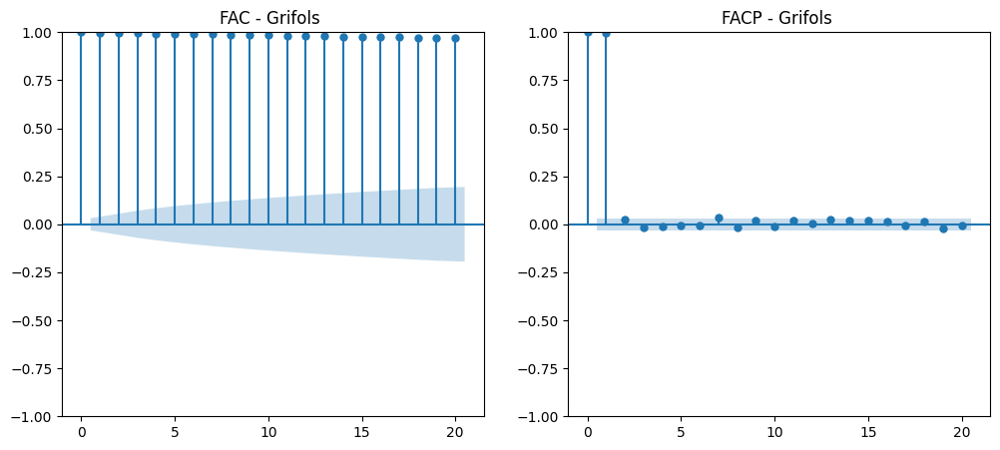

📌 Resultado ADF para Grifols :
   - Valor de ADF: -1.0558680569920786
   - p-valor: 0.7323467117331822
   - Valores críticos: {'1%': -3.4320607696538454, '5%': -2.8622959240953807, '10%': -2.5671723880729633}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Iberdrola 


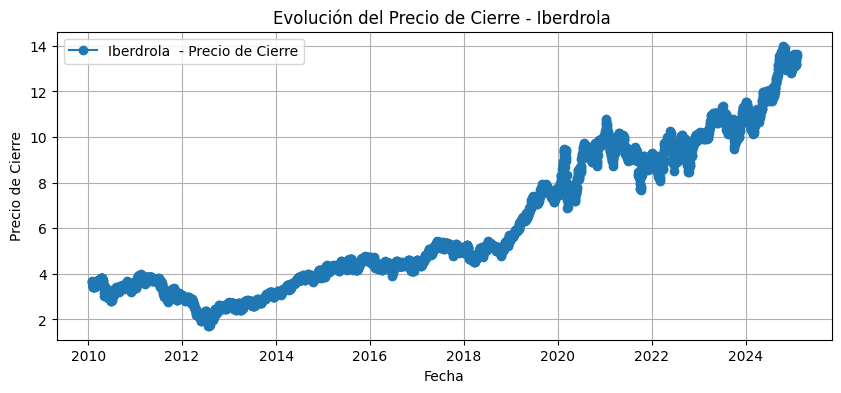

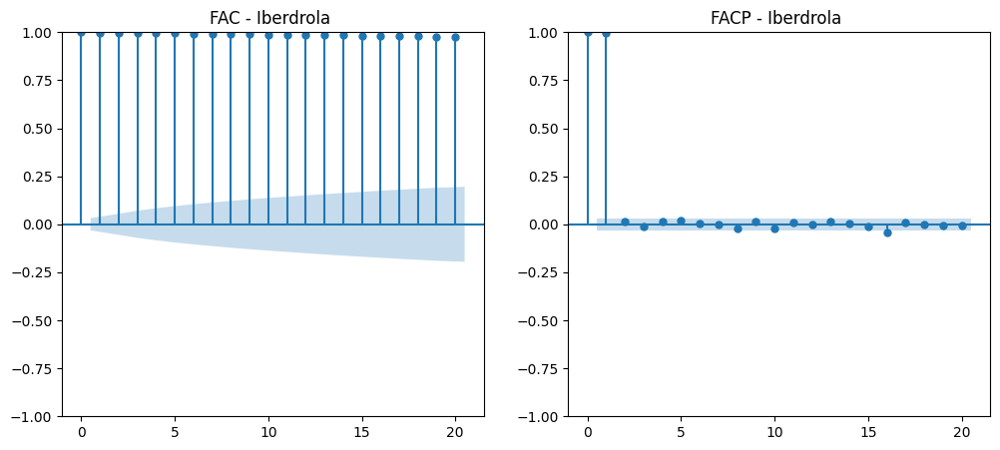

📌 Resultado ADF para Iberdrola :
   - Valor de ADF: -2.1206406264654722
   - p-valor: 0.23629630185271921
   - Valores críticos: {'1%': -3.432067058537759, '5%': -2.862298702112663, '10%': -2.5671738669842252}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Inditex


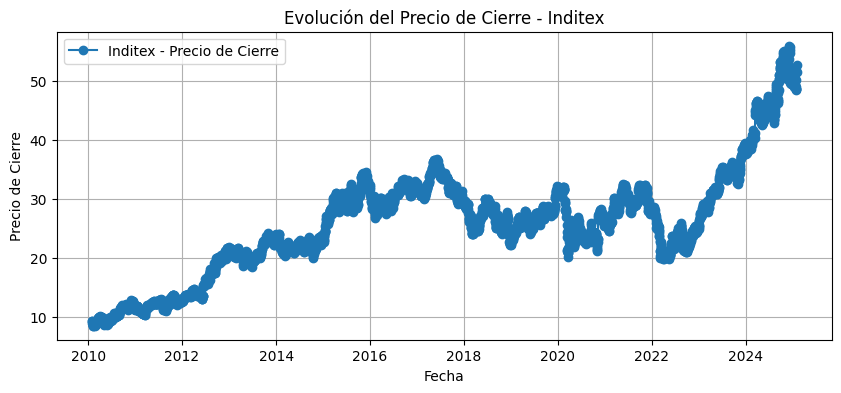

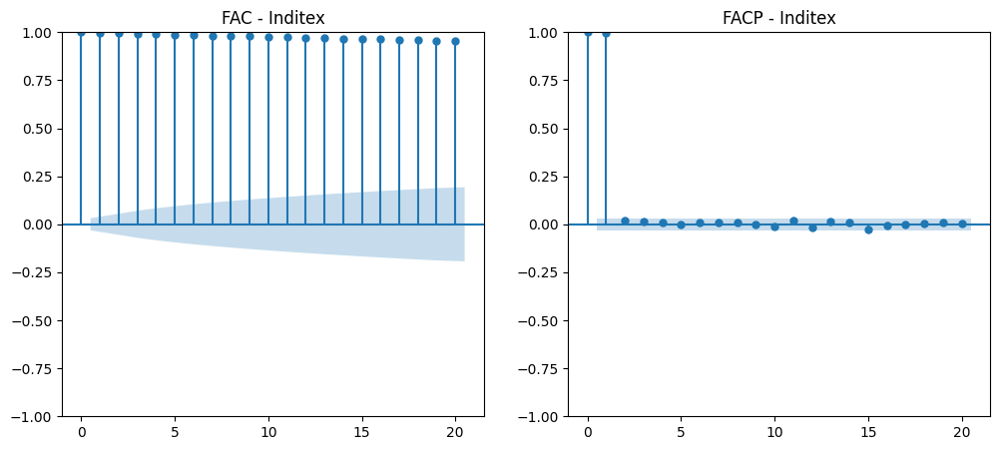

📌 Resultado ADF para Inditex:
   - Valor de ADF: -2.371772858161656
   - p-valor: 0.14986229206312346
   - Valores críticos: {'1%': -3.432054971085099, '5%': -2.862293362662052, '10%': -2.567171024463682}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Indra 


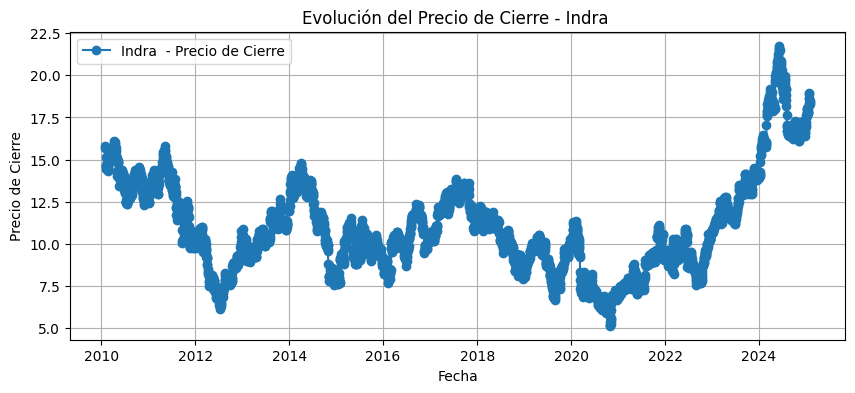

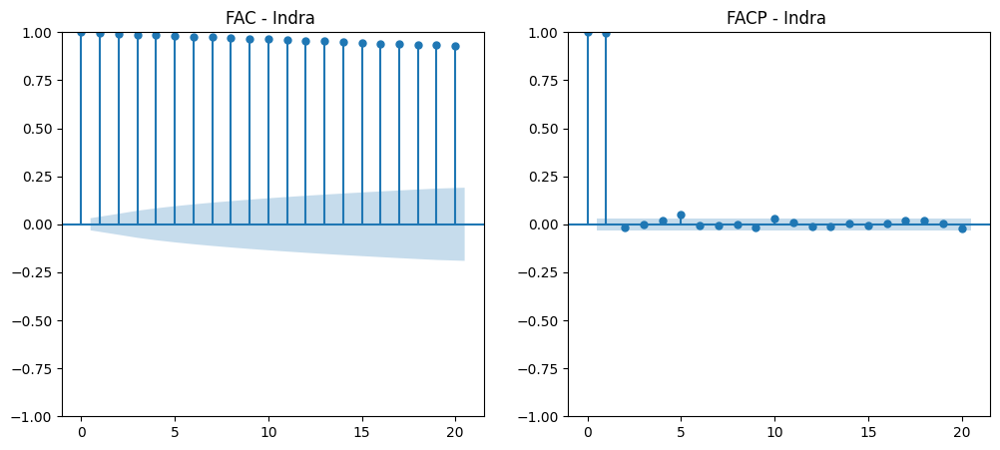

📌 Resultado ADF para Indra :
   - Valor de ADF: -2.605021333843816
   - p-valor: 0.09196389457355642
   - Valores críticos: {'1%': -3.432056751069083, '5%': -2.8622941489445943, '10%': -2.567171443050389}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Mapfre


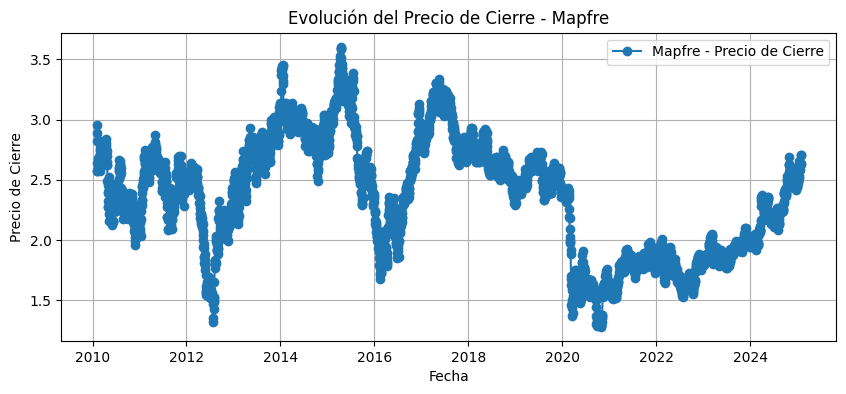

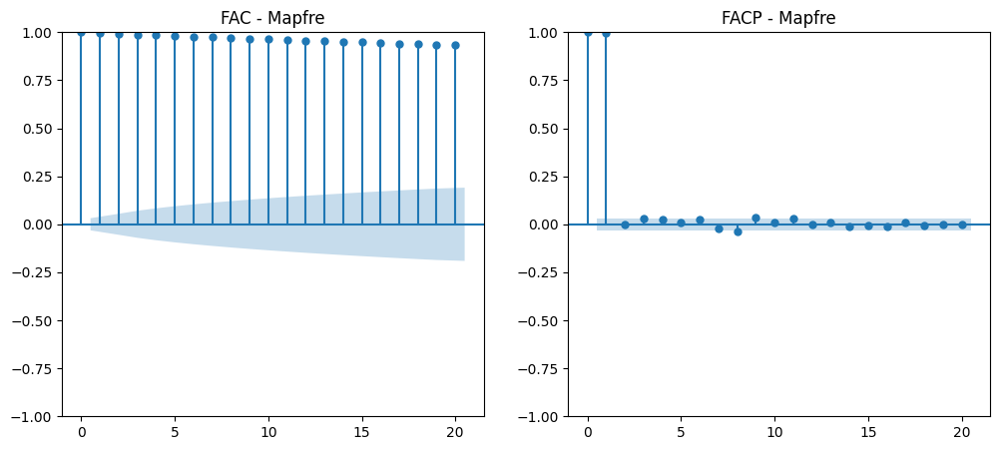

📌 Resultado ADF para Mapfre:
   - Valor de ADF: -2.654807247068469
   - p-valor: 0.0821903348177801
   - Valores críticos: {'1%': -3.432054971085099, '5%': -2.862293362662052, '10%': -2.567171024463682}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Naturgy 


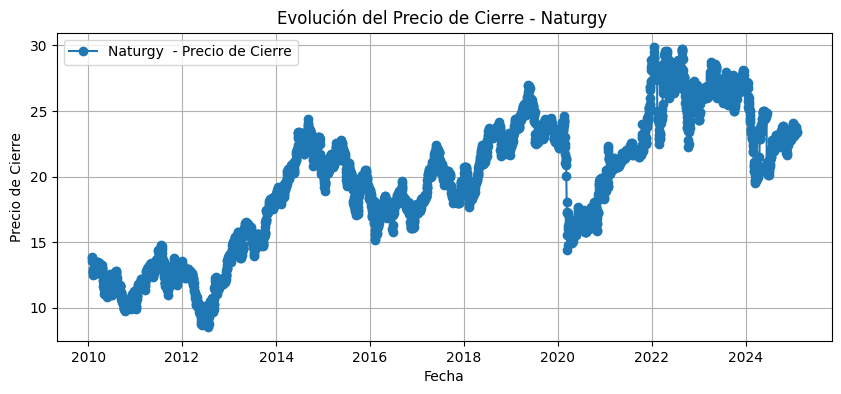

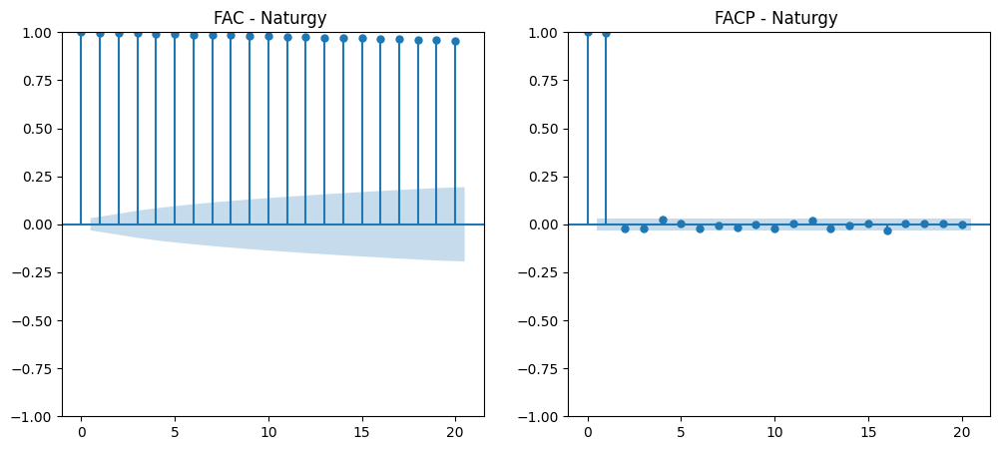

📌 Resultado ADF para Naturgy :
   - Valor de ADF: -1.7312869869581802
   - p-valor: 0.41506882070331275
   - Valores críticos: {'1%': -3.432056305724747, '5%': -2.8622939522201287, '10%': -2.567171338321811}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Redeia


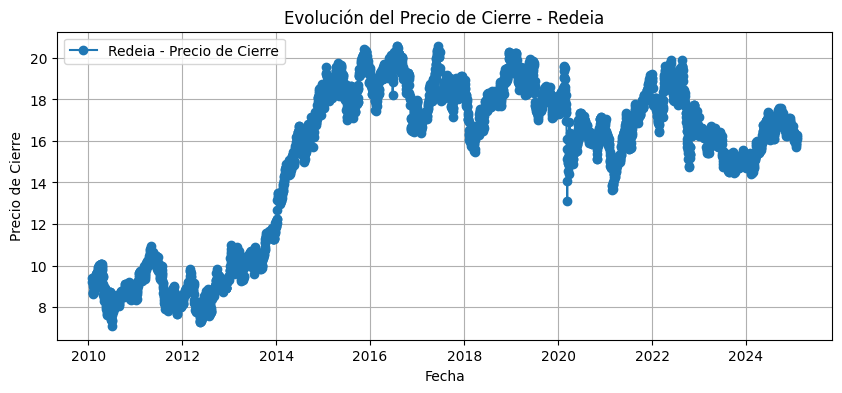

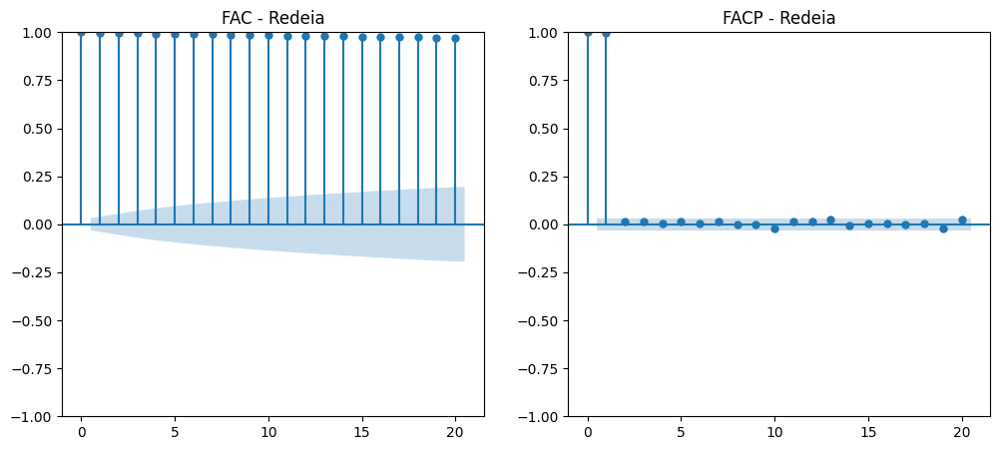

📌 Resultado ADF para Redeia:
   - Valor de ADF: -1.2324128819452467
   - p-valor: 0.6594994530341699
   - Valores críticos: {'1%': -3.432054971085099, '5%': -2.862293362662052, '10%': -2.567171024463682}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Rovi


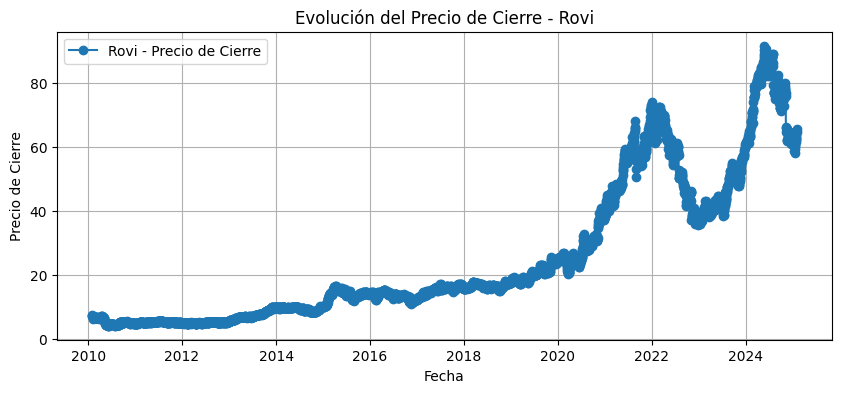

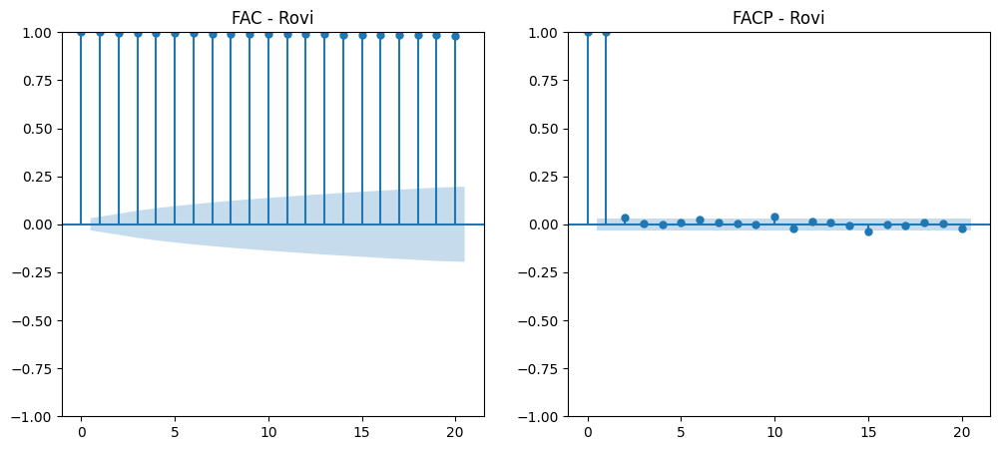

📌 Resultado ADF para Rovi:
   - Valor de ADF: -1.5573336963745654
   - p-valor: 0.5049829079290092
   - Valores críticos: {'1%': -3.432070672988693, '5%': -2.8623002987378547, '10%': -2.567174716967499}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Sacyr


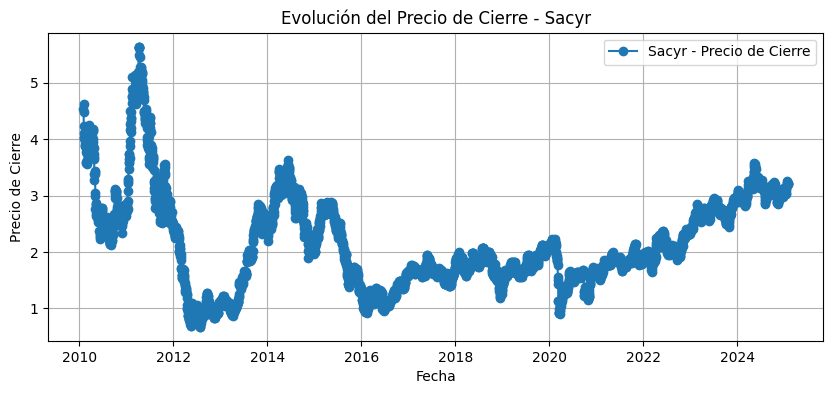

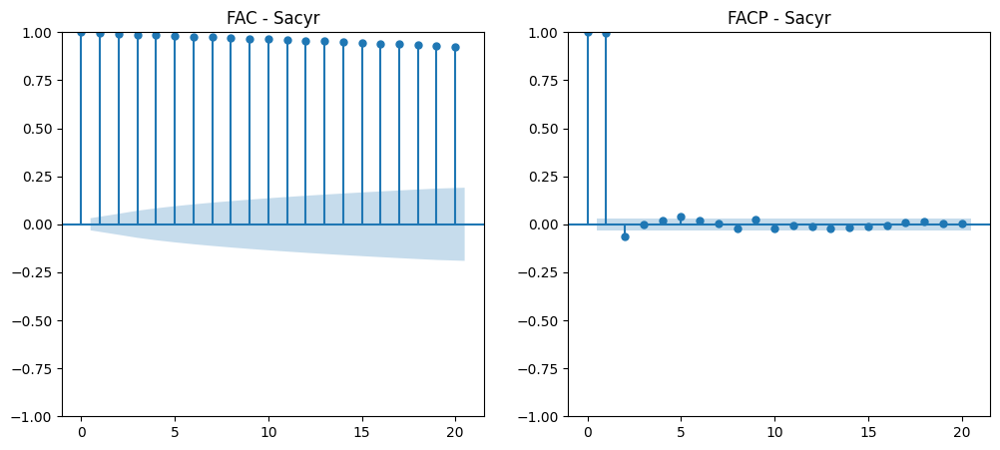

📌 Resultado ADF para Sacyr:
   - Valor de ADF: -1.626995060148447
   - p-valor: 0.46906400647083685
   - Valores críticos: {'1%': -3.4320589812823554, '5%': -2.8622951341088414, '10%': -2.5671719675142097}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Solaria 


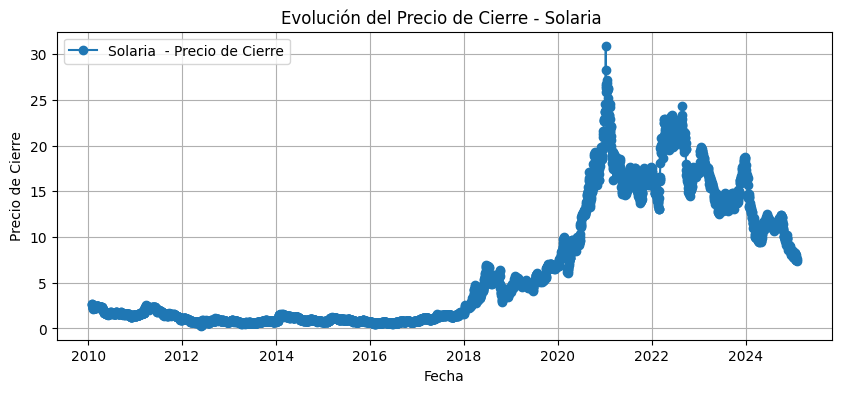

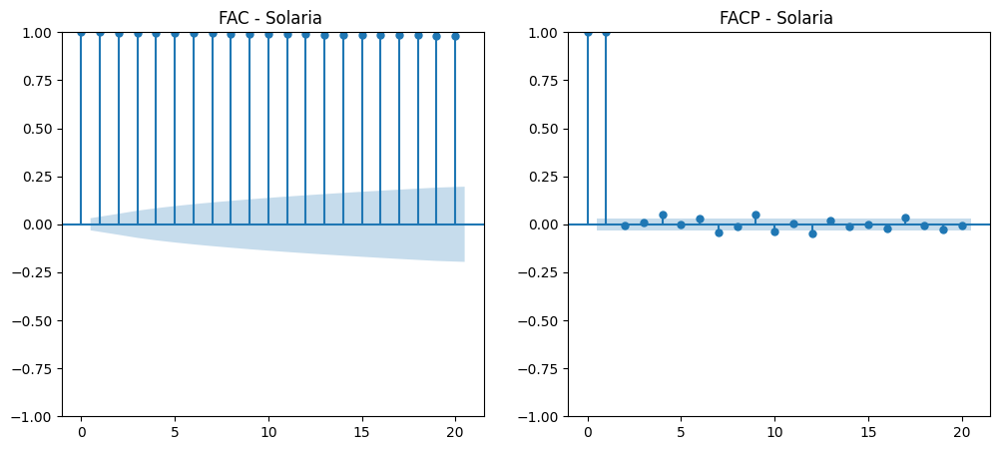

📌 Resultado ADF para Solaria :
   - Valor de ADF: -1.267355964567078
   - p-valor: 0.6439715790127334
   - Valores críticos: {'1%': -3.4320598750004825, '5%': -2.862295528895607, '10%': -2.567172177683642}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Analizando: Telefonica


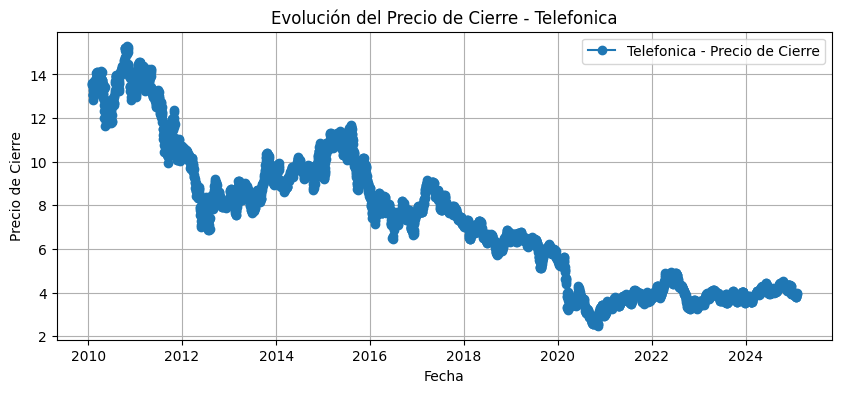

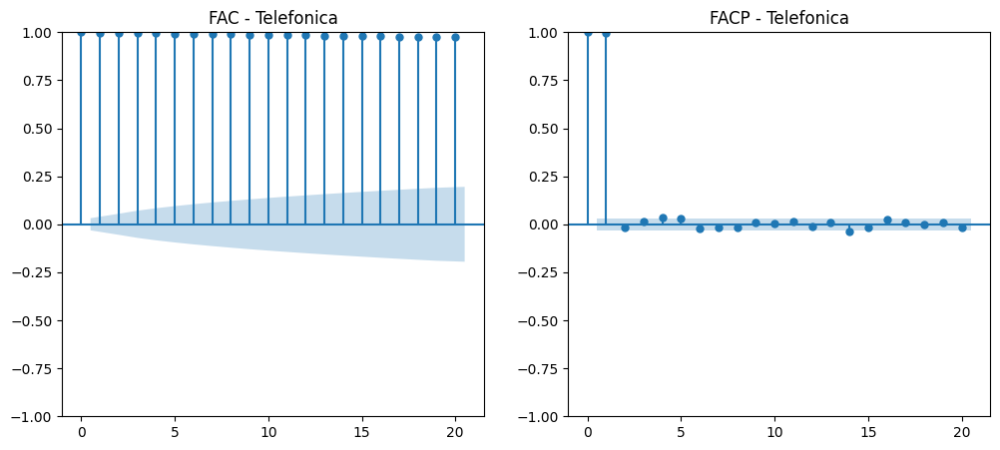

📌 Resultado ADF para Telefonica:
   - Valor de ADF: -0.5737648840200243
   - p-valor: 0.8768005828216678
   - Valores críticos: {'1%': -3.4320616652439133, '5%': -2.8622963197088107, '10%': -2.5671725986825202}
❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).

📊 Resumen de la prueba de Dickey-Fuller para todas las hojas:
                 ADF Statistic   p-valor  \
IBEX 35              -3.240021  0.017782   
Acciona              -1.362415  0.600157   
Acerinox             -3.402306   0.01088   
ACS                  -3.623376   0.00533   
ArcelorMittal SA     -0.434652   0.90415   
Banco Sabadell        -1.31367  0.622895   
Banco Santander      -1.539555  0.513862   
Bankinter             -2.16867  0.217812   
BBVA                 -2.822534  0.055126   
Caixabank            -3.178007  0.021294   
 Colonial             4.067141       1.0   
Enagas               -2.171652  0.216695   
Endesa               -1.345742  0.607994   
Ferrovial            -2.646979  0.0836

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from google.colab import files


uploaded = files.upload()


file_name = list(uploaded.keys())[0]
xls = pd.ExcelFile(file_name)

hojas = xls.sheet_names
print("Hojas disponibles en el archivo:", hojas)


resultados_adf = {}

for hoja in hojas:
    print(f"\n Analizando: {hoja}")


    df = pd.read_excel(xls, sheet_name=hoja)

    if "Exchange Date" not in df.columns or "Close" not in df.columns:
        print(f" {hoja}: No tiene las columnas necesarias ('Exchange Date' y 'Close'). Se omite.")
        continue


    df["Exchange Date"] = pd.to_datetime(df["Exchange Date"])
    df.set_index("Exchange Date", inplace=True)


    serie_ts = df["Close"].dropna()


    plt.figure(figsize=(10, 4))
    plt.plot(serie_ts, marker="o", linestyle="-", label=f"{hoja} - Precio de Cierre")
    plt.xlabel("Fecha")
    plt.ylabel("Precio de Cierre")
    plt.title(f"Evolución del Precio de Cierre - {hoja}")
    plt.legend()
    plt.grid()
    plt.show()


    fig, ax = plt.subplots(1, 2, figsize=(12, 5))
    plot_acf(serie_ts, ax=ax[0], lags=20)
    plot_pacf(serie_ts, ax=ax[1], lags=20)
    ax[0].set_title(f"FAC - {hoja}")
    ax[1].set_title(f"FACP - {hoja}")
    plt.show()

    adf_result = adfuller(serie_ts)
    p_valor = adf_result[1]
o
    resultados_adf[hoja] = {
        "ADF Statistic": adf_result[0],
        "p-valor": p_valor,
        "Valores críticos": adf_result[4]
    }


    print(f" Resultado ADF para {hoja}:")
    print(f"   - Valor de ADF: {adf_result[0]}")
    print(f"   - p-valor: {p_valor}")
    print(f"   - Valores críticos: {adf_result[4]}")

    if p_valor < 0.05:
        print("✅ La serie es ESTACIONARIA (se rechaza la hipótesis nula).")
    else:
        print("❌ La serie NO es estacionaria (no se puede rechazar la hipótesis nula).")


df_resultados = pd.DataFrame(resultados_adf).T
print("\n Resumen de la prueba de Dickey-Fuller para todas las hojas:")
print(df_resultados)


df_resultados.to_csv("resultados_adf.csv")
print(" Archivo 'resultados_adf.csv' generado con los resultados.")


Saving BASE DE DATOS ! .xlsx to BASE DE DATOS !  (9).xlsx
Hojas disponibles en el archivo: ['IBEX 35', 'Acciona ', 'Acerinox ', 'ACS ', 'ArcelorMittal SA', 'Banco Sabadell', 'Banco Santander', 'Bankinter', 'BBVA ', 'Caixabank ', ' Colonial', 'Enagas', 'Endesa ', 'Ferrovial ', 'Fluidra', 'Grifols ', 'Iberdrola ', 'Inditex', 'Indra ', 'Mapfre', 'Naturgy ', 'Redeia', 'Rovi', 'Sacyr', 'Solaria ', 'Telefonica']

Analizando: IBEX 35
Columnas en IBEX 35: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre',
       'Turnover por transacción'],
      dtype='object')


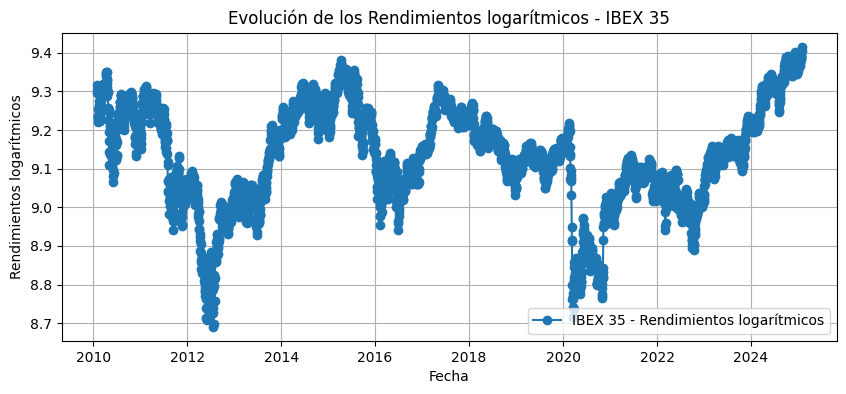

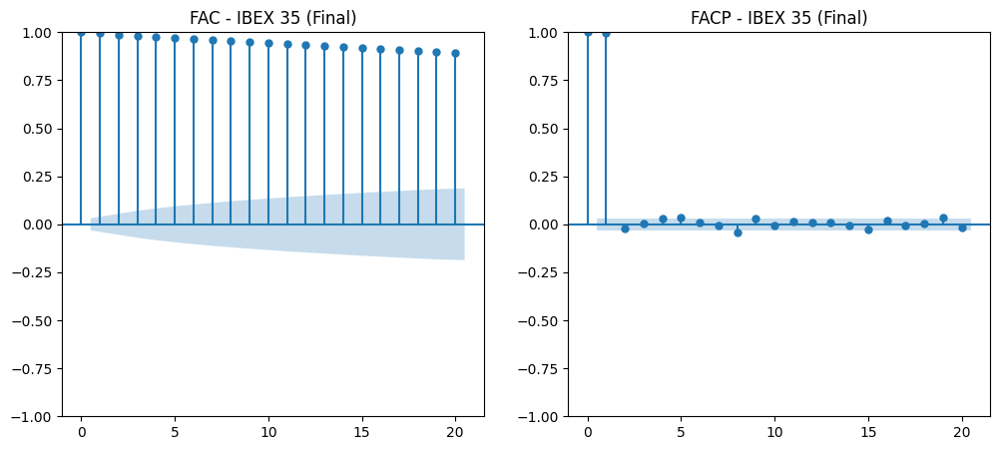

✅ IBEX 35 es ESTACIONARIA después de 0 diferenciación(es).

Analizando: Acciona 
Columnas en Acciona : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre',
       'Turnover por transacción', 'Net Gap ', '%Chg Gap'],
      dtype='object')


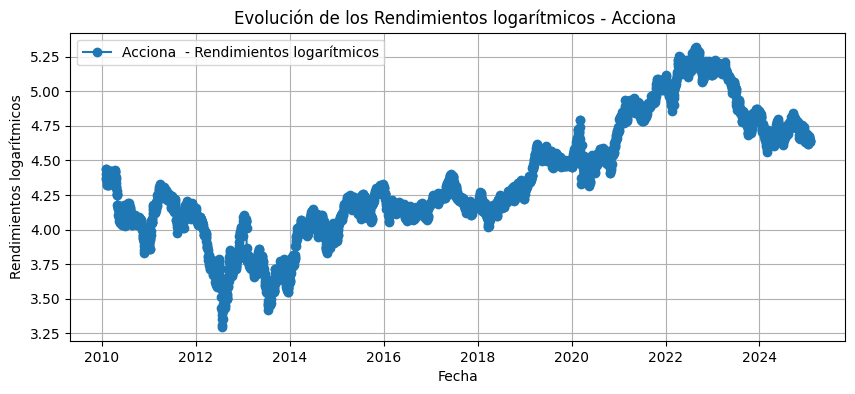

ADF después de 1 diferenciación(es) para Acciona :
   - Valor de ADF: -24.30841953958787
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432058534773547, '5%': -2.8622949368701343, '10%': -2.5671718625118447}


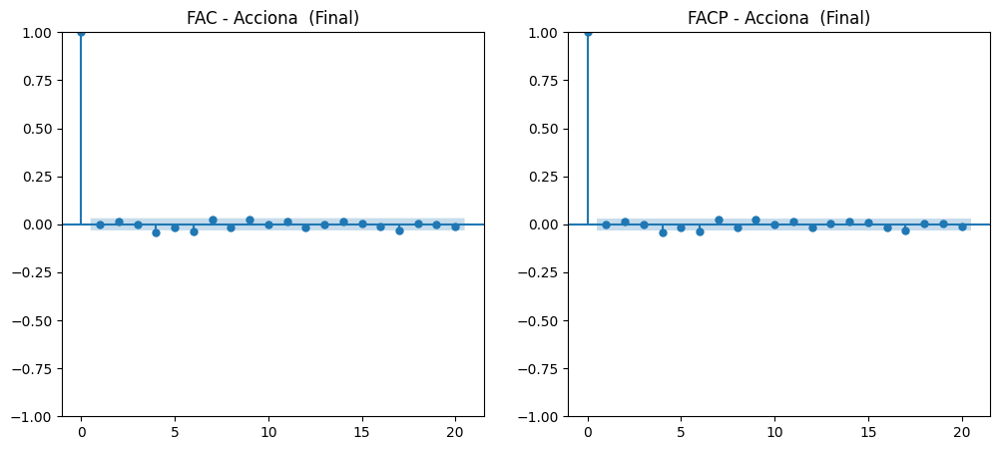

✅ Acciona  es ESTACIONARIA después de 1 diferenciación(es).

Analizando: Acerinox 
Columnas en Acerinox : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre',
       'Turnover por transacción', 'Net Gap ', '%Chg Gap'],
      dtype='object')


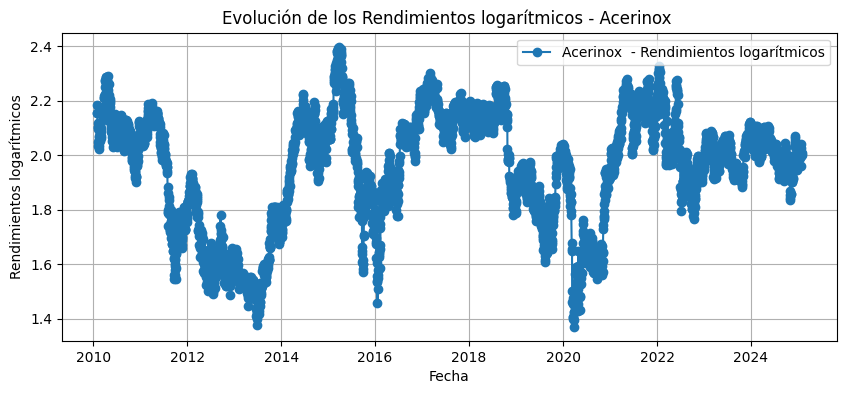

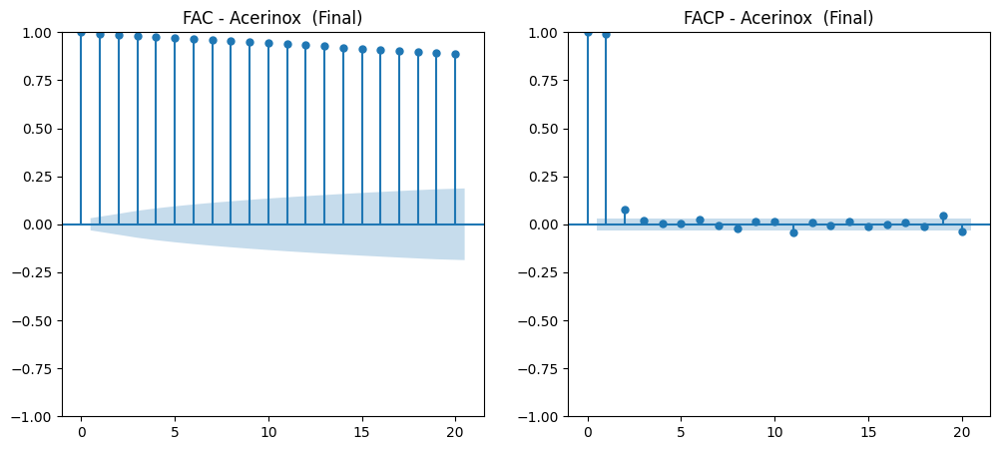

✅ Acerinox  es ESTACIONARIA después de 0 diferenciación(es).

Analizando: ACS 
Columnas en ACS : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


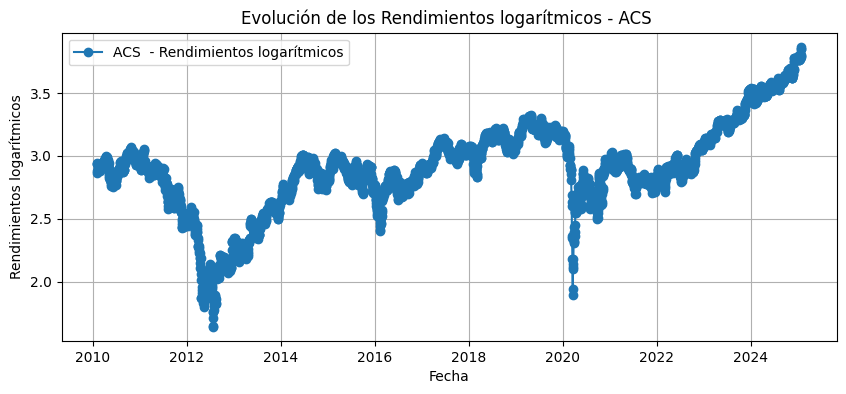

ADF después de 1 diferenciación(es) para ACS :
   - Valor de ADF: -12.959845283363324
   - p-valor: 3.2425985361493557e-24
   - Valores críticos: {'1%': -3.4320679607261453, '5%': -2.86229910063996, '10%': -2.5671740791451567}


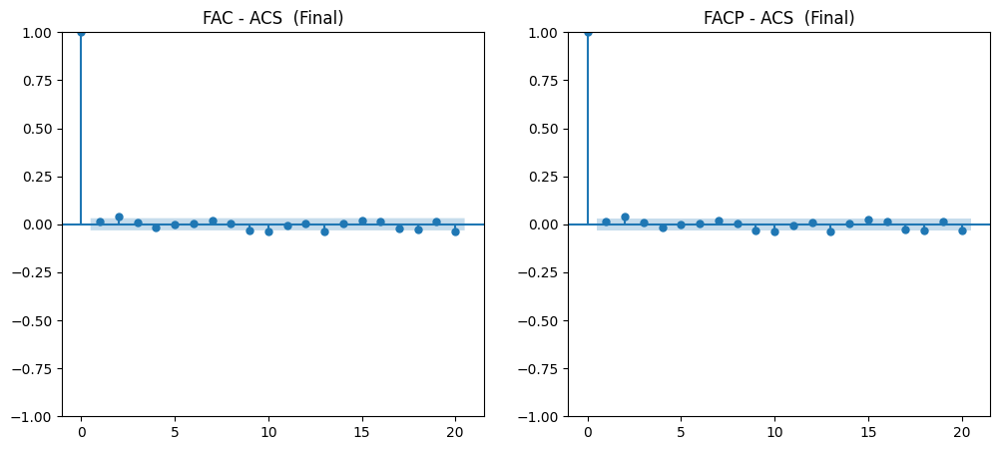

✅ ACS  es ESTACIONARIA después de 1 diferenciación(es).

Analizando: ArcelorMittal SA
Columnas en ArcelorMittal SA: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


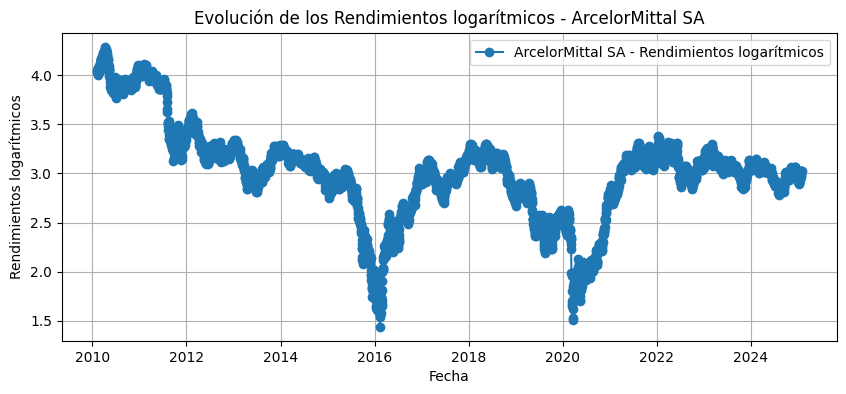

ADF después de 1 diferenciación(es) para ArcelorMittal SA:
   - Valor de ADF: -13.670486694457672
   - p-valor: 1.4629033238581442e-25
   - Valores críticos: {'1%': -3.432064357649079, '5%': -2.8622975090375453, '10%': -2.567173231836065}


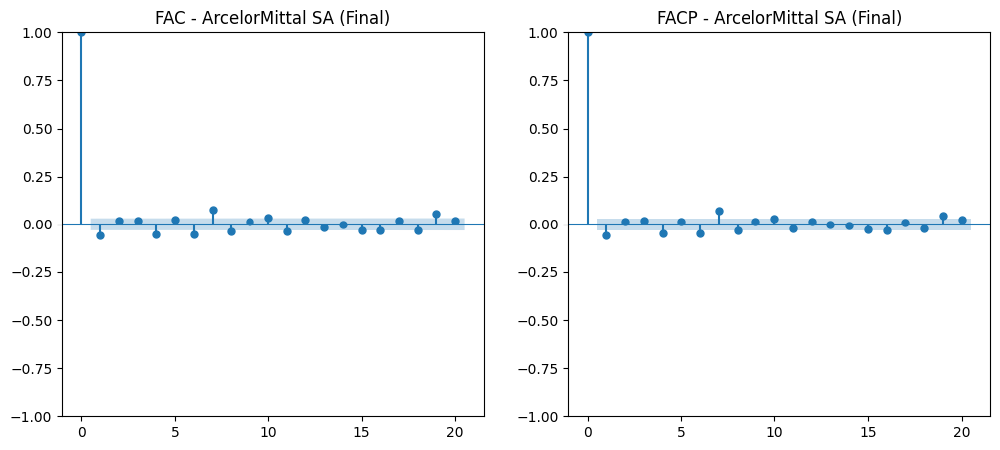

✅ ArcelorMittal SA es ESTACIONARIA después de 1 diferenciación(es).

Analizando: Banco Sabadell
Columnas en Banco Sabadell: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


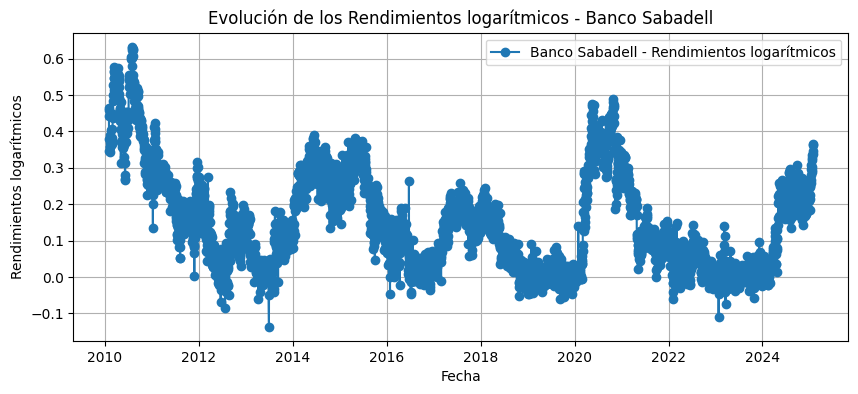

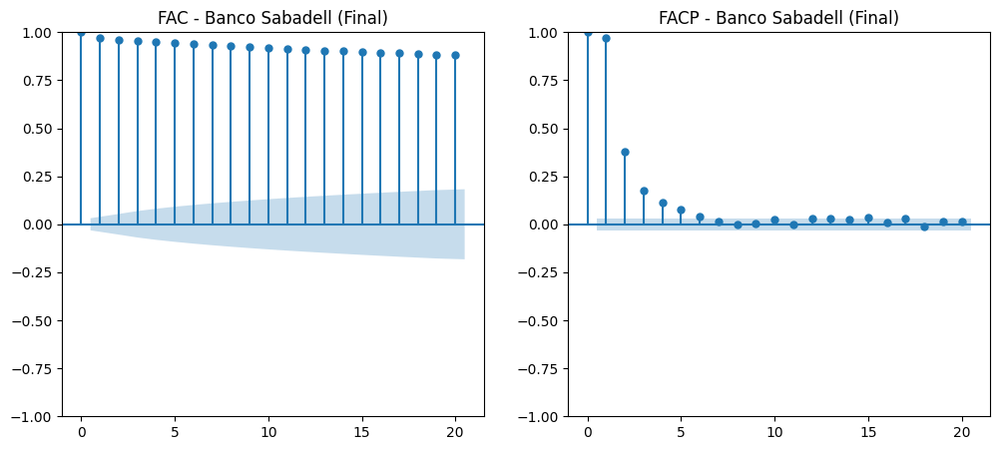

✅ Banco Sabadell es ESTACIONARIA después de 0 diferenciación(es).

Analizando: Banco Santander
Columnas en Banco Santander: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


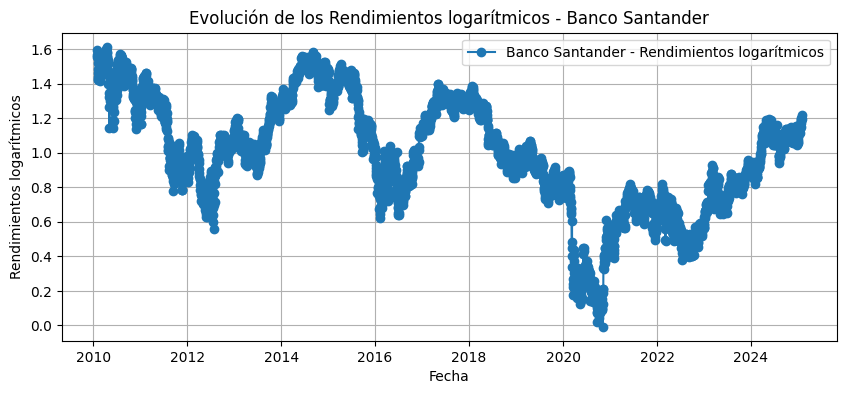

ADF después de 1 diferenciación(es) para Banco Santander:
   - Valor de ADF: -35.81809995713203
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320571966459488, '5%': -2.862294345771747, '10%': -2.567171547833638}


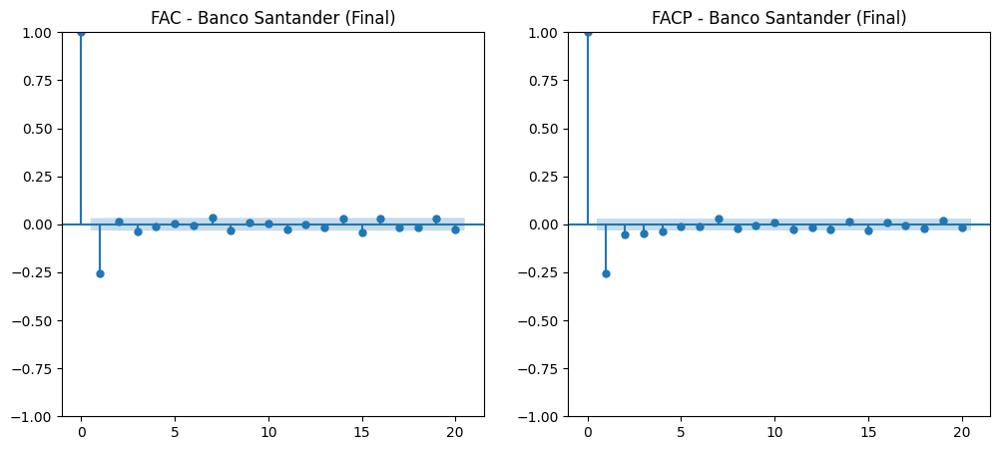

✅ Banco Santander es ESTACIONARIA después de 1 diferenciación(es).

Analizando: Bankinter
Columnas en Bankinter: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Unnamed: 10', 'Unnamed: 11',
       'Unnamed: 12', 'Unnamed: 13', 'Unnamed: 14'],
      dtype='object')
Bankinter: No tiene las columnas necesarias ('Exchange Date' y 'Rendimientos logarítmicos '). Se omite.

Analizando: BBVA 
Columnas en BBVA : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


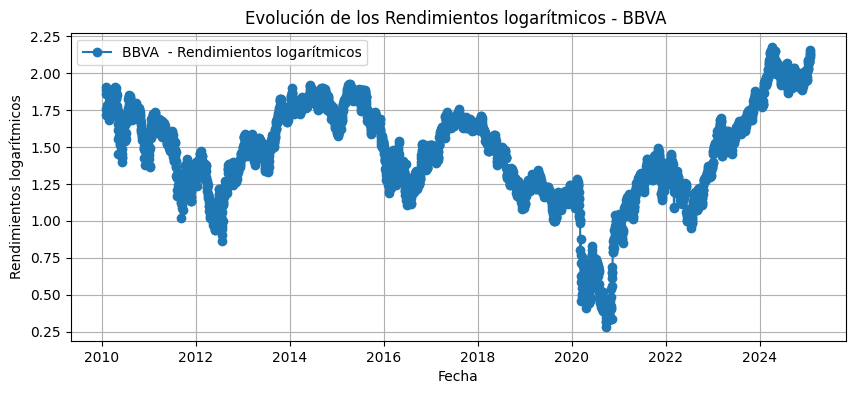

ADF después de 1 diferenciación(es) para BBVA :
   - Valor de ADF: -24.373458343525993
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432058534773547, '5%': -2.8622949368701343, '10%': -2.5671718625118447}


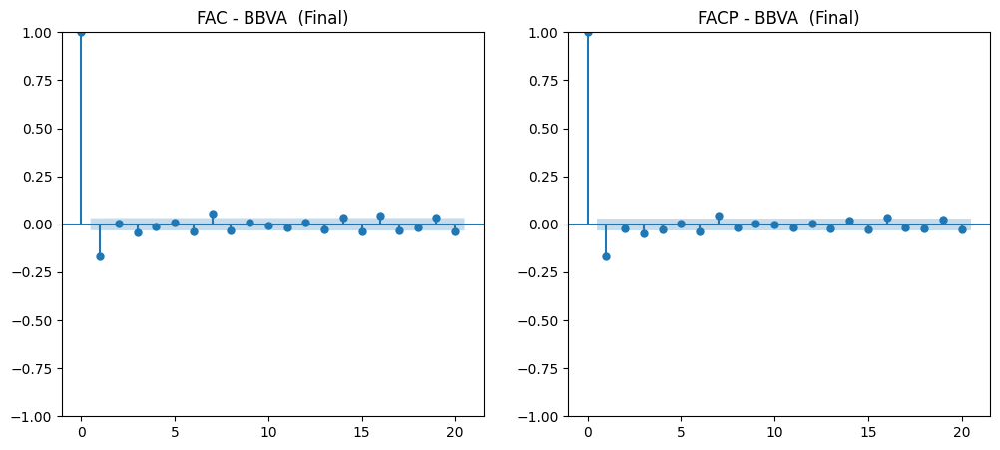

✅ BBVA  es ESTACIONARIA después de 1 diferenciación(es).

Analizando: Caixabank 
Columnas en Caixabank : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


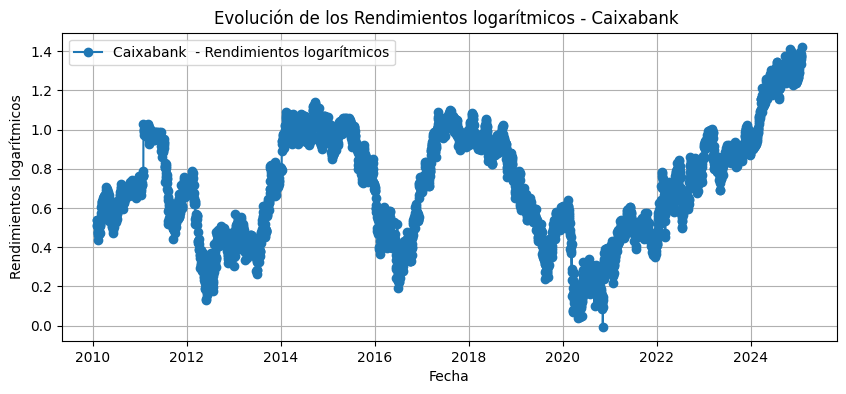

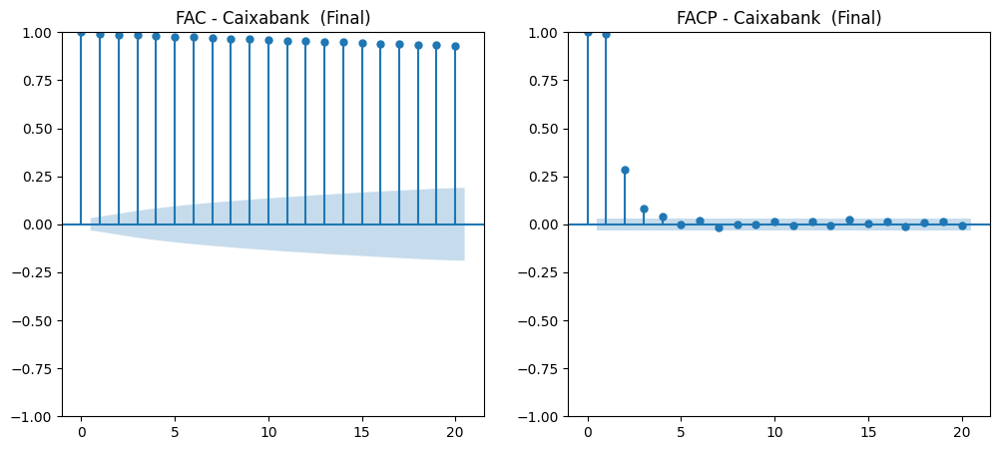

✅ Caixabank  es ESTACIONARIA después de 0 diferenciación(es).

Analizando:  Colonial
Columnas en  Colonial: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


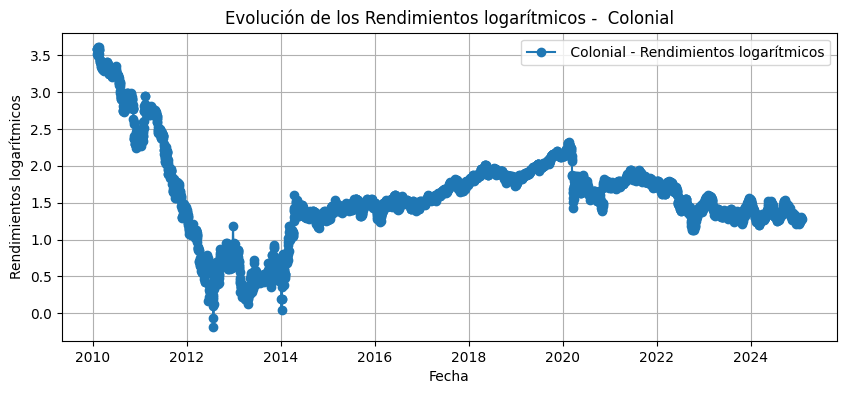

ADF después de 1 diferenciación(es) para  Colonial:
   - Valor de ADF: -31.843479331081372
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320576424555265, '5%': -2.862294542701668, '10%': -2.5671716526716017}


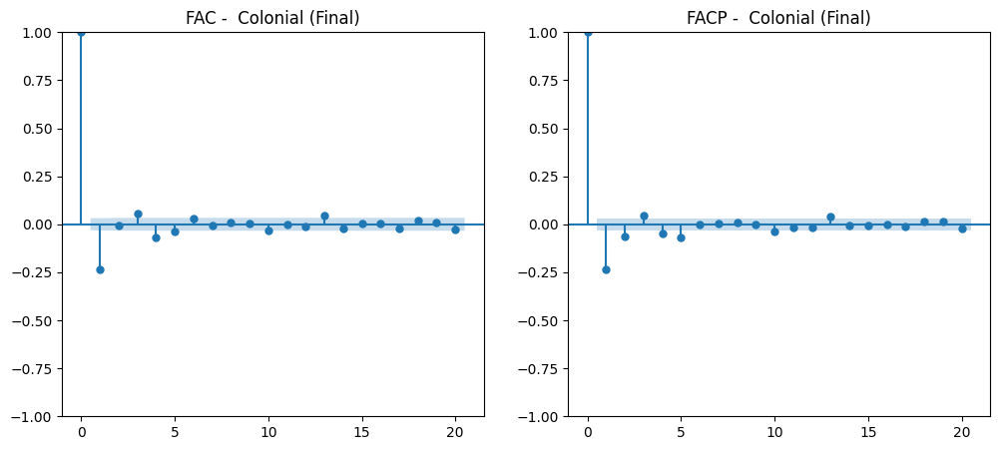

✅  Colonial es ESTACIONARIA después de 1 diferenciación(es).

Analizando: Enagas
Columnas en Enagas: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


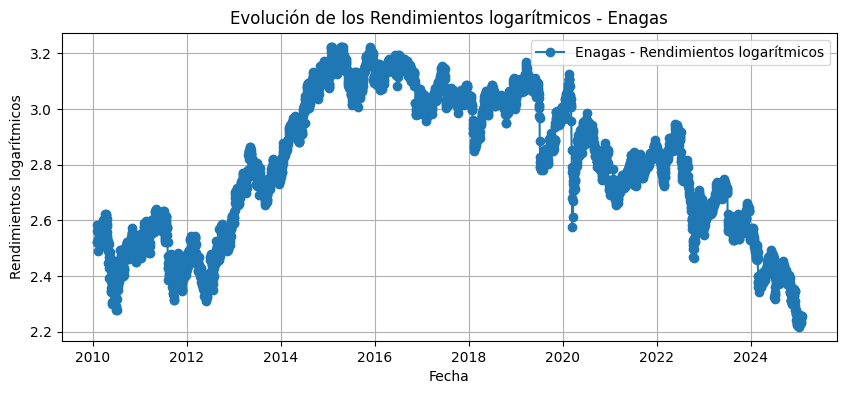

ADF después de 1 diferenciación(es) para Enagas:
   - Valor de ADF: -65.72521250979959
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432055860612759, '5%': -2.86229375559827, '10%': -2.5671712336478625}


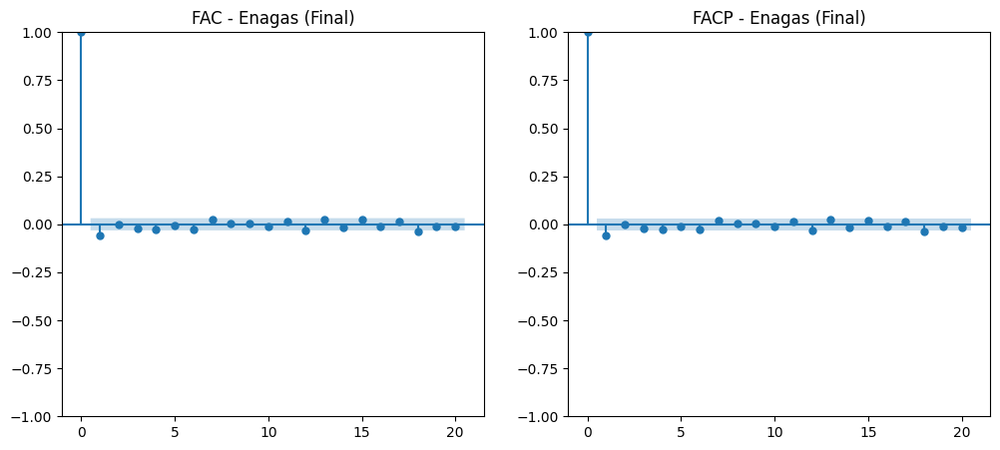

✅ Enagas es ESTACIONARIA después de 1 diferenciación(es).

Analizando: Endesa 
Columnas en Endesa : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


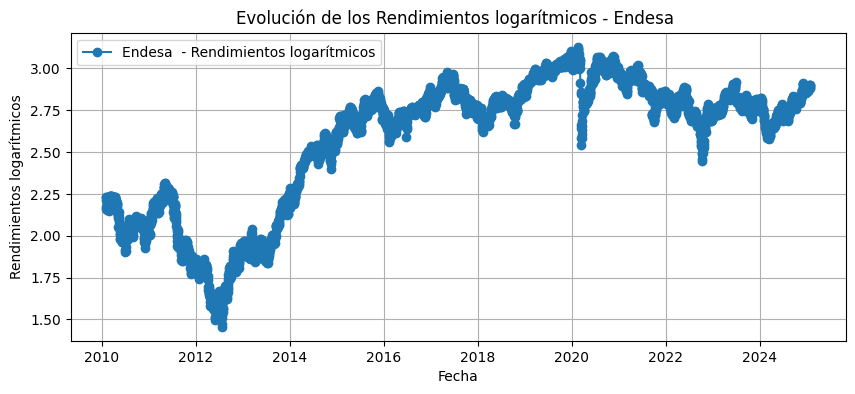

ADF después de 1 diferenciación(es) para Endesa :
   - Valor de ADF: -19.639506962932277
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320607696538454, '5%': -2.8622959240953807, '10%': -2.5671723880729633}


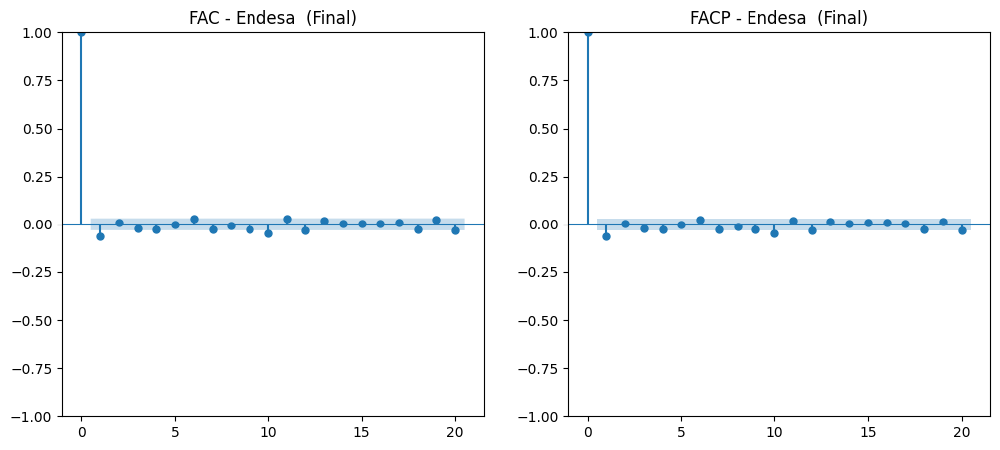

✅ Endesa  es ESTACIONARIA después de 1 diferenciación(es).

Analizando: Ferrovial 
Columnas en Ferrovial : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


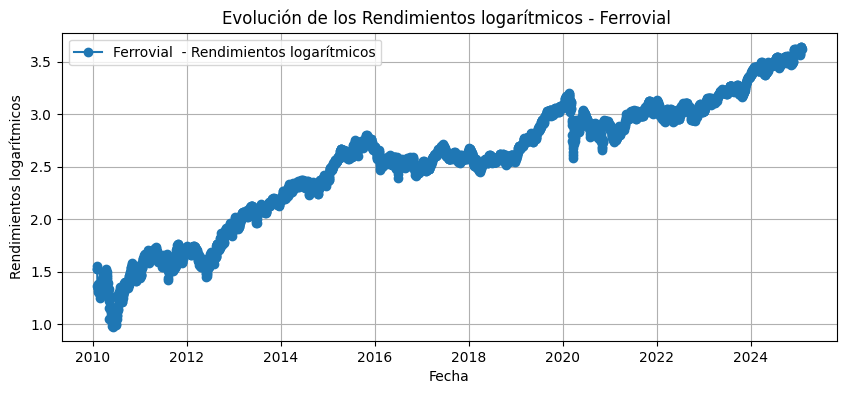

ADF después de 1 diferenciación(es) para Ferrovial :
   - Valor de ADF: -23.69977588506837
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320589812823554, '5%': -2.8622951341088414, '10%': -2.5671719675142097}


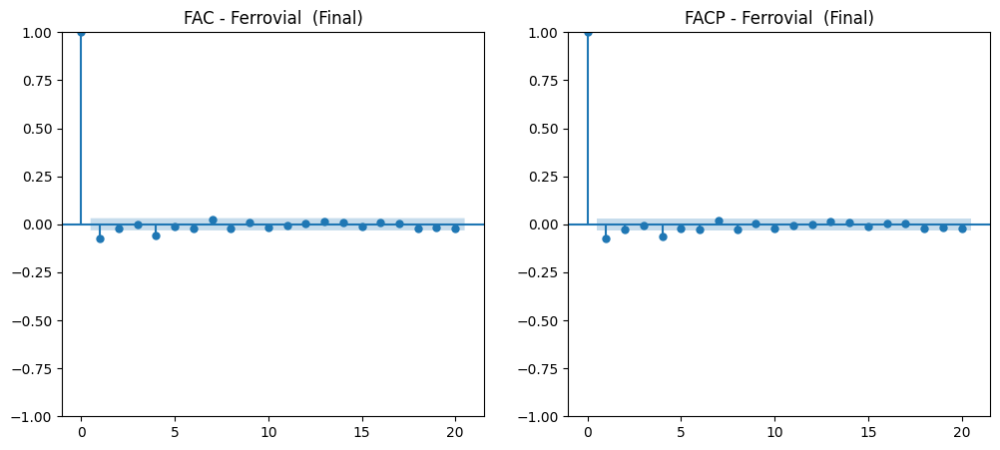

✅ Ferrovial  es ESTACIONARIA después de 1 diferenciación(es).

Analizando: Fluidra
Columnas en Fluidra: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


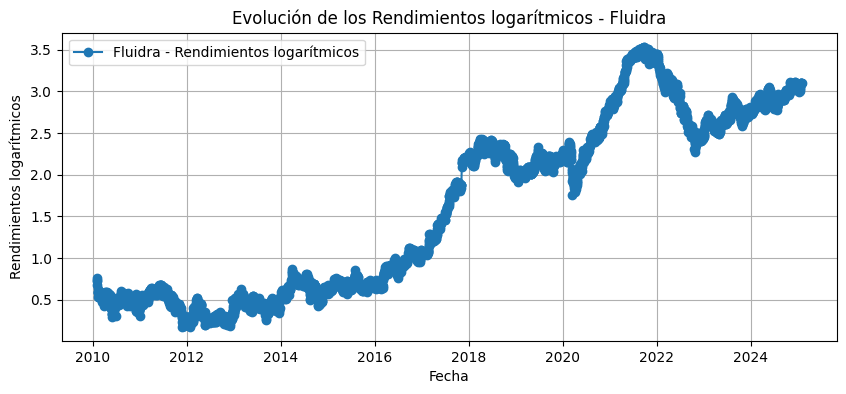

ADF después de 1 diferenciación(es) para Fluidra:
   - Valor de ADF: -40.955993594587795
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432056751069083, '5%': -2.8622941489445943, '10%': -2.567171443050389}


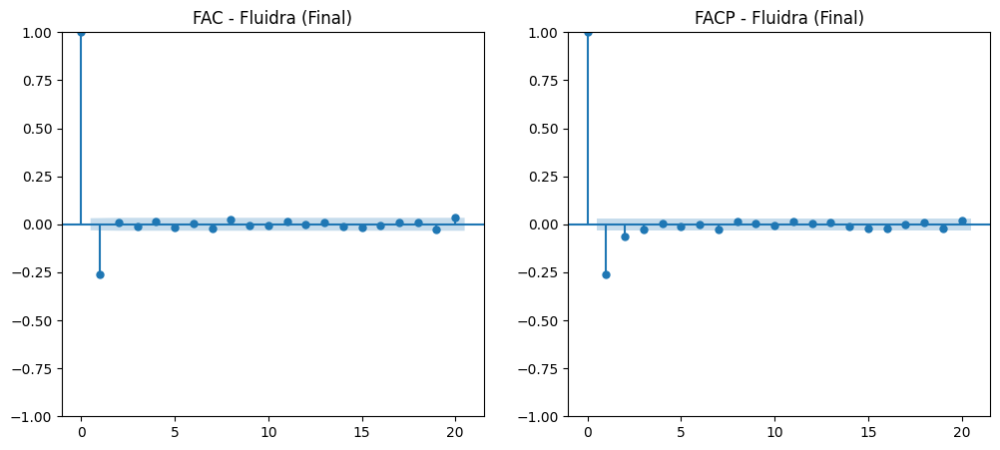

✅ Fluidra es ESTACIONARIA después de 1 diferenciación(es).

Analizando: Grifols 
Columnas en Grifols : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


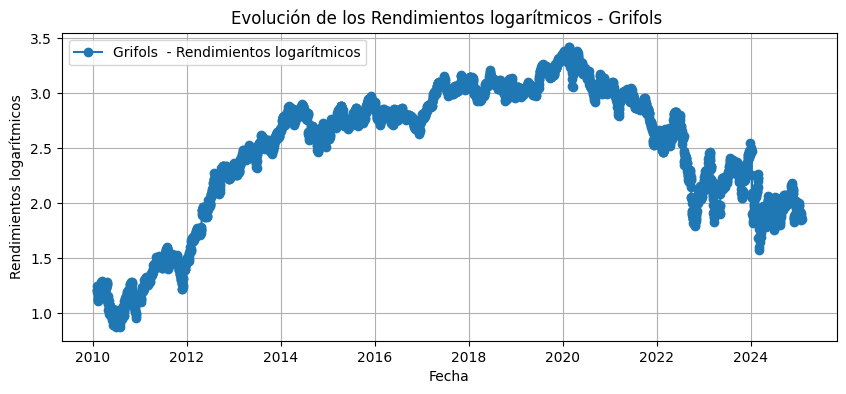

ADF después de 1 diferenciación(es) para Grifols :
   - Valor de ADF: -24.45189590009232
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432058534773547, '5%': -2.8622949368701343, '10%': -2.5671718625118447}


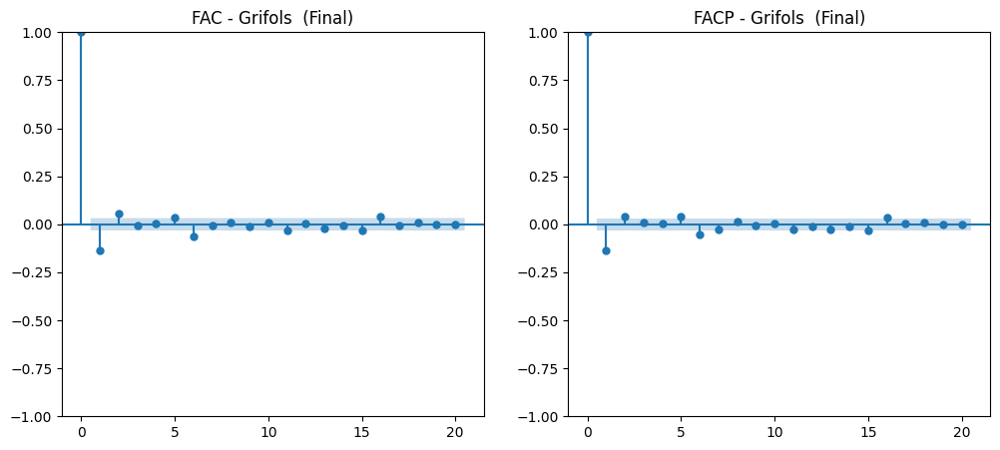

✅ Grifols  es ESTACIONARIA después de 1 diferenciación(es).

Analizando: Iberdrola 
Columnas en Iberdrola : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


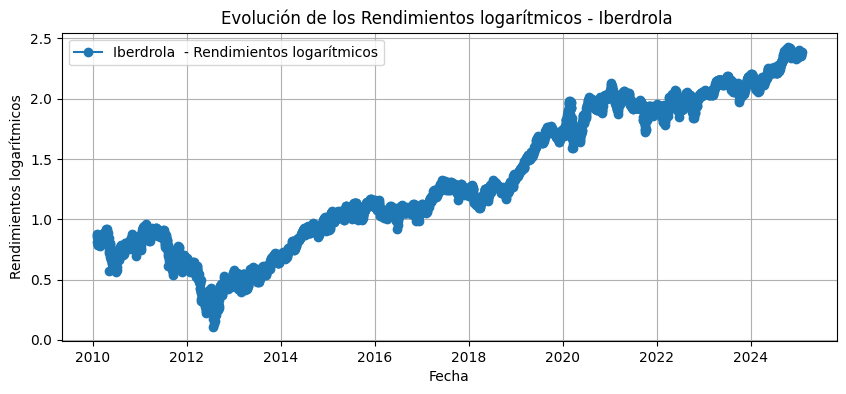

ADF después de 1 diferenciación(es) para Iberdrola :
   - Valor de ADF: -20.219340812762727
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320607696538454, '5%': -2.8622959240953807, '10%': -2.5671723880729633}


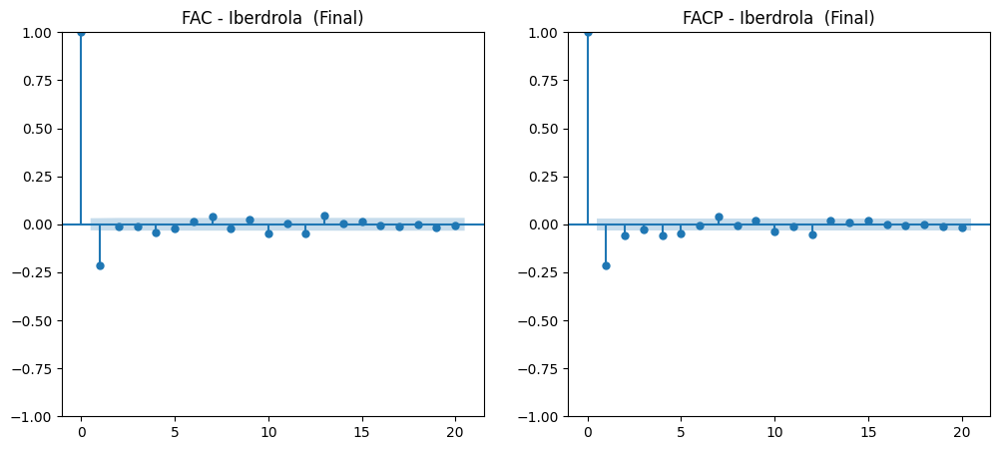

✅ Iberdrola  es ESTACIONARIA después de 1 diferenciación(es).

Analizando: Inditex
Columnas en Inditex: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


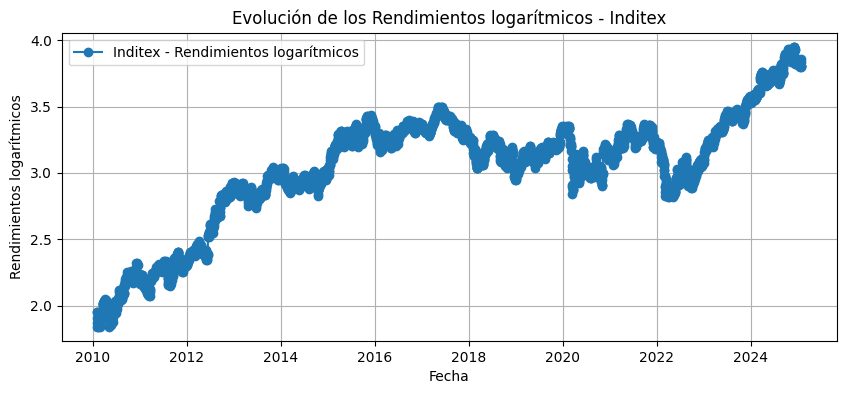

ADF después de 1 diferenciación(es) para Inditex:
   - Valor de ADF: -14.215048290869277
   - p-valor: 1.6955216621094963e-26
   - Valores críticos: {'1%': -3.4320648072069777, '5%': -2.8622977076227554, '10%': -2.5671733375553227}


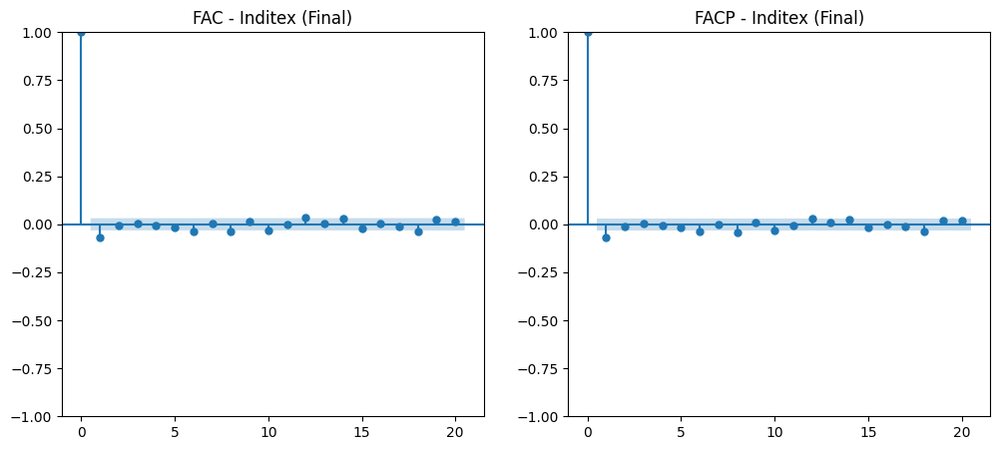

✅ Inditex es ESTACIONARIA después de 1 diferenciación(es).

Analizando: Indra 
Columnas en Indra : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


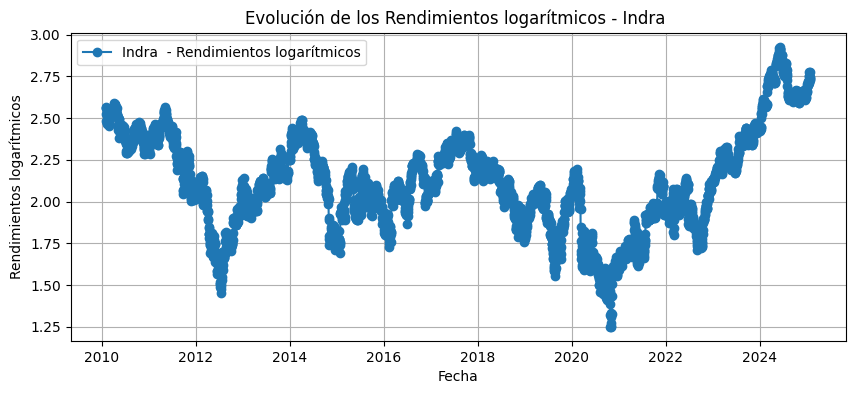

ADF después de 1 diferenciación(es) para Indra :
   - Valor de ADF: -31.208240873752867
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320576424555265, '5%': -2.862294542701668, '10%': -2.5671716526716017}


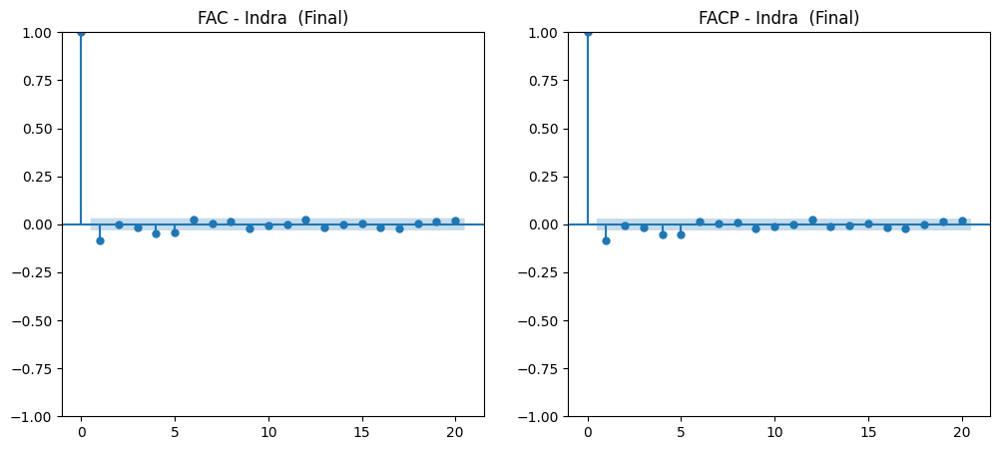

✅ Indra  es ESTACIONARIA después de 1 diferenciación(es).

Analizando: Mapfre
Columnas en Mapfre: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


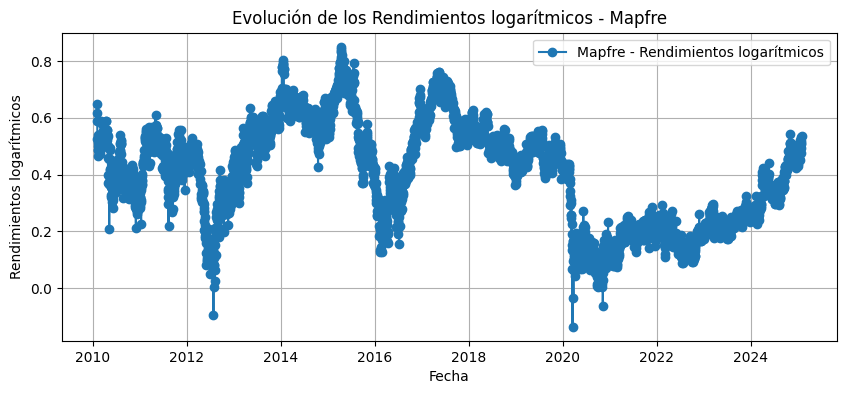

ADF después de 1 diferenciación(es) para Mapfre:
   - Valor de ADF: -26.516924543067553
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432058534773547, '5%': -2.8622949368701343, '10%': -2.5671718625118447}


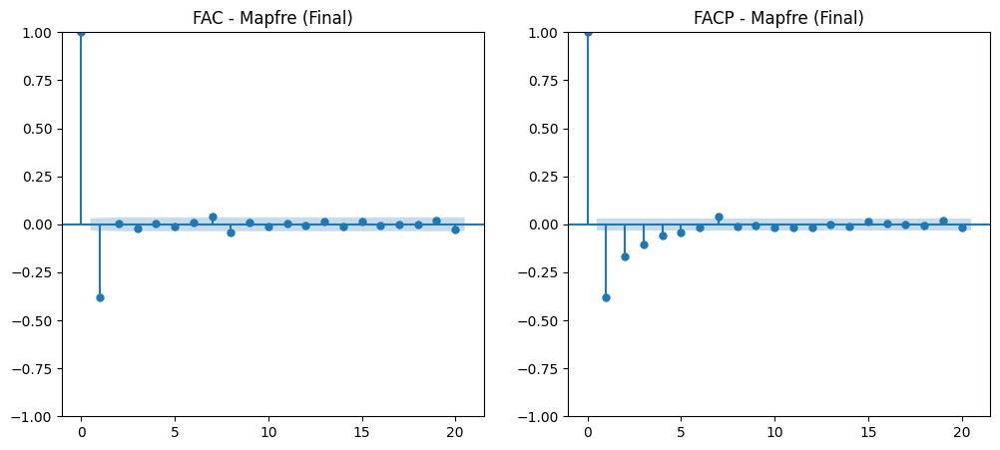

✅ Mapfre es ESTACIONARIA después de 1 diferenciación(es).

Analizando: Naturgy 
Columnas en Naturgy : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


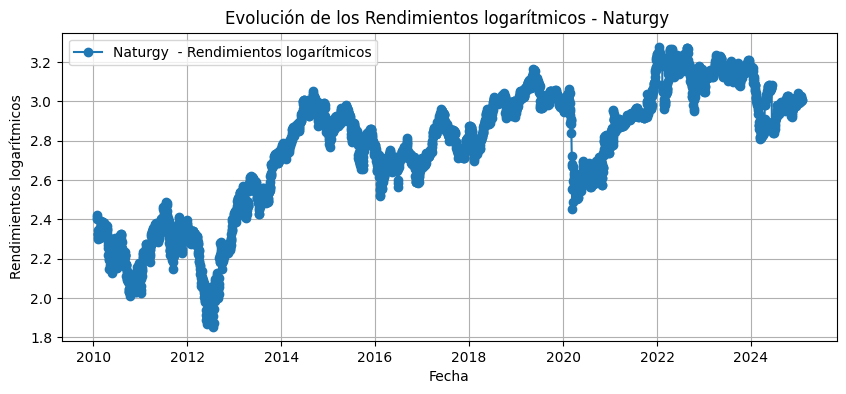

ADF después de 1 diferenciación(es) para Naturgy :
   - Valor de ADF: -33.55759890988883
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320571966459488, '5%': -2.862294345771747, '10%': -2.567171547833638}


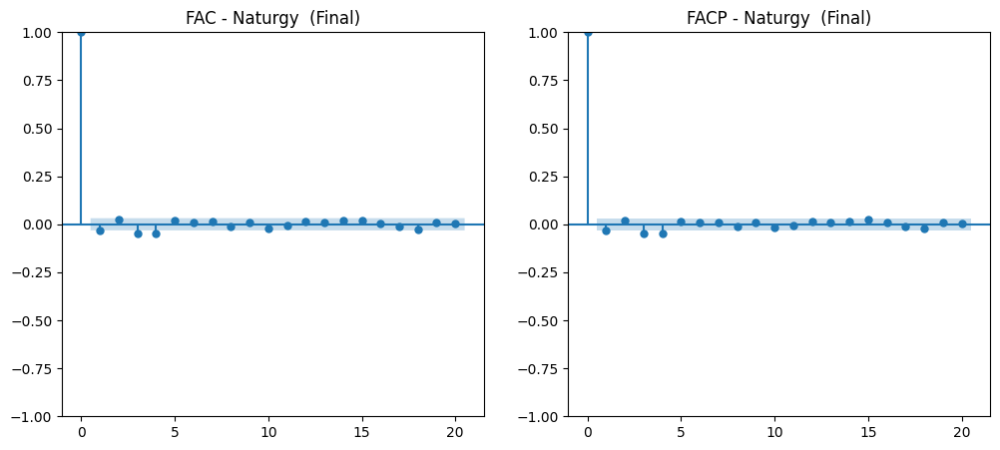

✅ Naturgy  es ESTACIONARIA después de 1 diferenciación(es).

Analizando: Redeia
Columnas en Redeia: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


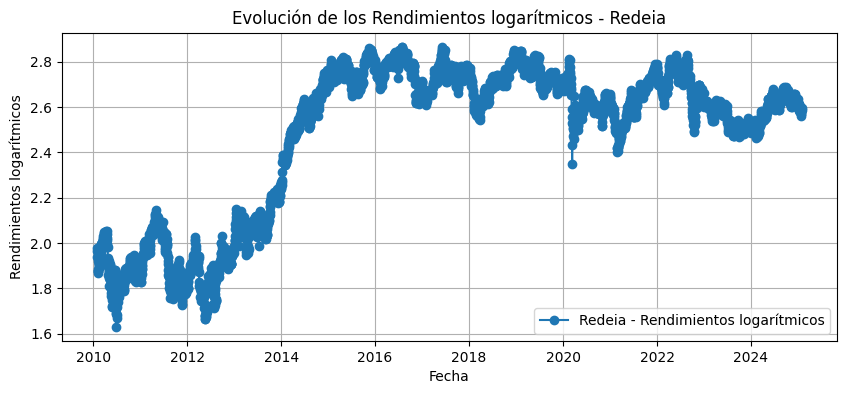

ADF después de 1 diferenciación(es) para Redeia:
   - Valor de ADF: -18.023660024634435
   - p-valor: 2.6902095280402643e-30
   - Valores críticos: {'1%': -3.4320612173316993, '5%': -2.8622961218503478, '10%': -2.5671724933501907}


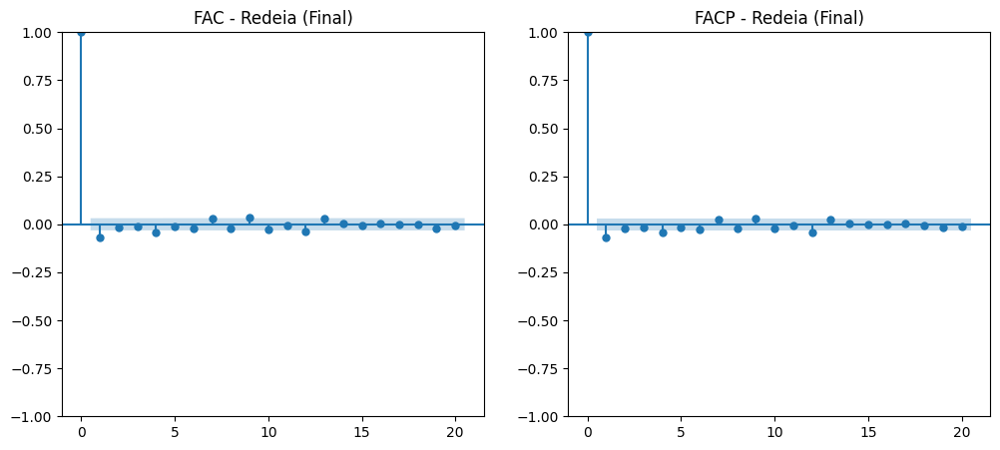

✅ Redeia es ESTACIONARIA después de 1 diferenciación(es).

Analizando: Rovi
Columnas en Rovi: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


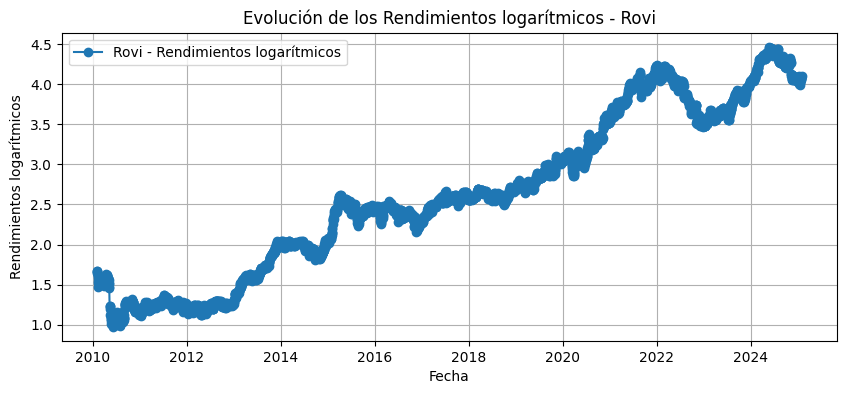

ADF después de 1 diferenciación(es) para Rovi:
   - Valor de ADF: -30.894754649169577
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320639083268323, '5%': -2.8622973105564014, '10%': -2.5671731261722135}


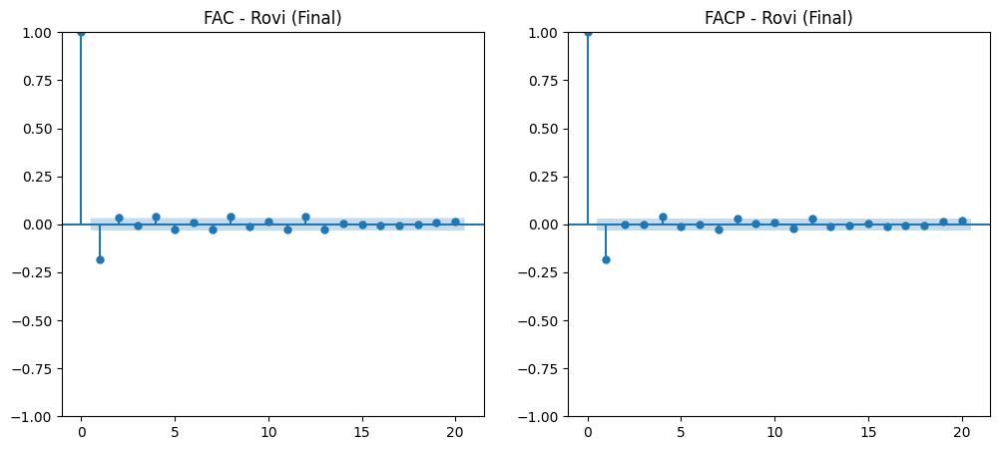

✅ Rovi es ESTACIONARIA después de 1 diferenciación(es).

Analizando: Sacyr
Columnas en Sacyr: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


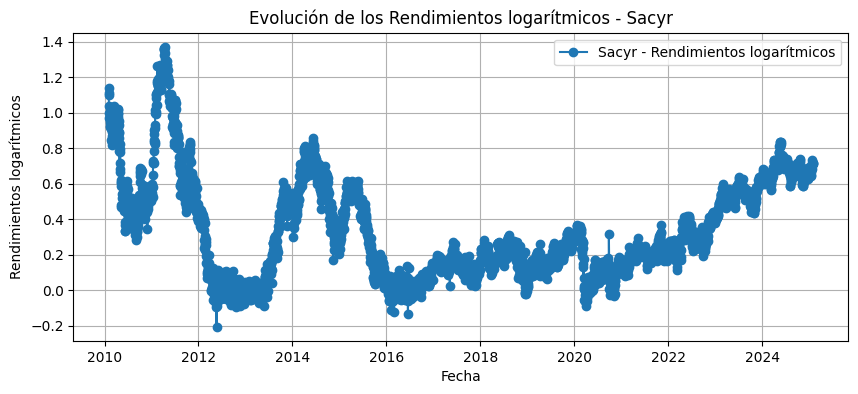

ADF después de 1 diferenciación(es) para Sacyr:
   - Valor de ADF: -30.788161192624575
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320580884979983, '5%': -2.8622947397344367, '10%': -2.567171757564323}


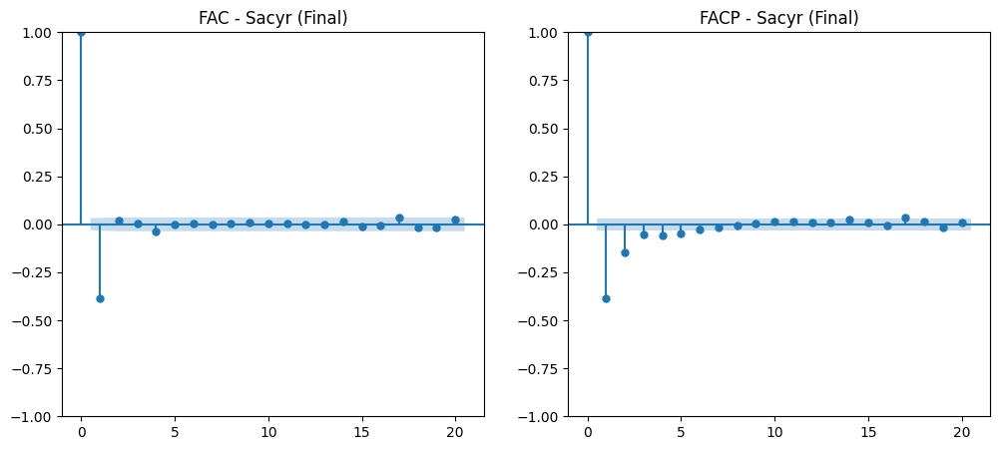

✅ Sacyr es ESTACIONARIA después de 1 diferenciación(es).

Analizando: Solaria 
Columnas en Solaria : Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


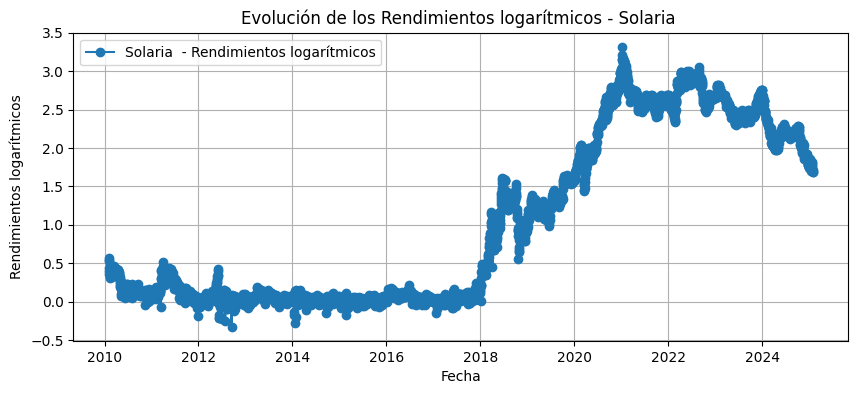

ADF después de 1 diferenciación(es) para Solaria :
   - Valor de ADF: -45.41992530477387
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432056751069083, '5%': -2.8622941489445943, '10%': -2.567171443050389}


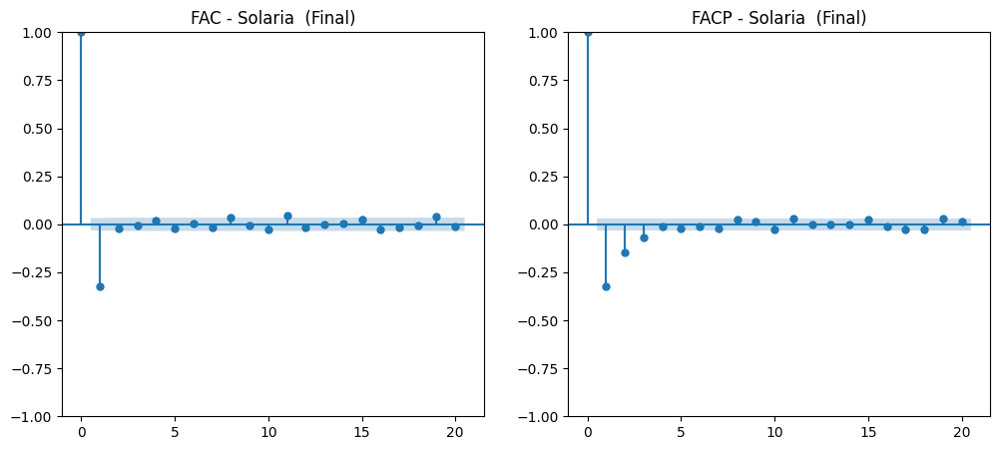

✅ Solaria  es ESTACIONARIA después de 1 diferenciación(es).

Analizando: Telefonica
Columnas en Telefonica: Index(['Exchange Date', 'Close', 'Net', '%Chg', 'Open', 'Low', 'High',
       'Volume', 'Turnover - EUR', 'Flow', 'Rendimientos logarítmicos ',
       'Rango intraperiodo', 'Ratio apertura-cierre', 'Net Gap ', '%Chg Gap'],
      dtype='object')


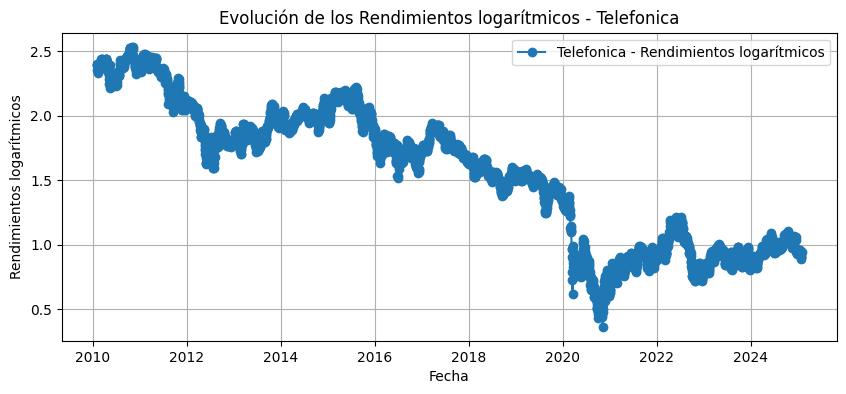

ADF después de 1 diferenciación(es) para Telefonica:
   - Valor de ADF: -15.998386308266266
   - p-valor: 6.552894422828211e-29
   - Valores críticos: {'1%': -3.4320634592400534, '5%': -2.8622971121792413, '10%': -2.567173020563724}


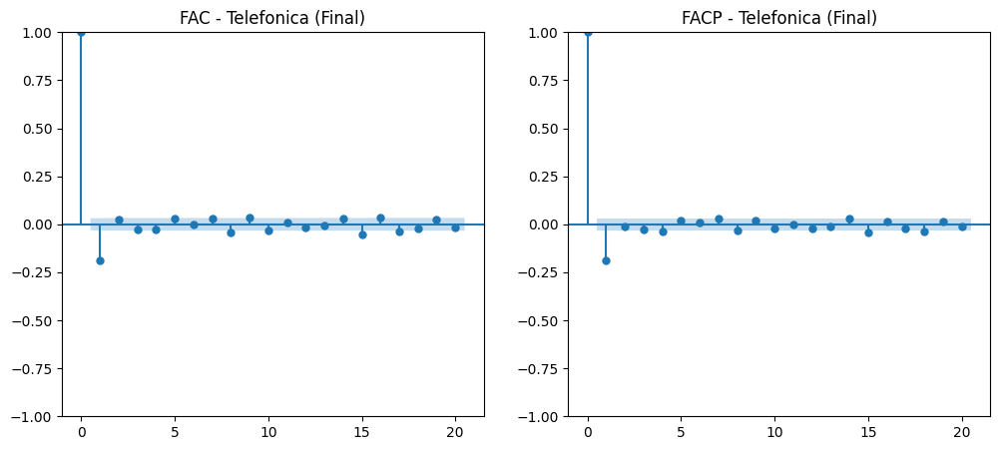

✅ Telefonica es ESTACIONARIA después de 1 diferenciación(es).
Archivo 'resultados_adf.csv' generado con los resultados.

 Resumen de la prueba de Dickey-Fuller para todas las hojas:
                 ADF Statistic   p-valor  \
IBEX 35              -3.243203  0.017616   
Acciona              -24.30842       0.0   
Acerinox             -3.319588  0.014025   
ACS                 -12.959845       0.0   
ArcelorMittal SA    -13.670487       0.0   
Banco Sabadell       -3.033391  0.031892   
Banco Santander       -35.8181       0.0   
BBVA                -24.373458       0.0   
Caixabank            -2.902009  0.045115   
 Colonial           -31.843479       0.0   
Enagas              -65.725213       0.0   
Endesa              -19.639507       0.0   
Ferrovial           -23.699776       0.0   
Fluidra             -40.955994       0.0   
Grifols             -24.451896       0.0   
Iberdrola           -20.219341       0.0   
Inditex             -14.215048       0.0   
Indra               -31.20

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from google.colab import files

uploaded = files.upload()
file_name = list(uploaded.keys())[0]
xls = pd.ExcelFile(file_name)
hojas = xls.sheet_names
print("Hojas disponibles en el archivo:", hojas)

resultados_adf = {}

for hoja in hojas:
    print(f"\nAnalizando: {hoja}")
    df = pd.read_excel(xls, sheet_name=hoja)

    print(f"Columnas en {hoja}: {df.columns}")

    if "Exchange Date" not in df.columns or "Rendimientos logarítmicos " not in df.columns:
        print(f"{hoja}: No tiene las columnas necesarias ('Exchange Date' y 'Rendimientos logarítmicos '). Se omite.")
        continue

    df["Exchange Date"] = pd.to_datetime(df["Exchange Date"])
    df.set_index("Exchange Date", inplace=True)

    serie_ts = df["Rendimientos logarítmicos "].dropna()

    plt.figure(figsize=(10, 4))
    plt.plot(serie_ts, marker="o", linestyle="-", label=f"{hoja} - Rendimientos logarítmicos")
    plt.xlabel("Fecha")
    plt.ylabel("Rendimientos logarítmicos")
    plt.title(f"Evolución de los Rendimientos logarítmicos - {hoja}")
    plt.legend()
    plt.grid()
    plt.show()

    adf_result = adfuller(serie_ts)
    p_valor = adf_result[1]

    resultados_adf[hoja] = {
        "ADF Statistic": adf_result[0],
        "p-valor": p_valor,
        "Valores críticos": adf_result[4],
        "Diferenciaciones aplicadas": 0
    }

    diferencia_aplicada = 0
    while p_valor >= 0.05 and diferencia_aplicada < 2:
        df[f"Rendimientos_diff_{diferencia_aplicada+1}"] = df["Rendimientos logarítmicos "].diff(diferencia_aplicada+1).dropna()
        serie_ts = df[f"Rendimientos_diff_{diferencia_aplicada+1}"].dropna()

        adf_result = adfuller(serie_ts)
        p_valor = adf_result[1]
        diferencia_aplicada += 1

        print(f"ADF después de {diferencia_aplicada} diferenciación(es) para {hoja}:")
        print(f"   - Valor de ADF: {adf_result[0]}")
        print(f"   - p-valor: {p_valor}")
        print(f"   - Valores críticos: {adf_result[4]}")

        resultados_adf[hoja]["ADF Statistic"] = adf_result[0]
        resultados_adf[hoja]["p-valor"] = p_valor
        resultados_adf[hoja]["Diferenciaciones aplicadas"] = diferencia_aplicada

    fig, ax = plt.subplots(1, 2, figsize=(12, 5))
    plot_acf(serie_ts.dropna(), ax=ax[0], lags=20)
    plot_pacf(serie_ts.dropna(), ax=ax[1], lags=20)
    ax[0].set_title(f"FAC - {hoja} (Final)")
    ax[1].set_title(f"FACP - {hoja} (Final)")
    plt.show()

    if p_valor < 0.05:
        print(f"✅ {hoja} es ESTACIONARIA después de {diferencia_aplicada} diferenciación(es).")
    else:
        print(f"❌ {hoja} sigue sin ser estacionaria tras {diferencia_aplicada} diferenciación(es). Se recomienda más tratamiento.")

df_resultados = pd.DataFrame(resultados_adf).T
df_resultados.to_csv("resultados_adf.csv")
print("Archivo 'resultados_adf.csv' generado con los resultados.")

 #Crear un DataFrame con los resultados finales
df_resultados = pd.DataFrame(resultados_adf).T
print("\n Resumen de la prueba de Dickey-Fuller para todas las hojas:")
print(df_resultados)




Saving BASE DE DATOS ! .xlsx to BASE DE DATOS !  (4).xlsx
📂 Hojas disponibles en el archivo: ['IBEX 35', 'Acciona ', 'Acerinox ', 'ACS ', 'ArcelorMittal SA', 'Banco Sabadell', 'Banco Santander', 'Bankinter', 'BBVA ', 'Caixabank ', ' Colonial', 'Enagas', 'Endesa ', 'Ferrovial ', 'Fluidra', 'Grifols ', 'Iberdrola ', 'Inditex', 'Indra ', 'Mapfre', 'Naturgy ', 'Redeia', 'Rovi', 'Sacyr', 'Solaria ', 'Telefonica']

📊 Analizando: IBEX 35


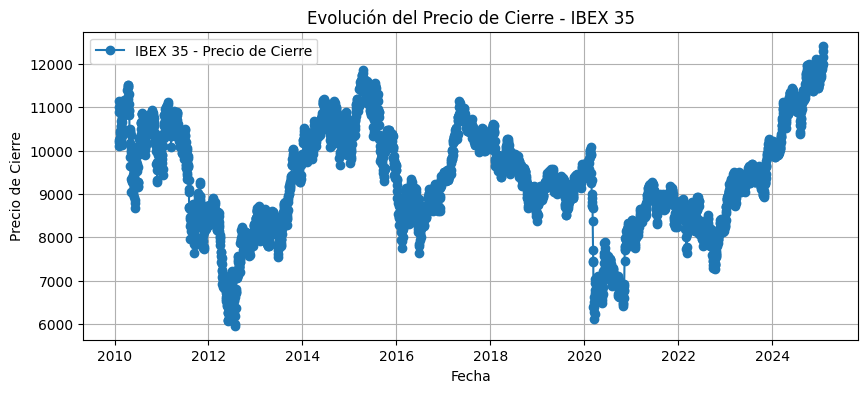

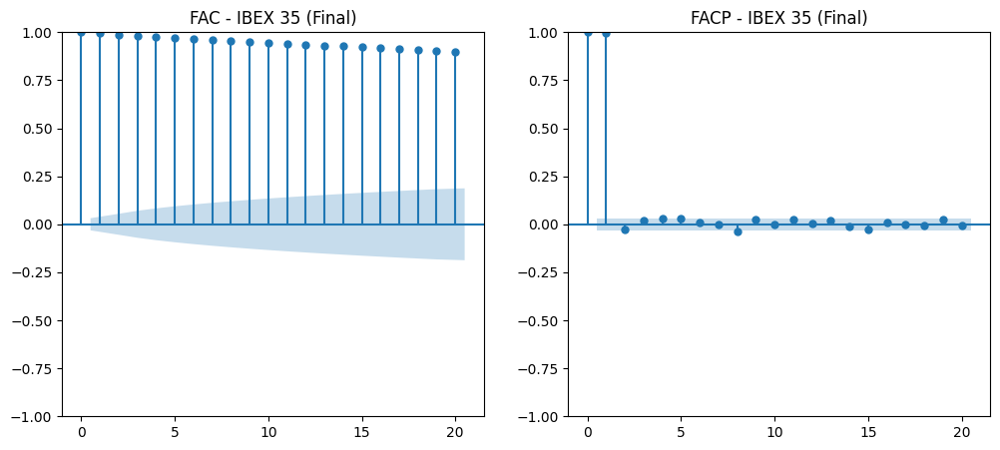

✅ IBEX 35 es ESTACIONARIA después de 0 diferenciación(es).

📊 Analizando: Acciona 


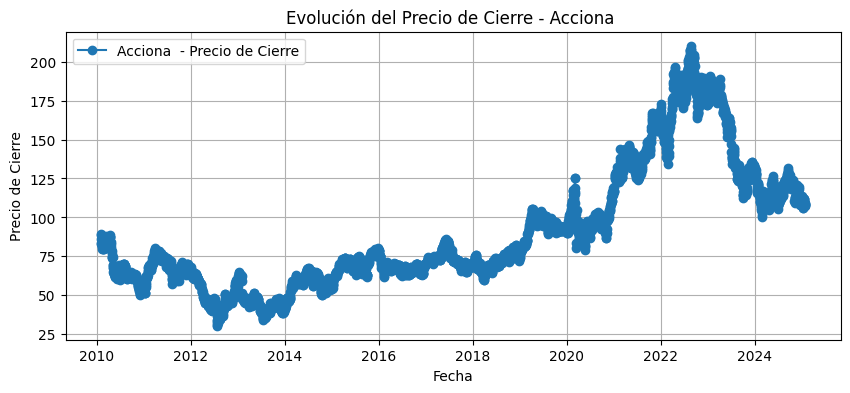

📌 ADF después de 1 diferenciación(es) para Acciona :
   - Valor de ADF: -21.31332889923573
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320589812823554, '5%': -2.8622951341088414, '10%': -2.5671719675142097}


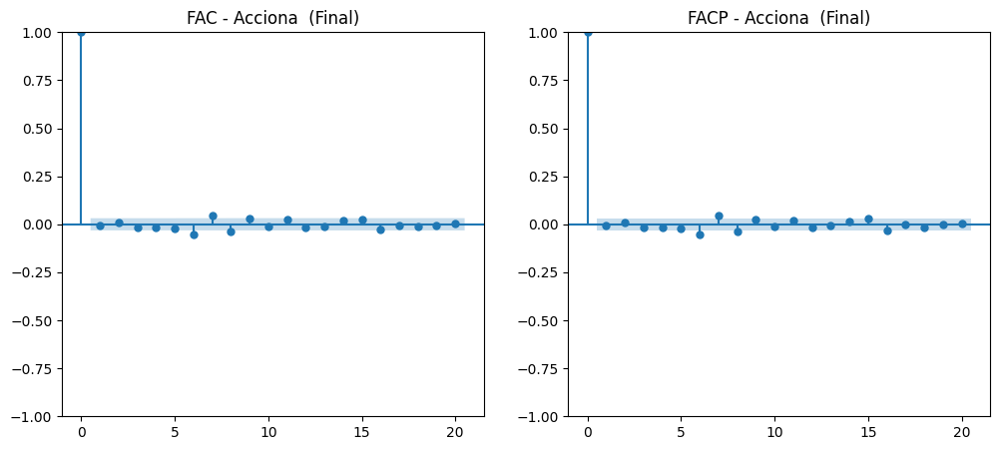

✅ Acciona  es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Acerinox 


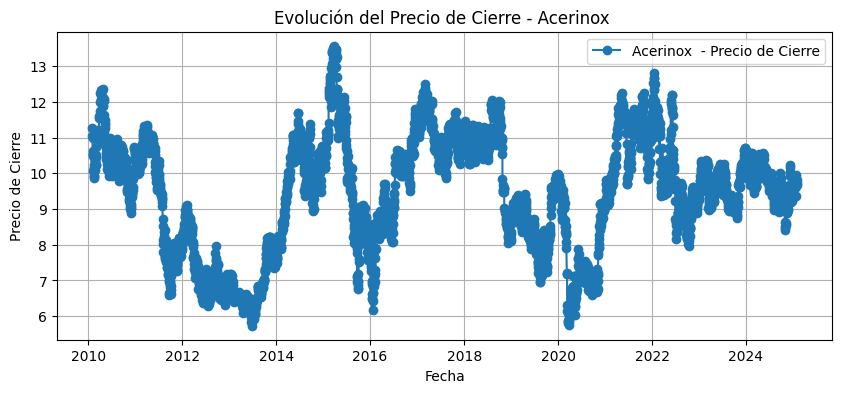

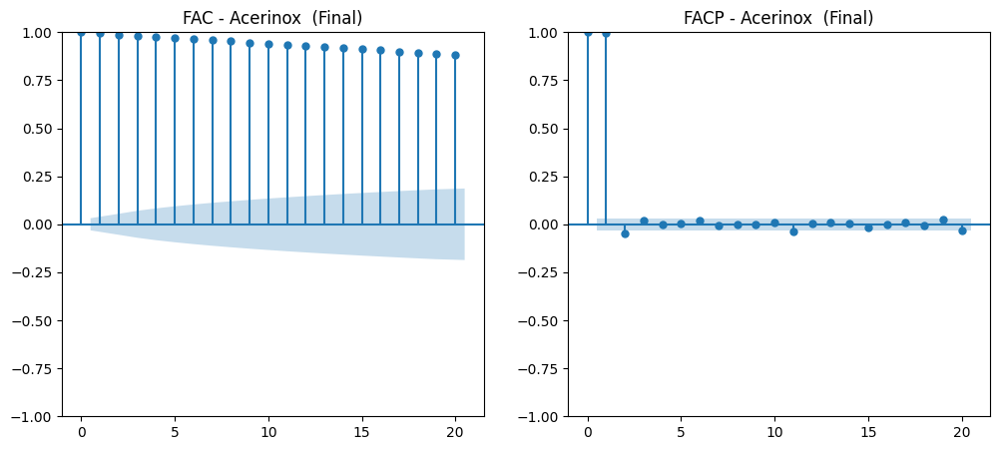

✅ Acerinox  es ESTACIONARIA después de 0 diferenciación(es).

📊 Analizando: ACS 


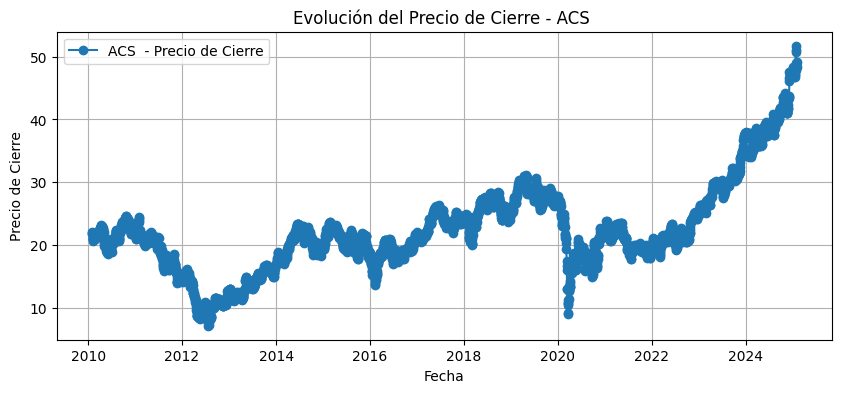

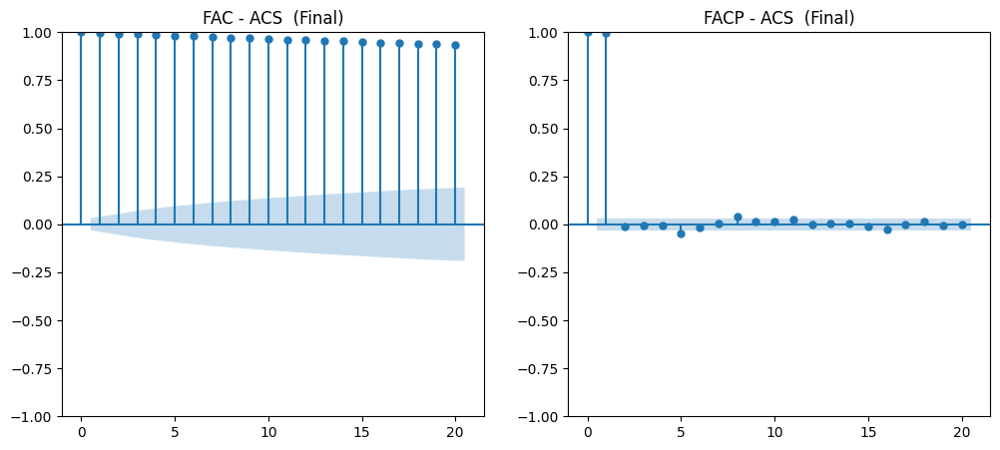

✅ ACS  es ESTACIONARIA después de 0 diferenciación(es).

📊 Analizando: ArcelorMittal SA


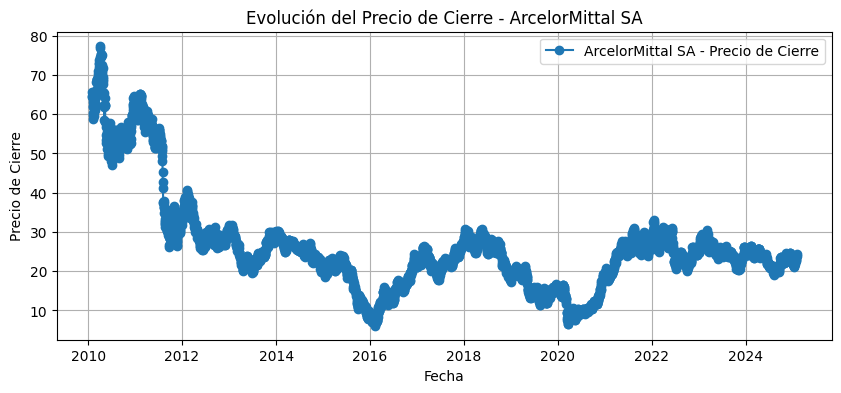

📌 ADF después de 1 diferenciación(es) para ArcelorMittal SA:
   - Valor de ADF: -17.633025358668036
   - p-valor: 3.790387628451481e-30
   - Valores críticos: {'1%': -3.4320580884979983, '5%': -2.8622947397344367, '10%': -2.567171757564323}


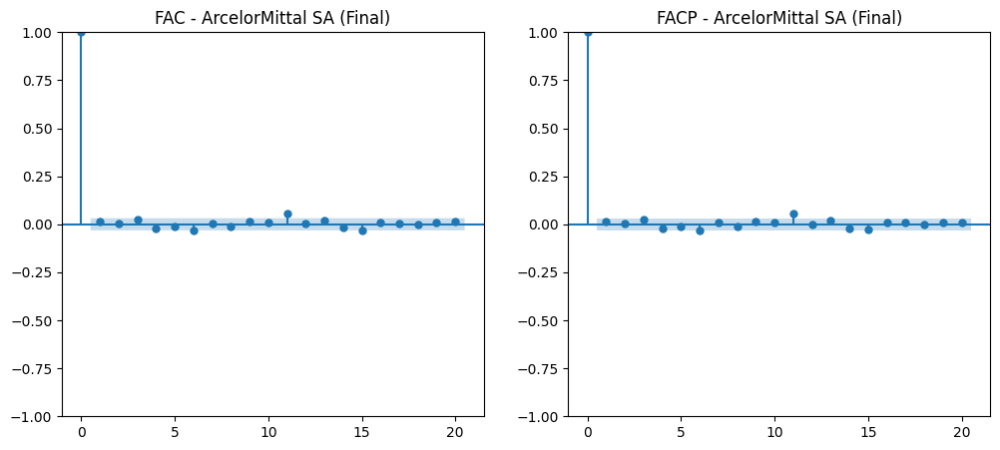

✅ ArcelorMittal SA es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Banco Sabadell


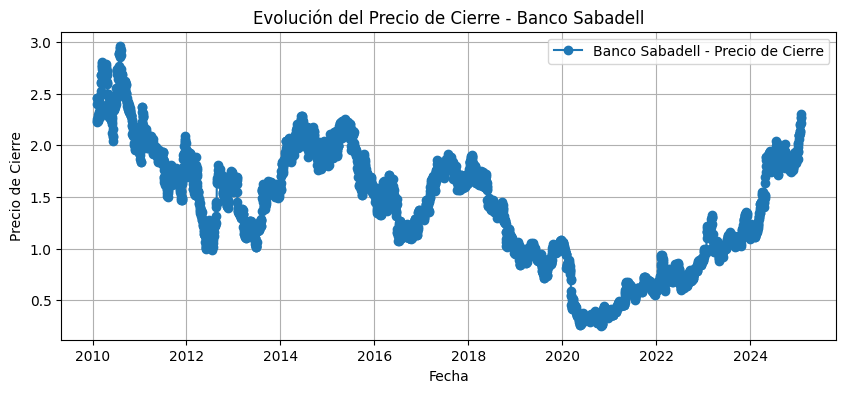

📌 ADF después de 1 diferenciación(es) para Banco Sabadell:
   - Valor de ADF: -12.639758069977608
   - p-valor: 1.443538282842841e-23
   - Valores críticos: {'1%': -3.4320666077988116, '5%': -2.862298503005894, '10%': -2.567173760987284}


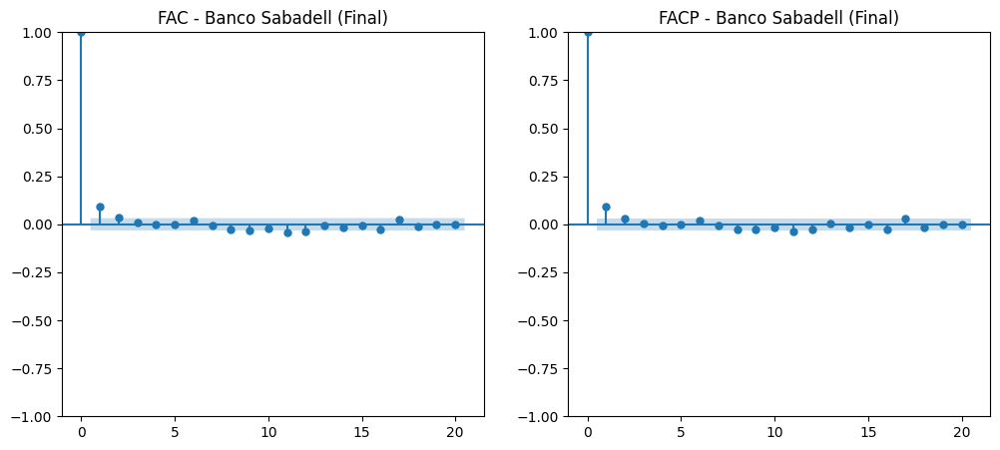

✅ Banco Sabadell es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Banco Santander


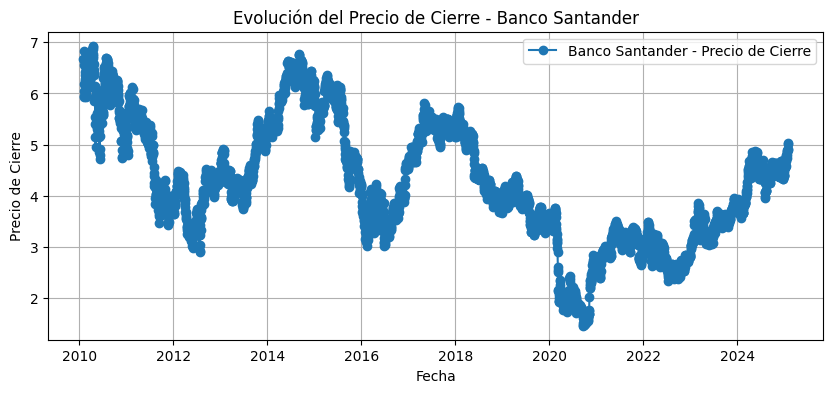

📌 ADF después de 1 diferenciación(es) para Banco Santander:
   - Valor de ADF: -20.423844382365417
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320598750004825, '5%': -2.862295528895607, '10%': -2.567172177683642}


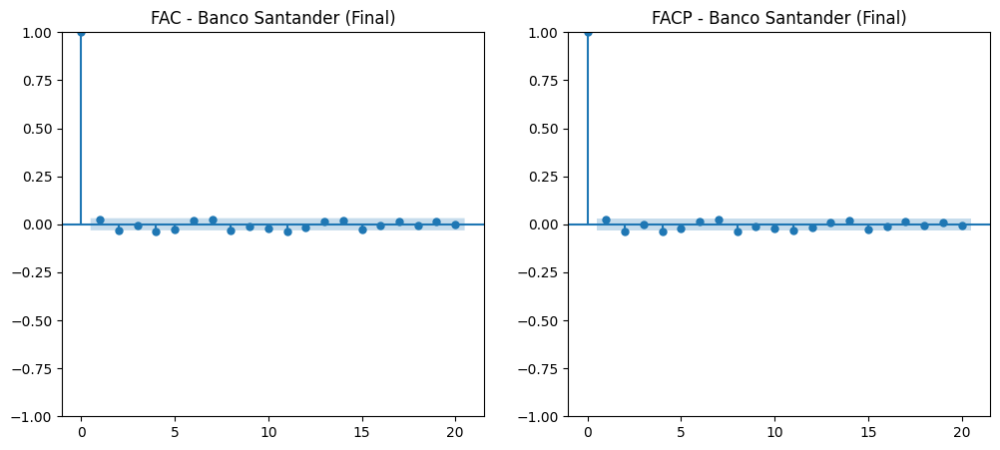

✅ Banco Santander es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Bankinter


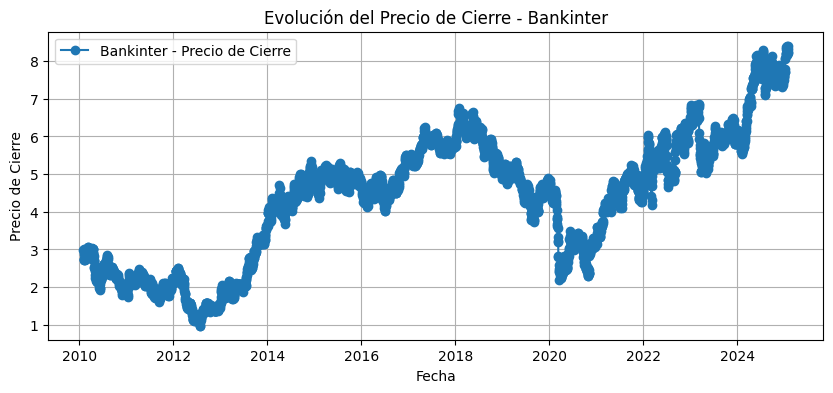

📌 ADF después de 1 diferenciación(es) para Bankinter:
   - Valor de ADF: -17.79222730622619
   - p-valor: 3.2436761761092e-30
   - Valores críticos: {'1%': -3.4320616652439133, '5%': -2.8622963197088107, '10%': -2.5671725986825202}


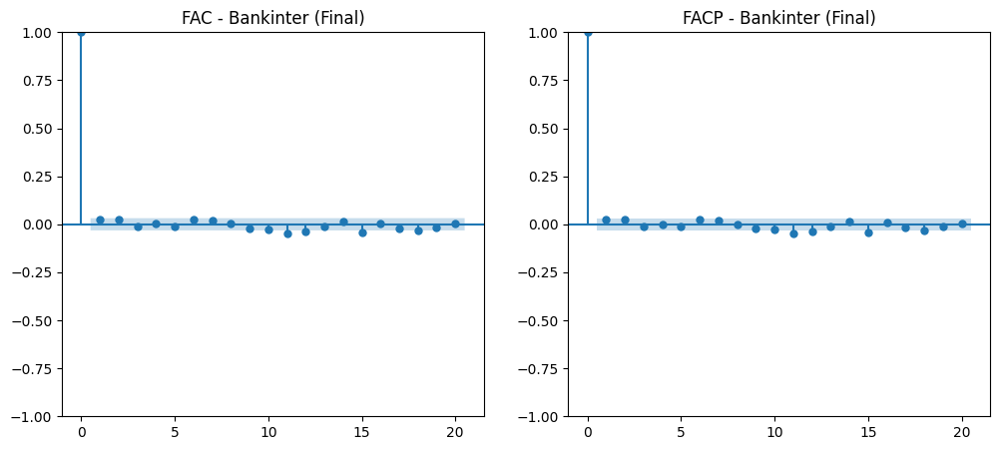

✅ Bankinter es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: BBVA 


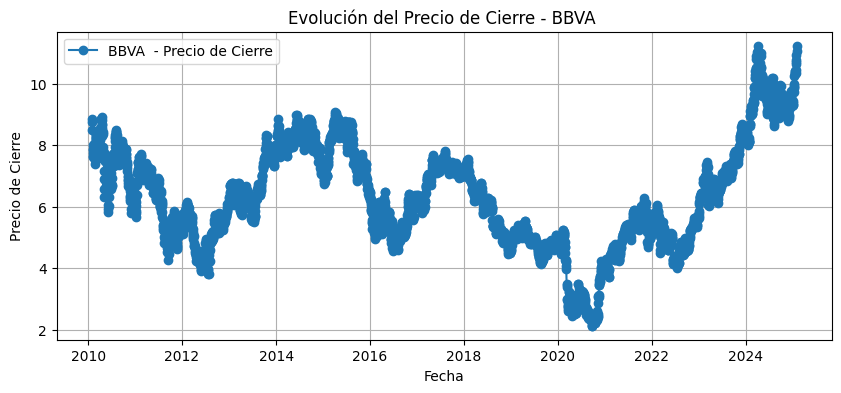

📌 ADF después de 1 diferenciación(es) para BBVA :
   - Valor de ADF: -32.372219176528695
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432056751069083, '5%': -2.8622941489445943, '10%': -2.567171443050389}


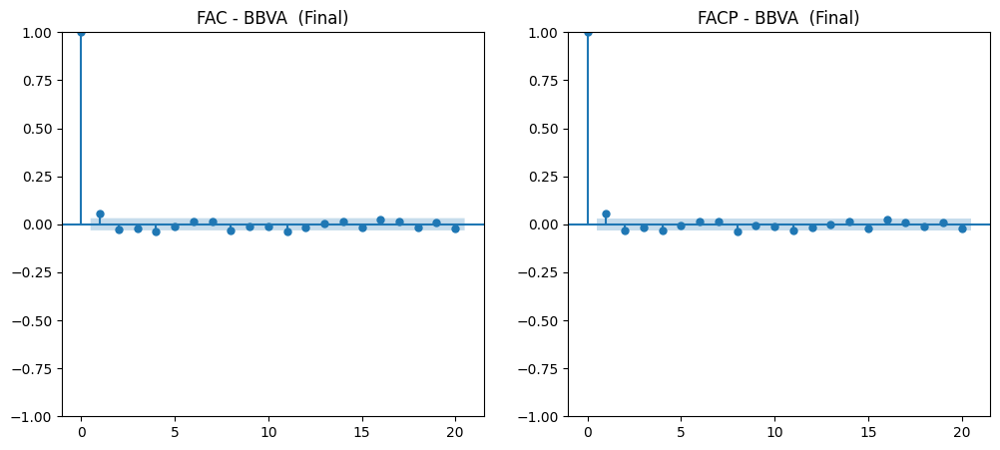

✅ BBVA  es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Caixabank 


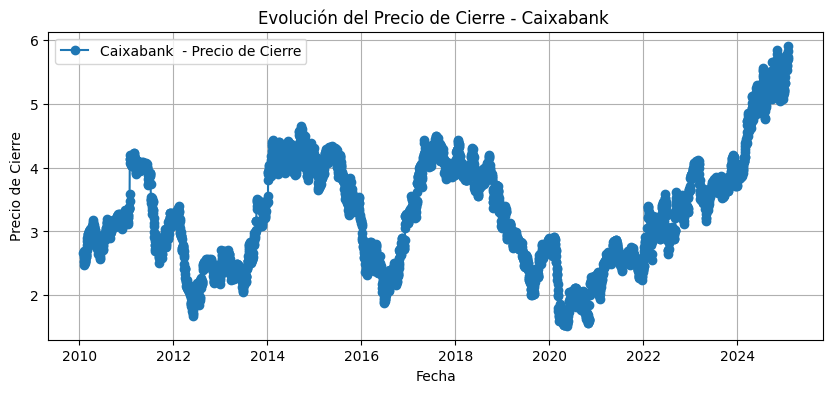

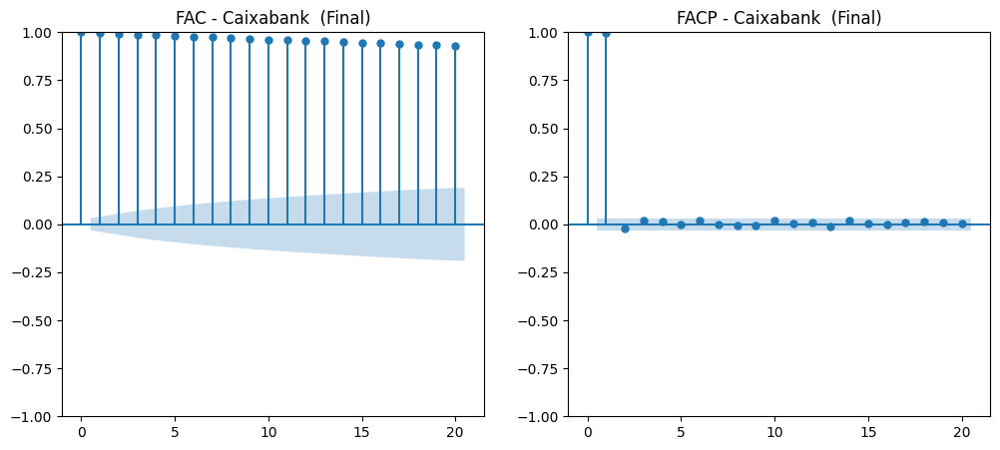

✅ Caixabank  es ESTACIONARIA después de 0 diferenciación(es).

📊 Analizando:  Colonial


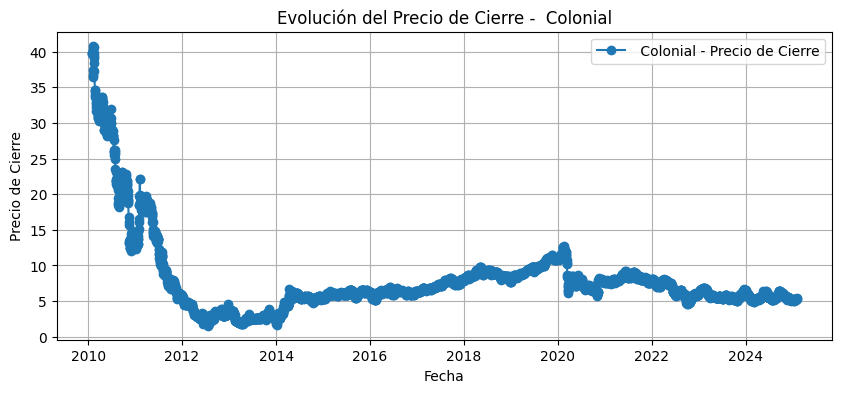

📌 ADF después de 1 diferenciación(es) para  Colonial:
   - Valor de ADF: -11.417142287830954
   - p-valor: 7.017150091079153e-21
   - Valores críticos: {'1%': -3.4320684121759575, '5%': -2.862299300060652, '10%': -2.567174185309234}


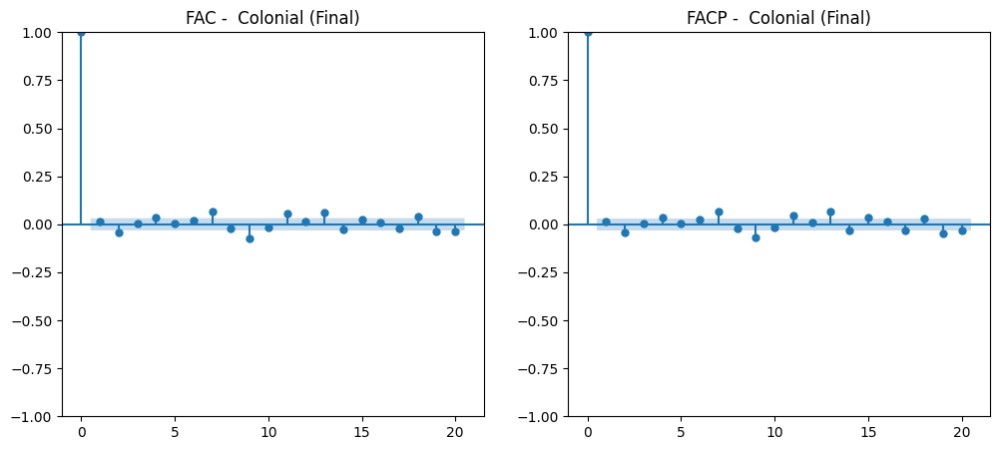

✅  Colonial es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Enagas


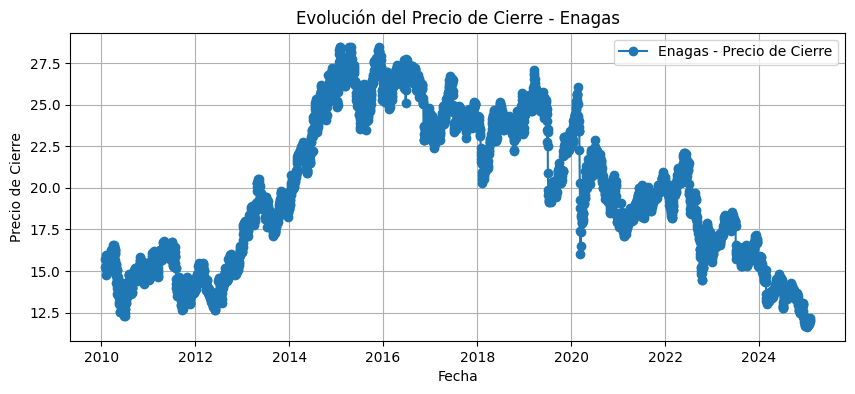

📌 ADF después de 1 diferenciación(es) para Enagas:
   - Valor de ADF: -61.41738245582999
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320554157329366, '5%': -2.862293559078938, '10%': -2.5671711290285004}


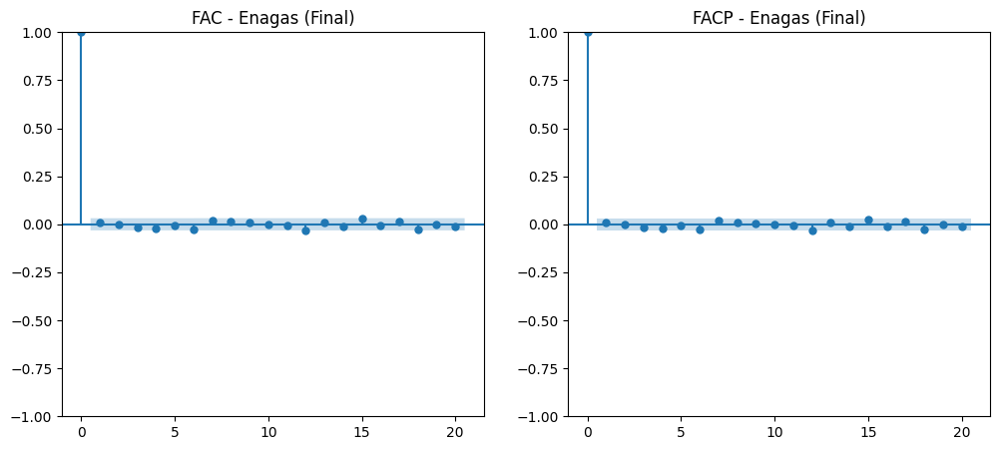

✅ Enagas es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Endesa 


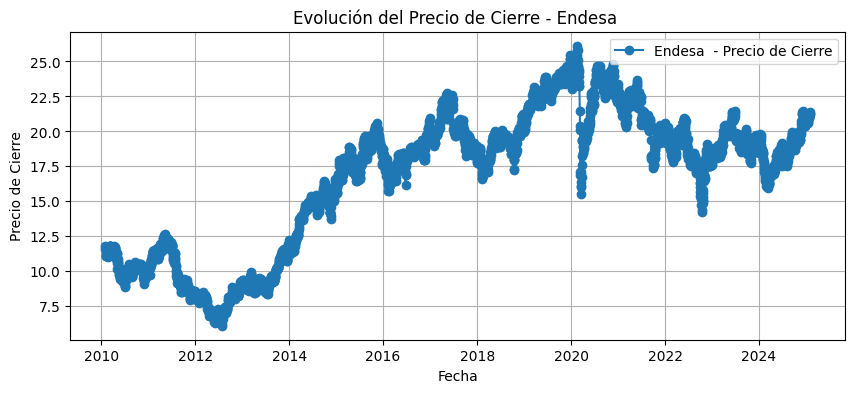

📌 ADF después de 1 diferenciación(es) para Endesa :
   - Valor de ADF: -19.925491269537485
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320598750004825, '5%': -2.862295528895607, '10%': -2.567172177683642}


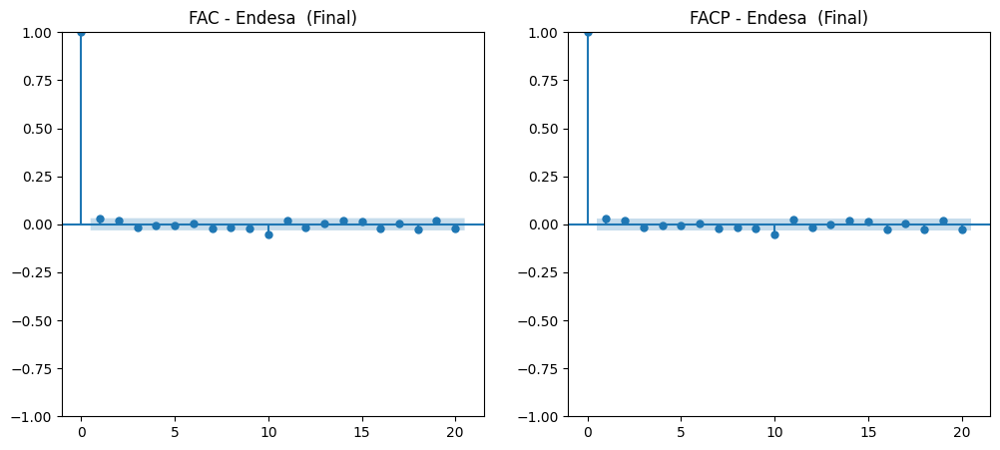

✅ Endesa  es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Ferrovial 


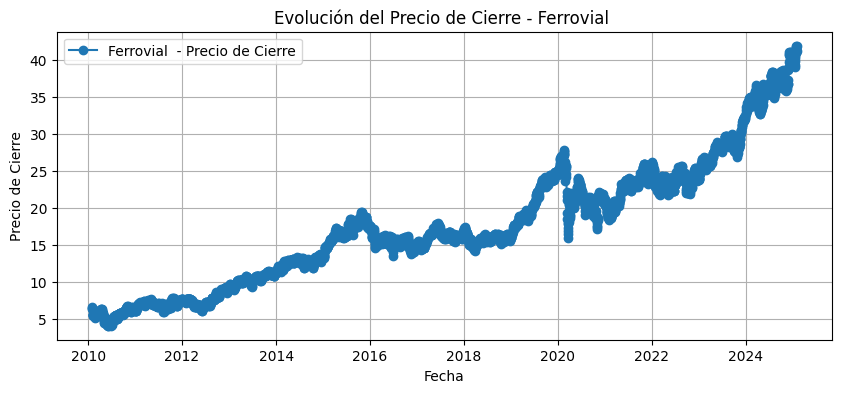

📌 ADF después de 1 diferenciación(es) para Ferrovial :
   - Valor de ADF: -62.26797709884472
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320554157329366, '5%': -2.862293559078938, '10%': -2.5671711290285004}


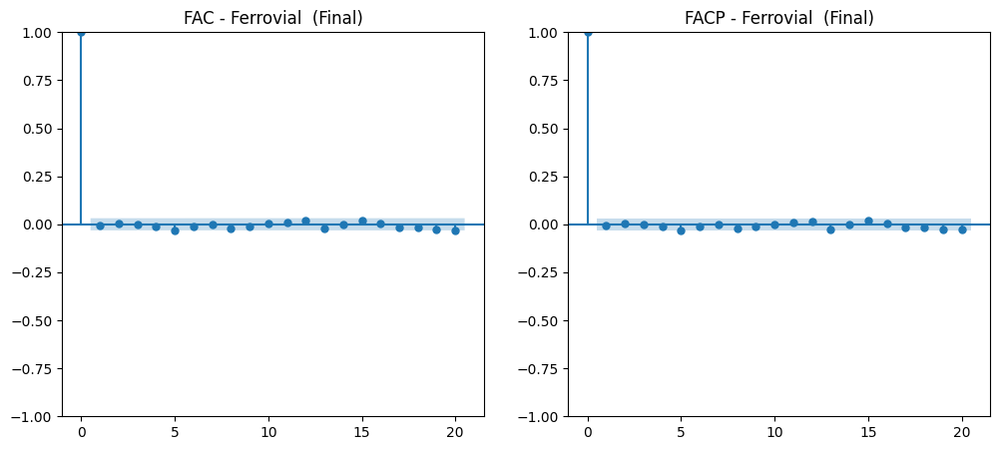

✅ Ferrovial  es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Fluidra


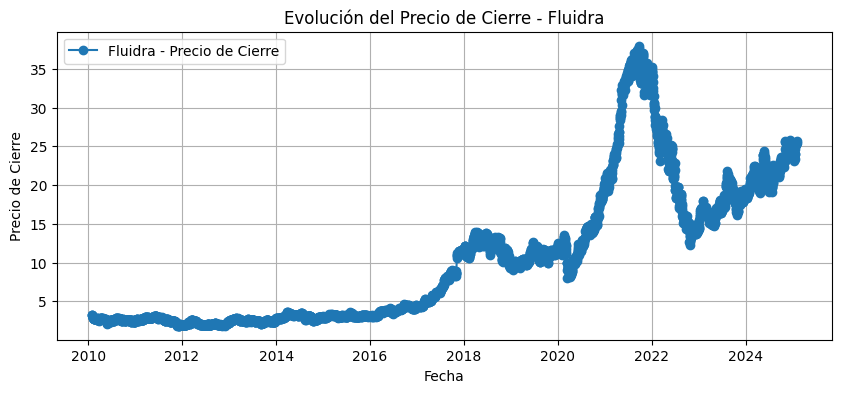

📌 ADF después de 1 diferenciación(es) para Fluidra:
   - Valor de ADF: -33.77707857864215
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432056751069083, '5%': -2.8622941489445943, '10%': -2.567171443050389}


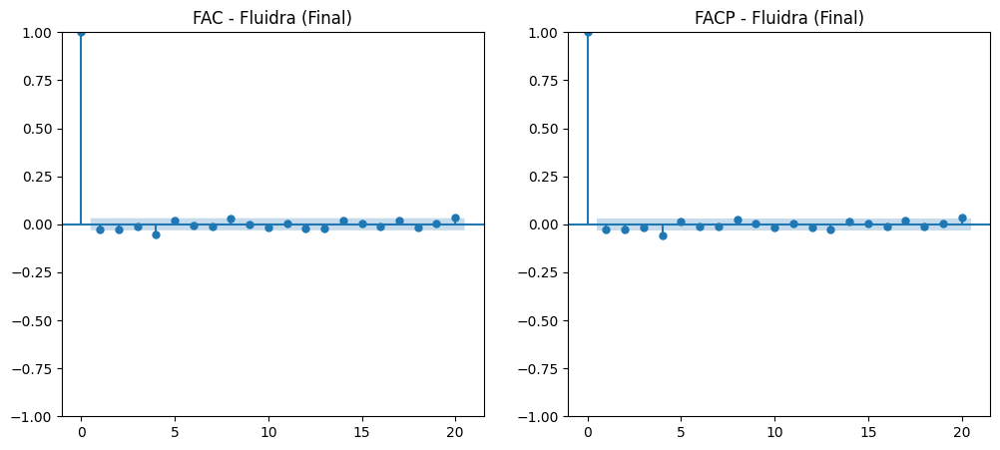

✅ Fluidra es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Grifols 


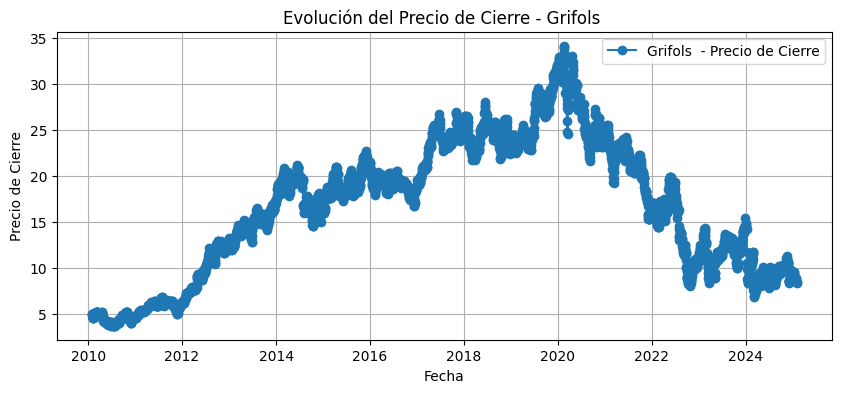

📌 ADF después de 1 diferenciación(es) para Grifols :
   - Valor de ADF: -18.701892309805174
   - p-valor: 2.0367359582717354e-30
   - Valores críticos: {'1%': -3.4320607696538454, '5%': -2.8622959240953807, '10%': -2.5671723880729633}


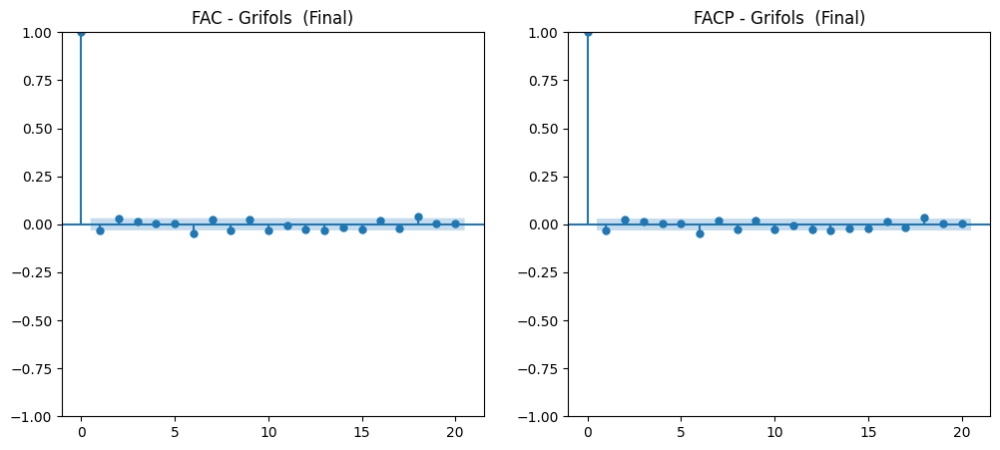

✅ Grifols  es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Iberdrola 


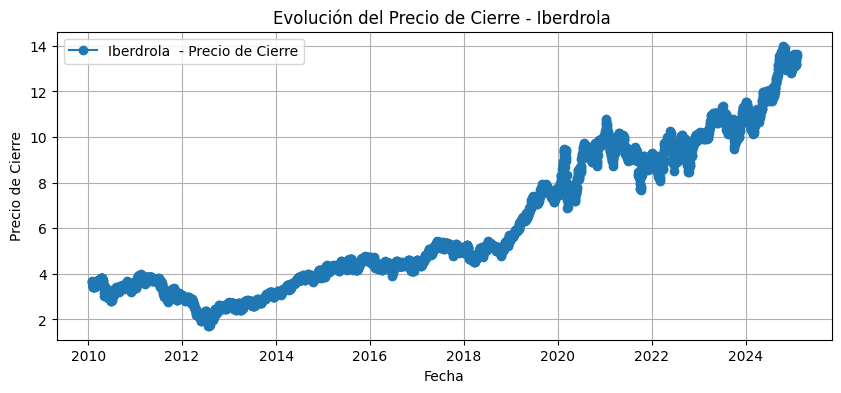

📌 ADF después de 1 diferenciación(es) para Iberdrola :
   - Valor de ADF: -12.539011682299265
   - p-valor: 2.3369446118932578e-23
   - Valores críticos: {'1%': -3.432067058537759, '5%': -2.862298702112663, '10%': -2.5671738669842252}


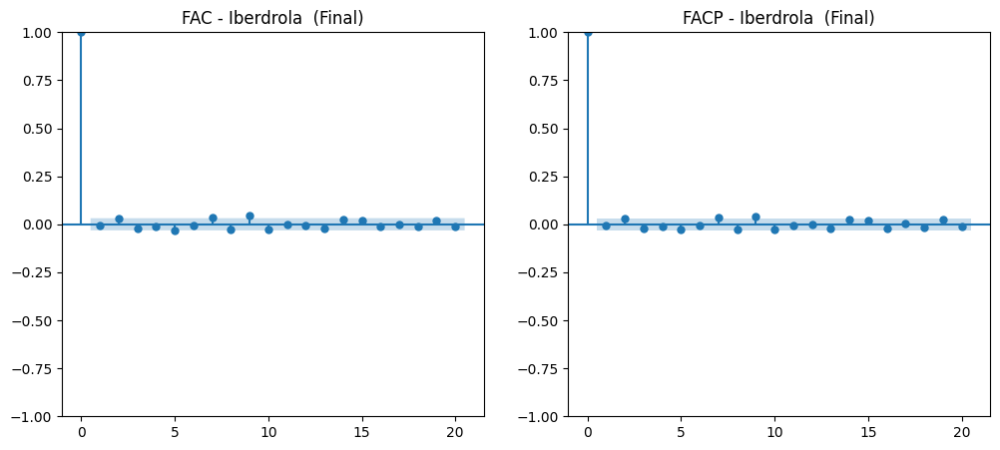

✅ Iberdrola  es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Inditex


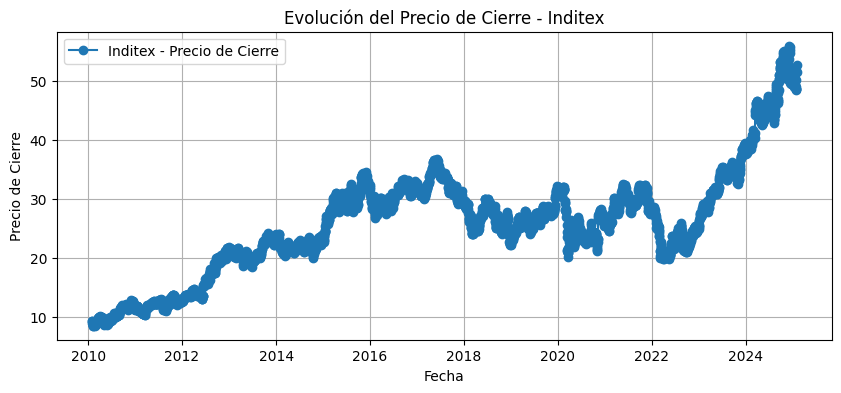

📌 ADF después de 1 diferenciación(es) para Inditex:
   - Valor de ADF: -62.22317301027844
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320554157329366, '5%': -2.862293559078938, '10%': -2.5671711290285004}


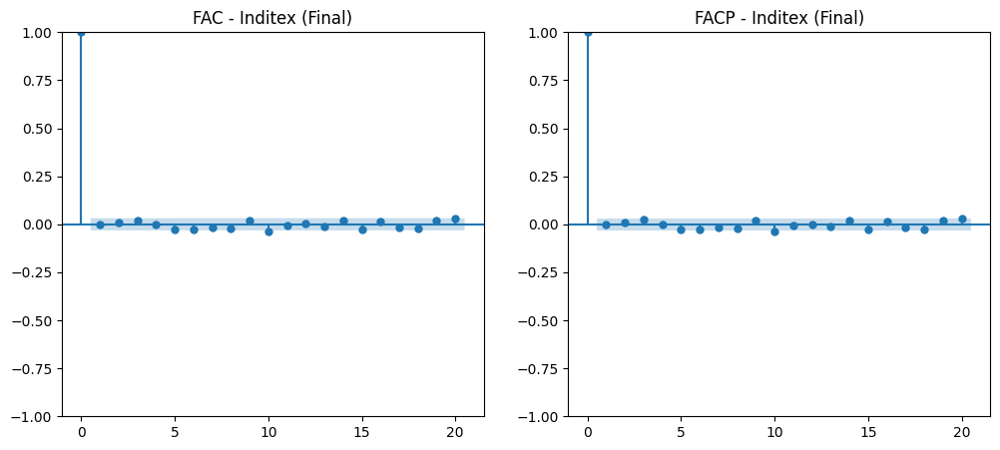

✅ Inditex es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Indra 


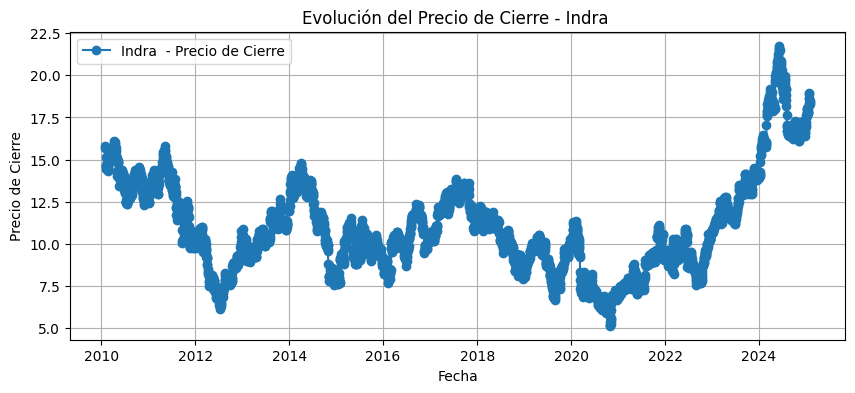

📌 ADF después de 1 diferenciación(es) para Indra :
   - Valor de ADF: -32.944333577902576
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432056751069083, '5%': -2.8622941489445943, '10%': -2.567171443050389}


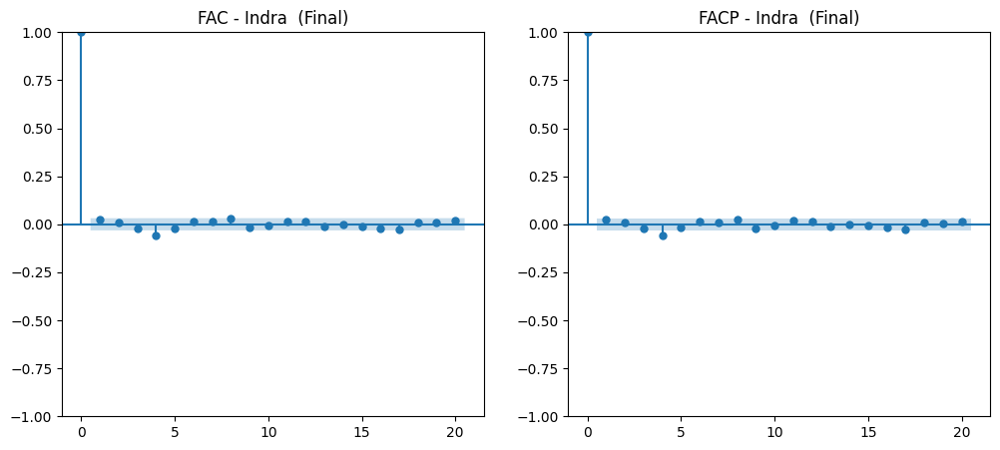

✅ Indra  es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Mapfre


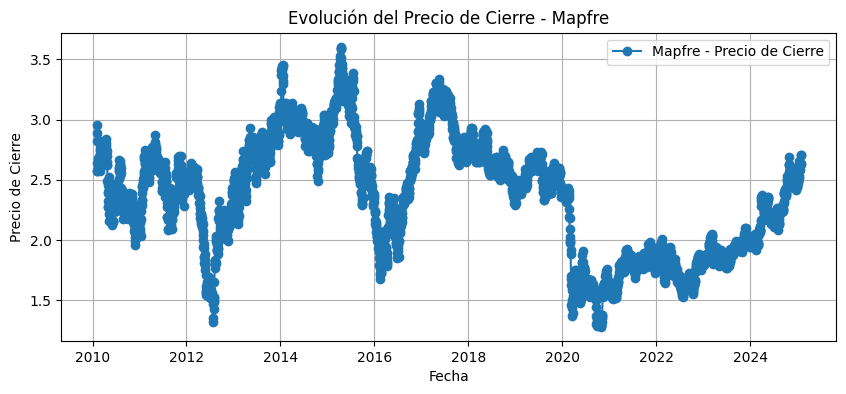

📌 ADF después de 1 diferenciación(es) para Mapfre:
   - Valor de ADF: -20.599464103822
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432059428024606, '5%': -2.8622953314506385, '10%': -2.567172072571461}


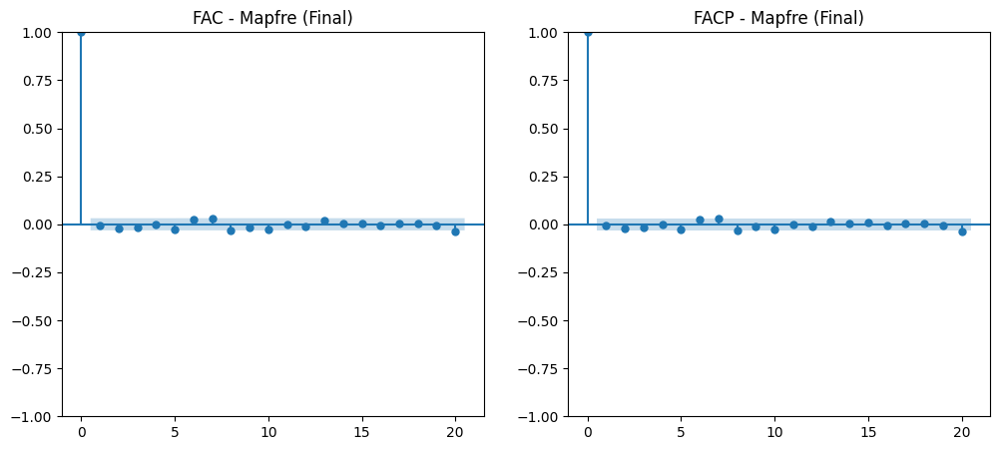

✅ Mapfre es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Naturgy 


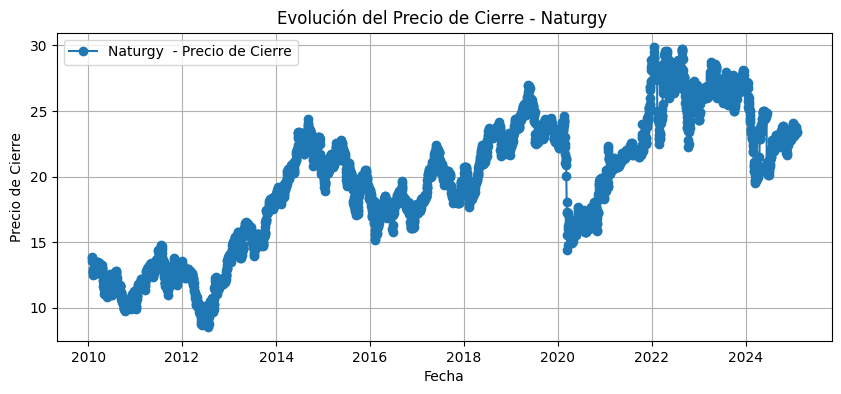

📌 ADF después de 1 diferenciación(es) para Naturgy :
   - Valor de ADF: -36.362717338092196
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.432056305724747, '5%': -2.8622939522201287, '10%': -2.567171338321811}


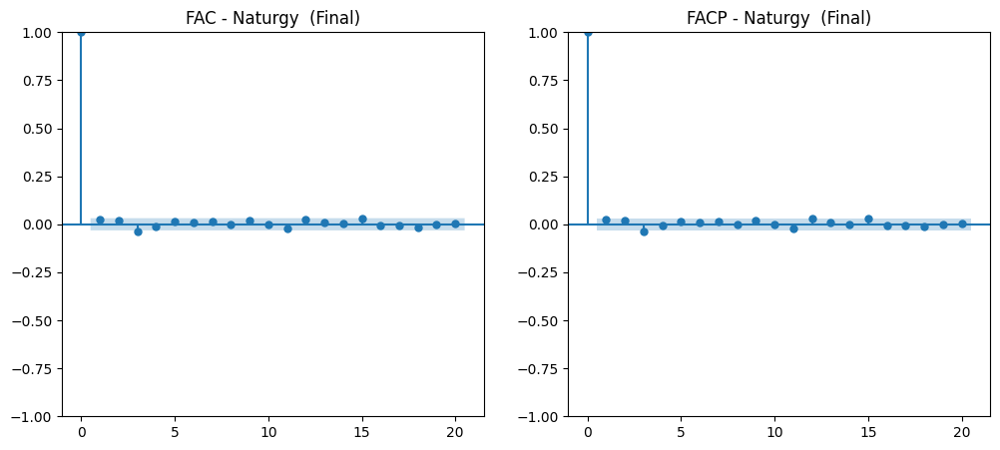

✅ Naturgy  es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Redeia


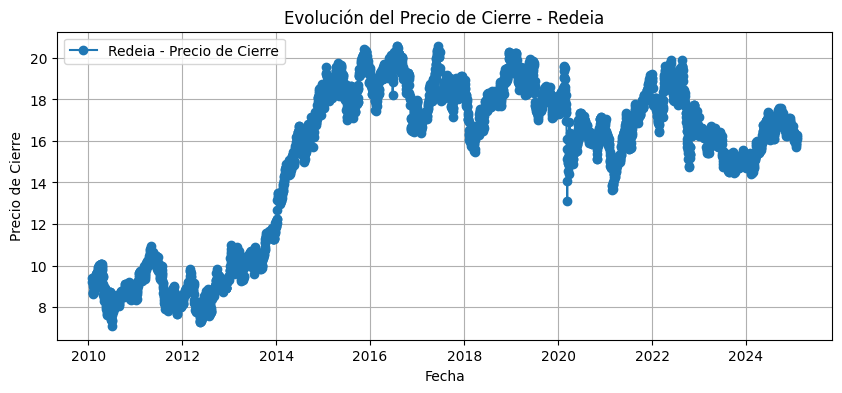

📌 ADF después de 1 diferenciación(es) para Redeia:
   - Valor de ADF: -62.39087236431483
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320554157329366, '5%': -2.862293559078938, '10%': -2.5671711290285004}


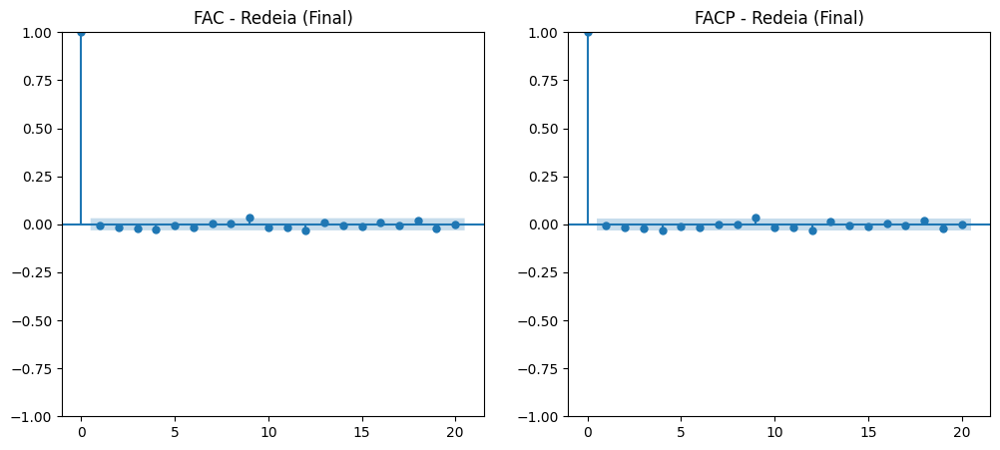

✅ Redeia es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Rovi


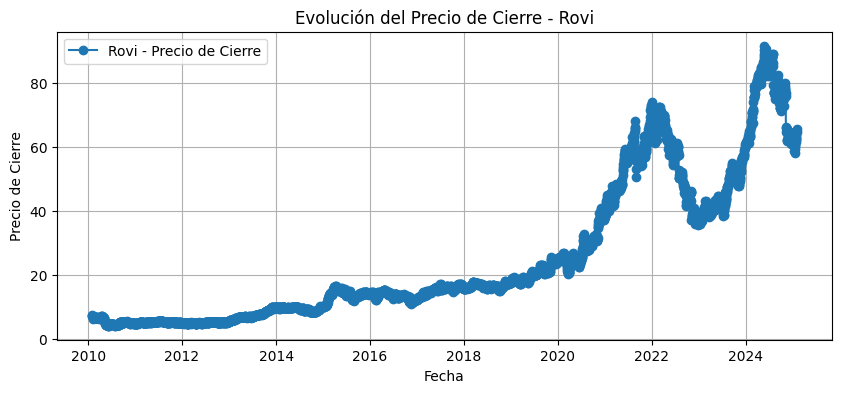

📌 ADF después de 1 diferenciación(es) para Rovi:
   - Valor de ADF: -10.856219420443447
   - p-valor: 1.485337309132395e-19
   - Valores críticos: {'1%': -3.432072939758102, '5%': -2.86230130004556, '10%': -2.567175250026274}


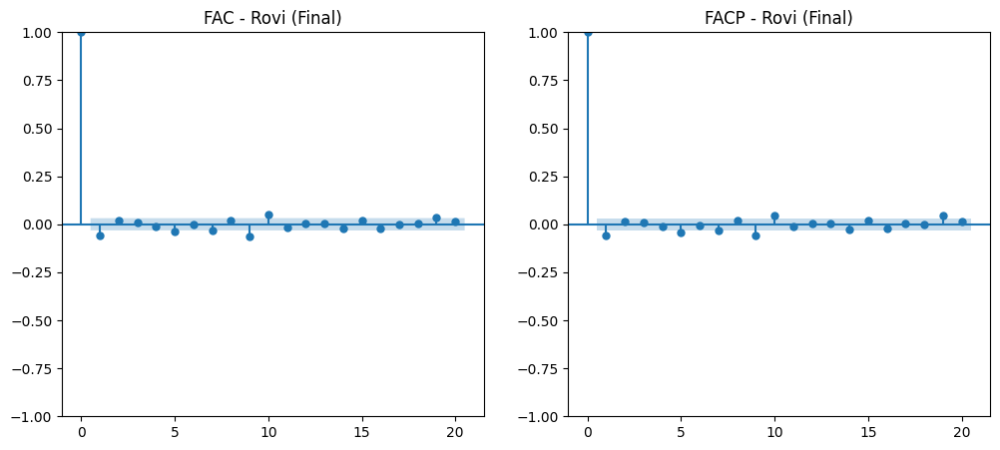

✅ Rovi es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Sacyr


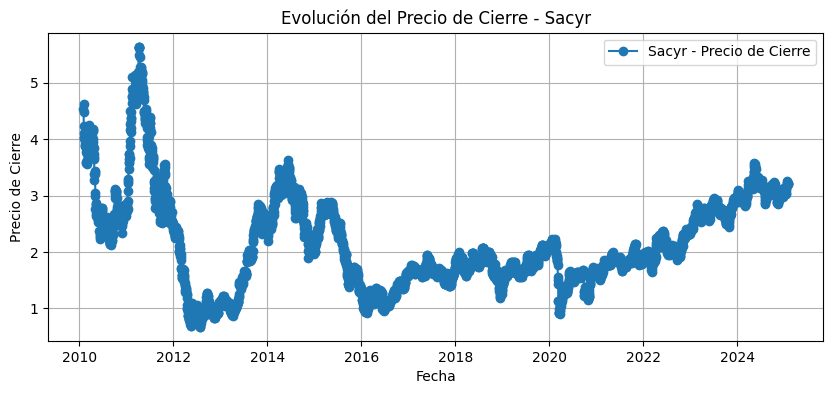

📌 ADF después de 1 diferenciación(es) para Sacyr:
   - Valor de ADF: -19.798649219943226
   - p-valor: 0.0
   - Valores críticos: {'1%': -3.4320589812823554, '5%': -2.8622951341088414, '10%': -2.5671719675142097}


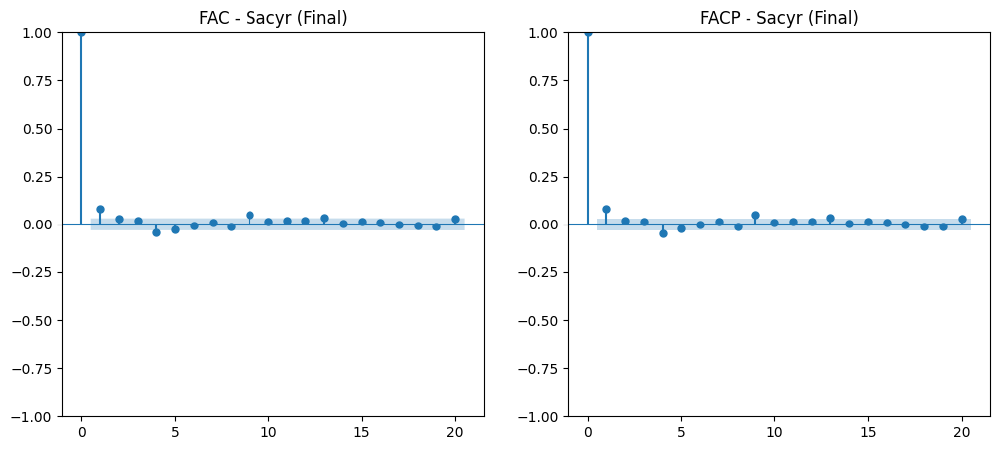

✅ Sacyr es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Solaria 


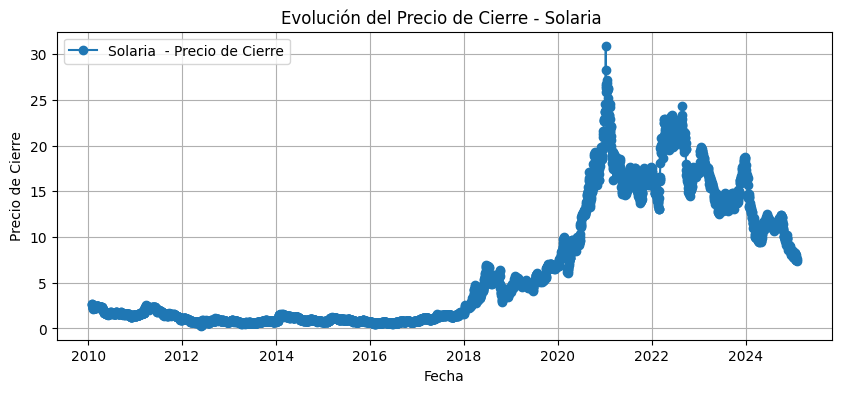

📌 ADF después de 1 diferenciación(es) para Solaria :
   - Valor de ADF: -17.928037108873646
   - p-valor: 2.890002674345173e-30
   - Valores críticos: {'1%': -3.4320598750004825, '5%': -2.862295528895607, '10%': -2.567172177683642}


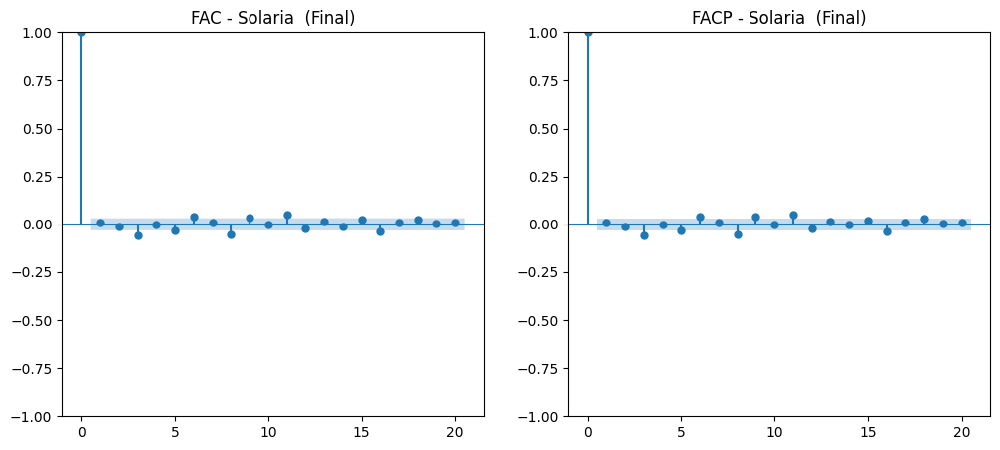

✅ Solaria  es ESTACIONARIA después de 1 diferenciación(es).

📊 Analizando: Telefonica


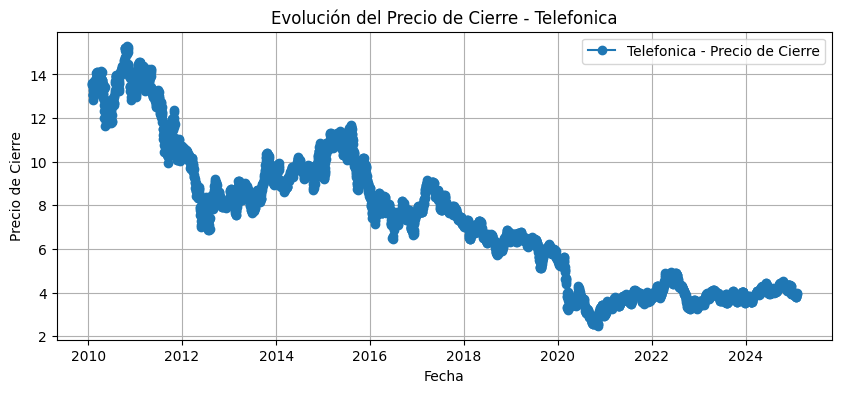

📌 ADF después de 1 diferenciación(es) para Telefonica:
   - Valor de ADF: -16.38926020280117
   - p-valor: 2.7041021866352153e-29
   - Valores críticos: {'1%': -3.4320616652439133, '5%': -2.8622963197088107, '10%': -2.5671725986825202}


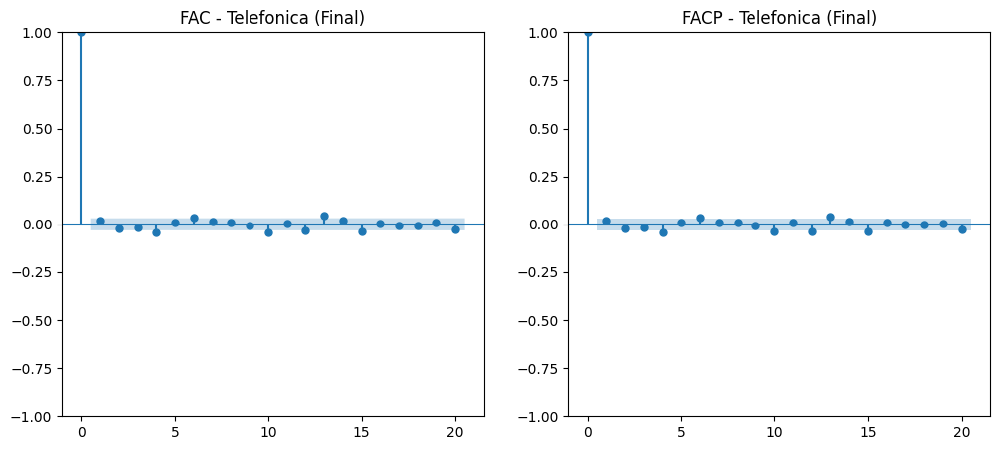

✅ Telefonica es ESTACIONARIA después de 1 diferenciación(es).
✅ Archivo 'resultados_adf.csv' generado con los resultados.


In [ ]:
#CON DIFERENCIAS

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from google.colab import files


uploaded = files.upload()


file_name = list(uploaded.keys())[0]
xls = pd.ExcelFile(file_name)


hojas = xls.sheet_names
print(" Hojas disponibles en el archivo:", hojas)

resultados_adf = {}

for hoja in hojas:
    print(f"\n Analizando: {hoja}")

    df = pd.read_excel(xls, sheet_name=hoja)


    if "Exchange Date" not in df.columns or "Close" not in df.columns:
        print(f" {hoja}: No tiene las columnas necesarias ('Exchange Date' y 'Close'). Se omite.")
        continue

    df["Exchange Date"] = pd.to_datetime(df["Exchange Date"])
    df.set_index("Exchange Date", inplace=True)


    serie_ts = df["Close"].dropna()

    plt.figure(figsize=(10, 4))
    plt.plot(serie_ts, marker="o", linestyle="-", label=f"{hoja} - Precio de Cierre")
    plt.xlabel("Fecha")
    plt.ylabel("Precio de Cierre")
    plt.title(f"Evolución del Precio de Cierre - {hoja}")
    plt.legend()
    plt.grid()
    plt.show()


    adf_result = adfuller(serie_ts)
    p_valor = adf_result[1]


    resultados_adf[hoja] = {
        "ADF Statistic": adf_result[0],
        "p-valor": p_valor,
        "Valores críticos": adf_result[4],
        "Diferenciaciones aplicadas": 0
    }

    diferencia_aplicada = 0
    while p_valor >= 0.05 and diferencia_aplicada < 2:
        df[f"Close_diff_{diferencia_aplicada+1}"] = df["Close"].diff(diferencia_aplicada+1).dropna()
        serie_ts = df[f"Close_diff_{diferencia_aplicada+1}"].dropna()


        adf_result = adfuller(serie_ts)
        p_valor = adf_result[1]
        diferencia_aplicada += 1

        print(f" ADF después de {diferencia_aplicada} diferenciación(es) para {hoja}:")
        print(f"   - Valor de ADF: {adf_result[0]}")
        print(f"   - p-valor: {p_valor}")
        print(f"   - Valores críticos: {adf_result[4]}")

        resultados_adf[hoja]["ADF Statistic"] = adf_result[0]
        resultados_adf[hoja]["p-valor"] = p_valor
        resultados_adf[hoja]["Diferenciaciones aplicadas"] = diferencia_aplicada


    fig, ax = plt.subplots(1, 2, figsize=(12, 5))
    plot_acf(serie_ts.dropna(), ax=ax[0], lags=20)
    plot_pacf(serie_ts.dropna(), ax=ax[1], lags=20)
    ax[0].set_title(f"FAC - {hoja} (Final)")
    ax[1].set_title(f"FACP - {hoja} (Final)")
    plt.show()


    if p_valor < 0.05:
        print(f"✅ {hoja} es ESTACIONARIA después de {diferencia_aplicada} diferenciación(es).")
    else:
        print(f"❌ {hoja} sigue sin ser estacionaria tras {diferencia_aplicada} diferenciación(es). Se recomienda más tratamiento.")

# 8 Guardar los resultados en un archivo CSV para descargar
df_resultados = pd.DataFrame(resultados_adf).T
df_resultados.to_csv("resultados_adf.csv")
print(" Archivo 'resultados_adf.csv' generado con los resultados.")

